In [1]:
import sys
print(sys.version)

3.6.10 |Anaconda, Inc.| (default, Jan  7 2020, 15:01:53) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]


In [2]:
"""
Created on July 4 2020
@author: Neven Caplar
@contact: ncaplar@princeton.edu

These comments are theoretically the only ones you need to read to run the notebook

1. Specify the directory in which you want to run the analysis below (PSF_DIRECTORY)
2. Name and place the data in DATA_FOLDER. The data is avaliable at https://github.com/nevencaplar/PFS_Work_In_Progress/tree/master/CutsForTigerMay2
3. TESTING_FOLDER will be filled during the run with images from the analysis analysis

4. (OPTIONAL)Next cell contains some extensions that I use that make life much easier when using jupyter notebook 
    Without them this notebook becomes reallllly huge and hard to deal with
    These can be downloaded from https://github.com/ipython-contrib/jupyter_contrib_nbextensions

"""
############################################################
# name your directory where you want to have files!
PSF_DIRECTORY='/Users/nevencaplar/Documents/PFS/'
# place cutouts in this folder - name as you wish
DATA_FOLDER=PSF_DIRECTORY+'TigerAnalysis/CutsForTigerMay2/'
############################################################
    

TESTING_FOLDER=PSF_DIRECTORY+'Testing/'
TESTING_PUPIL_IMAGES_FOLDER=TESTING_FOLDER+'Pupil_Images/'
TESTING_WAVEFRONT_IMAGES_FOLDER=TESTING_FOLDER+'Wavefront_Images/'
TESTING_FINAL_IMAGES_FOLDER=TESTING_FOLDER+'Final_Images/'
import os

for i in [PSF_DIRECTORY,DATA_FOLDER,TESTING_PUPIL_IMAGES_FOLDER,TESTING_WAVEFRONT_IMAGES_FOLDER,TESTING_FINAL_IMAGES_FOLDER]:
    if not os.path.exists(i):
        os.makedirs(i)

In [3]:
%%javascript
try {
  require(['base/js/utils'], function (utils) {
    utils.load_extension('code_prettify/code_prettify');
    utils.load_extension('collapsible_headings/main'); 
    utils.load_extension('codefolding/edit'); 
    utils.load_extension('codefolding/main'); 
    utils.load_extension('execute_time/ExecuteTime');   
    utils.load_extension('toc2/main'); 
  });
}
catch (err) {
  console.log('toc2 load error:', err);
}

<IPython.core.display.Javascript object>

In [4]:
# make notebook nice and wide to fill the entire screen
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [5]:
%load_ext autoreload
%autoreload 2

#import Zernike_Module
#from Zernike_Module import LNP_PFS,LN_PFS_single,create_parInit,downsample_manual_function,Zernike_Analysis,PFSPupilFactory,custom_fftconvolve,stepK,maxK,sky_scale,sky_size,create_x,remove_pupil_parameters_from_all_parameters

import Zernike_Module
import Zernike_Analysis_Module
from Zernike_Module import *
from Residual_1D_module import * 
from Zernike_Analysis_Module import *

print(Zernike_Module.__version__)
print(Zernike_Analysis_Module.__version__)

0.30d
0.26


In [6]:
import galsim
import numpy as np
np.set_printoptions(suppress=True)
np.seterr(divide='ignore', invalid='ignore')
import pandas as pd
import io
import math
import pickle
import glob

#tqdm is not necesarry, it is the monitor evaluation of the 'for' loops
from tqdm import tqdm

# lsst stack
#import lsst.afw
#from lsst.afw.cameraGeom import PupilFactory
#from lsst.afw.geom import Angle, degrees
#from lsst.afw import geom
#from lsst.afw.geom import Point2D

# astropy
import astropy
import astropy.convolution
from astropy.convolution import Gaussian2DKernel

# scipy and skimage
#from scipy.ndimage import gaussian_filter
import scipy.misc
import skimage.transform

#lmfit
import lmfit

#matplotlib
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
matplotlib.rcParams.update({'font.size': 18})
%config InlineBackend.rc = {}
%matplotlib inline
%config IPython.matplotlib.backend = "retina"

from shutil import copy
from scipy.optimize import curve_fit

from astropy.io import fits

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c



print(np.__version__)
print(skimage.__version__)
print(scipy.__version__)
print(pd.__version__)

1.17.0
0.16.2
1.3.1
0.25.1


# Jul 03

## init test 

In [8]:
date='Jul0620'
obs=21346+6
obs_multi=[21352, 21358, 21364, 21436, 21442, 21448 ]

obs_int=int(obs)
single_number='61'
image_index=int(single_number)
eps=7
arc='HgAr'
dataset=4

In [9]:
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448787HgAr_list_of_times.npy')/60
list_of_swarms_time_1=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448787HgAr_list_of_swarms_time_1.npy')
list_of_swarms_time_2=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448787HgAr_list_of_swarms_time_2.npy')

print(list_of_times)
print(list_of_swarms_time_1)
print(np.diff(list_of_swarms_time_1))
print(list_of_swarms_time_2)
print(np.diff(list_of_swarms_time_2))

FileNotFoundError: [Errno 2] No such file or directory: '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448787HgAr_list_of_times.npy'

In [157]:
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgAr_list_of_times.npy')/60
list_of_swarms_time_1=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgAr_list_of_swarms_time_1.npy')
list_of_swarms_time_2=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgAr_list_of_swarms_time_2.npy')


print(list_of_times)
print(list_of_swarms_time_1)
print(np.diff(list_of_swarms_time_1))
print(list_of_swarms_time_2)
print(np.diff(list_of_swarms_time_2))

[1.40295164 3.7292068  8.32546385 9.3708691 ]
[27.31721568 36.1289835  43.32341218 51.01669407 59.72131944 69.23133564
 78.91778064]
[8.81176782 7.19442868 7.69328189 8.70462537 9.5100162  9.686445  ]
[ 27.55652785  41.7564497   51.53332424  61.28955007  70.92779422
  85.0857687   99.26157498 109.17119336 123.10615182 132.89955807
 142.49031591 152.24591756 166.30840158 179.46964359 193.67463589
 207.05261111 220.96190047 234.31680202 248.19764471 261.54675412
 275.61405516]
[14.19992185  9.77687454  9.75622582  9.63824415 14.15797448 14.17580628
  9.90961838 13.93495846  9.79340625  9.59075785  9.75560164 14.06248403
 13.16124201 14.20499229 13.37797523 13.90928936 13.35490155 13.88084269
 13.34910941 14.06730103]


In [158]:
list_of_swarms_time_1=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgAr_list_of_swarms_time_1.npy')
print(list_of_swarms_time_1)
print(np.diff(list_of_swarms_time_1))

[27.31721568 36.1289835  43.32341218 51.01669407 59.72131944 69.23133564
 78.91778064]
[8.81176782 7.19442868 7.69328189 8.70462537 9.5100162  9.686445  ]


18.0

In [355]:
np.diff(list_of_swarms_time_1)

array([13.09505296,  6.57011604, 12.39652467, 18.94578958, 19.87290406,
       23.48012948])

In [354]:
np.diff(list_of_swarms_time_2)

array([24.11467957, 23.47059917, 23.34841394, 23.78071713, 23.82540226,
       23.62363696, 23.92695451, 23.86117411, 23.76766753, 23.99886298,
       24.06865501, 23.81628633, 23.86587977, 24.1362412 , 23.82666779,
       23.61259532, 23.64493966, 23.48433805, 24.53993344, 23.95513201])

In [344]:
np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgArtime.npy')/60

array([ 3.31549244,  7.35903198, 18.38284617, 20.14753135])

In [343]:
number_of_images=(7*120+7*120+21*20+120*3)
total_time_in_sec=number_of_images*4.9
time_in_sec_per_core=total_time_in_sec/40
time_in_minutes_per_core=time_in_sec_per_core/60
time_in_minutes_per_core

5.0225

In [340]:
[2.26,4.89-2.26,11.85-4.89,13-11.85]

[2.26, 2.63, 6.96, 1.1500000000000004]

In [338]:
number_of_images=(7*120*1.5)
total_time_in_sec=number_of_images*4.9
time_in_sec_per_core=total_time_in_sec/80
time_in_minutes_per_core=time_in_sec_per_core/60
print(time_in_minutes_per_core)

number_of_images=(7*120*1.5)
total_time_in_sec=number_of_images*4.9
time_in_sec_per_core=total_time_in_sec/80
time_in_minutes_per_core=time_in_sec_per_core/60
print(time_in_minutes_per_core)

number_of_images=(21*120*1.5)
total_time_in_sec=number_of_images*4.9
time_in_sec_per_core=total_time_in_sec/80
time_in_minutes_per_core=time_in_sec_per_core/60
print(time_in_minutes_per_core)

number_of_images=(3*120*1.5)
total_time_in_sec=number_of_images*4.9
time_in_sec_per_core=total_time_in_sec/80
time_in_minutes_per_core=time_in_sec_per_core/60
print(time_in_minutes_per_core)

1.28625
1.28625
3.85875
0.55125


In [10]:
single_analysis=Zernike_Analysis(date=date,obs='p4',single_number=single_number,eps=eps,arc=arc,dataset=dataset,multi_var=True,list_of_defocuses=['m4','m35','m3','p3','p35','p4'])
double_sources,double_sources_positions_ratios=single_analysis.return_double_sources()
list_of_sci_images,list_of_var_images,list_of_mask_images=single_analysis.return_lists_of_images()
index_of_single_image=single_analysis.return_index_of_single_image_in_list_of_images()
columns,columns22,columns22_analysis=single_analysis.return_columns()


labelInput: p4
list_of_defocuses: ['m4', 'm35', 'm3', 'p3', 'p35', 'p4']
list_of_obs: [21352, 21358, 21364, 21436, 21442, 21448]
analyzing label: 21448


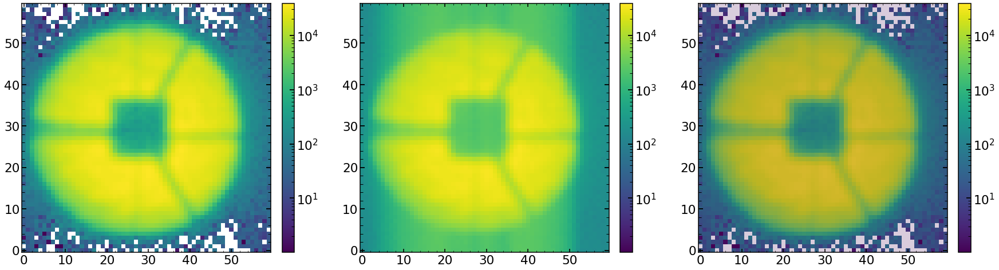

In [11]:
single_analysis.create_basic_data_image()

In [163]:
single_analysis.create_fitting_evolution_plot()

FileNotFoundError: [Errno 2] No such file or directory: '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/likechainJul0620_Single_P_21448617HgArEmcee3.npy'

In [181]:
minchain=np.array([   -7.65036562  ,   0.12296992,     0.06099676,    -0.05843171,
     0.05847321  ,  -0.6563282,      0.00963239 ,    0.577934,
    -0.0016562 ,    -0.1602836 ,    -0.00103432  ,  -0.10615598,
     0.02213337,    -0.2688421  ,    0.00148148   , -0.41054522,
     0.00266833 ,    0.02502216  ,  -0.00487602    ,-0.01651594,
     0.00962208,     0.01930819   , -0.00005188,     0.03910462,
    -0.00461152 ,   -0.0245788     ,-0.01403541 ,   -0.01711016,
    -0.00685154  ,   0.01683353,    -0.0006198   ,  -0.00347444,
     0.00531157   , -0.02458877 ,   -0.0017866    ,  0.0153393,
     0.00965734    , 0.02397585  ,   0.64557576    , 0.07778802,
    -0.00549605,    -0.07156276   ,  0.05648252 ,    0.01533421,
     0.00000822 ,    0.00000822    , 0.9735708   ,   0.94833764,
    -0.04031499  ,  -0.03863829     ,0.93075809   ,  0.06376284,
     0.83061292   ,  1.03669694  ,   0.03127264 ,90501.2178304,
     2.38010383    , 0.00263762   ,  0.37263931  ,   1.79574275])
minchain_err=np.array([   1.11766586  ,  0.11605799,    0.16952111   , 0.12921106   , 0.13545905,
    0.15527422,    0.13379786,    0.14108731,    0.12554743 ,   0.14257623,
    0.13654411 ,   0.13645214 ,   0.13965619 ,   0.12827685 ,   0.14931596,
    0.14316421  ,  0.06837313  ,  0.08017441  ,  0.09325579 ,   0.08763043,
    0.08832431   , 0.08526823   , 0.07083473,    0.07037106,    0.08889801,
    0.06773025,    0.07554474,    0.0805507  ,   0.0777236 ,    0.07549607,
    0.08499724 ,   0.08592642 ,   0.08134299  ,  0.08899488 ,   0.09340485,
    0.08649964  ,  0.09204257  ,  0.07367144 ,   0.00972606 ,   0.00288765,
    0.01248395   , 0.01195517   , 0.00154561 ,   0.0052407 ,    0.,
    0.         ,   0.       ,     0.        ,    0.01614571 ,   0.01480259,
    0.01063821  ,  0.01054523,    0.06643594 ,   0.0056951,     0.0204127,
 5668.20544596   , 0.10534789 ,   0.00125058  ,  0.0194811 ,    0.01241976])

In [167]:
hash(str(minchain.data))

425413082416597172

In [169]:
 len(minchain_err)

60

In [175]:
    parInit1=create_parInit(allparameters_proposal=minchain,multi=True,pupil_parameters=None,allparameters_proposal_err=np.abs(minchain)/100,stronger=None,use_optPSF=None,deduced_scattering_slope=None,zmax=22)
    
    # if the generated length of the parameters is larger than size of swarm number of walkers divided by 2, cut the number of walkers
    #number_of_walkers_cut= int(options[0]/2)
    number_of_walkers_cut=2* len(minchain_err)
    # number_of_walkers has to be an even number
    if (number_of_walkers_cut % 2) == 0:
        pass
    else:
        number_of_walkers_cut=number_of_walkers_cut+1
    
    if len(parInit1) > number_of_walkers_cut:      
        parInit1=parInit1[0:number_of_walkers_cut]

IndexError: index 22 is out of bounds for axis 0 with size 22

In [751]:
parInit1.shape

(120, 60)

In [518]:
minchain=np.array([   -7.65036562  ,   0.12296992,     0.06099676,    -0.05843171,
     0.05847321  ,  -0.6563282,      0.00963239 ,    0.577934,
    -0.0016562 ,    -0.1602836 ,    -0.00103432  ,  -0.10615598,
     0.02213337,    -0.2688421  ,    0.00148148   , -0.41054522,
     0.00266833 ,    0.02502216  ,  -0.00487602    ,-0.01651594,
     0.00962208,     0.01930819   , -0.00005188,     0.03910462,
    -0.00461152 ,   -0.0245788     ,-0.01403541 ,   -0.01711016,
    -0.00685154  ,   0.01683353,    -0.0006198   ,  -0.00347444,
     0.00531157   , -0.02458877 ,   -0.0017866    ,  0.0153393,
     0.00965734    , 0.02397585  ,   0.64557576    , 0.07778802,
    -0.00549605,    -0.07156276   ,  0.05648252 ,    0.01533421,
     0.00000822 ,    0.00000822    , 0.9735708   ,   0.94833764,
    -0.04031499  ,  -0.03863829     ,0.93075809   ,  0.06376284,
     0.83061292   ,  1.03669694  ,   0.03127264 ,90501.2178304,
     2.38010383    , 0.00263762   ,  0.37263931  ,   1.79574275])
minchain_err=np.array([   1.11766586  ,  0.11605799,    0.16952111   , 0.12921106   , 0.13545905,
    0.15527422,    0.13379786,    0.14108731,    0.12554743 ,   0.14257623,
    0.13654411 ,   0.13645214 ,   0.13965619 ,   0.12827685 ,   0.14931596,
    0.14316421  ,  0.06837313  ,  0.08017441  ,  0.09325579 ,   0.08763043,
    0.08832431   , 0.08526823   , 0.07083473,    0.07037106,    0.08889801,
    0.06773025,    0.07554474,    0.0805507  ,   0.0777236 ,    0.07549607,
    0.08499724 ,   0.08592642 ,   0.08134299  ,  0.08899488 ,   0.09340485,
    0.08649964  ,  0.09204257  ,  0.07367144 ,   0.00972606 ,   0.00288765,
    0.01248395   , 0.01195517   , 0.00154561 ,   0.0052407 ,    0.,
    0.         ,   0.       ,     0.        ,    0.01614571 ,   0.01480259,
    0.01063821  ,  0.01054523,    0.06643594 ,   0.0056951,     0.0204127,
 5668.20544596   , 0.10534789 ,   0.00125058  ,  0.0194811 ,    0.01241976])

In [379]:
minchain_test=np.array([30.72443239 ,   -0.30241877,    -0.89022102 ,    0.53940442,
    -0.15365879,    -0.1020187,     -0.35737557 ,   -0.41647113,
     0.01434885 ,    0.00298815,    -0.01918012  ,   0.03931215,
    -0.00613274  ,   0.0390315  ,    0.0442397,     -0.00099523,
    -0.04583506   ,  0.02248569  ,  -0.0146535 ,     0.64557576,
     0.07778802    ,-0.00549605   , -0.07156276 ,    0.05648252,
     0.01533421,     0.00000822,     0.00000822  ,   0.9735708,
     0.94833764 ,   -0.04031499 ,   -0.03863829   ,  0.93075809,
     0.06376284  ,   0.83061292  ,   1.03669694    , 0.03127264,
 90501.2178304    ,  2.38010383 ,    0.00263762     ,0.37263931,
     1.79574275    , 0.99686462])

[autoreload of Zernike_Module failed: Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 368, in superreload
    module = reload(module)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/importlib/__init__.py", line 166, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 618, in _exec
  File "<frozen importlib._bootstrap_external>", line 678, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "/Users/nevencaplar/Documents/PFS/PFS_Work_In_Progress/Zernike_Module.py", line 91, in <module>
    impor

In [523]:
minchain_test_default=np.array([   30.72443239,    -0.30241877,    -0.89022102,     0.53940442,
          -0.15365879,    -0.1020187 ,    -0.35737557,    -0.41647113,
           0.01434885,     0.00298815,    -0.01918012,     0.03931215,
          -0.00613274,     0.0390315 ,     0.0442397 ,    -0.00099523,
          -0.04583506,     0.02248569,    -0.0146535 ,     0.64557576,
           0.07778802,    -0.00549605,    -0.07156276,     0.05648252,
           0.01533421,     0.00000822,     0.00000822,     0.9735708 ,
           0.94833764,    -0.04031499,    -0.03863829,     0.93075809,
           0.06376284,     0.83061292,     1.03669694,     0.03127264,
       90501.2178304 ,     2.38010383,     0.00263762,     0.37263931,
           1.79574275,     0.98      ])

In [524]:
allparameters_proposal_err=1*np.array([2,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,
                        0.1,0.1,0.1,0.1,0.05,0.1,
                        0.2, 0.4,0.1,0.1,
                        0.1,0.1,0.02,0.02,0.5,0.2,0.1,
                        30000,0.5,0.01,
                        0.1,0.05,0.01]   )

In [526]:
import time

In [528]:
model_multi=LN_PFS_multi_same_spot(list_of_sci_images,list_of_var_images,list_of_mask_images=list_of_mask_images,dithering=1,save=0,zmax=22,verbosity=1,\
                      double_sources=False,double_sources_positions_ratios=double_sources_positions_ratios)   
list_of_minchain=model_multi.create_list_of_allparameters(minchain,list_of_defocuses=['m4','m35','m3','p3','p35','p4'])


model = LN_PFS_single(list_of_sci_images[index_of_single_image],list_of_var_images[index_of_single_image],mask_image=list_of_mask_images[index_of_single_image],dithering=1,save=0,zmax=22,verbosity=0,\
                      double_sources=None,double_sources_positions_ratios=double_sources_positions_ratios,fit_for_flux=True)  

timing_list=[]

for i in tqdm(range(len(allparameters_proposal_err))):

    minchain_test=np.copy(minchain_test_default)
    minchain_test[i]=minchain_test_default[i]+allparameters_proposal_err[i]
    time_start=time.time()
    model(minchain_test)
    time_end=time.time()
    timing_list.append(time_end-time_start)

100%|██████████████████████████████████████████| 39/39 [01:02<00:00,  1.60s/it]


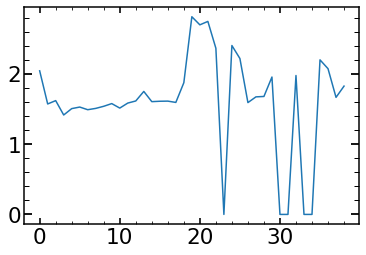

In [529]:
plt.plot(timing_list)

In [247]:
print(minchain.shape)

if len(minchain)==42 or len(minchain)==41:
    columns=columns22
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:]]),columns=columns[8:-1])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:]]),columns=columns[18:-1])
print(dfglobal2)

(41,)
          z4       z5        z6        z7       z8        z9       z10  \
0 -31.196376 -0.42702  0.339179  0.298803 -0.34489 -0.157258 -0.344048   

        z11  
0 -0.452925  
        z12       z13       z14       z15       z16       z17       z18  \
0 -0.037558 -0.027192  0.016994 -0.009543 -0.009267 -0.017973  0.019833   

        z19       z20       z21  
0 -0.003609 -0.044777 -0.031136  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.084606  0.654873   0.072384  0.030458  0.020308  0.056338     0.011235   

   radiometricEffect  radiometricExponent    x_ilum  ...  \
0       6.977437e-07         6.977660e-07  0.972701  ...   

   effective_radius_illumination  frd_sigma  frd_lorentz_factor  det_vert  \
0                       0.927305   0.095764              0.6799  1.012122   

   slitHolder_frac_dx  grating_lines  scattering_slope  scattering_amplitude  \
0           -0.147225   87585.967975          2.474004              0.002914   

  

In [246]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_cut=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut.npy')
optPsf_cut_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_downsampled.npy')
scattered_light=np.load(TESTING_FINAL_IMAGES_FOLDER+'scattered_light.npy')
optPsf_cut_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_downsampled_scattered.npy')
optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled


optPsf_cut_grating_convolved_simulation_cut=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')

In [249]:
type(optPsf_cut_fiber_convolved_downsampled[0][0])

numpy.float64

In [200]:
type(optPsf_cut[0][0])

numpy.float64

In [201]:
type(optPsf_cut_downsampled[0][0])

numpy.float64

In [154]:
np.float32(optPsf).nbytes / 1024 / 1024

36.0

In [147]:
round(optPsf.nbytes / 1024 / 1024,2)

72.0

In [146]:
from sys import getsizeof
round(getsizeof(optPsf) / 1024 / 1024,2)

72.0

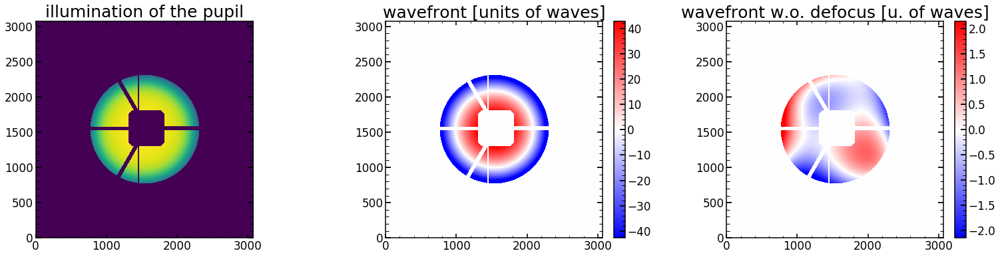

In [233]:
single_analysis.illumination_wavefront_plot()

chi**2 reduced is: 46.8146696554958
Abs of residual divided by total flux is: 0.056261828180462686
Abs of residual divided by largest value of a flux in the image is: 0.14013744706808567


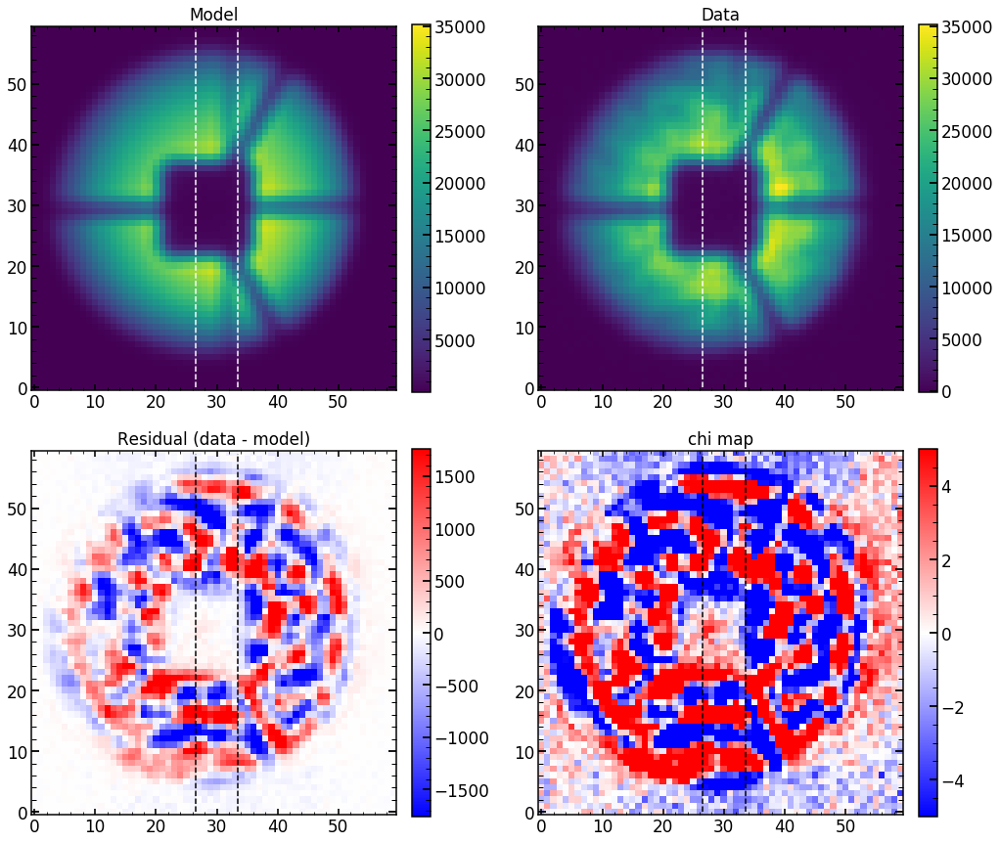

In [234]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

46.8146696554958
chi**2 reduced is: 46.8146696554958
Abs of residual divided by total flux is: 0.056261828180462686
Abs of residual divided by largest value of a flux in the image is: 0.14013744706808567


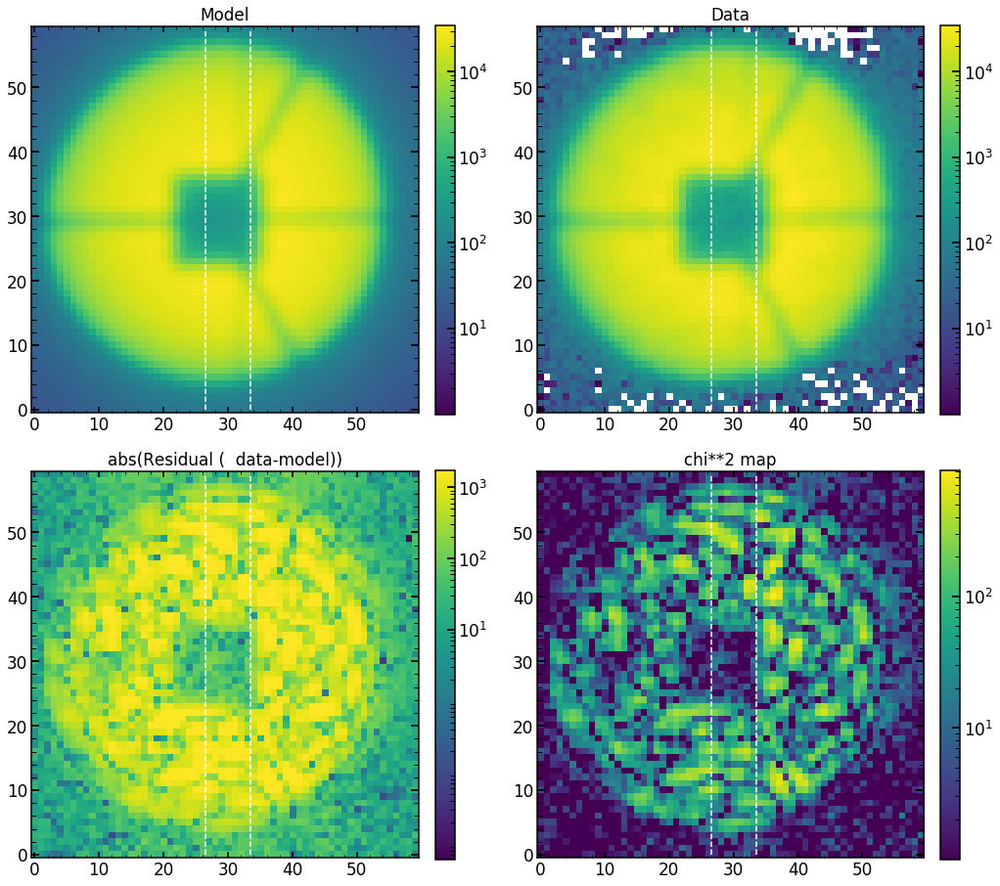

In [235]:
single_analysis.create_basic_comparison_plot_log()

46.8146696554958
chi**2 reduced is: 46.8146696554958
Abs of residual divided by total flux is: 0.056261828180462686
Abs of residual divided by largest value of a flux in the image is: 0.14013744706808567


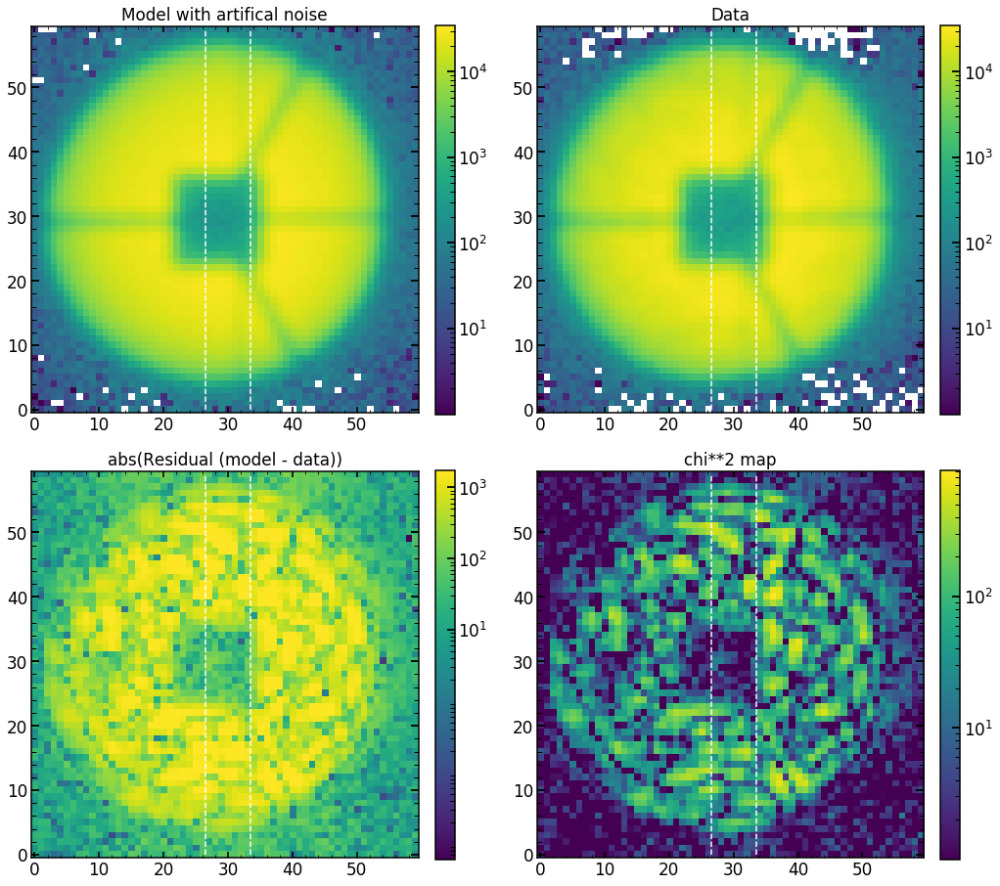

In [236]:
single_analysis.create_basic_comparison_plot_log_artifical()

## scripts 

### test 

In [414]:
list_of_HgAr_to_analyze=finalHgAr_Feb2020_dataset[finalHgAr_Feb2020_dataset['close']=='1'].index[25:28]
list_of_HgAr_to_analyze

NameError: name 'finalHgAr_Feb2020_dataset' is not defined

In [278]:
def remove(string): 
    return string.replace(" ", "")

In [279]:

for single_spot in list_of_HgAr_to_analyze:
    if str(finalHgAr_Feb2020_dataset.loc[single_spot]['close'])=='0' or str(finalHgAr_Feb2020_dataset.loc[single_spot]['close'])=='0.5':
        double_source=True
    else:
        double_source=False    
        
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/TtestS'+str(single_spot)+'Jul06.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=2 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 0:55:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, m05
    file.write("mpirun python /home/ncaplar/Code/Zernike_parameter_estimation.py -obs 21352 21358 21364 21436 21442 21448 -spot "+str(single_spot)+\
               " -nsteps 40 -eps 5 -dataset 4 -arc HgAr -double_sources "+str(double_source)+\
               " -double_sources_positions_ratios "+remove(str(list(finalHgAr_Feb2020_dataset.loc[single_spot][['second_offset','second_ratio']].values)))+\
               " -twentytwo_or_extra 22 -date_of_input Mar06 -direct_or_interpolation direct -date_of_output Jul06 -analysis_type defocus \n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/Jul06ScriptToSubmitScriptsTigertest'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/TtestS'+str(single_spot)+'Jul06.sh \n')

file.close()

### HgAr - first run, semitest

In [261]:
list_of_HgAr_to_analyze=finalHgAr_Feb2020_dataset[finalHgAr_Feb2020_dataset['close']=='1'].index
list_of_HgAr_to_analyze

Int64Index([  1,   3,   6,   9,  11,  13,  15,  18,  21,  23,  25,  27,  30,
             33,  35,  37,  39,  42,  45,  47,  49,  51,  54,  57,  59,  61,
             63,  66,  69,  71,  73,  75,  78,  81,  83,  85,  87,  90,  93,
             95,  97,  99, 102, 105, 107, 109, 111, 114, 117, 119],
           dtype='int64')

In [267]:
len(list_of_HgAr_to_analyze)

50

In [264]:
def remove(string): 
    return string.replace(" ", "")

In [274]:
#list_of_obs=[21352 21358 21364 21436 21442 21448 ]


for single_spot in list_of_HgAr_to_analyze[25:28]:
    if str(finalHgAr_Feb2020_dataset.loc[single_spot]['close'])=='0' or str(finalHgAr_Feb2020_dataset.loc[single_spot]['close'])=='0.5':
        double_source=True
    else:
        double_source=False    
        
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01S'+str(single_spot)+'Jul06.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=5 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 4:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, m05
    file.write("mpirun python /home/ncaplar/Code/Zernike_parameter_estimation.py -obs 21352 21358 21364 21436 21442 21448 -spot "+str(single_spot)+\
               " -nsteps 40 -eps 5 -dataset 4 -arc HgAr -double_sources "+str(double_source)+\
               " -double_sources_positions_ratios "+remove(str(list(finalHgAr_Feb2020_dataset.loc[single_spot][['second_offset','second_ratio']].values)))+\
               " -twentytwo_or_extra 22 -date_of_input Mar06 -direct_or_interpolation direct -date_of_output Jul06 -analysis_type defocus \n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/Jul06ScriptToSubmitScriptsTiger01'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T01S'+str(single_spot)+'Jul06.sh \n')

file.close()

In [ ]:
/home/ncaplar/Code/Zernike_parameter_estimation.py -obs 21352 21358 21364 21436 21442 21448  -spot 78 -nsteps 40 -eps 2 -dataset 4 -arc HgAr -double_sources False -double_sources_positions_ratios [-13.14,0.011] -twentytwo_or_extra 22 -date_of_input Mar06 -direct_or_interpolation direct -date_of_output Jul04 -analysis_type defocus

In [373]:
import threading

In [376]:
threading.get_ident()

4560729536

In [659]:
lines=[]
filepath = '/Users/nevencaplar/Documents/PFS/TigerAnalysis/SlurmFiles/Tiger/slurm-4976806.out'
with open(filepath) as fp:
   line = fp.readline()
   cnt = 0
   while line:
       lines.append("Line {}: {}".format(cnt, line.strip()))
       line = fp.readline()
       cnt += 1

In [682]:
list_of_threading=[]
list_of_starting=[]
list_of_ending=[]

list_of_lines_starting=[]
list_of_lines_ending=[]

for i in tqdm(range(len(lines))):
    try:
        index_threading=lines[i].index('threading')
        print(lines[i][index_threading-10:])
        list_of_threading.append([i,lines[i][index_threading-10:]])
    except:
        pass 
    
    try:    
        index_starting=lines[i].index('Starting LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_starting:]])
        lines_starting=lines[i]
        list_of_lines_starting.append(lines_starting)
        
        #list_of_starting.append([i,lines[i][index_starting+51:index_starting+71].replace(" ", "") ,lines[i][index_starting+74:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    try:            
        index_ending=lines[i].index('Ending LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_ending:]])
        list_of_lines_ending.append(lines[i])
        
        
        #list_of_ending.append([i,lines[i][index_starting+50:index_starting+70].replace(" ", "") ,lines[i][index_ending+72:].replace("t", "").replace(" ", "") ])
    except:
        pass 


  3%|▉                             | 43685/1411701 [00:00<00:03, 436845.21it/s]

[83, 'Starting LN_PFS_multi_same_spot for parameters-hash -3316811773223652977 at 1594159656.2558074 in thread 46994819628672']
[359, 'Ending LN_PFS_multi_same_spot for parameters-hash -3316811773223652977 at 1594159661.313722 in thread 46994819628672']
[384, 'Starting LN_PFS_multi_same_spot for parameters-hash -6754149352283619446 at 1594159661.4170737 in thread 47343725706880']
[531, 'Starting LN_PFS_multi_same_spot for parameters-hash -873693072344259828 at 1594159661.3837163 in thread 46956385144448']
[679, 'Starting LN_PFS_multi_same_spot for parameters-hash 1485533558270383613 at 1594159661.350383 in thread 46917924490880']
[826, 'Starting LN_PFS_multi_same_spot for parameters-hash 1173264925859159577 at 1594159661.3513277 in thread 47727446003328']
[975, 'Starting LN_PFS_multi_same_spot for parameters-hash 5585553544558174253 at 1594159661.3832853 in thread 47799848779392']
[1124, 'Starting LN_PFS_multi_same_spot for parameters-hash -7348997619924989003 at 1594159661.354013 in t

 10%|██▉                          | 143035/1411701 [00:00<00:03, 364242.26it/s]

[68759, 'Ending LN_PFS_multi_same_spot for parameters-hash -7830294411812811593 at 1594159680.5985658 in thread 47877597941376']
812811593/threading: 47877597941376
[68777, 'Starting LN_PFS_multi_same_spot for parameters-hash -7830294411812811593 at 1594159681.092979 in thread 47877597941376']
[68898, 'Ending LN_PFS_multi_same_spot for parameters-hash -2453531133108078398 at 1594159681.006967 in thread 47531352391296']
108078398/threading: 47531352391296
[68916, 'Starting LN_PFS_multi_same_spot for parameters-hash -2453531133108078398 at 1594159681.0935018 in thread 47531352391296']
[69044, 'Ending LN_PFS_multi_same_spot for parameters-hash -8421043086378484973 at 1594159681.0320034 in thread 47670182194816']
378484973/threading: 47670182194816
[69062, 'Starting LN_PFS_multi_same_spot for parameters-hash -8421043086378484973 at 1594159681.093788 in thread 47670182194816']
[69179, 'Ending LN_PFS_multi_same_spot for parameters-hash 3369416544932659572 at 1594159680.6986725 in thread 4793

 15%|████▍                        | 218659/1411701 [00:00<00:03, 372299.09it/s]

[143268, 'Ending LN_PFS_multi_same_spot for parameters-hash 7918919883335304046 at 1594159705.1648154 in thread 47660491460224']
335304046/threading: 47660491460224
[143286, 'Starting LN_PFS_multi_same_spot for parameters-hash 7918919883335304046 at 1594159706.0288513 in thread 47660491460224']
[143401, 'Ending LN_PFS_multi_same_spot for parameters-hash -7830294411812811593 at 1594159703.727527 in thread 47877597941376']
812811593/threading: 47877597941376
[143419, 'Starting LN_PFS_multi_same_spot for parameters-hash -7830294411812811593 at 1594159706.0196304 in thread 47877597941376']
[143522, 'Ending LN_PFS_multi_same_spot for parameters-hash 5060115900602472946 at 1594159704.0535789 in thread 46962981289600']
602472946/threading: 46962981289600
[143540, 'Starting LN_PFS_multi_same_spot for parameters-hash 5060115900602472946 at 1594159706.0210273 in thread 46962981289600']
[143660, 'Ending LN_PFS_multi_same_spot for parameters-hash -4970774712890455653 at 1594159703.7788537 in threa

 22%|██████▎                      | 306717/1411701 [00:00<00:02, 405206.14it/s]

108078398/threading: 47531352391296
[219900, 'Starting LN_PFS_multi_same_spot for parameters-hash -2453531133108078398 at 1594159724.6216896 in thread 47531352391296']
[220039, 'Ending LN_PFS_multi_same_spot for parameters-hash -21849558553230587 at 1594159723.705393 in thread 47174393323136']
553230587/threading: 47174393323136
[220057, 'Starting LN_PFS_multi_same_spot for parameters-hash -21849558553230587 at 1594159724.6394982 in thread 47174393323136']
[220311, 'Ending LN_PFS_multi_same_spot for parameters-hash 7918919883335304046 at 1594159723.8064733 in thread 47660491460224']
335304046/threading: 47660491460224
[220329, 'Starting LN_PFS_multi_same_spot for parameters-hash 7918919883335304046 at 1594159724.630236 in thread 47660491460224']
[220454, 'Ending LN_PFS_multi_same_spot for parameters-hash -8421043086378484973 at 1594159723.6143436 in thread 47670182194816']
378484973/threading: 47670182194816
[220472, 'Starting LN_PFS_multi_same_spot for parameters-hash -842104308637848

 28%|████████▏                    | 395663/1411701 [00:01<00:02, 423400.06it/s]

[309144, 'Starting LN_PFS_multi_same_spot for parameters-hash 3882691768319378706 at 1594159762.4223073 in thread 47281773960832']
[309280, 'Ending LN_PFS_multi_same_spot for parameters-hash 5060115900602472946 at 1594159762.3054643 in thread 46962981289600']
[309281, 'Starting LN_PFS_multi_same_spot for parameters-hash 5060115900602472946 at 1594159762.4227674 in thread 46962981289600']
[309421, 'Ending LN_PFS_multi_same_spot for parameters-hash 125183432581761347 at 1594159761.143746 in thread 47448999943808']
[309422, 'Starting LN_PFS_multi_same_spot for parameters-hash 125183432581761347 at 1594159762.4230075 in thread 47448999943808']
[309547, 'Ending LN_PFS_multi_same_spot for parameters-hash 3369416544932659572 at 1594159762.37231 in thread 47936923823744']
[309548, 'Starting LN_PFS_multi_same_spot for parameters-hash 3369416544932659572 at 1594159762.4233358 in thread 47936923823744']
[309689, 'Ending LN_PFS_multi_same_spot for parameters-hash -3525770869873834514 at 1594159762

 37%|██████████▊                  | 527883/1411701 [00:01<00:02, 434617.15it/s]

[419353, 'Starting LN_PFS_multi_same_spot for parameters-hash -4103266842728758538 at 1594159824.7388802 in thread 47761947500160']
[419502, 'Ending LN_PFS_multi_same_spot for parameters-hash 3962096851574525292 at 1594159822.950499 in thread 46995715624576']
[419503, 'Starting LN_PFS_multi_same_spot for parameters-hash 3962096851574525292 at 1594159824.7392251 in thread 46995715624576']
[419618, 'Ending LN_PFS_multi_same_spot for parameters-hash 5240745810302087801 at 1594159823.18659 in thread 47527613832832']
[419619, 'Starting LN_PFS_multi_same_spot for parameters-hash 5240745810302087801 at 1594159824.7387247 in thread 47527613832832']
[419740, 'Ending LN_PFS_multi_same_spot for parameters-hash -7348997619924989003 at 1594159822.2871559 in thread 47329287552640']
[419741, 'Starting LN_PFS_multi_same_spot for parameters-hash -7348997619924989003 at 1594159824.7373857 in thread 47329287552640']
[419869, 'Ending LN_PFS_multi_same_spot for parameters-hash -7545532323490814714 at 15941

 43%|████████████▌                | 613325/1411701 [00:01<00:01, 413704.29it/s]

[529430, 'Ending LN_PFS_multi_same_spot for parameters-hash -7545532323490814714 at 1594159879.2562363 in thread 47356766252672']
[529696, 'Ending LN_PFS_multi_same_spot for parameters-hash -7998868387048776635 at 1594159879.2771993 in thread 47891212344960']
[529824, 'Ending LN_PFS_multi_same_spot for parameters-hash -661536261986970218 at 1594159879.278111 in thread 47030470381184']
[529957, 'Ending LN_PFS_multi_same_spot for parameters-hash 1173264925859159577 at 1594159879.2943099 in thread 47727446003328']
[530224, 'Ending LN_PFS_multi_same_spot for parameters-hash 1905527042989689954 at 1594159879.3466592 in thread 46918146956928']
[530887, 'Ending LN_PFS_multi_same_spot for parameters-hash -21849558553230587 at 1594159879.4585965 in thread 47174393323136']
[531832, 'Ending LN_PFS_multi_same_spot for parameters-hash 4852746594992858568 at 1594159879.5294192 in thread 46985891683968']
[531961, 'Ending LN_PFS_multi_same_spot for parameters-hash 2146904181286742511 at 1594159879.543

 49%|██████████████▎              | 695215/1411701 [00:01<00:01, 394543.43it/s]


[614129, 'Ending LN_PFS_multi_same_spot for parameters-hash 7554582663827571586 at 1594159898.776719 in thread 47299883470464']
827571586/threading: 47299883470464
[614147, 'Starting LN_PFS_multi_same_spot for parameters-hash 7554582663827571586 at 1594159899.0533223 in thread 47299883470464']
[614265, 'Ending LN_PFS_multi_same_spot for parameters-hash 3962096851574525292 at 1594159898.4394188 in thread 46995715624576']
574525292/threading: 46995715624576
[614283, 'Starting LN_PFS_multi_same_spot for parameters-hash 3962096851574525292 at 1594159899.0579062 in thread 46995715624576']
[614402, 'Ending LN_PFS_multi_same_spot for parameters-hash 4581814740358277620 at 1594159898.2404685 in thread 47941712785024']
358277620/threading: 47941712785024
[614420, 'Starting LN_PFS_multi_same_spot for parameters-hash 4581814740358277620 at 1594159899.0605133 in thread 47941712785024']
[614542, 'Ending LN_PFS_multi_same_spot for parameters-hash -5375725730450031721 at 1594159898.0836244 in thread

 52%|███████████████              | 734750/1411701 [00:01<00:01, 392785.75it/s]

[695293, 'Ending LN_PFS_multi_same_spot for parameters-hash 4715313701305394310 at 1594159917.8623967 in thread 47437474897536']
305394310/threading: 47437474897536
[695311, 'Starting LN_PFS_multi_same_spot for parameters-hash 4715313701305394310 at 1594159918.0998752 in thread 47437474897536']
183696275/threading: 47045067574912
[695423, 'Starting LN_PFS_multi_same_spot for parameters-hash -6607718028183696275 at 1594159918.1018727 in thread 47045067574912']
[695573, 'Ending LN_PFS_multi_same_spot for parameters-hash 3708921611866298387 at 1594159917.5941818 in thread 47279417663104']
866298387/threading: 47279417663104
[695591, 'Starting LN_PFS_multi_same_spot for parameters-hash 3708921611866298387 at 1594159918.106835 in thread 47279417663104']
[695709, 'Ending LN_PFS_multi_same_spot for parameters-hash 7554582663827571586 at 1594159917.945608 in thread 47299883470464']
827571586/threading: 47299883470464
[695727, 'Starting LN_PFS_multi_same_spot for parameters-hash 755458266382757

 61%|█████████████████▌           | 856344/1411701 [00:02<00:01, 389609.84it/s]


[771604, 'Starting LN_PFS_multi_same_spot for parameters-hash -1527274169939603617 at 1594159937.188994 in thread 47522478489216']
[772711, 'Starting LN_PFS_multi_same_spot for parameters-hash -5694566549509092301 at 1594159937.1764672 in thread 47994926628480']
361017018/threading: 47026014170752
[772987, 'Starting LN_PFS_multi_same_spot for parameters-hash -2412471301361017018 at 1594159937.1904657 in thread 47026014170752']
768367340/threading: 47305014021760
[773256, 'Starting LN_PFS_multi_same_spot for parameters-hash 7647040960768367340 at 1594159937.191955 in thread 47305014021760']
783611894/threading: 48010407005824
[773787, 'Starting LN_PFS_multi_same_spot for parameters-hash 1525854437783611894 at 1594159937.1879814 in thread 48010407005824']
822975537/threading: 47546071617152
[773938, 'Starting LN_PFS_multi_same_spot for parameters-hash 6076381925822975537 at 1594159937.181996 in thread 47546071617152']
139806269/threading: 47848258936448
[774196, 'Starting LN_PFS_multi_s

 66%|███████████████████▏         | 934963/1411701 [00:02<00:01, 388455.62it/s]

[858274, 'Ending LN_PFS_multi_same_spot for parameters-hash 1182531270077361932 at 1594159965.3647962 in thread 47714208075392']
[858673, 'Ending LN_PFS_multi_same_spot for parameters-hash -7545532323490814714 at 1594159965.394631 in thread 47356766252672']
[859605, 'Ending LN_PFS_multi_same_spot for parameters-hash -7531207225780666990 at 1594159965.4860702 in thread 47715230445184']
780666990/threading: 47715230445184
[860138, 'Ending LN_PFS_multi_same_spot for parameters-hash 5585553544558174253 at 1594159965.562496 in thread 47799848779392']
[861073, 'Ending LN_PFS_multi_same_spot for parameters-hash -8011214833890612741 at 1594159965.6182344 in thread 47196281831040']
[861337, 'Ending LN_PFS_multi_same_spot for parameters-hash 936941463628224822 at 1594159965.6531491 in thread 47617965047424']
[861593, 'Ending LN_PFS_multi_same_spot for parameters-hash 9084383185262085579 at 1594159965.6629696 in thread 47083205975680']
[862255, 'Ending LN_PFS_multi_same_spot for parameters-hash -

 72%|████████████████████▏       | 1014859/1411701 [00:02<00:01, 391768.00it/s]


[937332, 'Ending LN_PFS_multi_same_spot for parameters-hash -1527274169939603617 at 1594159984.9316437 in thread 47522478489216']
939603617/threading: 47522478489216
[937350, 'Starting LN_PFS_multi_same_spot for parameters-hash -1527274169939603617 at 1594159985.3071237 in thread 47522478489216']
[937467, 'Ending LN_PFS_multi_same_spot for parameters-hash 8561694636435338180 at 1594159984.6081457 in thread 47503365172864']
435338180/threading: 47503365172864
[937485, 'Starting LN_PFS_multi_same_spot for parameters-hash 8561694636435338180 at 1594159985.300374 in thread 47503365172864']
[937608, 'Ending LN_PFS_multi_same_spot for parameters-hash 2146904181286742511 at 1594159984.8588612 in thread 47055767457408']
286742511/threading: 47055767457408
[937626, 'Starting LN_PFS_multi_same_spot for parameters-hash 2146904181286742511 at 1594159985.3076658 in thread 47055767457408']
[937755, 'Ending LN_PFS_multi_same_spot for parameters-hash 5110823086764394042 at 1594159985.0654054 in threa

 78%|█████████████████████▋      | 1094553/1411701 [00:02<00:00, 384442.59it/s]


[1018146, 'Ending LN_PFS_multi_same_spot for parameters-hash -3102752131206767327 at 1594160003.9706657 in thread 47761714863744']
206767327/threading: 47761714863744
[1018164, 'Starting LN_PFS_multi_same_spot for parameters-hash -3102752131206767327 at 1594160004.51467 in thread 47761714863744']
[1018292, 'Ending LN_PFS_multi_same_spot for parameters-hash 5060115900602472946 at 1594160004.2013278 in thread 46962981289600']
602472946/threading: 46962981289600
[1018310, 'Starting LN_PFS_multi_same_spot for parameters-hash 5060115900602472946 at 1594160004.514775 in thread 46962981289600']
[1018566, 'Ending LN_PFS_multi_same_spot for parameters-hash 6787893141527601390 at 1594160004.3089657 in thread 47320176217728']
527601390/threading: 47320176217728
[1018584, 'Starting LN_PFS_multi_same_spot for parameters-hash 6787893141527601390 at 1594160004.5209668 in thread 47320176217728']
[1018705, 'Ending LN_PFS_multi_same_spot for parameters-hash -5637770939829037689 at 1594160004.251986 in 

 83%|███████████████████████▎    | 1176430/1411701 [00:02<00:00, 396470.80it/s]


[1123532, 'Starting LN_PFS_multi_same_spot for parameters-hash 7647040960768367340 at 1594160033.2827134 in thread 47305014021760']
[1123646, 'Ending LN_PFS_multi_same_spot for parameters-hash -8011214833890612741 at 1594160033.071111 in thread 47196281831040']
890612741/threading: 47196281831040
[1123664, 'Starting LN_PFS_multi_same_spot for parameters-hash -8011214833890612741 at 1594160033.2687893 in thread 47196281831040']
[1123781, 'Ending LN_PFS_multi_same_spot for parameters-hash 926735574183260318 at 1594160032.894037 in thread 47336315874944']
183260318/threading: 47336315874944
[1123799, 'Starting LN_PFS_multi_same_spot for parameters-hash 926735574183260318 at 1594160033.2714953 in thread 47336315874944']
[1123919, 'Ending LN_PFS_multi_same_spot for parameters-hash -6607718028183696275 at 1594160032.538803 in thread 47045067574912']
183696275/threading: 47045067574912
[1123937, 'Starting LN_PFS_multi_same_spot for parameters-hash -6607718028183696275 at 1594160033.2790022 i

 89%|█████████████████████████   | 1261706/1411701 [00:03<00:00, 406906.42it/s]

[1202923, 'Starting LN_PFS_multi_same_spot for parameters-hash 4852746594992858568 at 1594160052.421394 in thread 46985891683968']
380132379/threading: 47815435488896
[1203175, 'Starting LN_PFS_multi_same_spot for parameters-hash 5405175250380132379 at 1594160052.4105024 in thread 47815435488896']
[1203314, 'Ending LN_PFS_multi_same_spot for parameters-hash -3525770869873834514 at 1594160052.3982484 in thread 47455720394368']
873834514/threading: 47455720394368
[1203332, 'Starting LN_PFS_multi_same_spot for parameters-hash -3525770869873834514 at 1594160052.4091978 in thread 47455720394368']
[1203457, 'Ending LN_PFS_multi_same_spot for parameters-hash -7438022095281199911 at 1594160051.2428126 in thread 46977345814144']
281199911/threading: 46977345814144
[1203475, 'Starting LN_PFS_multi_same_spot for parameters-hash -7438022095281199911 at 1594160052.4150162 in thread 46977345814144']
[1203596, 'Ending LN_PFS_multi_same_spot for parameters-hash 6787893141527601390 at 1594160051.210673

 95%|██████████████████████████▋ | 1346414/1411701 [00:03<00:00, 409750.97it/s]


[1293145, 'Ending LN_PFS_multi_same_spot for parameters-hash 8561694636435338180 at 1594160080.5841308 in thread 47503365172864']
[1293271, 'Ending LN_PFS_multi_same_spot for parameters-hash 2791600243701142464 at 1594160080.5919037 in thread 47029407338112']
[1293676, 'Ending LN_PFS_multi_same_spot for parameters-hash 726870453556817964 at 1594160080.6103795 in thread 47567957483136']
[1293932, 'Ending LN_PFS_multi_same_spot for parameters-hash 4846090532431381341 at 1594160080.604475 in thread 47421520760448']
[1294197, 'Ending LN_PFS_multi_same_spot for parameters-hash 5240745810302087801 at 1594160080.6143212 in thread 47527613832832']
[1294869, 'Ending LN_PFS_multi_same_spot for parameters-hash -5694566549509092301 at 1594160080.6867115 in thread 47994926628480']
[1294987, 'Ending LN_PFS_multi_same_spot for parameters-hash -7191157558538547113 at 1594160080.7013676 in thread 47166603058816']
538547113/threading: 47166603058816
[1295249, 'Ending LN_PFS_multi_same_spot for paramete

100%|████████████████████████████| 1411701/1411701 [00:03<00:00, 400472.20it/s]


[1382960, 'Starting LN_PFS_multi_same_spot for parameters-hash -8011214833890612741 at 1594160122.1083407 in thread 47196281831040']
[1383396, 'Ending LN_PFS_multi_same_spot for parameters-hash 7241303183147462466 at 1594160121.8647099 in thread 47595204972160']
[1383397, 'Starting LN_PFS_multi_same_spot for parameters-hash 7241303183147462466 at 1594160122.1111934 in thread 47595204972160']
[1383526, 'Ending LN_PFS_multi_same_spot for parameters-hash -7519595209331261782 at 1594160121.8661633 in thread 47272984407680']
[1383527, 'Starting LN_PFS_multi_same_spot for parameters-hash -7519595209331261782 at 1594160122.112035 in thread 47272984407680']
[1383653, 'Ending LN_PFS_multi_same_spot for parameters-hash -4684576435240307803 at 1594160120.8821416 in thread 47898769469056']
[1383654, 'Starting LN_PFS_multi_same_spot for parameters-hash -4684576435240307803 at 1594160122.1133273 in thread 47898769469056']
[1383813, 'Ending LN_PFS_multi_same_spot for parameters-hash -563777093982903

In [683]:
for i in range(len(list_of_lines_starting)):
    print(list_of_lines_starting[i])

Line 83: Starting LN_PFS_multi_same_spot for parameters-hash -3316811773223652977 at 1594159656.2558074 in thread 46994819628672
Line 384: Starting LN_PFS_multi_same_spot for parameters-hash -6754149352283619446 at 1594159661.4170737 in thread 47343725706880
Line 531: Starting LN_PFS_multi_same_spot for parameters-hash -873693072344259828 at 1594159661.3837163 in thread 46956385144448
Line 679: Starting LN_PFS_multi_same_spot for parameters-hash 1485533558270383613 at 1594159661.350383 in thread 46917924490880
Line 826: Starting LN_PFS_multi_same_spot for parameters-hash 1173264925859159577 at 1594159661.3513277 in thread 47727446003328
Line 975: Starting LN_PFS_multi_same_spot for parameters-hash 5585553544558174253 at 1594159661.3832853 in thread 47799848779392
Line 1124: Starting LN_PFS_multi_same_spot for parameters-hash -7348997619924989003 at 1594159661.354013 in thread 47329287552640
Line 1272: Starting LN_PFS_multi_same_spot for parameters-hash 4581814740358277620 at 1594159661

Line 509670: Starting LN_PFS_multi_same_spot for parameters-hash 5240745810302087801 at 1594159870.2980573 in thread 47527613832832
Line 509807: Starting LN_PFS_multi_same_spot for parameters-hash -2475919939740051867 at 1594159861.0536377 in thread 47175096823424
Line 509838: Starting LN_PFS_multi_same_spot for parameters-hash -2475919939740051867 at 1594159870.2915552 in thread 47175096823424
Line 509983: Starting LN_PFS_multi_same_spot for parameters-hash 6076381925822975537 at 1594159870.2981496 in thread 47546071617152
Line 510124: Starting LN_PFS_multi_same_spot for parameters-hash 4021141855036133650 at 1594159870.3051822 in thread 47265053593216
Line 510259: Starting LN_PFS_multi_same_spot for parameters-hash 3545057615905544610 at 1594159870.30681 in thread 47085284454016
Line 510401: Starting LN_PFS_multi_same_spot for parameters-hash 926735574183260318 at 1594159870.2947214 in thread 47336315874944
Line 510529: Starting LN_PFS_multi_same_spot for parameters-hash 502933514369

In [681]:
"""
for l in range(len(list_of_lines_starting)):
    print(l)
    list_of_starting.append([int(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),\
                            int(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at')-1]),\
                            float(list_of_lines_starting[l][list_of_lines_starting[l].index('at')+3:list_of_lines_starting[l].index('in thread')-1]),\
                            int(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:])])
    
for l in range(len(list_of_lines_ending)):
    list_of_ending.append([int(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),\
                            int(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at')-1]),\
                            float(list_of_lines_ending[l][list_of_lines_ending[l].index('at')+3:list_of_lines_ending[l].index('in thread')-1]),\
                            int(list_of_lines_ending[l][list_of_lines_ending[l].index('in thread')+10:])])
    
array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)
"""

"\nfor l in range(len(list_of_lines_starting)):\n    print(l)\n    list_of_starting.append([int(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),                            int(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at')-1]),                            float(list_of_lines_starting[l][list_of_lines_starting[l].index('at')+3:list_of_lines_starting[l].index('in thread')-1]),                            int(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:])])\n    \nfor l in range(len(list_of_lines_ending)):\n    list_of_ending.append([int(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),                            int(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at')-1]),                            float(list_of_lines_ending[l][list_of_lines_endi

In [684]:
for l in range(len(list_of_lines_starting)):
    list_of_starting.append([str(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('at')+3:list_of_lines_starting[l].index('in thread')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])
    
for l in range(len(list_of_lines_ending)):
    list_of_ending.append([str(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('at')+3:list_of_lines_ending[l].index('in thread')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])
    
array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)

In [685]:
array_of_starting.shape

(5041, 4)

In [686]:
array_of_ending.shape

(4623, 4)

In [602]:
array_of_starting_single_ending=array_of_starting[array_of_starting[:,1]==array_of_ending[170][1]]

In [603]:
array_of_starting_single_ending

array([['1717', '-3248138429071359021', '1594153353.0553372',
        '47027363188352'],
       ['25112', '-3248138429071359021', '1594153362.49028',
        '47027363188352'],
       ['37950', '-3248138429071359021', '1594153371.4620955',
        '47027363188352'],
       ['54461', '-3248138429071359021', '1594153380.5812995',
        '47027363188352'],
       ['81769', '-3248138429071359021', '1594153389.9872363',
        '47027363188352'],
       ['99567', '-3248138429071359021', '1594153399.229473',
        '47027363188352'],
       ['104453', '-3248138429071359021', '1594153404.9892912',
        '47027363188352'],
       ['122115', '-3248138429071359021', '1594153414.8336558',
        '47027363188352'],
       ['153444', '-3248138429071359021', '1594153425.5412207',
        '47027363188352'],
       ['166942', '-3248138429071359021', '1594153434.6080217',
        '47027363188352'],
       ['174494', '-3248138429071359021', '1594153434.6146612',
        '47027363188352'],
       ['

In [570]:
lines[1180241]

'Line 1180241: Starting LN_PFS_multi_same_spot for parameters-hash 2509000407696947564 at 1594153963.4860334 in thread 46934396255872'

In [579]:
Swarm1=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgArSwarm1.npy')
Swarm2=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgArSwarm2.npy')
Emcee2=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgArEmcee2.npy')
Emcee3=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgArEmcee3.npy')

In [623]:
Swarm1

array([[[ -7.65036562,   0.12296992,   0.06099676, ...,   0.00263762,
           0.37263931,   1.79574275],
        [ -7.85607134,   0.24401575,   0.29319746, ...,   0.00198152,
           0.37059901,   1.79685313],
        [ -8.35496042,   0.36526902,  -0.00242404, ...,   0.00222507,
           0.39753263,   1.7918397 ],
        ...,
        [ -7.437309  ,   0.064486  ,   0.05728964, ...,   0.00272476,
           0.37036171,   1.79571741],
        [ -7.93558037,   0.01996525,   0.04972306, ...,   0.00261291,
           0.3782339 ,   1.79575397],
        [ -5.44888397,  -0.36933926,   0.06415624, ...,   0.00244995,
           0.36333508,   1.80290646]],

       [[ -7.65036562,   0.12296992,   0.06099676, ...,   0.00263762,
           0.37263931,   1.79574275],
        [ -7.27213964,  -0.0429087 ,   0.09072592, ...,   0.00347771,
           0.37722697,   1.7884557 ],
        [ -6.89565324,   0.10351742,   0.12012534, ...,   0.00099809,
           0.36902389,   1.77969687],
        ...,


In [580]:
likeSwarm1=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/likechainJul0620_Single_P_21448617HgArSwarm1.npy')
likeSwarm2=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/likechainJul0620_Single_P_21448617HgArSwarm2.npy')
likeEmcee2=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/likechainJul0620_Single_P_21448617HgArEmcee2.npy')
likeEmcee3=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/likechainJul0620_Single_P_21448617HgArEmcee3.npy')

In [581]:
print(Swarm1.shape)
print(Swarm2.shape)
print(Emcee2.shape)
print(Emcee3.shape)

(7, 120, 60)
(21, 120, 60)
(120, 7, 60)
(120, 3, 60)


In [582]:
len(list_of_threading)

3600

In [589]:
((7+1)+(21+1))*120

3600

In [590]:
((7+1)+(3+1))*120

1440

In [592]:
3600+1440+1

5041

In [473]:
3600/40

90.0

In [462]:
38*120

4560

In [583]:
len(list_of_starting)

5041

In [584]:
len(list_of_ending)

4622

In [463]:
5040/120

42.0

In [585]:
len(likeSwarm1.ravel()[likeSwarm1.ravel()!=-np.inf])+len(likeSwarm2.ravel()[likeSwarm2.ravel()!=-np.inf])+\
len(likeEmcee2.ravel()[likeEmcee2.ravel()!=-np.inf])+len(likeEmcee3.ravel()[likeEmcee3.ravel()!=-np.inf])

4373

In [484]:
list(np.array(list_of_starting)[:,1]).index(' 3800531422022088812')

388

In [500]:
array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)

In [491]:
list_of_ending

[[359, '4932184856020444376', '1594090466.4189262'],
 [12446, '-1457629065248663637', '1594090475.3677516'],
 [15040, '7103973370683276762', '1594090475.627123'],
 [18850, '6954070044384574677', '1594090475.8256125'],
 [20634, '-2701963208026876859', '1594090475.9420114'],
 [22958, '-4745676668365622133', '1594090475.8941636'],
 [23092, '-1943307434043070713', '1594090475.5810285'],
 [23251, '-5437896159765434593', '1594090475.7608242'],
 [23525, '5450123371482950169', '1594090475.8871605'],
 [23663, '-7010391666175354046', '1594090475.9415097'],
 [23816, '54930492042557624at', '594090476.0358047'],
 [23945, '5670528825390708265', '1594090475.918022'],
 [24092, '3057374925906618623', '1594090475.9450142'],
 [24253, '1999447498425442852', '1594090475.9610326'],
 [24361, '-2044839236679033828', '1594090476.00244'],
 [24520, '-386066814648934795', '1594090475.649923'],
 [24655, '-194442968306646019', '1594090475.8644478'],
 [24813, '-2825672190409061569', '1594090475.7523842'],
 [24941, '

In [516]:
lines[74014]

'Line 74014: current_process is: <_MainProcess(MainProcess, started)>-5050622.827575802'

In [515]:
list_of_threading

[[12448, ' 47040640257664'],
 [15042, ' 47423303732864'],
 [18852, ' 47836811251328'],
 [20636, ' 47469694340736'],
 [22960, ' 47252980715136'],
 [23094, ' 47241945558656'],
 [23253, ' 47027875081856'],
 [23527, ' 47415505358464'],
 [23665, ' 47094004162176'],
 [23818, ' 47400901443200'],
 [23947, ' 47771424611968'],
 [24094, ' 46932952911488'],
 [24255, ' 47126484967040'],
 [24363, ' 47163470450304'],
 [24522, ' 47383921614464'],
 [24657, ' 47234807307904'],
 [24815, ' 47795869630080'],
 [24943, ' 47622853095040'],
 [25211, ' 47082966277760'],
 [25345, ' 47902936600192'],
 [25493, ' 47417499000448'],
 [25643, ' 47643306421888'],
 [25795, ' 47230475812480'],
 [25908, ' 47527335599744'],
 [26066, ' 47566885838464'],
 [26203, ' 46972867858048'],
 [26344, ' 47213811605120'],
 [26485, ' 47273009323648'],
 [26627, ' 47488061562496'],
 [26765, ' 47537593302656'],
 [27037, ' 46926283148928'],
 [27172, ' 47317103021696'],
 [27334, ' 47284953443968'],
 [27459, ' 47123359317632'],
 [27618, ' 469

In [502]:
list_of_matched=[]
for i in range(len(array_of_ending)):
    list_of_matched.append([array_of_ending[i],array_of_starting[array_of_starting[:,1]==array_of_ending[i][1]]])
    

In [514]:
list_of_matched[1700]

[array(['529428', '4802332783640863298', '1594090749.3109474'],
       dtype='<U35'),
 array([['529431', '4802332783640863298', '1594090750.7377584'],
        ['565180', '4802332783640863298', '1594090768.8099222']],
       dtype='<U52')]

In [521]:
PFSLikelihoodModule(model)

NameError: name 'PFSLikelihoodModule' is not defined

In [612]:
starting_threads=np.unique(array_of_starting[:,3])

In [613]:
len(starting_threads)

80

In [631]:
array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[55]]

len(array_of_starting_single_thread)

63

In [622]:
np.unique(array_of_starting[:,1]).shape

(80,)

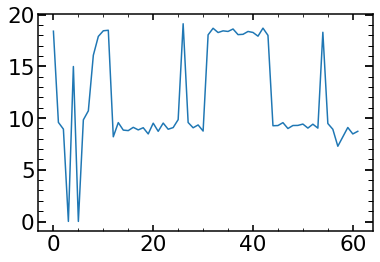

In [630]:
plt.plot(np.diff(array_of_starting_single_thread[:,2].astype(float)))

#### 4 nodes 

Text(0, 0.5, 'time [sec]')

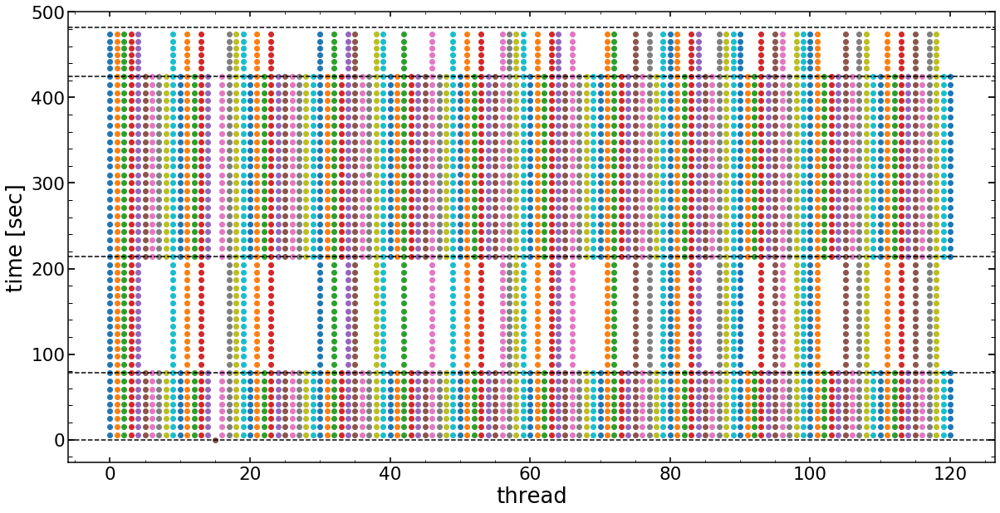

In [701]:
starting_threads=np.unique(array_of_starting[:,3])
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620/chainJul0620_Single_P_21448617HgAr_list_of_times.npy')
min_time=np.min(array_of_starting[:,2].astype(float))

plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_starting_single_thread[:,2]))*i,array_of_starting_single_thread[:,2].astype(float)-min_time)
    
plt.axhline(0,color='black',ls='--')   
plt.axhline(list_of_times[0],color='black',ls='--')
plt.axhline(list_of_times[1],color='black',ls='--')
plt.axhline(list_of_times[2],color='black',ls='--')
plt.axhline(list_of_times[3],color='black',ls='--')

plt.xlabel('thread')
plt.ylabel('time [sec]')

In [693]:
len(starting_threads)

121

In [655]:
array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[0]]

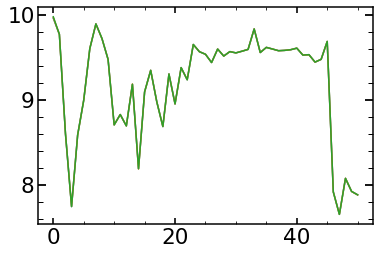

In [700]:
array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[0]]
plt.plot(np.diff(array_of_starting_single_thread[:,2].astype(float)))

array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[2]]
plt.plot(np.diff(array_of_starting_single_thread[:,2].astype(float)))

array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[61]]
plt.plot(np.diff(array_of_starting_single_thread[:,2].astype(float)))

In [719]:
array_of_starting_first_120=array_of_starting[((array_of_starting[:,2].astype(float)<(min_time+10))&(array_of_starting[:,2].astype(float)>(min_time)))]
array_of_starting_first_240=array_of_starting[array_of_starting[:,2].astype(float)<(min_time+20)]

array_of_starting_first_240.shape

(241, 4)

In [721]:
array_of_starting_first_120.shape

(120, 4)

In [725]:
array_of_starting_first_120[0][3]

'47343725706880'

In [732]:
time_start_ending_first_120=[]
for i in range(120):
    time_start_ending_first_120.append(float(array_of_ending[array_of_ending[:,3]==array_of_starting_first_120[i][3]][0][2])-float(array_of_starting_first_120[i][2]))
    
time_start_ending_first_120=np.array(time_start_ending_first_120)

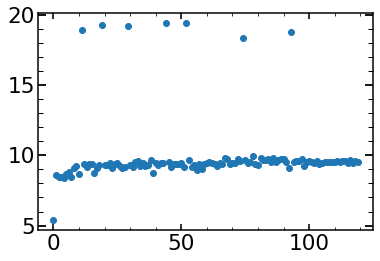

In [734]:
plt.plot(time_start_ending_first_120,marker='o',ls='')

### 3 nodes 

In [117]:
lines=[]
filepath = '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_3_nodes/slurm-4978079.out'
with open(filepath) as fp:
   line = fp.readline()
   cnt = 0
   while line:
       lines.append("Line {}: {}".format(cnt, line.strip()))
       line = fp.readline()
       cnt += 1
        
        
        
list_of_threading=[]


list_of_lines_starting=[]
list_of_lines_ending=[]

list_of_lines_lnlike_time=[]

for i in tqdm(range(len(lines))):
    try:
        index_threading=lines[i].index('threading')
        #print([i,lines[i][index_threading-10:]])
        list_of_threading.append([i,lines[i][index_threading-10:]])
    except:
        pass 
    
    try:    
        index_starting=lines[i].index('Starting LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_starting:]])
        lines_starting=lines[i]
        list_of_lines_starting.append(lines_starting)
        
        #list_of_starting.append([i,lines[i][index_starting+51:index_starting+71].replace(" ", "") ,lines[i][index_starting+74:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    try:            
        index_ending=lines[i].index('Ending LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_ending:]])
        list_of_lines_ending.append(lines[i])
        
        
        #list_of_ending.append([i,lines[i][index_starting+50:index_starting+70].replace(" ", "") ,lines[i][index_ending+72:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    
    try:
        index_time_for_lnlike=lines[i].index('Time for lnlike_Neven')
        print([i,lines[i][index_time_for_lnlike+40:index_time_for_lnlike+55],lines[i][index_time_for_lnlike+60:index_time_for_lnlike+70]])
        list_of_lines_lnlike_time.append(lines[i])   
        

    except:
        pass

  2%|▌                             | 23800/1411822 [00:00<00:05, 237496.84it/s]

[83, 'Starting LN_PFS_multi_same_spot for parameters-hash 2005944939181194424 at 1594218847.621533 in thread 47118042721920']
[227, ' 47118042721920', '2.80116772']
[356, ' 47118042721920', '2.35023927']
[359, 'Ending LN_PFS_multi_same_spot for parameters-hash 2005944939181194424 at 1594218852.7756338 in thread 47118042721920']
[384, 'Starting LN_PFS_multi_same_spot for parameters-hash -1381483153580348835 at 1594218852.8079638 in thread 47711030455936']
[531, 'Starting LN_PFS_multi_same_spot for parameters-hash 8041234902754484077 at 1594218852.800166 in thread 47515215273600']
[679, 'Starting LN_PFS_multi_same_spot for parameters-hash 4355104722906825980 at 1594218852.8027363 in thread 46920113749632']
[827, 'Starting LN_PFS_multi_same_spot for parameters-hash 2898167872710391205 at 1594218852.8036754 in thread 47915661880960']
[975, 'Starting LN_PFS_multi_same_spot for parameters-hash -9192700159017010499 at 1594218852.8012486 in thread 47292241821312']
[1122, 'Starting LN_PFS_multi

  8%|██▏                          | 109532/1411822 [00:00<00:04, 268050.73it/s]

[44431, 'Ending LN_PFS_multi_same_spot for parameters-hash 6089657222053238591 at 1594218863.0389762 in thread 47043478032000']
[44449, 'Starting LN_PFS_multi_same_spot for parameters-hash 6089657222053238591 at 1594218865.3693235 in thread 47043478032000']
[44566, ' 47251838185088', '4.00123429']
[44569, 'Ending LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594218862.2926137 in thread 47251838185088']
[44587, 'Starting LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594218865.4009316 in thread 47251838185088']
[44763, ' 47420345605760', '4.57948231']
[44846, ' 47963524238976', '4.30920886']
[44849, 'Ending LN_PFS_multi_same_spot for parameters-hash -5755970862403245440 at 1594218862.3401988 in thread 47963524238976']
[44867, 'Starting LN_PFS_multi_same_spot for parameters-hash -5755970862403245440 at 1594218865.3675592 in thread 47963524238976']
[44980, ' 47399060008576', '4.00346255']
[44983, 'Ending LN_PFS_multi_same_spot for parameters-hash

 12%|███▍                         | 166003/1411822 [00:00<00:04, 275778.55it/s]

[109601, ' 47692359822976', '3.55679988']
[109636, 'Starting LN_PFS_multi_same_spot for parameters-hash 6700210438334139844 at 1594218886.897923 in thread 47460079697536']
[109881, ' 47552351813248', '3.59348273']
[109931, ' 47251838185088', '3.46508431']
[109934, 'Ending LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594218885.652634 in thread 47251838185088']
[109952, 'Starting LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594218886.9347148 in thread 47251838185088']
[110073, ' 47313374699136', '3.50357580']
[110076, 'Ending LN_PFS_multi_same_spot for parameters-hash 586630752723860750 at 1594218885.6599667 in thread 47313374699136']
[110094, 'Starting LN_PFS_multi_same_spot for parameters-hash 586630752723860750 at 1594218886.904075 in thread 47313374699136']
[110200, 'Starting LN_PFS_multi_same_spot for parameters-hash 1516811790290179162 at 1594218886.9277048 in thread 46919637905024']
[110342, ' 47423066754688', '3.47949004']
[110345, 'E

 16%|████▌                        | 224573/1411822 [00:00<00:04, 283416.30it/s]

[170896, ' 47791308594816', '3.81278657']
[171125, ' 47710335590016', '2.94394421']
[171128, 'Ending LN_PFS_multi_same_spot for parameters-hash -7725194597782895303 at 1594218909.5888305 in thread 47710335590016']
[171170, ' 47124783525504', '4.02887058']
[171389, ' 47099756121728', '3.04107737']
[171392, 'Ending LN_PFS_multi_same_spot for parameters-hash -4130536416396127753 at 1594218909.7073069 in thread 47099756121728']
[171430, ' 47442958302848', '4.01617980']
[171667, ' 47420345605760', '3.05622291']
[171685, ' 47222801657472', '4.00446033']
[172031, ' 47806185520768', '3.06308412']
[172034, 'Ending LN_PFS_multi_same_spot for parameters-hash 1641940376184127345 at 1594218909.7759497 in thread 47806185520768']
[172293, ' 47485206912640', '3.02334189']
[172296, 'Ending LN_PFS_multi_same_spot for parameters-hash 4952464180862001689 at 1594218909.7888856 in thread 47485206912640']
[172419, ' 47978361740928', '3.09890127']
[172422, 'Ending LN_PFS_multi_same_spot for parameters-hash -2

 20%|█████▋                       | 278632/1411822 [00:01<00:04, 260348.45it/s]

[228011, ' 47865236577920', '3.88126921']
[228014, 'Ending LN_PFS_multi_same_spot for parameters-hash -8469863362068436690 at 1594218921.8346744 in thread 47865236577920']
[228032, 'Starting LN_PFS_multi_same_spot for parameters-hash -8469863362068436690 at 1594218923.0196784 in thread 47865236577920']
[228156, ' 47277756546688', '4.52267360']
[228159, 'Ending LN_PFS_multi_same_spot for parameters-hash 5231037296792703490 at 1594218922.9032867 in thread 47277756546688']
[228177, 'Starting LN_PFS_multi_same_spot for parameters-hash 5231037296792703490 at 1594218922.977821 in thread 47277756546688']
[228296, ' 47213243473536', '4.48271965']
[228299, 'Ending LN_PFS_multi_same_spot for parameters-hash 4144272405855605755 at 1594218922.8107545 in thread 47213243473536']
[228317, 'Starting LN_PFS_multi_same_spot for parameters-hash 4144272405855605755 at 1594218922.9743803 in thread 47213243473536']
[228421, 'Ending LN_PFS_multi_same_spot for parameters-hash -2612627932947685088 at 159421892

 24%|██████▊                      | 333771/1411822 [00:01<00:04, 250206.38it/s]

[302790, ' 47111842332288', '4.01268148']
[302793, 'Ending LN_PFS_multi_same_spot for parameters-hash 2286509539570828823 at 1594218942.5493758 in thread 47111842332288']
[302794, 'Starting LN_PFS_multi_same_spot for parameters-hash 2286509539570828823 at 1594218945.907622 in thread 47111842332288']
[302825, 'Starting LN_PFS_multi_same_spot for parameters-hash 2286509539570828823 at 1594218953.3331287 in thread 47111842332288']
[303057, ' 47600301719168', '3.06054019']
[303088, 'Ending LN_PFS_multi_same_spot for parameters-hash 7636289778582816554 at 1594218942.6398675 in thread 47451689987712']
[303089, 'Starting LN_PFS_multi_same_spot for parameters-hash 7636289778582816554 at 1594218945.907917 in thread 47451689987712']
[303120, 'Starting LN_PFS_multi_same_spot for parameters-hash 7636289778582816554 at 1594218953.3329666 in thread 47451689987712']
[303458, ' 47642972094080', '3.19638299']
[303584, ' 47409148890752', '3.10350203']
[303722, ' 47213243473536', '3.22347068']
[303788, '

 27%|███████▊                     | 382265/1411822 [00:01<00:04, 227871.70it/s]

[343930, ' 47291576528512', '3.17395138']
[343933, 'Ending LN_PFS_multi_same_spot for parameters-hash 9069503847843949160 at 1594218975.6833618 in thread 47291576528512']
[343934, 'Starting LN_PFS_multi_same_spot for parameters-hash 9069503847843949160 at 1594218975.8933022 in thread 47291576528512']
[344059, ' 47942754164352', '2.97172379']
[344062, 'Ending LN_PFS_multi_same_spot for parameters-hash 9683683216078855 at 1594218975.1771405 in thread 47942754164352']
[344063, 'Starting LN_PFS_multi_same_spot for parameters-hash 9683683216078855 at 1594218975.8968353 in thread 47942754164352']
[344203, ' 47257846984320', '3.24238324']
[344206, 'Ending LN_PFS_multi_same_spot for parameters-hash 5390854813089898113 at 1594218975.7259989 in thread 47257846984320']
[344207, 'Starting LN_PFS_multi_same_spot for parameters-hash 5390854813089898113 at 1594218975.8941386 in thread 47257846984320']
[344316, ' 47622717886080', '3.19758749']
[344319, 'Ending LN_PFS_multi_same_spot for parameters-has

 33%|█████████▌                   | 466556/1411822 [00:01<00:03, 260185.47it/s]

[393301, 'Ending LN_PFS_multi_same_spot for parameters-hash -5895291761650764090 at 1594218998.583699 in thread 47299839860352']
[393302, 'Starting LN_PFS_multi_same_spot for parameters-hash -5895291761650764090 at 1594218999.4939337 in thread 47299839860352']
[393427, ' 47510943981184', '2.99784493']
[393430, 'Ending LN_PFS_multi_same_spot for parameters-hash 8925187177901660756 at 1594218998.5036829 in thread 47510943981184']
[393431, 'Starting LN_PFS_multi_same_spot for parameters-hash 8925187177901660756 at 1594218999.4921703 in thread 47510943981184']
[393561, ' 47790982229632', '3.11368751']
[393564, 'Ending LN_PFS_multi_same_spot for parameters-hash -8347669356293224347 at 1594218998.8522944 in thread 47790982229632']
[393565, 'Starting LN_PFS_multi_same_spot for parameters-hash -8347669356293224347 at 1594218999.4895847 in thread 47790982229632']
[393691, ' 47213243473536', '2.72027087']
[393694, 'Ending LN_PFS_multi_same_spot for parameters-hash 4144272405855605755 at 15942189

 37%|██████████▋                  | 521098/1411822 [00:01<00:03, 266705.40it/s]


[467869, ' 47790982229632', '4.29007697']
[468004, ' 47213243473536', '4.18441748']
[468123, ' 47079260630656', '4.18478536']
[468254, ' 47124783525504', '4.23999953']
[468418, ' 47390138412672', '4.47987508']
[468557, ' 47117171596928', '4.55705666']
[468656, ' 47257846984320', '4.32662415']
[468826, ' 47680414662272', '4.57672834']
[468947, ' 47984959987328', '4.54099082']
[469089, ' 47099756121728', '4.54689192']
[469201, ' 47915661880960', '4.43971776']
[469338, ' 47420345605760', '4.50316905']
[469585, ' 47598610488960', '4.68451642']
[470046, ' 46926802443904', '3.40443801']
[470049, 'Ending LN_PFS_multi_same_spot for parameters-hash 9153644550289010078 at 1594219038.4800718 in thread 46926802443904']
[470050, 'Starting LN_PFS_multi_same_spot for parameters-hash 9153644550289010078 at 1594219038.6040292 in thread 46926802443904']
[470197, ' 47963524238976', '2.57641577']
[470200, 'Ending LN_PFS_multi_same_spot for parameters-hash -5755970862403245440 at 1594219036.2114193 in thr

 41%|███████████▉                 | 581196/1411822 [00:02<00:02, 282312.49it/s]

[522579, 'Ending LN_PFS_multi_same_spot for parameters-hash -8167139861788896631 at 1594219053.9504318 in thread 47975077289600']
[522580, 'Starting LN_PFS_multi_same_spot for parameters-hash -8167139861788896631 at 1594219054.827276 in thread 47975077289600']
[522831, ' 47576375475840', '5.13900184']
[522936, ' 47324867866240', '5.13548159']
[522991, ' 47750619909760', '3.91251778']
[522994, 'Ending LN_PFS_multi_same_spot for parameters-hash 3592269222121666124 at 1594218942.5007 in thread 47750619909760']
[522995, 'Starting LN_PFS_multi_same_spot for parameters-hash 3592269222121666124 at 1594219054.8709896 in thread 47750619909760']
[523220, ' 47299839860352', '5.19296479']
[523359, ' 47482342272640', '5.17084288']
[523509, ' 47138510622336', '5.15815472']
[523523, 'Starting LN_PFS_multi_same_spot for parameters-hash 4116858956775609118 at 1594219054.8699179 in thread 47701358476928']
[523904, ' 47535398137472', '5.21181011']
[524053, ' 47544733851264', '5.24813485']
[524078, ' 4743

 46%|█████████████▏               | 644716/1411822 [00:02<00:02, 291405.16it/s]


[590522, ' 47510943981184', '4.39508628']
[590595, ' 47664982171264', '4.27409720']
[590598, 'Ending LN_PFS_multi_same_spot for parameters-hash 1794353608070376095 at 1594219077.2674491 in thread 47664982171264']
[590616, 'Starting LN_PFS_multi_same_spot for parameters-hash 1794353608070376095 at 1594219080.1459496 in thread 47664982171264']
[590802, ' 47806185520768', '4.40366744']
[590944, ' 47459462889088', '4.42488503']
[591069, ' 47222801657472', '4.40191698']
[591205, ' 47442958302848', '4.39853858']
[591260, 'Starting LN_PFS_multi_same_spot for parameters-hash -7091329110648781379 at 1594219080.1367207 in thread 47079260630656']
[591394, 'Starting LN_PFS_multi_same_spot for parameters-hash -3349006146338306063 at 1594219080.1387253 in thread 47420345605760']
[591603, ' 47790982229632', '4.15135741']
[591666, 'Starting LN_PFS_multi_same_spot for parameters-hash -4713896573221390683 at 1594219080.1407247 in thread 47598610488960']
[591881, ' 47121729941120', '4.45904326']
[592022

 50%|██████████████▌              | 708222/1411822 [00:02<00:02, 296829.64it/s]

[657534, ' 47815472549504', '4.03569030']
[657537, 'Ending LN_PFS_multi_same_spot for parameters-hash 6567997744113300148 at 1594219099.3983908 in thread 47815472549504']
[657555, 'Starting LN_PFS_multi_same_spot for parameters-hash 6567997744113300148 at 1594219099.7045393 in thread 47815472549504']
[657666, ' 47251838185088', '3.66695547']
[657669, 'Ending LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594219098.7805328 in thread 47251838185088']
[657687, 'Starting LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594219099.7370586 in thread 47251838185088']
[657797, ' 47364744642176', '3.63588356']
[657800, 'Ending LN_PFS_multi_same_spot for parameters-hash -1575139416386011134 at 1594219098.779478 in thread 47364744642176']
[657818, 'Starting LN_PFS_multi_same_spot for parameters-hash -1575139416386011134 at 1594219099.7477531 in thread 47364744642176']
[657929, ' 47276309024384', '3.89454007']
[657932, 'Ending LN_PFS_multi_same_spot for param

 54%|███████████████▊             | 767438/1411822 [00:02<00:02, 282224.04it/s]


[729167, 'Starting LN_PFS_multi_same_spot for parameters-hash -6362972147134285664 at 1594219119.9385114 in thread 47962092510848']
[729279, ' 47385241800320', '3.89467334']
[729282, 'Ending LN_PFS_multi_same_spot for parameters-hash 2143413833093168233 at 1594219118.9724224 in thread 47385241800320']
[729300, 'Starting LN_PFS_multi_same_spot for parameters-hash 2143413833093168233 at 1594219119.9418652 in thread 47385241800320']
[729411, ' 47399060008576', '3.89643073']
[729414, 'Ending LN_PFS_multi_same_spot for parameters-hash 6942626367805051898 at 1594219119.328886 in thread 47399060008576']
[729432, 'Starting LN_PFS_multi_same_spot for parameters-hash 6942626367805051898 at 1594219119.9464712 in thread 47399060008576']
[729554, ' 47432405683840', '3.67101144']
[729557, 'Ending LN_PFS_multi_same_spot for parameters-hash -2665144516501002713 at 1594219118.680897 in thread 47432405683840']
[729575, 'Starting LN_PFS_multi_same_spot for parameters-hash -2665144516501002713 at 1594219

 61%|█████████████████▋           | 859384/1411822 [00:03<00:01, 291803.59it/s]


[777385, ' 47642972094080', '5.27687263']
[777416, 'Starting LN_PFS_multi_same_spot for parameters-hash 1129370629687445908 at 1594219132.5336213 in thread 47857802780288']
[777558, ' 47186134068864', '4.26384282']
[777561, 'Ending LN_PFS_multi_same_spot for parameters-hash 8628328075943939117 at 1594219129.8353982 in thread 47186134068864']
[777579, 'Starting LN_PFS_multi_same_spot for parameters-hash 8628328075943939117 at 1594219132.496858 in thread 47186134068864']
[777831, 'Starting LN_PFS_multi_same_spot for parameters-hash -5755970862403245440 at 1594219132.4933357 in thread 47963524238976']
[778205, ' 47732653379200', '5.30732917']
[778470, ' 47330815561344', '5.35953545']
[778613, ' 47299839860352', '5.37377834']
[778645, ' 47451689987712', '3.99466443']
[778648, 'Ending LN_PFS_multi_same_spot for parameters-hash 7636289778582816554 at 1594219129.09299 in thread 47451689987712']
[778666, 'Starting LN_PFS_multi_same_spot for parameters-hash 7636289778582816554 at 1594219132.49

 65%|██████████████████▉          | 918962/1411822 [00:03<00:01, 294780.41it/s]


[860808, 'Ending LN_PFS_multi_same_spot for parameters-hash -783648244559205414 at 1594219161.5690253 in thread 47138905669248']
[860814, ' 47276309024384', '5.10974931']
[860953, ' 47324867866240', '5.00540304']
[861178, ' 47251838185088', '3.77533268']
[861181, 'Ending LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594219161.6936662 in thread 47251838185088']
[861204, ' 47133972229760', '4.93192911']
[861333, ' 47133972229760', '3.93999576']
[861336, 'Ending LN_PFS_multi_same_spot for parameters-hash -8914050159786987716 at 1594219161.715729 in thread 47133972229760']
[861346, ' 47313374699136', '5.12964224']
[861503, ' 47701358476928', '5.33365035']
[861650, ' 47544733851264', '5.44326019']
[861786, ' 47285936488064', '5.47352099']
[861925, ' 47138510622336', '5.51720309']
[862131, ' 47409148890752', '3.95505547']
[862134, 'Ending LN_PFS_multi_same_spot for parameters-hash 1685499130200780223 at 1594219161.9570265 in thread 47409148890752']
[862180, ' 472266977

 69%|████████████████████▏        | 980663/1411822 [00:03<00:01, 299296.21it/s]

[921884, 'Ending LN_PFS_multi_same_spot for parameters-hash -6267008702110937629 at 1594219172.595147 in thread 47052096605824']
[921902, 'Starting LN_PFS_multi_same_spot for parameters-hash -6267008702110937629 at 1594219175.4979367 in thread 47052096605824']
[922080, ' 47704392412800', '4.79855132']
[922143, 'Starting LN_PFS_multi_same_spot for parameters-hash 5394586116487256414 at 1594219175.4980743 in thread 47062064897664']
[922278, 'Starting LN_PFS_multi_same_spot for parameters-hash 5460400533334582928 at 1594219175.4988303 in thread 47442317057664']
[922429, ' 46990650760832', '4.28312993']
[922432, 'Ending LN_PFS_multi_same_spot for parameters-hash 5181537281007223722 at 1594219172.9746366 in thread 46990650760832']
[922450, 'Starting LN_PFS_multi_same_spot for parameters-hash 5181537281007223722 at 1594219175.4963691 in thread 46990650760832']
[922556, 'Starting LN_PFS_multi_same_spot for parameters-hash -7345170831370979095 at 1594219175.5312774 in thread 47856221601408']
[

 74%|████████████████████▌       | 1038971/1411822 [00:03<00:01, 271724.26it/s]


[982620, ' 47129010192000', '3.80608224']
[982623, 'Ending LN_PFS_multi_same_spot for parameters-hash 498059800971514660 at 1594219196.8343825 in thread 47129010192000']
[982641, 'Starting LN_PFS_multi_same_spot for parameters-hash 498059800971514660 at 1594219200.5855036 in thread 47129010192000']
[982750, ' 47139735539328', '3.79458212']
[982753, 'Ending LN_PFS_multi_same_spot for parameters-hash -8469085433959767978 at 1594219196.8468807 in thread 47139735539328']
[982771, 'Starting LN_PFS_multi_same_spot for parameters-hash -8469085433959767978 at 1594219200.5769649 in thread 47139735539328']
[982882, ' 47727249337984', '3.83580517']
[982885, 'Ending LN_PFS_multi_same_spot for parameters-hash -8841879840148685577 at 1594219197.0943227 in thread 47727249337984']
[982903, 'Starting LN_PFS_multi_same_spot for parameters-hash -8841879840148685577 at 1594219200.6064045 in thread 47727249337984']
[983028, ' 46919637905024', '3.91561031']
[983031, 'Ending LN_PFS_multi_same_spot for param

 80%|██████████████████████▎     | 1125837/1411822 [00:04<00:01, 283285.41it/s]


[1050633, ' 47085109386880', '3.86838960']
[1050636, 'Ending LN_PFS_multi_same_spot for parameters-hash 3828262828770739477 at 1594219222.5463533 in thread 47085109386880']
[1050654, 'Starting LN_PFS_multi_same_spot for parameters-hash 3828262828770739477 at 1594219225.8151388 in thread 47085109386880']
[1050781, ' 47576375475840', '3.97351789']
[1050784, 'Ending LN_PFS_multi_same_spot for parameters-hash -3598133220998510171 at 1594219222.222581 in thread 47576375475840']
[1050802, 'Starting LN_PFS_multi_same_spot for parameters-hash -3598133220998510171 at 1594219225.8160553 in thread 47576375475840']
[1050929, ' 47251838185088', '3.78293347']
[1050932, 'Ending LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594219222.2975066 in thread 47251838185088']
[1050950, 'Starting LN_PFS_multi_same_spot for parameters-hash -4544207976366772792 at 1594219225.8195584 in thread 47251838185088']
[1051057, ' 47732653379200', '3.82021641']
[1051060, 'Ending LN_PFS_multi_same_sp

 84%|███████████████████████▋    | 1192972/1411822 [00:04<00:00, 307849.20it/s]

[1127322, ' 47162811518592', '3.83454060']
[1127325, 'Ending LN_PFS_multi_same_spot for parameters-hash 3053672922369057545 at 1594219247.4155705 in thread 47162811518592']
[1127343, 'Starting LN_PFS_multi_same_spot for parameters-hash 3053672922369057545 at 1594219250.6301897 in thread 47162811518592']
[1127451, ' 47213243473536', '4.28459978']
[1127454, 'Ending LN_PFS_multi_same_spot for parameters-hash 4144272405855605755 at 1594219248.1590505 in thread 47213243473536']
[1127472, 'Starting LN_PFS_multi_same_spot for parameters-hash 4144272405855605755 at 1594219250.588351 in thread 47213243473536']
[1127583, ' 47856221601408', '3.71974802']
[1127586, 'Ending LN_PFS_multi_same_spot for parameters-hash -7345170831370979095 at 1594219246.9906094 in thread 47856221601408']
[1127604, 'Starting LN_PFS_multi_same_spot for parameters-hash -7345170831370979095 at 1594219250.6247253 in thread 47856221601408']
[1127714, ' 47806185520768', '3.30356526']
[1127717, 'Ending LN_PFS_multi_same_spot 

 89%|████████████████████████▉   | 1254682/1411822 [00:04<00:00, 298312.82it/s]

[1193133, 'Starting LN_PFS_multi_same_spot for parameters-hash 4355104722906825980 at 1594219275.8371418 in thread 46920113749632']
[1193214, ' 47460079697536', '3.41114306']
[1193217, 'Ending LN_PFS_multi_same_spot for parameters-hash 6700210438334139844 at 1594219271.2828426 in thread 47460079697536']
[1193235, 'Starting LN_PFS_multi_same_spot for parameters-hash 6700210438334139844 at 1594219275.838215 in thread 47460079697536']
[1193372, ' 47124783525504', '3.39475226']
[1193375, 'Ending LN_PFS_multi_same_spot for parameters-hash 2646673560812865227 at 1594219271.004771 in thread 47124783525504']
[1193393, 'Starting LN_PFS_multi_same_spot for parameters-hash 2646673560812865227 at 1594219275.838597 in thread 47124783525504']
[1193492, ' 47291576528512', '3.32270240']
[1193495, 'Ending LN_PFS_multi_same_spot for parameters-hash 9069503847843949160 at 1594219270.9564033 in thread 47291576528512']
[1193513, 'Starting LN_PFS_multi_same_spot for parameters-hash 9069503847843949160 at 15

 93%|██████████████████████████  | 1315793/1411822 [00:04<00:00, 301541.13it/s]

[1256514, ' 47984959987328', '3.47953963']
[1256517, 'Ending LN_PFS_multi_same_spot for parameters-hash 1576066355034341074 at 1594219296.251501 in thread 47984959987328']
[1256667, ' 47598610488960', '3.53494477']
[1256670, ' 47079260630656', '4.48941993']
[1256911, ' 47680414662272', '3.39707136']
[1256914, 'Ending LN_PFS_multi_same_spot for parameters-hash 3172636018087707954 at 1594219296.2807734 in thread 47680414662272']
[1256983, ' 47324867866240', '5.14635300']
[1257130, ' 47865236577920', '5.31776952']
[1257264, ' 47026201140864', '5.43024420']
[1257398, ' 47330815561344', '5.16382789']
[1257531, ' 47451689987712', '5.10327219']
[1257625, ' 47962092510848', '4.63319754']
[1257811, ' 47815472549504', '5.64842939']
[1257913, ' 47544733851264', '5.08162760']
[1258037, ' 47944888630912', '5.18086290']
[1258176, ' 47856221601408', '5.18172144']
[1258290, ' 47138510622336', '5.09014606']
[1258441, ' 46971389075072', '5.10908794']
[1258597, ' 47436593716864', '5.30331873']
[1258740, 

 98%|███████████████████████████▎| 1379684/1411822 [00:04<00:00, 303234.77it/s]


[1318064, ' 47640903302784', '4.15760207']
[1318067, 'Ending LN_PFS_multi_same_spot for parameters-hash 5279051540825850081 at 1594219310.3081012 in thread 47640903302784']
[1318085, 'Starting LN_PFS_multi_same_spot for parameters-hash 5279051540825850081 at 1594219312.999033 in thread 47640903302784']
[1318185, 'Starting LN_PFS_multi_same_spot for parameters-hash -6867859228721064000 at 1594219313.0009015 in thread 47667969052288']
[1318318, ' 47667969052288', '5.18285775']
[1318417, ' 47856221601408', '5.08792471']
[1318470, ' 47621798190720', '3.94813442']
[1318473, 'Ending LN_PFS_multi_same_spot for parameters-hash -2618980292969657046 at 1594219310.0779123 in thread 47621798190720']
[1318491, 'Starting LN_PFS_multi_same_spot for parameters-hash -2618980292969657046 at 1594219313.0344524 in thread 47621798190720']
[1318610, 'Ending LN_PFS_multi_same_spot for parameters-hash 4116858956775609118 at 1594219310.037418 in thread 47701358476928']
[1318628, 'Starting LN_PFS_multi_same_sp

100%|████████████████████████████| 1411822/1411822 [00:05<00:00, 281310.61it/s]


[1394983, 'Starting LN_PFS_multi_same_spot for parameters-hash 4144272405855605755 at 1594219360.702993 in thread 47213243473536']
[1395133, ' 46993283681920', '3.08501577']
[1395136, 'Ending LN_PFS_multi_same_spot for parameters-hash -8076525294203398454 at 1594219360.6155858 in thread 46993283681920']
[1395137, 'Starting LN_PFS_multi_same_spot for parameters-hash -8076525294203398454 at 1594219360.700914 in thread 46993283681920']
[1395242, ' 46920113749632', '2.89422559']
[1395245, 'Ending LN_PFS_multi_same_spot for parameters-hash 4355104722906825980 at 1594219353.4124913 in thread 46920113749632']
[1395246, 'Starting LN_PFS_multi_same_spot for parameters-hash 4355104722906825980 at 1594219353.6306043 in thread 46920113749632']
[1395277, 'Starting LN_PFS_multi_same_spot for parameters-hash 4355104722906825980 at 1594219360.6986923 in thread 46920113749632']
[1395379, ' 47291576528512', '2.90230846']
[1395382, 'Ending LN_PFS_multi_same_spot for parameters-hash 9069503847843949160 a

In [118]:
list_of_starting=[]
list_of_ending=[]
list_of_lnlike_time=[]

for l in range(len(list_of_lines_starting)):
    list_of_starting.append([str(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at ')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('at ')+3:list_of_lines_starting[l].index('in thread')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])
    
for l in range(len(list_of_lines_ending)):
    list_of_ending.append([str(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at ')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('at ')+3:list_of_lines_ending[l].index('in thread')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])

for l in range(len(list_of_lines_lnlike_time)):
    list_of_lnlike_time.append([str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('Line')+5:list_of_lines_lnlike_time[l].index(':')]),\
                               str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('thread')+7:list_of_lines_lnlike_time[l].index('is')-1]),
                                str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('is')+4:list_of_lines_lnlike_time[l].index('seconds')-1])])
 


array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)
array_of_lnlike_time=np.array(list_of_lnlike_time)

Text(0, 0.5, 'time [sec]')

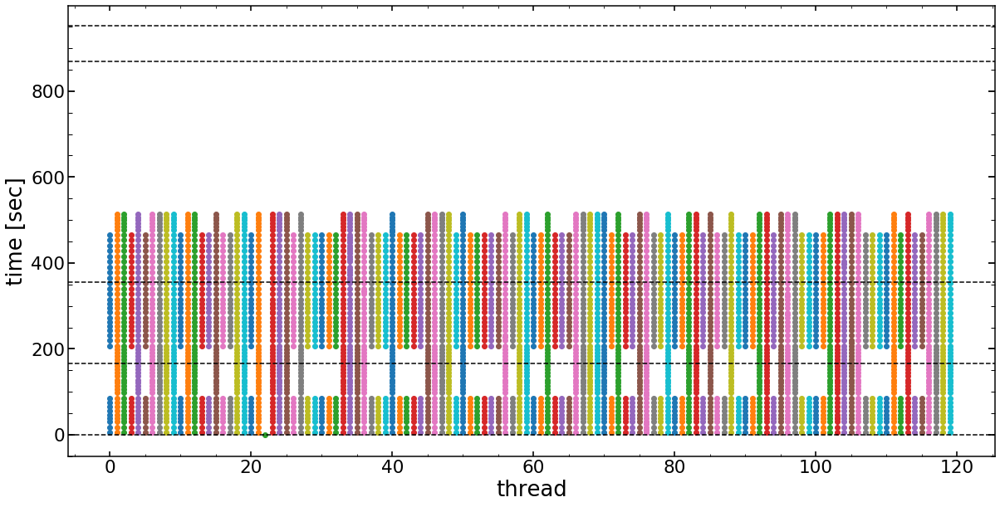

In [119]:
starting_threads=np.unique(array_of_starting[:,3])
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_3_nodes/chainJul0820_Single_P_21448617HgAr_list_of_times.npy')
min_time=np.min(array_of_starting[:,2].astype(float))

plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_starting_single_thread[:,2]))*i,array_of_starting_single_thread[:,2].astype(float)-min_time)
    
plt.axhline(0,color='black',ls='--')   
plt.axhline(list_of_times[0],color='black',ls='--')
plt.axhline(list_of_times[1],color='black',ls='--')
plt.axhline(list_of_times[2],color='black',ls='--')
plt.axhline(list_of_times[3],color='black',ls='--')

plt.xlabel('thread')
plt.ylabel('time [sec]')

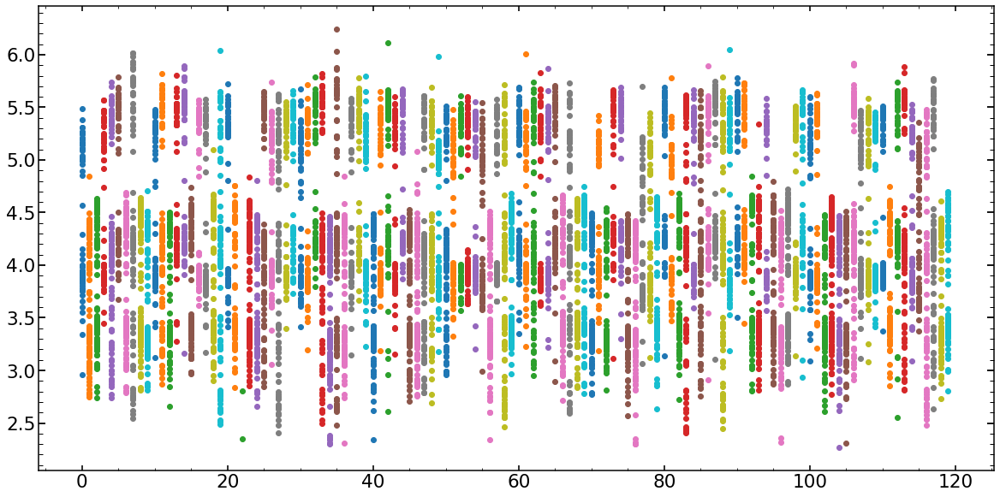

In [107]:
plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_lnlike_time_single_thread=array_of_lnlike_time[array_of_lnlike_time[:,1]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_lnlike_time_single_thread[:,1]))*i,array_of_lnlike_time_single_thread[:,2].astype(float))

In [108]:
np.mean(array_of_lnlike_time[:,2].astype(float))

4.179570278589173

In [109]:
np.mean(array_of_lnlike_time[0:2][:,2].astype(float))

2.575703501701355

### 1 node 

In [78]:
lines=[]
filepath = '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_1_node/slurm-4978058.out'
with open(filepath) as fp:
   line = fp.readline()
   cnt = 0
   while line:
       lines.append("Line {}: {}".format(cnt, line.strip()))
       line = fp.readline()
       cnt += 1
        
        
        
list_of_threading=[]


list_of_lines_starting=[]
list_of_lines_ending=[]

list_of_lines_lnlike_time=[]

for i in tqdm(range(len(lines))):
    try:
        index_threading=lines[i].index('threading')
        #print([i,lines[i][index_threading-10:]])
        list_of_threading.append([i,lines[i][index_threading-10:]])
    except:
        pass 
    
    try:    
        index_starting=lines[i].index('Starting LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_starting:]])
        lines_starting=lines[i]
        list_of_lines_starting.append(lines_starting)
        
        #list_of_starting.append([i,lines[i][index_starting+51:index_starting+71].replace(" ", "") ,lines[i][index_starting+74:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    try:            
        index_ending=lines[i].index('Ending LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_ending:]])
        list_of_lines_ending.append(lines[i])
        
        
        #list_of_ending.append([i,lines[i][index_starting+50:index_starting+70].replace(" ", "") ,lines[i][index_ending+72:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    
    try:
        index_time_for_lnlike=lines[i].index('Time for lnlike_Neven')
        print([i,lines[i][index_time_for_lnlike+40:index_time_for_lnlike+55],lines[i][index_time_for_lnlike+60:index_time_for_lnlike+70]])
        list_of_lines_lnlike_time.append(lines[i])   
        

    except:
        pass

  2%|▋                             | 29532/1388594 [00:00<00:04, 295316.76it/s]

[83, 'Starting LN_PFS_multi_same_spot for parameters-hash -8617804474202661189 at 1594217351.330644 in thread 47444384812672']
[227, ' 47444384812672', '2.86332154']
[356, ' 47444384812672', '2.37086057']
[359, 'Ending LN_PFS_multi_same_spot for parameters-hash -8617804474202661189 at 1594217356.5671134 in thread 47444384812672']
[384, 'Starting LN_PFS_multi_same_spot for parameters-hash -5708797454333808258 at 1594217356.591977 in thread 47642956070528']
[531, 'Starting LN_PFS_multi_same_spot for parameters-hash 1319060031716064675 at 1594217356.594713 in thread 47002971655808']
[680, 'Starting LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 1594217356.5936291 in thread 47869462179456']
[827, 'Starting LN_PFS_multi_same_spot for parameters-hash 4814885382525387938 at 1594217356.591196 in thread 47516077297280']
[974, 'Starting LN_PFS_multi_same_spot for parameters-hash 2348895491497822109 at 1594217356.6038663 in thread 47515136122496']
[1121, 'Starting LN_PFS_multi_

  6%|█▋                            | 76958/1388594 [00:00<00:05, 261220.40it/s]


[44684, 'Ending LN_PFS_multi_same_spot for parameters-hash -6645907870313611989 at 1594217396.6947331 in thread 47121694424704']
[44773, ' 47842245074560', '3.63445425']
[44776, 'Ending LN_PFS_multi_same_spot for parameters-hash -2784632303776138730 at 1594217396.768465 in thread 47842245074560']
[44794, 'Starting LN_PFS_multi_same_spot for parameters-hash -2784632303776138730 at 1594217396.775192 in thread 47842245074560']
[44934, ' 47266454175360', '3.59541344']
[44937, 'Ending LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594217396.8369763 in thread 47266454175360']
[44985, ' 47222432198272', '5.11955618']
[45102, ' 47082073964160', '5.08499979']
[45242, ' 47992191909504', '5.13247346']
[45407, ' 47254485565056', '5.53814721']
[45504, ' 47222067146368', '5.08115386']
[45646, ' 47515136122496', '5.14355325']
[45784, ' 47939797941888', '5.25831890']
[45915, ' 47392662666880', '5.24162364']
[46145, ' 47516077297280', '3.99565076']
[46148, 'Ending LN_PFS_multi_same

 10%|██▉                          | 141950/1388594 [00:00<00:05, 233191.97it/s]

[92103, 'Starting LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594217429.0771415 in thread 47992191909504']
[92337, ' 46989658062464', '4.67563486']
[92359, ' 47375413595776', '4.35916376']
[92362, 'Ending LN_PFS_multi_same_spot for parameters-hash 6706474519901312265 at 1594217429.1919353 in thread 47375413595776']
[92380, 'Starting LN_PFS_multi_same_spot for parameters-hash 6706474519901312265 at 1594217429.2011206 in thread 47375413595776']
[92607, ' 47464437583488', '4.94055676']
[92611, 'Starting LN_PFS_multi_same_spot for parameters-hash 1319060031716064675 at 1594217429.1286197 in thread 47002971655808']
[92659, 'Starting LN_PFS_multi_same_spot for parameters-hash 1319060031716064675 at 1594217429.1331427 in thread 47002971655808']
[92842, ' 47705804246656', '4.73855113']
[93272, ' 47869462179456', '4.98548030']
[93381, ' 47515136122496', '4.85359406']
[93527, ' 47979344494208', '4.92676496']
[93689, ' 47842245074560', '5.10590839']
[94026, ' 47337183542912

 14%|███▉                         | 189153/1388594 [00:00<00:05, 234674.84it/s]

[141967, 'Starting LN_PFS_multi_same_spot for parameters-hash -2238265922997960412 at 1594217475.0409646 in thread 47874170187392']
[142015, 'Starting LN_PFS_multi_same_spot for parameters-hash -2238265922997960412 at 1594217475.0453773 in thread 47874170187392']
[142064, ' 47875271691904', '3.38193511']
[142067, 'Ending LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594217475.0261524 in thread 47875271691904']
[142085, 'Starting LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594217475.0404413 in thread 47875271691904']
[142133, 'Starting LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594217475.0455546 in thread 47875271691904']
[142181, 'Starting LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594217475.0502455 in thread 47875271691904']
[142271, ' 47992191909504', '3.41274189']
[142274, 'Ending LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594217474.303746 in thread 47992191909504']
[1

 17%|█████                        | 240729/1388594 [00:01<00:04, 245946.82it/s]


[189814, ' 47018702089856', '4.23706173']
[189817, 'Ending LN_PFS_multi_same_spot for parameters-hash 7884370160524429571 at 1594217510.3406103 in thread 47018702089856']
[189835, 'Starting LN_PFS_multi_same_spot for parameters-hash 7884370160524429571 at 1594217510.3511949 in thread 47018702089856']
[190071, ' 47842245074560', '5.16608595']
[190161, ' 47421377371776', '5.24857783']
[190427, ' 47121694424704', '5.19405579']
[190585, ' 47110808641152', '5.27617383']
[190680, ' 47874170187392', '5.00121164']
[190818, ' 47209452543616', '5.13973617']
[190976, ' 47082073964160', '5.33413720']
[191095, ' 47311262658176', '5.35396075']
[191211, ' 47321916309120', '5.29819011']
[191333, ' 47979344494208', '4.65579175']
[191508, ' 47392662666880', '3.62401652']
[191511, 'Ending LN_PFS_multi_same_spot for parameters-hash -3233045659144793383 at 1594217517.0747154 in thread 47392662666880']
[191529, 'Starting LN_PFS_multi_same_spot for parameters-hash -3233045659144793383 at 1594217517.0840857 

 19%|█████▌                       | 267589/1388594 [00:01<00:04, 252283.58it/s]

[242994, ' 47889664269952', '3.43914818']
[242997, 'Ending LN_PFS_multi_same_spot for parameters-hash -612345855802199968 at 1594217552.2973828 in thread 47889664269952']
[243015, 'Starting LN_PFS_multi_same_spot for parameters-hash -612345855802199968 at 1594217555.300267 in thread 47889664269952']
[243120, ' 47365695127168', '3.49130439']
[243123, 'Ending LN_PFS_multi_same_spot for parameters-hash 5427937181414170867 at 1594217554.4058151 in thread 47365695127168']
[243141, 'Starting LN_PFS_multi_same_spot for parameters-hash 5427937181414170867 at 1594217555.298797 in thread 47365695127168']
[243259, ' 47311262658176', '4.27369737']
[243262, 'Ending LN_PFS_multi_same_spot for parameters-hash 2095588845360584625 at 1594217547.3687305 in thread 47311262658176']
[243280, 'Starting LN_PFS_multi_same_spot for parameters-hash 2095588845360584625 at 1594217555.3016315 in thread 47311262658176']
[243401, ' 47082073964160', '4.52381920']
[243404, 'Ending LN_PFS_multi_same_spot for parameters

 24%|███████                      | 339648/1388594 [00:01<00:04, 227663.50it/s]

[290958, 'Ending LN_PFS_multi_same_spot for parameters-hash -5778047306545509499 at 1594217596.0927489 in thread 47110808641152']
[290959, 'Starting LN_PFS_multi_same_spot for parameters-hash -5778047306545509499 at 1594217601.7173905 in thread 47110808641152']
[291076, ' 47874170187392', '4.03848052']
[291079, 'Ending LN_PFS_multi_same_spot for parameters-hash -2238265922997960412 at 1594217596.1059859 in thread 47874170187392']
[291080, 'Starting LN_PFS_multi_same_spot for parameters-hash -2238265922997960412 at 1594217601.7175689 in thread 47874170187392']
[291183, ' 47869462179456', '3.86244893']
[291186, 'Ending LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 1594217595.351388 in thread 47869462179456']
[291187, 'Starting LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 1594217601.7150006 in thread 47869462179456']
[291305, ' 47209452543616', '3.97196865']
[291308, 'Ending LN_PFS_multi_same_spot for parameters-hash 5550285210765280779 at 15942175

 28%|████████▏                    | 391685/1388594 [00:01<00:04, 243755.75it/s]

[340165, ' 47319108931200', '5.25245714']
[340288, ' 47311262658176', '5.42268562']
[340378, ' 47992191909504', '4.52958536']
[340547, ' 47979511611008', '5.36966395']
[340673, ' 47705804246656', '5.01984119']
[340809, ' 47979344494208', '5.06437301']
[341010, ' 47869462179456', '3.58185148']
[341013, 'Ending LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 1594217655.5261242 in thread 47869462179456']
[341014, 'Starting LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 1594217655.5318935 in thread 47869462179456']
[341086, ' 47642956070528', '3.63577628']
[341089, 'Ending LN_PFS_multi_same_spot for parameters-hash -5708797454333808258 at 1594217655.5801365 in thread 47642956070528']
[341090, 'Starting LN_PFS_multi_same_spot for parameters-hash -5708797454333808258 at 1594217655.5860205 in thread 47642956070528']
[341121, 'Starting LN_PFS_multi_same_spot for parameters-hash -5708797454333808258 at 1594217655.5891116 in thread 47642956070528']
[341165, '

 30%|████████▋                    | 416319/1388594 [00:01<00:04, 238140.05it/s]


[391964, 'Starting LN_PFS_multi_same_spot for parameters-hash 4234341310734982930 at 1594217704.1963272 in thread 47321916309120']
[392056, 'Ending LN_PFS_multi_same_spot for parameters-hash 7617134752664076530 at 1594217703.880072 in thread 47088094711424']
[392057, 'Starting LN_PFS_multi_same_spot for parameters-hash 7617134752664076530 at 1594217703.8868427 in thread 47088094711424']
[392268, ' 47421377371776', '3.21131587']
[392408, ' 47516077297280', '3.86950182']
[392711, ' 47337183542912', '3.69972300']
[392802, ' 47979344494208', '3.69609594']
[392925, ' 47321916309120', '3.79857444']
[393033, ' 47209452543616', '3.37655568']
[393166, ' 47889664269952', '3.89867663']
[393272, ' 47939797941888', '3.86056685']
[393428, ' 46989658062464', '3.92460179']
[393552, ' 47088094711424', '3.83407449']
[393679, ' 47658989952640', '3.92872166']
[393918, ' 47992191909504', '4.20850515']
[393921, 'Ending LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594217704.604163 in t

 35%|██████████▎                  | 491021/1388594 [00:02<00:03, 241004.10it/s]

[439004, ' 47421377371776', '3.90764975']
[439007, 'Ending LN_PFS_multi_same_spot for parameters-hash -762779608764223014 at 1594217752.79201 in thread 47421377371776']
[439008, 'Starting LN_PFS_multi_same_spot for parameters-hash -762779608764223014 at 1594217752.8001075 in thread 47421377371776']
[439164, ' 47375413595776', '3.34569811']
[439226, ' 46989658062464', '3.65000748']
[439229, 'Ending LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594217751.9161246 in thread 46989658062464']
[439230, 'Starting LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594217751.9218564 in thread 46989658062464']
[439389, ' 47266454175360', '3.65484309']
[439392, 'Ending LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594217752.111235 in thread 47266454175360']
[439393, 'Starting LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594217752.1173549 in thread 47266454175360']
[439497, ' 47842245074560', '3.99314713']
[439500, 'Endin

 37%|██████████▊                  | 515783/1388594 [00:02<00:03, 242944.87it/s]

[491134, ' 47464437583488', '4.09809303']
[491137, 'Ending LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594217802.2244053 in thread 47464437583488']
[491138, 'Starting LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594217808.9362528 in thread 47464437583488']
[491281, ' 47979344494208', '4.18253636']
[491284, 'Ending LN_PFS_multi_same_spot for parameters-hash 4522332041206200774 at 1594217802.1179166 in thread 47979344494208']
[491285, 'Starting LN_PFS_multi_same_spot for parameters-hash 4522332041206200774 at 1594217808.936428 in thread 47979344494208']
[491400, ' 47979511611008', '4.04553699']
[491403, 'Ending LN_PFS_multi_same_spot for parameters-hash 4942570457491159497 at 1594217802.3169212 in thread 47979511611008']
[491404, 'Starting LN_PFS_multi_same_spot for parameters-hash 4942570457491159497 at 1594217808.937222 in thread 47979511611008']
[491525, ' 47875271691904', '3.09249591']
[491528, 'Ending LN_PFS_multi_same_spot for parameters

 41%|███████████▊                 | 563989/1388594 [00:02<00:04, 195490.11it/s]

[527182, 'Starting LN_PFS_multi_same_spot for parameters-hash 844336310800440089 at 1594217840.0873306 in thread 47853864480384']
[527298, ' 47992191909504', '2.77603101']
[527301, 'Ending LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594217840.0748417 in thread 47992191909504']
[527319, 'Starting LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594217840.0874012 in thread 47992191909504']
[527440, ' 47222432198272', '3.51864504']
[527443, 'Ending LN_PFS_multi_same_spot for parameters-hash -5430469793486293272 at 1594217836.9049666 in thread 47222432198272']
[527461, 'Starting LN_PFS_multi_same_spot for parameters-hash -5430469793486293272 at 1594217840.087938 in thread 47222432198272']
[527585, ' 47869462179456', '3.63295888']
[527588, 'Ending LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 1594217834.0697246 in thread 47869462179456']
[527606, 'Starting LN_PFS_multi_same_spot for parameters-hash 3396561511461202926 at 159421784

 44%|████████████▉                | 617531/1388594 [00:02<00:03, 219681.04it/s]

[576689, ' 47874170187392', '5.47499561']
[576924, ' 47365695127168', '4.23270249']
[576927, 'Ending LN_PFS_multi_same_spot for parameters-hash 5427937181414170867 at 1594217881.4416306 in thread 47365695127168']
[576957, ' 47311262658176', '5.58450889']
[577158, ' 47842245074560', '4.35757374']
[577161, 'Ending LN_PFS_multi_same_spot for parameters-hash -2784632303776138730 at 1594217881.5048087 in thread 47842245074560']
[577179, 'Starting LN_PFS_multi_same_spot for parameters-hash -2784632303776138730 at 1594217881.5149314 in thread 47842245074560']
[577269, ' 46989658062464', '3.85027384']
[577272, 'Ending LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594217880.811014 in thread 46989658062464']
[577290, 'Starting LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594217880.820277 in thread 46989658062464']
[577421, ' 47102845329024', '3.99742484']
[577424, 'Ending LN_PFS_multi_same_spot for parameters-hash -8726903444633894475 at 1594217881.608632

 51%|██████████████▋              | 704847/1388594 [00:02<00:02, 260614.55it/s]

[637099, 'Starting LN_PFS_multi_same_spot for parameters-hash -4398741142653603686 at 1594217926.424328 in thread 47337183542912']
[637216, ' 47110808641152', '3.09969830']
[637219, 'Ending LN_PFS_multi_same_spot for parameters-hash -5778047306545509499 at 1594217926.4086254 in thread 47110808641152']
[637237, 'Starting LN_PFS_multi_same_spot for parameters-hash -5778047306545509499 at 1594217926.4206958 in thread 47110808641152']
[637347, ' 47979511611008', '3.19715571']
[637350, 'Ending LN_PFS_multi_same_spot for parameters-hash 4942570457491159497 at 1594217926.2233298 in thread 47979511611008']
[637368, 'Starting LN_PFS_multi_same_spot for parameters-hash 4942570457491159497 at 1594217926.4223795 in thread 47979511611008']
[637479, ' 47082073964160', '3.33145523']
[637482, 'Ending LN_PFS_multi_same_spot for parameters-hash 4764031005240427777 at 1594217925.8381772 in thread 47082073964160']
[637500, 'Starting LN_PFS_multi_same_spot for parameters-hash 4764031005240427777 at 1594217

 55%|███████████████▉             | 765045/1388594 [00:03<00:02, 278580.85it/s]

[705769, ' 47266454175360', '3.45466923']
[705954, ' 47642956070528', '3.46469664']
[705957, 'Ending LN_PFS_multi_same_spot for parameters-hash -5708797454333808258 at 1594217979.5896664 in thread 47642956070528']
[705975, 'Starting LN_PFS_multi_same_spot for parameters-hash -5708797454333808258 at 1594217984.214546 in thread 47642956070528']
[706101, ' 47516077297280', '3.39558219']
[706104, 'Ending LN_PFS_multi_same_spot for parameters-hash 4814885382525387938 at 1594217979.6843274 in thread 47516077297280']
[706122, 'Starting LN_PFS_multi_same_spot for parameters-hash 4814885382525387938 at 1594217984.2178314 in thread 47516077297280']
[706197, ' 47939797941888', '2.78271126']
[706200, 'Ending LN_PFS_multi_same_spot for parameters-hash -3048689214217803546 at 1594217983.7619948 in thread 47939797941888']
[706218, 'Starting LN_PFS_multi_same_spot for parameters-hash -3048689214217803546 at 1594217984.2162552 in thread 47939797941888']
[706339, ' 47018702089856', '3.34963059']
[706342

 59%|█████████████████▏           | 825236/1388594 [00:03<00:02, 260342.26it/s]


[768771, 'Starting LN_PFS_multi_same_spot for parameters-hash -8726903444633894475 at 1594218034.2373176 in thread 47102845329024']
[768887, ' 47082073964160', '4.22594451']
[768890, 'Ending LN_PFS_multi_same_spot for parameters-hash 4764031005240427777 at 1594218034.678922 in thread 47082073964160']
[768908, 'Starting LN_PFS_multi_same_spot for parameters-hash 4764031005240427777 at 1594218034.6902192 in thread 47082073964160']
[768997, ' 47209452543616', '3.69735980']
[769000, 'Ending LN_PFS_multi_same_spot for parameters-hash 5550285210765280779 at 1594218032.330926 in thread 47209452543616']
[769018, 'Starting LN_PFS_multi_same_spot for parameters-hash 5550285210765280779 at 1594218032.333718 in thread 47209452543616']
[769154, ' 47658989952640', '3.83677935']
[769157, 'Ending LN_PFS_multi_same_spot for parameters-hash 7454971749697005439 at 1594218032.8802016 in thread 47658989952640']
[769175, 'Starting LN_PFS_multi_same_spot for parameters-hash 7454971749697005439 at 1594218032

 64%|██████████████████▍          | 882005/1388594 [00:03<00:01, 271172.00it/s]

[831407, 'Starting LN_PFS_multi_same_spot for parameters-hash -6645907870313611989 at 1594218086.9471164 in thread 47121694424704']
[831514, 'Ending LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594218086.7890766 in thread 47266454175360']
[831532, 'Starting LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594218086.797722 in thread 47266454175360']
[831756, ' 47392662666880', '4.74842762']
[831864, ' 46989658062464', '4.50638103']
[832022, ' 47209452543616', '4.74012231']
[832063, 'Starting LN_PFS_multi_same_spot for parameters-hash 7617134752664076530 at 1594218086.8501456 in thread 47088094711424']
[832280, ' 47889664269952', '4.78673243']
[832344, ' 47842245074560', '4.21169328']
[832347, 'Ending LN_PFS_multi_same_spot for parameters-hash -2784632303776138730 at 1594218086.842529 in thread 47842245074560']
[832365, 'Starting LN_PFS_multi_same_spot for parameters-hash -2784632303776138730 at 1594218086.8514543 in thread 47842245074560']
[832487

 68%|███████████████████▌         | 939369/1388594 [00:03<00:01, 278966.27it/s]


[910143, 'Ending LN_PFS_multi_same_spot for parameters-hash -8726903444633894475 at 1594218154.0117545 in thread 47102845329024']
[910153, ' 47889664269952', '4.87262678']
[910285, ' 47979344494208', '4.92817711']
[910498, ' 47121694424704', '3.85177373']
[910501, 'Ending LN_PFS_multi_same_spot for parameters-hash -6645907870313611989 at 1594218154.2086287 in thread 47121694424704']
[910519, 'Starting LN_PFS_multi_same_spot for parameters-hash -6645907870313611989 at 1594218154.2180688 in thread 47121694424704']
[910550, ' 47658989952640', '4.94635558']
[910682, ' 47658989952640', '3.96064400']
[910685, 'Ending LN_PFS_multi_same_spot for parameters-hash 7454971749697005439 at 1594218154.2199726 in thread 47658989952640']
[910720, ' 47254485565056', '5.04489755']
[910885, ' 47464437583488', '3.87586474']
[910888, 'Ending LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594218153.5325816 in thread 47464437583488']
[910906, 'Starting LN_PFS_multi_same_spot for parameter

 74%|████████████████████▋       | 1024065/1388594 [00:04<00:01, 278598.15it/s]

[965256, ' 47853864480384', '5.33042597']
[965380, ' 47222432198272', '5.46885132']
[965510, ' 47515136122496', '5.55697274']
[965648, ' 47979511611008', '5.52371072']
[965763, ' 47088094711424', '4.94893789']
[965879, ' 47939797941888', '4.68974637']
[965990, ' 47869462179456', '4.62669038']
[966168, ' 47254485565056', '5.50429964']
[966283, ' 47889664269952', '5.12376856']
[966409, ' 47082073964160', '4.94308853']
[966532, ' 47319108931200', '4.86757445']
[966684, ' 47337183542912', '5.09728884']
[966794, ' 47842245074560', '4.96691799']
[967029, ' 47421377371776', '3.75674366']
[967032, 'Ending LN_PFS_multi_same_spot for parameters-hash -762779608764223014 at 1594218199.4588583 in thread 47421377371776']
[967050, ' 47222067146368', '4.94071936']
[967258, ' 47875271691904', '3.91768288']
[967261, 'Ending LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594218199.5986311 in thread 47875271691904']
[967279, 'Starting LN_PFS_multi_same_spot for parameters-hash 21212352

 78%|█████████████████████▊      | 1081340/1388594 [00:04<00:01, 281583.70it/s]

[1024695, ' 47121694424704', '4.94522619']
[1024835, ' 47375413595776', '4.94369626']
[1024979, ' 47874170187392', '4.81950402']
[1025076, ' 47337183542912', '4.50642442']
[1025239, ' 47464437583488', '4.98460268']
[1025514, ' 47254485565056', '5.05578398']
[1025634, ' 47979511611008', '4.90166974']
[1025771, ' 47939797941888', '3.47580933']
[1025774, 'Ending LN_PFS_multi_same_spot for parameters-hash -3048689214217803546 at 1594218246.2283318 in thread 47939797941888']
[1025792, 'Starting LN_PFS_multi_same_spot for parameters-hash -3048689214217803546 at 1594218246.2376318 in thread 47939797941888']
[1025841, ' 47869462179456', '4.48144555']
[1025956, ' 47222067146368', '4.48515033']
[1026080, ' 46989658062464', '4.49520635']
[1026209, ' 46989658062464', '3.52819538']
[1026212, 'Ending LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594218247.257324 in thread 46989658062464']
[1026246, ' 47321916309120', '4.68870472']
[1026385, ' 47979344494208', '4.48990392']
[10266

 82%|██████████████████████▉     | 1139187/1388594 [00:04<00:00, 284582.88it/s]

[1081931, 'Starting LN_PFS_multi_same_spot for parameters-hash -3233045659144793383 at 1594218293.0119164 in thread 47392662666880']
[1082058, ' 47979344494208', '4.14551186']
[1082061, 'Ending LN_PFS_multi_same_spot for parameters-hash 4522332041206200774 at 1594218293.0850823 in thread 47979344494208']
[1082079, 'Starting LN_PFS_multi_same_spot for parameters-hash 4522332041206200774 at 1594218293.0957675 in thread 47979344494208']
[1082191, ' 47321916309120', '4.22758316']
[1082194, 'Ending LN_PFS_multi_same_spot for parameters-hash 4234341310734982930 at 1594218293.09685 in thread 47321916309120']
[1082212, 'Starting LN_PFS_multi_same_spot for parameters-hash 4234341310734982930 at 1594218293.1056404 in thread 47321916309120']
[1082411, ' 47464437583488', '4.94674992']
[1082461, 'Starting LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594218293.031309 in thread 47992191909504']
[1082595, 'Starting LN_PFS_multi_same_spot for parameters-hash 5550285210765280779 at

 86%|████████████████████████▏   | 1196608/1388594 [00:04<00:00, 284489.20it/s]

[1141318, ' 47515136122496', '3.51296067']
[1141321, 'Ending LN_PFS_multi_same_spot for parameters-hash 2348895491497822109 at 1594218342.2937098 in thread 47515136122496']
[1141339, 'Starting LN_PFS_multi_same_spot for parameters-hash 2348895491497822109 at 1594218345.7253962 in thread 47515136122496']
[1141533, ' 47705804246656', '4.83565521']
[1141702, ' 47992191909504', '4.86022067']
[1141704, 'Starting LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594218345.7234654 in thread 47875271691904']
[1141842, ' 47222432198272', '3.61699581']
[1141845, 'Ending LN_PFS_multi_same_spot for parameters-hash -5430469793486293272 at 1594218342.609653 in thread 47222432198272']
[1141863, 'Starting LN_PFS_multi_same_spot for parameters-hash -5430469793486293272 at 1594218345.720807 in thread 47222432198272']
[1142002, ' 47464437583488', '3.61375737']
[1142005, 'Ending LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594218341.8763928 in thread 47464437583488']

 90%|█████████████████████████▎  | 1252545/1388594 [00:04<00:00, 262291.28it/s]

[1202431, 'Ending LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594218395.7386477 in thread 47464437583488']
[1202449, 'Starting LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594218395.7476308 in thread 47464437583488']
[1202568, ' 47082073964160', '4.15739226']
[1202571, 'Ending LN_PFS_multi_same_spot for parameters-hash 4764031005240427777 at 1594218395.854208 in thread 47082073964160']
[1202589, 'Starting LN_PFS_multi_same_spot for parameters-hash 4764031005240427777 at 1594218395.863011 in thread 47082073964160']
[1202690, ' 47209452543616', '3.94226503']
[1202693, 'Ending LN_PFS_multi_same_spot for parameters-hash 5550285210765280779 at 1594218395.1447508 in thread 47209452543616']
[1202711, 'Starting LN_PFS_multi_same_spot for parameters-hash 5550285210765280779 at 1594218395.153101 in thread 47209452543616']
[1202893, ' 47365695127168', '4.87363052']
[1203051, ' 47658989952640', '4.81969761']
[1203116, ' 47222432198272', '4.07411956']
[1

 94%|██████████████████████████▍ | 1308622/1388594 [00:05<00:00, 266176.35it/s]


[1264652, ' 46989658062464', '4.55902338']
[1264761, ' 47705804246656', '4.63655996']
[1264988, ' 47992191909504', '3.69280481']
[1264991, 'Ending LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594218454.6117618 in thread 47992191909504']
[1265009, 'Starting LN_PFS_multi_same_spot for parameters-hash -138425092073021942 at 1594218454.6230025 in thread 47992191909504']
[1265040, ' 47222067146368', '4.57884120']
[1265203, ' 47421377371776', '5.15772247']
[1265347, ' 47222432198272', '3.71309566']
[1265350, 'Ending LN_PFS_multi_same_spot for parameters-hash -5430469793486293272 at 1594218454.6462483 in thread 47222432198272']
[1265368, 'Starting LN_PFS_multi_same_spot for parameters-hash -5430469793486293272 at 1594218454.649544 in thread 47222432198272']
[1265482, ' 47516077297280', '3.58622097']
[1265485, 'Ending LN_PFS_multi_same_spot for parameters-hash 4814885382525387938 at 1594218454.4532661 in thread 47516077297280']
[1265503, 'Starting LN_PFS_multi_same_spot 

 98%|███████████████████████████▍| 1362868/1388594 [00:05<00:00, 261250.37it/s]

[1329900, ' 46989658062464', '3.44566488']
[1329903, 'Ending LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594218508.1321163 in thread 46989658062464']
[1329904, 'Starting LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594218509.813944 in thread 46989658062464']
[1329935, 'Starting LN_PFS_multi_same_spot for parameters-hash 766269401641875090 at 1594218509.8168762 in thread 46989658062464']
[1330071, ' 47875271691904', '3.43933296']
[1330074, 'Ending LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594218508.649965 in thread 47875271691904']
[1330075, 'Starting LN_PFS_multi_same_spot for parameters-hash 2121235251241417428 at 1594218509.8142717 in thread 47875271691904']
[1330306, ' 47319108931200', '4.60390210']
[1330318, 'Starting LN_PFS_multi_same_spot for parameters-hash 7617134752664076530 at 1594218509.8166535 in thread 47088094711424']
[1330447, ' 47088094711424', '4.67491388']
[1330518, ' 47874170187392', '3.70568275']
[1

100%|████████████████████████████| 1388594/1388594 [00:05<00:00, 253554.83it/s]

[1375072, 'Starting LN_PFS_multi_same_spot for parameters-hash 7353949330301365770 at 1594218552.767011 in thread 47464437583488']
[1375206, ' 47266454175360', '3.73988604']
[1375209, 'Ending LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594218547.1458385 in thread 47266454175360']
[1375210, 'Starting LN_PFS_multi_same_spot for parameters-hash 8300527289758820012 at 1594218552.7642496 in thread 47266454175360']
[1375330, ' 47375413595776', '3.82003903']
[1375333, 'Ending LN_PFS_multi_same_spot for parameters-hash 6706474519901312265 at 1594218547.1710615 in thread 47375413595776']
[1375334, 'Starting LN_PFS_multi_same_spot for parameters-hash 6706474519901312265 at 1594218552.765491 in thread 47375413595776']
[1375436, ' 47102845329024', '4.00448656']
[1375439, 'Ending LN_PFS_multi_same_spot for parameters-hash -8726903444633894475 at 1594218547.7070475 in thread 47102845329024']
[1375440, 'Starting LN_PFS_multi_same_spot for parameters-hash -8726903444633894475 at

In [79]:
list_of_starting=[]
list_of_ending=[]
list_of_lnlike_time=[]

for l in range(len(list_of_lines_starting)):
    list_of_starting.append([str(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at ')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('at ')+3:list_of_lines_starting[l].index('in thread')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])
    
for l in range(len(list_of_lines_ending)):
    list_of_ending.append([str(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at ')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('at ')+3:list_of_lines_ending[l].index('in thread')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])

for l in range(len(list_of_lines_lnlike_time)):
    list_of_lnlike_time.append([str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('Line')+5:list_of_lines_lnlike_time[l].index(':')]),\
                               str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('thread')+7:list_of_lines_lnlike_time[l].index('is')-1]),
                                str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('is')+4:list_of_lines_lnlike_time[l].index('seconds')-1])])
 


array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)
array_of_lnlike_time=np.array(list_of_lnlike_time)

Text(0, 0.5, 'time [sec]')

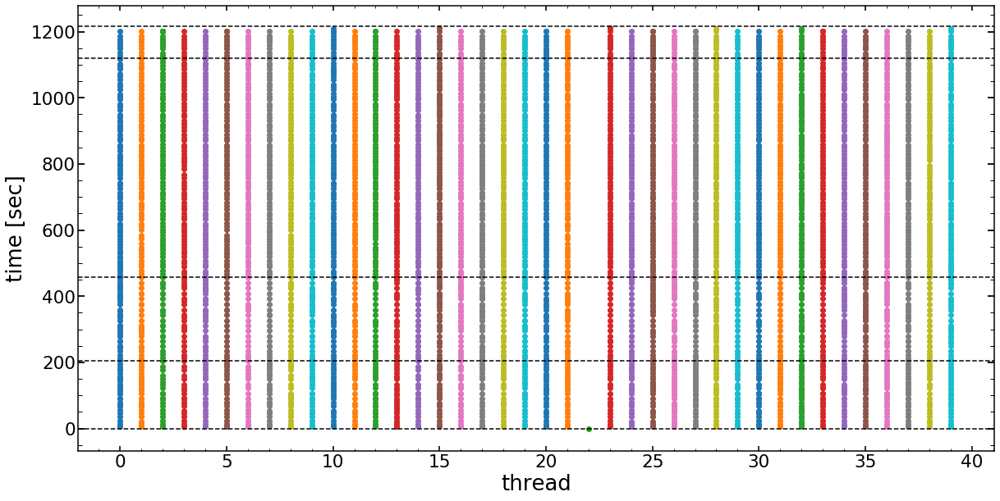

In [80]:
starting_threads=np.unique(array_of_starting[:,3])
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_1_node/chainJul0620_Single_P_21448617HgAr_list_of_times.npy')
min_time=np.min(array_of_starting[:,2].astype(float))

plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_starting_single_thread[:,2]))*i,array_of_starting_single_thread[:,2].astype(float)-min_time)
    
plt.axhline(0,color='black',ls='--')   
plt.axhline(list_of_times[0],color='black',ls='--')
plt.axhline(list_of_times[1],color='black',ls='--')
plt.axhline(list_of_times[2],color='black',ls='--')
plt.axhline(list_of_times[3],color='black',ls='--')

plt.xlabel('thread')
plt.ylabel('time [sec]')

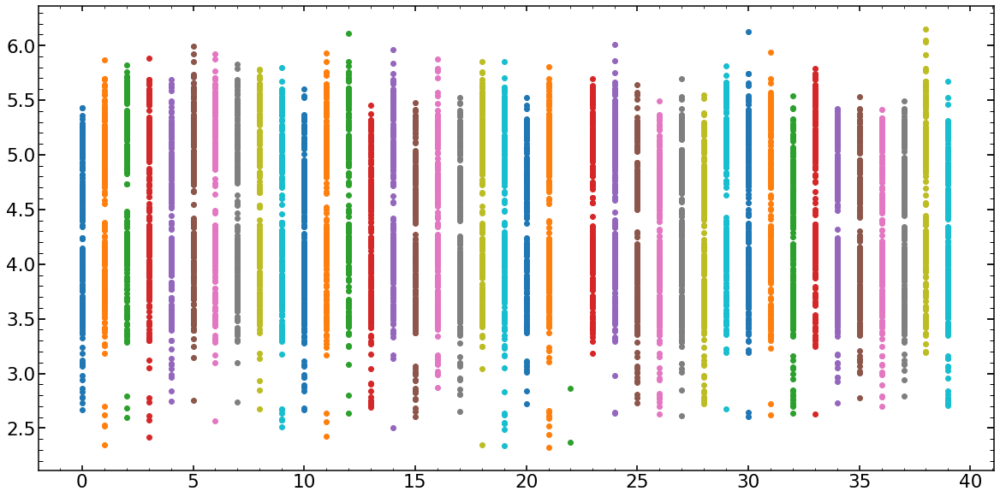

In [81]:
plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_lnlike_time_single_thread=array_of_lnlike_time[array_of_lnlike_time[:,1]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_lnlike_time_single_thread[:,1]))*i,array_of_lnlike_time_single_thread[:,2].astype(float))

In [82]:
np.mean(array_of_lnlike_time[:,2].astype(float))

4.389994553986798

In [87]:
np.mean(array_of_lnlike_time[0:2][:,2].astype(float))

2.6170910596847534

## head node - 36 threads

In [404]:
lines=[]
filepath = '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_head_node/mpirun_tiger_sumire_output_with_thread_mkl.txt'
with open(filepath) as fp:
   line = fp.readline()
   cnt = 0
   while line:
       lines.append("Line {}: {}".format(cnt, line.strip()))
       line = fp.readline()
       cnt += 1
        
        
list_of_threading=[]


list_of_lines_starting=[]
list_of_lines_ending=[]
list_of_lines_FFT=[]
list_of_lines_lnlike_time=[]
list_of_lines_apodize=[]
list_of_lines_get_Pupil=[]
list_of_lines_Psf_position=[]
list_of_lines_postprocessing_Pupil=[]


for i in tqdm(range(len(lines))):
    try:
        index_threading=lines[i].index('threading')
        #print([i,lines[i][index_threading-10:]])
        list_of_threading.append([i,lines[i][index_threading-10:]])
    except:
        pass 
    
    try:    
        index_starting=lines[i].index('Starting LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_starting:]])
        lines_starting=lines[i]
        list_of_lines_starting.append(lines_starting)
        
        #list_of_starting.append([i,lines[i][index_starting+51:index_starting+71].replace(" ", "") ,lines[i][index_starting+74:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    try:            
        index_ending=lines[i].index('Ending LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_ending:]])
        list_of_lines_ending.append(lines[i])
        
        
        #list_of_ending.append([i,lines[i][index_starting+50:index_starting+70].replace(" ", "") ,lines[i][index_ending+72:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    
    try:
        index_time_for_lnlike=lines[i].index('Time for lnlike_Neven')
        print([i,lines[i][index_time_for_lnlike+40:index_time_for_lnlike+55],lines[i][index_time_for_lnlike+60:index_time_for_lnlike+70]])
        list_of_lines_lnlike_time.append(lines[i])   
    except:
        pass

    try:
        index_time_for_get_Pupil=lines[i].index('Time for _get_Pupil function is')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_get_Pupil+31:index_time_for_get_Pupil+41]])
        list_of_lines_get_Pupil.append(lines[i][index_time_for_get_Pupil+31:index_time_for_get_Pupil+41])   
    except:
        pass

    try:
        index_time_for_postprocessing_Pupil=lines[i].index('Time for postprocessing pupil after _get_Pupil')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_postprocessing_Pupil+46:index_time_for_postprocessing_Pupil+53]])
        list_of_lines_postprocessing_Pupil.append(lines[i][index_time_for_postprocessing_Pupil+46:index_time_for_postprocessing_Pupil+53])   
    except:
        pass    

    
    
    try:
        index_time_for_apodize=lines[i].index('Time to apodize the pupil:')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_apodize+26:index_time_for_apodize+38]])
        list_of_lines_apodize.append(lines[i][index_time_for_apodize+26:index_time_for_apodize+38])   
    except:
        pass

    try:
        index_time_for_FFT=lines[i].index('Time for FFT is ')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_FFT+16:index_time_for_FFT+26]])
        list_of_lines_FFT.append(lines[i][index_time_for_FFT+16:index_time_for_FFT+26])   
    except:
        pass    
    
 
    
    try:
        index_time_for_Psf_position=lines[i].index('Time for single_Psf_position protocol is')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_Psf_position+40:index_time_for_Psf_position+48]])
        list_of_lines_Psf_position.append(lines[i][index_time_for_Psf_position+40:index_time_for_Psf_position+48])   
    except:
        pass    
    

  0%|                                | 5616/1603290 [00:00<00:28, 56158.85it/s]

[82, 'Starting LN_PFS_multi_same_spot for parameters-hash 8321570476675522078 at 1594385392.691284 in thread 47698131926656']
[140, 'Line 140: Time for _get_Pupil function is 0.31561732292175293']
[140, ' 0.3156173']
[148, 'Line 148: Time to apodize the pupil: 0.06196928024291992']
[148, ' 0.061969280']
[150, 'Line 150: Time for postprocessing pupil after _get_Pupil 0.1588144302368164']
[150, ' 0.1588']
[161, 'Line 161: Time for FFT is 0.47968626022338867']
[161, '0.47968626']
[221, 'Line 221: Time for single_Psf_position protocol is 0.06887149810791016']
[221, ' 0.06887']
[231, ' 47698131926656', '1.66694951']
[282, 'Line 282: Time for _get_Pupil function is 0.007105827331542969']
[282, ' 0.0071058']
[290, 'Line 290: Time to apodize the pupil: 0.058684349060058594']
[290, ' 0.058684349']
[292, 'Line 292: Time for postprocessing pupil after _get_Pupil 0.1741783618927002']
[292, ' 0.1741']
[303, 'Line 303: Time for FFT is 0.4865896701812744']
[303, '0.48658967']
[377, 'Line 377: Time fo

  2%|▌                              | 30924/1603290 [00:00<00:22, 70150.97it/s]

[13131, ' 47089131138688', '2.34004831']
[13134, 'Ending LN_PFS_multi_same_spot for parameters-hash 2862149624837735692 at 1594385401.2144806 in thread 47089131138688']
[13152, 'Starting LN_PFS_multi_same_spot for parameters-hash 4377399419777926654 at 1594385401.2184486 in thread 47089131138688']
[13210, 'Line 13210: Time for _get_Pupil function is 0.5186307430267334']
[13210, ' 0.5186307']
[13218, 'Line 13218: Time to apodize the pupil: 0.10133886337280273']
[13218, ' 0.101338863']
[13220, 'Line 13220: Time for postprocessing pupil after _get_Pupil 0.36305785179138184']
[13220, ' 0.3630']
[13264, 'Line 13264: Time for single_Psf_position protocol is 0.18727540969848633']
[13264, ' 0.18727']
[13274, ' 47154794745472', '2.37849617']
[13277, 'Ending LN_PFS_multi_same_spot for parameters-hash 344218929753959118 at 1594385401.204188 in thread 47154794745472']
[13295, 'Starting LN_PFS_multi_same_spot for parameters-hash 69150915089547035 at 1594385401.2080224 in thread 47154794745472']
[13

  3%|▉                              | 47408/1603290 [00:00<00:20, 75992.51it/s]

[31289, 'Line 31289: Time for single_Psf_position protocol is 0.11861491203308105']
[31289, ' 0.11861']
[31304, 'Line 31304: Time for _get_Pupil function is 0.5722942352294922']
[31304, ' 0.5722942']
[31312, 'Line 31312: Time to apodize the pupil: 0.10205960273742676']
[31312, ' 0.102059602']
[31314, 'Line 31314: Time for postprocessing pupil after _get_Pupil 0.365964412689209']
[31314, ' 0.3659']
[31325, 'Line 31325: Time for FFT is 0.8274245262145996']
[31325, '0.82742452']
[31399, 'Line 31399: Time for single_Psf_position protocol is 0.19723963737487793']
[31399, ' 0.19723']
[31409, ' 47467510914688', '2.96699571']
[31535, 'Line 31535: Time for single_Psf_position protocol is 0.34942150115966797']
[31535, ' 0.34942']
[31545, ' 47126894714496', '3.13664484']
[31625, 'Line 31625: Time for single_Psf_position protocol is 0.30640363693237305']
[31625, ' 0.30640']
[31635, ' 46937703513728', '2.63571143']
[31686, 'Line 31686: Time for _get_Pupil function is 0.005155086517333984']
[31686, 

  4%|█▎                             | 65389/1603290 [00:00<00:18, 82485.41it/s]

[47617, ' 0.20209']
[47627, ' 47128835309184', '2.97478389']
[47709, 'Line 47709: Time for _get_Pupil function is 0.6189360618591309']
[47709, ' 0.6189360']
[47717, 'Line 47717: Time to apodize the pupil: 0.07837510108947754']
[47717, ' 0.078375101']
[47719, 'Line 47719: Time for postprocessing pupil after _get_Pupil 0.295696496963501']
[47719, ' 0.2956']
[47730, 'Line 47730: Time for FFT is 0.9108691215515137']
[47730, '0.91086912']
[47804, 'Line 47804: Time for postprocessing pupil after _get_Pupil 0.2804903984069824']
[47804, ' 0.2804']
[47815, 'Line 47815: Time for FFT is 0.9163799285888672']
[47815, '0.91637992']
[47903, 'Line 47903: Time for single_Psf_position protocol is 0.21266436576843262']
[47903, ' 0.21266']
[47913, ' 47552758472320', '3.01057195']
[47952, 'Line 47952: Time for FFT is 0.7718441486358643']
[47952, '0.77184414']
[48143, 'Line 48143: Time for single_Psf_position protocol is 0.2091660499572754']
[48143, ' 0.20916']
[48153, ' 47367805566592', '3.00613594']
[4820

  5%|█▌                             | 82369/1603290 [00:01<00:18, 83809.18it/s]

[65876, '0.77713513']
[65950, 'Line 65950: Time for single_Psf_position protocol is 0.1203010082244873']
[65950, ' 0.12030']
[65960, ' 47973675126400', '2.11860299']
[65963, 'Ending LN_PFS_multi_same_spot for parameters-hash -2691407008509099798 at 1594385424.6151412 in thread 47973675126400']
[65981, 'Starting LN_PFS_multi_same_spot for parameters-hash -2691407008509099798 at 1594385424.6184137 in thread 47973675126400']
[66009, 'Line 66009: Time for single_Psf_position protocol is 0.30243635177612305']
[66009, ' 0.30243']
[66019, ' 47106999848576', '2.88379359']
[66070, 'Line 66070: Time for _get_Pupil function is 0.003831148147583008']
[66070, ' 0.0038311']
[66078, 'Line 66078: Time to apodize the pupil: 0.11846303939819336']
[66078, ' 0.118463039']
[66080, 'Line 66080: Time for postprocessing pupil after _get_Pupil 0.3600480556488037']
[66080, ' 0.3600']
[66091, 'Line 66091: Time for FFT is 0.7457284927368164']
[66091, '0.74572849']
[66165, 'Line 66165: Time for single_Psf_position

  6%|█▉                            | 101500/1603290 [00:01<00:19, 77918.73it/s]

[85483, ' 47392718290560', '1.95792293']
[85486, 'Ending LN_PFS_multi_same_spot for parameters-hash 3721074053012927337 at 1594385433.1403215 in thread 47392718290560']
[85504, 'Starting LN_PFS_multi_same_spot for parameters-hash 3721074053012927337 at 1594385433.242102 in thread 47392718290560']
[85562, 'Line 85562: Time for _get_Pupil function is 0.6356072425842285']
[85562, ' 0.6356072']
[85570, 'Line 85570: Time to apodize the pupil: 0.08212590217590332']
[85570, ' 0.082125902']
[85572, 'Line 85572: Time for postprocessing pupil after _get_Pupil 0.2681539058685303']
[85572, ' 0.2681']
[85595, 'Line 85595: Time for single_Psf_position protocol is 0.11170554161071777']
[85595, ' 0.11170']
[85605, ' 47552758472320', '2.09980440']
[85608, 'Ending LN_PFS_multi_same_spot for parameters-hash 2441086077543747844 at 1594385429.166803 in thread 47552758472320']
[85626, 'Starting LN_PFS_multi_same_spot for parameters-hash 2441086077543747844 at 1594385433.2409716 in thread 47552758472320']
[8

  7%|██▏                           | 119780/1603290 [00:01<00:17, 84324.16it/s]

[102176, '0.81555318']
[102224, 'Starting LN_PFS_multi_same_spot for parameters-hash -511820869018811343 at 1594385438.3511808 in thread 47106999848576']
[102282, 'Line 102282: Time for _get_Pupil function is 0.4581427574157715']
[102282, ' 0.4581427']
[102290, 'Line 102290: Time to apodize the pupil: 0.10812711715698242']
[102290, ' 0.108127117']
[102292, 'Line 102292: Time for postprocessing pupil after _get_Pupil 0.3424546718597412']
[102292, ' 0.3424']
[102303, 'Line 102303: Time for FFT is 0.819547176361084']
[102303, '0.81954717']
[102370, 'Starting LN_PFS_multi_same_spot for parameters-hash 267962245954565554 at 1594385438.3343146 in thread 47773933674112']
[102428, 'Line 102428: Time for _get_Pupil function is 0.4587547779083252']
[102428, ' 0.4587547']
[102436, 'Line 102436: Time to apodize the pupil: 0.09417605400085449']
[102436, ' 0.094176054']
[102438, 'Line 102438: Time for postprocessing pupil after _get_Pupil 0.3152658939361572']
[102438, ' 0.3152']
[102449, 'Line 10244

  9%|██▌                           | 138498/1603290 [00:01<00:16, 88665.65it/s]

[120681, ' 0.5385730']
[120689, 'Line 120689: Time to apodize the pupil: 0.08528923988342285']
[120689, ' 0.085289239']
[120691, 'Line 120691: Time for postprocessing pupil after _get_Pupil 0.31446337699890137']
[120691, ' 0.3144']
[120702, 'Line 120702: Time for FFT is 0.9201552867889404']
[120702, '0.92015528']
[120741, 'Starting LN_PFS_multi_same_spot for parameters-hash -9149771350219367093 at 1594385447.0724516 in thread 46990526783104']
[120793, 'Starting LN_PFS_multi_same_spot for parameters-hash -9149771350219367093 at 1594385447.075971 in thread 46990526783104']
[120851, 'Line 120851: Time for _get_Pupil function is 0.5568804740905762']
[120851, ' 0.5568804']
[120859, 'Line 120859: Time to apodize the pupil: 0.07838559150695801']
[120859, ' 0.078385591']
[120861, 'Line 120861: Time for postprocessing pupil after _get_Pupil 0.3078436851501465']
[120861, ' 0.3078']
[120872, 'Line 120872: Time for FFT is 0.9245789051055908']
[120872, '0.92457890']
[120895, 'Line 120895: Time for 

 10%|██▉                           | 159169/1603290 [00:01<00:15, 95682.93it/s]


[142111, ' 0.2771']
[142122, 'Line 142122: Time for FFT is 0.833909273147583']
[142122, '0.83390927']
[142182, 'Line 142182: Time for single_Psf_position protocol is 0.10576272010803223']
[142182, ' 0.10576']
[142204, 'Line 142204: Time for single_Psf_position protocol is 0.11768698692321777']
[142204, ' 0.11768']
[142214, ' 47973675126400', '2.12883830']
[142217, 'Ending LN_PFS_multi_same_spot for parameters-hash -6999540196802291547 at 1594385452.2585027 in thread 47973675126400']
[142235, 'Starting LN_PFS_multi_same_spot for parameters-hash 8751634712631811987 at 1594385456.4554436 in thread 47973675126400']
[142293, 'Line 142293: Time for _get_Pupil function is 0.6020100116729736']
[142293, ' 0.6020100']
[142301, 'Line 142301: Time to apodize the pupil: 0.08127045631408691']
[142301, ' 0.081270456']
[142303, 'Line 142303: Time for postprocessing pupil after _get_Pupil 0.29842066764831543']
[142303, ' 0.2984']
[142314, 'Line 142314: Time for FFT is 0.8686127662658691']
[142314, '0.

 11%|███▎                          | 178355/1603290 [00:02<00:16, 84261.84it/s]

[165488, ' 47278621253248', '2.10958600']
[165491, 'Ending LN_PFS_multi_same_spot for parameters-hash 1042241732087408033 at 1594385466.1281383 in thread 47278621253248']
[165509, 'Starting LN_PFS_multi_same_spot for parameters-hash 1042241732087408033 at 1594385466.3820672 in thread 47278621253248']
[165567, 'Line 165567: Time for _get_Pupil function is 0.6583511829376221']
[165567, ' 0.6583511']
[165575, 'Line 165575: Time to apodize the pupil: 0.09738659858703613']
[165575, ' 0.097386598']
[165577, 'Line 165577: Time for postprocessing pupil after _get_Pupil 0.34482741355895996']
[165577, ' 0.3448']
[165588, 'Line 165588: Time for FFT is 0.778329610824585']
[165588, '0.77832961']
[165637, 'Starting LN_PFS_multi_same_spot for parameters-hash 721551764596428474 at 1594385466.3839474 in thread 47117364158080']
[165695, 'Line 165695: Time for _get_Pupil function is 0.5299990177154541']
[165695, ' 0.5299990']
[165703, 'Line 165703: Time to apodize the pupil: 0.07221078872680664']
[165703

 12%|███▍                          | 187037/1603290 [00:02<00:21, 67262.26it/s]


[179576, 'Ending LN_PFS_multi_same_spot for parameters-hash 3872756291942993955 at 1594385471.4810925 in thread 47773933674112']
[179594, 'Starting LN_PFS_multi_same_spot for parameters-hash 3872756291942993955 at 1594385471.483704 in thread 47773933674112']
[179652, 'Line 179652: Time for _get_Pupil function is 0.5191268920898438']
[179652, ' 0.5191268']
[179660, 'Line 179660: Time to apodize the pupil: 0.07384252548217773']
[179660, ' 0.073842525']
[179662, 'Line 179662: Time for postprocessing pupil after _get_Pupil 0.26157426834106445']
[179662, ' 0.2615']
[179673, 'Line 179673: Time for FFT is 0.8344767093658447']
[179673, '0.83447670']
[179777, 'Line 179777: Time for _get_Pupil function is 0.5138731002807617']
[179777, ' 0.5138731']
[179785, 'Line 179785: Time to apodize the pupil: 0.08082771301269531']
[179785, ' 0.080827713']
[179787, 'Line 179787: Time for postprocessing pupil after _get_Pupil 0.28996753692626953']
[179787, ' 0.2899']
[179798, 'Line 179798: Time for FFT is 0.

 13%|███▊                          | 204146/1603290 [00:02<00:18, 75654.72it/s]


[191408, ' 0.2981']
[191419, 'Line 191419: Time for FFT is 0.7446014881134033']
[191419, '0.74460148']
[191492, 'Line 191492: Time for FFT is 0.6629424095153809']
[191492, '0.66294240']
[191577, 'Line 191577: Time for single_Psf_position protocol is 0.15003061294555664']
[191577, ' 0.15003']
[191587, ' 46990526783104', '2.34400749']
[191641, 'Line 191641: Time for FFT is 0.7326087951660156']
[191641, '0.73260879']
[191715, 'Line 191715: Time for single_Psf_position protocol is 0.11649179458618164']
[191715, ' 0.11649']
[191725, ' 47079789948544', '2.50956201']
[191776, 'Line 191776: Time for _get_Pupil function is 0.004525661468505859']
[191776, ' 0.0045256']
[191800, 'Line 191800: Time for _get_Pupil function is 0.43201541900634766']
[191800, ' 0.4320154']
[191808, 'Line 191808: Time to apodize the pupil: 0.07865428924560547']
[191808, ' 0.078654289']
[191810, 'Line 191810: Time for postprocessing pupil after _get_Pupil 0.25968456268310547']
[191810, ' 0.2596']
[191821, 'Line 191821:

 14%|████▏                         | 222103/1603290 [00:02<00:16, 82554.50it/s]


[211168, 'Ending LN_PFS_multi_same_spot for parameters-hash 1751657268869447176 at 1594385486.2771776 in thread 47672086830720']
[211186, 'Starting LN_PFS_multi_same_spot for parameters-hash 2492153422537045879 at 1594385486.280511 in thread 47672086830720']
[211284, 'Line 211284: Time for single_Psf_position protocol is 0.12455058097839355']
[211284, ' 0.12455']
[211294, ' 47079789948544', '2.03064584']
[211297, 'Ending LN_PFS_multi_same_spot for parameters-hash 2403233874346838428 at 1594385485.978172 in thread 47079789948544']
[211315, 'Starting LN_PFS_multi_same_spot for parameters-hash 2403233874346838428 at 1594385485.9811523 in thread 47079789948544']
[211373, 'Line 211373: Time for _get_Pupil function is 0.4895925521850586']
[211373, ' 0.4895925']
[211381, "Line 211381: Time to apodize the pupil: 0.10441875457763672type(pointsx): <class 'numpy.float32'>"]
[211381, ' 0.104418754']
[211420, 'Line 211420: Time for single_Psf_position protocol is 0.08275461196899414']
[211420, ' 0

 16%|████▋                         | 248917/1603290 [00:02<00:15, 87300.00it/s]


[229840, 'Line 229840: Time for single_Psf_position protocol is 0.10153508186340332']
[229840, ' 0.10153']
[229850, ' 47552758472320', '2.62954974']
[229889, 'Line 229889: Time for FFT is 0.800142765045166']
[229889, '0.80014276']
[229974, 'Line 229974: Time for single_Psf_position protocol is 0.17740917205810547']
[229974, ' 0.17740']
[229984, ' 47057272016512', '2.70190143']
[230035, ' 47126894714496', '2.19637966']
[230038, 'Ending LN_PFS_multi_same_spot for parameters-hash 7687785399476164800 at 1594385491.3759346 in thread 47126894714496']
[230056, 'Starting LN_PFS_multi_same_spot for parameters-hash 7687785399476164800 at 1594385491.3788402 in thread 47126894714496']
[230114, 'Line 230114: Time for _get_Pupil function is 0.5248968601226807']
[230114, ' 0.5248968']
[230122, 'Line 230122: Time to apodize the pupil: 0.09120821952819824']
[230122, ' 0.091208219']
[230124, 'Line 230124: Time for postprocessing pupil after _get_Pupil 0.3310990333557129']
[230124, ' 0.3310']
[230135, '

 17%|████▉                         | 267009/1603290 [00:03<00:15, 88617.79it/s]


[249065, ' 47887958113920', '2.96223282']
[249116, 'Line 249116: Time for _get_Pupil function is 0.0037031173706054688']
[249116, ' 0.0037031']
[249124, 'Line 249124: Time to apodize the pupil: 0.08803105354309082']
[249124, ' 0.088031053']
[249126, 'Line 249126: Time for postprocessing pupil after _get_Pupil 0.33176541328430176']
[249126, ' 0.3317']
[249137, 'Line 249137: Time for FFT is 0.7952566146850586']
[249137, '0.79525661']
[249192, 'Line 249192: Time for FFT is 0.7243618965148926']
[249192, '0.72436189']
[249266, 'Line 249266: Time for single_Psf_position protocol is 0.12802720069885254']
[249266, ' 0.12802']
[249276, ' 47483442433664', '2.06687927']
[249279, 'Ending LN_PFS_multi_same_spot for parameters-hash 1039592493480483848 at 1594385503.5377915 in thread 47483442433664']
[249297, 'Starting LN_PFS_multi_same_spot for parameters-hash 1039592493480483848 at 1594385503.5410337 in thread 47483442433664']
[249357, 'Line 249357: Time for single_Psf_position protocol is 0.32034

 18%|█████▎                        | 286083/1603290 [00:03<00:14, 91380.06it/s]

[268034, ' 47552758472320', '2.74784064']
[268121, 'Line 268121: Time for _get_Pupil function is 0.4954490661621094']
[268121, ' 0.4954490']
[268129, 'Line 268129: Time to apodize the pupil: 0.09078621864318848']
[268129, ' 0.090786218']
[268131, 'Line 268131: Time for postprocessing pupil after _get_Pupil 0.3267052173614502']
[268131, ' 0.3267']
[268142, 'Line 268142: Time for FFT is 0.7883815765380859']
[268142, '0.78838157']
[268214, 'Starting LN_PFS_multi_same_spot for parameters-hash -6805515179740063678 at 1594385508.453095 in thread 47467510914688']
[268272, 'Line 268272: Time for _get_Pupil function is 0.49616479873657227']
[268272, ' 0.4961647']
[268280, 'Line 268280: Time to apodize the pupil: 0.08993053436279297']
[268280, ' 0.089930534']
[268282, 'Line 268282: Time for postprocessing pupil after _get_Pupil 0.3275260925292969']
[268282, ' 0.3275']
[268293, 'Line 268293: Time for FFT is 0.7933928966522217']
[268293, '0.79339289']
[268364, 'Line 268364: Time for FFT is 0.67297

 19%|█████▋                        | 304464/1603290 [00:03<00:14, 88352.02it/s]


[287346, ' 0.0022318']
[287354, 'Line 287354: Time to apodize the pupil: 0.08827948570251465']
[287354, ' 0.088279485']
[287356, 'Line 287356: Time for postprocessing pupil after _get_Pupil 0.28852009773254395']
[287356, ' 0.2885']
[287367, 'Line 287367: Time for FFT is 0.820446252822876']
[287367, '0.82044625']
[287411, 'Line 287411: Time for _get_Pupil function is 0.0032858848571777344']
[287411, ' 0.0032858']
[287419, 'Line 287419: Time to apodize the pupil: 0.08461523056030273']
[287419, ' 0.084615230']
[287421, 'Line 287421: Time for postprocessing pupil after _get_Pupil 0.28273868560791016']
[287421, ' 0.2827']
[287432, 'Line 287432: Time for FFT is 0.7971975803375244']
[287432, '0.79719758']
[287492, 'Line 287492: Time for single_Psf_position protocol is 0.0871741771697998']
[287492, ' 0.08717']
[287502, ' 46937703513728', '2.07624173']
[287505, 'Ending LN_PFS_multi_same_spot for parameters-hash -5042475241210718638 at 1594385521.72926 in thread 46937703513728']
[287506, 'Start

 20%|██████                        | 322913/1603290 [00:03<00:16, 77130.67it/s]

[306903, '0.79134297']
[307001, 'Line 307001: Time for single_Psf_position protocol is 0.19936633110046387']
[307001, ' 0.19936']
[307011, ' 47117364158080', '2.63568067']
[307062, 'Line 307062: Time for _get_Pupil function is 0.003098726272583008']
[307062, ' 0.0030987']
[307070, 'Line 307070: Time to apodize the pupil: 0.07688546180725098']
[307070, ' 0.076885461']
[307072, 'Line 307072: Time for postprocessing pupil after _get_Pupil 0.2648179531097412']
[307072, ' 0.2648']
[307120, 'Line 307120: Time for _get_Pupil function is 0.4691479206085205']
[307120, ' 0.4691479']
[307128, 'Line 307128: Time to apodize the pupil: 0.09523272514343262']
[307128, ' 0.095232725']
[307130, 'Line 307130: Time for postprocessing pupil after _get_Pupil 0.3139984607696533']
[307130, ' 0.3139']
[307141, 'Line 307141: Time for FFT is 0.820249080657959']
[307141, '0.82024908']
[307228, 'Line 307228: Time for single_Psf_position protocol is 0.14026093482971191']
[307228, ' 0.14026']
[307238, ' 471069998485

 21%|██████▎                       | 338987/1603290 [00:04<00:16, 77619.60it/s]


[323594, ' 47367805566592', '2.88678574']
[323647, ' 47556443115136', '2.15434741']
[323650, 'Ending LN_PFS_multi_same_spot for parameters-hash -5151512929906164198 at 1594385531.3719645 in thread 47556443115136']
[323651, 'Starting LN_PFS_multi_same_spot for parameters-hash 2916417373359964158 at 1594385535.5829148 in thread 47556443115136']
[323709, 'Line 323709: Time for _get_Pupil function is 0.6182787418365479']
[323709, ' 0.6182787']
[323717, 'Line 323717: Time to apodize the pupil: 0.0881805419921875']
[323717, ' 0.088180541']
[323719, 'Line 323719: Time for postprocessing pupil after _get_Pupil 0.31784534454345703']
[323719, ' 0.3178']
[323730, 'Line 323730: Time for FFT is 0.8450653553009033']
[323730, '0.84506535']
[323790, 'Line 323790: Time for single_Psf_position protocol is 0.11805367469787598']
[323790, ' 0.11805']
[323815, 'Line 323815: Time for _get_Pupil function is 0.6204712390899658']
[323815, ' 0.6204712']
[323823, 'Line 323823: Time to apodize the pupil: 0.068521

 22%|██████▋                       | 355358/1603290 [00:04<00:15, 78328.59it/s]

[341157, ' 0.17131']
[341167, ' 47154794745472', '2.88305616']
[341218, 'Line 341218: Time for _get_Pupil function is 0.003574371337890625']
[341218, ' 0.0035743']
[341226, 'Line 341226: Time to apodize the pupil: 0.09585022926330566']
[341226, ' 0.095850229']
[341228, 'Line 341228: Time for postprocessing pupil after _get_Pupil 0.314359188079834']
[341228, ' 0.3143']
[341282, 'Line 341282: Time for single_Psf_position protocol is 0.2534496784210205']
[341282, ' 0.25344']
[341292, ' 47773933674112', '2.92896771']
[341343, 'Line 341343: Time for _get_Pupil function is 0.002492666244506836']
[341343, ' 0.0024926']
[341351, 'Line 341351: Time to apodize the pupil: 0.0915536880493164']
[341351, ' 0.091553688']
[341353, 'Line 341353: Time for postprocessing pupil after _get_Pupil 0.3052327632904053']
[341353, ' 0.3052']
[341414, 'Line 341414: Time for single_Psf_position protocol is 0.2546098232269287']
[341414, ' 0.25460']
[341424, ' 47126894714496', '2.93892025']
[341475, 'Line 341475: Ti

 23%|██████▉                       | 373198/1603290 [00:04<00:14, 83502.90it/s]

[360362, ' 0.096656322']
[360364, 'Line 360364: Time for postprocessing pupil after _get_Pupil 0.3272395133972168']
[360364, ' 0.3272']
[360375, 'Line 360375: Time for FFT is 0.8211970329284668']
[360375, '0.82119703']
[360463, 'Line 360463: Time for single_Psf_position protocol is 0.1603703498840332']
[360463, ' 0.16037']
[360476, 'Line 360476: Time for _get_Pupil function is 0.0036902427673339844']
[360476, ' 0.0036902']
[360484, 'Line 360484: Time to apodize the pupil: 0.08338761329650879']
[360484, ' 0.083387613']
[360486, 'Line 360486: Time for postprocessing pupil after _get_Pupil 0.2810077667236328']
[360486, ' 0.2810']
[360497, 'Line 360497: Time for FFT is 0.8591434955596924']
[360497, '0.85914349']
[360585, 'Line 360585: Time for single_Psf_position protocol is 0.19464778900146484']
[360585, ' 0.19464']
[360719, 'Line 360719: Time for _get_Pupil function is 0.003435850143432617']
[360719, ' 0.0034358']
[360727, 'Line 360727: Time to apodize the pupil: 0.10795068740844727']
[3

 24%|███████▎                      | 389998/1603290 [00:04<00:14, 83120.41it/s]


[379021, 'Line 379021: Time for FFT is 0.6789231300354004']
[379021, '0.67892313']
[379091, 'Line 379091: Time for _get_Pupil function is 0.4536316394805908']
[379091, ' 0.4536316']
[379099, 'Line 379099: Time to apodize the pupil: 0.08128643035888672']
[379099, ' 0.081286430']
[379101, 'Line 379101: Time for postprocessing pupil after _get_Pupil 0.256605863571167']
[379101, ' 0.2566']
[379112, 'Line 379112: Time for FFT is 0.6917898654937744']
[379112, '0.69178986']
[379172, 'Line 379172: Time for single_Psf_position protocol is 0.0884554386138916']
[379172, ' 0.08845']
[379182, ' 47966408724096', '2.36205840']
[379207, 'Line 379207: Time for single_Psf_position protocol is 0.1762712001800537']
[379207, ' 0.17627']
[379217, ' 47744365895296', '2.17306566']
[379220, 'Ending LN_PFS_multi_same_spot for parameters-hash 950332400524901653 at 1594385567.417529 in thread 47744365895296']
[379221, 'Starting LN_PFS_multi_same_spot for parameters-hash 950332400524901653 at 1594385567.4193096 i

 25%|███████▌                      | 406822/1603290 [00:04<00:16, 70496.49it/s]


[397933, 'Line 397933: Time for FFT is 0.6469366550445557']
[397933, '0.64693665']
[398018, 'Line 398018: Time for single_Psf_position protocol is 0.13610243797302246']
[398018, ' 0.13610']
[398028, ' 47392718290560', '1.87970948']
[398031, 'Ending LN_PFS_multi_same_spot for parameters-hash -168412668338040182 at 1594385580.936532 in thread 47392718290560']
[398032, 'Starting LN_PFS_multi_same_spot for parameters-hash -168412668338040182 at 1594385580.939539 in thread 47392718290560']
[398058, 'Line 398058: Time to apodize the pupil: 0.09220027923583984']
[398058, ' 0.092200279']
[398060, 'Line 398060: Time for postprocessing pupil after _get_Pupil 0.3251924514770508']
[398060, ' 0.3251']
[398071, 'Line 398071: Time for FFT is 0.7836968898773193']
[398071, '0.78369688']
[398145, 'Line 398145: Time for single_Psf_position protocol is 0.13022923469543457']
[398145, ' 0.13022']
[398155, ' 47887958113920', '2.17250657']
[398158, 'Ending LN_PFS_multi_same_spot for parameters-hash 833024061

 26%|███████▊                      | 414239/1603290 [00:05<00:18, 63542.91it/s]


[408048, 'Line 408048: Time to apodize the pupil: 0.07636618614196777']
[408048, ' 0.076366186']
[408050, 'Line 408050: Time for postprocessing pupil after _get_Pupil 0.2658345699310303']
[408050, ' 0.2658']
[408061, 'Line 408061: Time for FFT is 0.7850823402404785']
[408061, '0.78508234']
[408135, 'Line 408135: Time for single_Psf_position protocol is 0.1302506923675537']
[408135, ' 0.13025']
[408145, ' 47711540788864', '2.12582397']
[408148, 'Ending LN_PFS_multi_same_spot for parameters-hash 960338780390956428 at 1594385585.8462443 in thread 47711540788864']
[408149, 'Starting LN_PFS_multi_same_spot for parameters-hash 960338780390956428 at 1594385585.8480484 in thread 47711540788864']
[408159, 'Line 408159: Time for single_Psf_position protocol is 0.16060853004455566']
[408159, ' 0.16060']
[408169, ' 47527771897472', '2.83061242']
[408220, 'Line 408220: Time for _get_Pupil function is 0.002389669418334961']
[408220, ' 0.0023896']
[408228, 'Line 408228: Time to apodize the pupil: 0.

 27%|████████▏                     | 438306/1603290 [00:05<00:16, 71957.47it/s]

[418996, ' 0.080752372']
[418998, 'Line 418998: Time for postprocessing pupil after _get_Pupil 0.2719309329986572']
[418998, ' 0.2719']
[419009, 'Line 419009: Time for FFT is 0.7520363330841064']
[419009, '0.75203633']
[419051, 'Line 419051: Time for single_Psf_position protocol is 0.10545134544372559']
[419051, ' 0.10545']
[419061, ' 47615403986560', '1.74327945']
[419064, 'Ending LN_PFS_multi_same_spot for parameters-hash 5368367679176671098 at 1594385589.8388894 in thread 47615403986560']
[419065, 'Starting LN_PFS_multi_same_spot for parameters-hash 5368367679176671098 at 1594385589.9628067 in thread 47615403986560']
[419123, 'Line 419123: Time for _get_Pupil function is 0.5765197277069092']
[419123, ' 0.5765197']
[419131, 'Line 419131: Time to apodize the pupil: 0.07553744316101074']
[419131, ' 0.075537443']
[419133, 'Line 419133: Time for postprocessing pupil after _get_Pupil 0.2597064971923828']
[419133, ' 0.2597']
[419144, 'Line 419144: Time for FFT is 0.7516238689422607']
[4191

 28%|████████▎                     | 445861/1603290 [00:05<00:17, 66551.98it/s]

[438374, 'Line 438374: Time for _get_Pupil function is 0.57969069480896']
[438374, ' 0.5796906']
[438382, 'Line 438382: Time to apodize the pupil: 0.0721883773803711']
[438382, ' 0.072188377']
[438384, 'Line 438384: Time for postprocessing pupil after _get_Pupil 0.27857303619384766']
[438384, ' 0.2785']
[438395, 'Line 438395: Time for FFT is 0.7768762111663818']
[438395, '0.77687621']
[438484, ' 47128835309184', '1.45909667']
[438487, 'Ending LN_PFS_multi_same_spot for parameters-hash 4132804049790470526 at 1594385598.0946574 in thread 47128835309184']
[438488, 'Starting LN_PFS_multi_same_spot for parameters-hash 4132804049790470526 at 1594385599.5952914 in thread 47128835309184']
[438546, 'Line 438546: Time for _get_Pupil function is 0.5628244876861572']
[438546, ' 0.5628244']
[438554, 'Line 438554: Time to apodize the pupil: 0.08097004890441895']
[438554, ' 0.080970048']
[438556, 'Line 438556: Time for postprocessing pupil after _get_Pupil 0.3046700954437256']
[438556, ' 0.3046']
[43

 29%|████████▋                     | 461110/1603290 [00:05<00:16, 69941.14it/s]

[450871, ' 0.0019450']
[450879, 'Line 450879: Time to apodize the pupil: 0.06648778915405273']
[450879, ' 0.066487789']
[450881, 'Line 450881: Time for postprocessing pupil after _get_Pupil 0.20466089248657227']
[450881, ' 0.2046']
[450892, 'Line 450892: Time for FFT is 0.6774284839630127']
[450892, '0.67742848']
[450907, 'Line 450907: Time for single_Psf_position protocol is 0.0736551284790039']
[450907, ' 0.07365']
[450917, ' 46990526783104', '1.85264372']
[450968, 'Line 450968: Time for _get_Pupil function is 0.0017211437225341797']
[450968, ' 0.0017211']
[450976, 'Line 450976: Time to apodize the pupil: 0.06916332244873047']
[450976, ' 0.069163322']
[450978, 'Line 450978: Time for postprocessing pupil after _get_Pupil 0.19363975524902344']
[450978, ' 0.1936']
[450989, 'Line 450989: Time for FFT is 0.5456485748291016']
[450989, '0.54564857']
[451073, 'Line 451073: Time for _get_Pupil function is 0.002004861831665039']
[451073, ' 0.0020048']
[451081, 'Line 451081: Time to apodize the

 30%|████████▉                     | 478189/1603290 [00:05<00:14, 76907.17it/s]


[466515, ' 0.3033']
[466568, 'Line 466568: Time for single_Psf_position protocol is 0.22893357276916504']
[466568, ' 0.22893']
[466578, ' 47392718290560', '2.17923259']
[466581, 'Ending LN_PFS_multi_same_spot for parameters-hash -5661493201881608431 at 1594385613.9784973 in thread 47392718290560']
[466582, 'Starting LN_PFS_multi_same_spot for parameters-hash -5661493201881608431 at 1594385613.9802897 in thread 47392718290560']
[466640, 'Line 466640: Time for _get_Pupil function is 0.47318530082702637']
[466640, ' 0.4731853']
[466648, 'Line 466648: Time to apodize the pupil: 0.08962249755859375']
[466648, ' 0.089622497']
[466650, 'Line 466650: Time for postprocessing pupil after _get_Pupil 0.29544687271118164']
[466650, ' 0.2954']
[466697, 'Line 466697: Time for single_Psf_position protocol is 0.09775185585021973']
[466697, ' 0.09775']
[466707, ' 47552758472320', '2.11794114']
[466710, 'Ending LN_PFS_multi_same_spot for parameters-hash -4056942048392144719 at 1594385614.007425 in threa

 31%|█████████▏                    | 493512/1603290 [00:06<00:15, 72421.58it/s]


[482436, 'Line 482436: Time for _get_Pupil function is 0.002475261688232422']
[482436, ' 0.0024752']
[482444, 'Line 482444: Time to apodize the pupil: 0.07109642028808594']
[482444, ' 0.071096420']
[482446, 'Line 482446: Time for postprocessing pupil after _get_Pupil 0.253298282623291']
[482446, ' 0.2532']
[482457, 'Line 482457: Time for FFT is 0.8271121978759766']
[482457, '0.82711219']
[482517, 'Line 482517: Time for single_Psf_position protocol is 0.08004641532897949']
[482517, ' 0.08004']
[482527, ' 47975714025088', '2.08458089']
[482530, 'Ending LN_PFS_multi_same_spot for parameters-hash -1075049754876424735 at 1594385623.3534284 in thread 47975714025088']
[482531, 'Starting LN_PFS_multi_same_spot for parameters-hash -1075049754876424735 at 1594385623.355138 in thread 47975714025088']
[482591, 'Line 482591: Time for single_Psf_position protocol is 0.08635687828063965']
[482591, ' 0.08635']
[482601, ' 47773933674112', '2.82365274']
[482652, 'Line 482652: Time for _get_Pupil functi

 32%|█████████▋                    | 515396/1603290 [00:06<00:15, 71307.73it/s]

[496654, 'Line 496654: Time to apodize the pupil: 0.1049654483795166']
[496654, ' 0.104965448']
[496656, 'Line 496656: Time for postprocessing pupil after _get_Pupil 0.4075009822845459']
[496656, ' 0.4075']
[496667, 'Line 496667: Time for FFT is 0.7154176235198975']
[496667, '0.71541762']
[496755, 'Line 496755: Time for single_Psf_position protocol is 0.21765899658203125']
[496755, ' 0.21765']
[496763, 'Line 496763: Time for FFT is 0.8425252437591553']
[496763, '0.84252524']
[496837, 'Line 496837: Time for single_Psf_position protocol is 0.12491679191589355']
[496837, ' 0.12491']
[496847, ' 47089131138688', '2.78831410']
[496898, 'Line 496898: Time for _get_Pupil function is 0.0026454925537109375']
[496898, ' 0.0026454']
[496906, 'Line 496906: Time to apodize the pupil: 0.07839012145996094']
[496906, ' 0.078390121']
[496908, 'Line 496908: Time for postprocessing pupil after _get_Pupil 0.23119378089904785']
[496908, ' 0.2311']
[496981, 'Line 496981: Time for single_Psf_position protocol

 33%|█████████▊                    | 522576/1603290 [00:06<00:15, 69389.80it/s]

[515507, '0.85715055']
[515598, 'Line 515598: Time for _get_Pupil function is 0.619600772857666']
[515598, ' 0.6196007']
[515606, 'Line 515606: Time to apodize the pupil: 0.0892181396484375']
[515606, ' 0.089218139']
[515608, 'Line 515608: Time for postprocessing pupil after _get_Pupil 0.3155791759490967']
[515608, ' 0.3155']
[515619, 'Line 515619: Time for FFT is 0.8562989234924316']
[515619, '0.85629892']
[515693, 'Line 515693: Time for single_Psf_position protocol is 0.17731094360351562']
[515693, ' 0.17731']
[515703, ' 47057272016512', '2.98887944']
[515725, 'Line 515725: Time to apodize the pupil: 0.09649229049682617']
[515725, ' 0.096492290']
[515727, 'Line 515727: Time for postprocessing pupil after _get_Pupil 0.32207775115966797']
[515727, ' 0.3220']
[515738, 'Line 515738: Time for FFT is 0.7690021991729736']
[515738, '0.76900219']
[515847, 'Line 515847: Time for _get_Pupil function is 0.6639297008514404']
[515847, ' 0.6639297']
[515855, 'Line 515855: Time to apodize the pupil:

 34%|██████████                    | 540492/1603290 [00:06<00:13, 77865.00it/s]

[529854, ' 0.2993']
[529865, 'Line 529865: Time for FFT is 0.7778823375701904']
[529865, '0.77788233']
[529937, 'Line 529937: Time for _get_Pupil function is 0.5402734279632568']
[529937, ' 0.5402734']
[529945, 'Line 529945: Time to apodize the pupil: 0.07317852973937988']
[529945, ' 0.073178529']
[529947, 'Line 529947: Time for postprocessing pupil after _get_Pupil 0.26919078826904297']
[529947, ' 0.2691']
[529958, 'Line 529958: Time for FFT is 0.7964122295379639']
[529958, '0.79641222']
[530018, 'Line 530018: Time for single_Psf_position protocol is 0.08732843399047852']
[530018, ' 0.08732']
[530028, ' 47079789948544', '2.64562892']
[530072, 'Line 530072: Time for single_Psf_position protocol is 0.16247057914733887']
[530072, ' 0.16247']
[530082, ' 47367805566592', '2.20372009']
[530085, 'Ending LN_PFS_multi_same_spot for parameters-hash 3757071172332436200 at 1594385642.7003906 in thread 47367805566592']
[530086, 'Starting LN_PFS_multi_same_spot for parameters-hash 37570711723324362

 35%|██████████▍                   | 556011/1603290 [00:07<00:14, 71696.39it/s]


[544336, 'Line 544336: Time to apodize the pupil: 0.08187413215637207']
[544336, ' 0.081874132']
[544338, 'Line 544338: Time for postprocessing pupil after _get_Pupil 0.2713351249694824']
[544338, ' 0.2713']
[544349, 'Line 544349: Time for FFT is 0.7378923892974854']
[544349, '0.73789238']
[544421, 'Line 544421: Time for _get_Pupil function is 0.002559661865234375']
[544421, ' 0.0025596']
[544429, 'Line 544429: Time to apodize the pupil: 0.07646012306213379']
[544429, ' 0.076460123']
[544431, 'Line 544431: Time for postprocessing pupil after _get_Pupil 0.2518656253814697']
[544431, ' 0.2518']
[544442, 'Line 544442: Time for FFT is 0.7389578819274902']
[544442, '0.73895788']
[544559, 'Line 544559: Time for _get_Pupil function is 0.003998994827270508']
[544559, ' 0.0039989']
[544567, 'Line 544567: Time to apodize the pupil: 0.09736824035644531']
[544567, ' 0.097368240']
[544569, 'Line 544569: Time for postprocessing pupil after _get_Pupil 0.30564045906066895']
[544569, ' 0.3056']
[54458

 36%|██████████▋                   | 570338/1603290 [00:07<00:14, 69421.90it/s]

[559875, ' 47367805566592', '2.06249594']
[559883, 'Line 559883: Time for FFT is 0.5425782203674316']
[559883, '0.54257822']
[559961, 'Line 559961: Time for single_Psf_position protocol is 0.1300370693206787']
[559961, ' 0.13003']
[559971, ' 47467510914688', '1.99391698']
[560026, 'Line 560026: Time for FFT is 0.5548403263092041']
[560026, '0.55484032']
[560111, 'Line 560111: Time for single_Psf_position protocol is 0.14824819564819336']
[560111, ' 0.14824']
[560121, ' 47126894714496', '2.03597903']
[560187, 'Line 560187: Time for _get_Pupil function is 0.37049174308776855']
[560187, ' 0.3704917']
[560195, 'Line 560195: Time to apodize the pupil: 0.07345366477966309']
[560195, ' 0.073453664']
[560197, 'Line 560197: Time for postprocessing pupil after _get_Pupil 0.20717072486877441']
[560197, ' 0.2071']
[560208, 'Line 560208: Time for FFT is 0.5627665519714355']
[560208, '0.56276655']
[560296, 'Line 560296: Time for single_Psf_position protocol is 0.1547243595123291']
[560296, ' 0.15472

 37%|███████████                   | 592925/1603290 [00:07<00:13, 73792.12it/s]


[576711, 'Line 576711: Time for single_Psf_position protocol is 0.07964968681335449']
[576711, ' 0.07964']
[576721, ' 47527771897472', '2.05028367']
[576724, 'Ending LN_PFS_multi_same_spot for parameters-hash 3805553712456351911 at 1594385670.2839386 in thread 47527771897472']
[576742, 'Starting LN_PFS_multi_same_spot for parameters-hash 6879707480248797718 at 1594385670.2867272 in thread 47527771897472']
[576800, 'Line 576800: Time for _get_Pupil function is 0.48798394203186035']
[576800, ' 0.4879839']
[576808, 'Line 576808: Time to apodize the pupil: 0.09101557731628418']
[576808, ' 0.091015577']
[576810, 'Line 576810: Time for postprocessing pupil after _get_Pupil 0.32181406021118164']
[576810, ' 0.3218']
[576860, 'Line 576860: Time for single_Psf_position protocol is 0.13199639320373535']
[576860, ' 0.13199']
[576870, ' 47358143983232', '2.18169713']
[576873, 'Ending LN_PFS_multi_same_spot for parameters-hash 8026370477996460027 at 1594385670.5571609 in thread 47358143983232']
[57

 38%|███████████▍                  | 610398/1603290 [00:07<00:12, 78720.73it/s]


[593802, '0.77469015']
[593890, 'Line 593890: Time for single_Psf_position protocol is 0.2133164405822754']
[593890, ' 0.21331']
[593924, 'Line 593924: Time for _get_Pupil function is 0.5291354656219482']
[593924, ' 0.5291354']
[593932, 'Line 593932: Time to apodize the pupil: 0.11681962013244629']
[593932, ' 0.116819620']
[593934, 'Line 593934: Time for postprocessing pupil after _get_Pupil 0.3464632034301758']
[593934, ' 0.3464']
[593945, 'Line 593945: Time for FFT is 0.7562177181243896']
[593945, '0.75621771']
[594104, 'Line 594104: Time for single_Psf_position protocol is 0.3742790222167969']
[594104, ' 0.37427']
[594114, ' 47057272016512', '2.93641734']
[594215, 'Line 594215: Time for single_Psf_position protocol is 0.15320634841918945']
[594215, ' 0.15320']
[594225, ' 47672086830720', '2.69454932']
[594276, 'Line 594276: Time for _get_Pupil function is 0.0036745071411132812']
[594276, ' 0.0036745']
[594284, 'Line 594284: Time to apodize the pupil: 0.09010791778564453']
[594284, 

 39%|███████████▋                  | 626248/1603290 [00:07<00:13, 74834.53it/s]


[610526, '0.81194305']
[610586, 'Line 610586: Time for single_Psf_position protocol is 0.09937453269958496']
[610586, ' 0.09937']
[610596, ' 47076615712384', '3.13969779']
[610651, 'Line 610651: Time for _get_Pupil function is 0.8101179599761963']
[610651, ' 0.8101179']
[610659, 'Line 610659: Time to apodize the pupil: 0.11015462875366211']
[610659, ' 0.110154628']
[610661, 'Line 610661: Time for postprocessing pupil after _get_Pupil 0.34997057914733887']
[610661, ' 0.3499']
[610672, 'Line 610672: Time for FFT is 0.8122270107269287']
[610672, '0.81222701']
[610768, 'Line 610768: Time to apodize the pupil: 0.08975791931152344']
[610768, ' 0.089757919']
[610770, 'Line 610770: Time for postprocessing pupil after _get_Pupil 0.322235107421875']
[610770, ' 0.3222']
[610781, 'Line 610781: Time for FFT is 0.7993559837341309']
[610781, '0.79935598']
[610841, 'Line 610841: Time for single_Psf_position protocol is 0.09101653099060059']
[610841, ' 0.09101']
[610851, ' 47154794745472', '3.04027581

 40%|███████████▉                  | 641196/1603290 [00:08<00:13, 72096.05it/s]

[626626, 'Line 626626: Time to apodize the pupil: 0.08775901794433594']
[626626, ' 0.087759017']
[626628, 'Line 626628: Time for postprocessing pupil after _get_Pupil 0.28749704360961914']
[626628, ' 0.2874']
[626639, 'Line 626639: Time for FFT is 0.7729289531707764']
[626639, '0.77292895']
[626718, ' 47127581765248', '2.59100651']
[626769, 'Line 626769: Time for _get_Pupil function is 0.002795696258544922']
[626769, ' 0.0027956']
[626777, 'Line 626777: Time to apodize the pupil: 0.09790754318237305']
[626777, ' 0.097907543']
[626779, 'Line 626779: Time for postprocessing pupil after _get_Pupil 0.32303476333618164']
[626779, ' 0.3230']
[626790, 'Line 626790: Time for FFT is 0.7505793571472168']
[626790, '0.75057935']
[626850, 'Line 626850: Time for single_Psf_position protocol is 0.0895090103149414']
[626850, ' 0.08950']
[626860, ' 47127581765248', '2.05450057']
[626863, 'Ending LN_PFS_multi_same_spot for parameters-hash -7741379864387017421 at 1594385694.0836906 in thread 471275817652

 41%|████████████▎                 | 659876/1603290 [00:08<00:11, 81622.25it/s]


[641966, 'Line 641966: Time to apodize the pupil: 0.0829918384552002']
[641966, ' 0.082991838']
[641968, 'Line 641968: Time for postprocessing pupil after _get_Pupil 0.24160218238830566']
[641968, ' 0.2416']
[641985, 'Line 641985: Time for single_Psf_position protocol is 0.08268046379089355']
[641985, ' 0.08268']
[641995, ' 47278621253248', '1.97534132']
[641998, 'Ending LN_PFS_multi_same_spot for parameters-hash 3483043995624708169 at 1594385698.1792338 in thread 47278621253248']
[642016, 'Starting LN_PFS_multi_same_spot for parameters-hash 3483043995624708169 at 1594385698.1827803 in thread 47278621253248']
[642074, 'Line 642074: Time for _get_Pupil function is 0.3063242435455322']
[642074, ' 0.3063242']
[642082, 'Line 642082: Time to apodize the pupil: 0.061986446380615234']
[642082, ' 0.061986446']
[642084, 'Line 642084: Time for postprocessing pupil after _get_Pupil 0.1736006736755371']
[642084, ' 0.1736']
[642095, 'Line 642095: Time for FFT is 0.7380337715148926']
[642095, '0.73

 42%|████████████▋                 | 677614/1603290 [00:08<00:11, 81479.74it/s]


[662352, ' 0.08112']
[662436, 'Line 662436: Time for single_Psf_position protocol is 0.25708723068237305']
[662436, ' 0.25708']
[662446, ' 47285398548096', '2.69331312']
[662511, 'Line 662511: Time for _get_Pupil function is 0.4422621726989746']
[662511, ' 0.4422621']
[662519, 'Line 662519: Time to apodize the pupil: 0.09078621864318848']
[662519, ' 0.090786218']
[662521, 'Line 662521: Time for postprocessing pupil after _get_Pupil 0.29364824295043945']
[662521, ' 0.2936']
[662532, 'Line 662532: Time for FFT is 0.8383235931396484']
[662532, '0.83832359']
[662592, 'Line 662592: Time for single_Psf_position protocol is 0.0796194076538086']
[662592, ' 0.07961']
[662602, ' 47590644014720', '2.54973554']
[662666, 'Line 662666: Time for single_Psf_position protocol is 0.17827844619750977']
[662666, ' 0.17827']
[662676, ' 47467510914688', '2.30185890']
[662679, 'Ending LN_PFS_multi_same_spot for parameters-hash 3362794679360781258 at 1594385708.1105332 in thread 47467510914688']
[662697, 'St

 43%|████████████▉                 | 693705/1603290 [00:08<00:12, 75393.17it/s]


[678919, 'Line 678919: Time for postprocessing pupil after _get_Pupil 0.3061707019805908']
[678919, ' 0.3061']
[678947, 'Line 678947: Time for _get_Pupil function is 0.5158541202545166']
[678947, ' 0.5158541']
[678955, 'Line 678955: Time to apodize the pupil: 0.11063742637634277']
[678955, ' 0.110637426']
[678957, 'Line 678957: Time for postprocessing pupil after _get_Pupil 0.3701915740966797']
[678957, ' 0.3701']
[678968, 'Line 678968: Time for FFT is 0.8007400035858154']
[678968, '0.80074000']
[679089, 'Line 679089: Time for single_Psf_position protocol is 0.12403345108032227']
[679089, ' 0.12403']
[679099, ' 47392718290560', '2.53839397']
[679150, 'Line 679150: Time for _get_Pupil function is 0.0024461746215820312']
[679150, ' 0.0024461']
[679158, 'Line 679158: Time to apodize the pupil: 0.07324624061584473']
[679158, ' 0.073246240']
[679160, 'Line 679160: Time for postprocessing pupil after _get_Pupil 0.22810697555541992']
[679160, ' 0.2281']
[679171, 'Line 679171: Time for FFT is

 44%|█████████████▎                | 709539/1603290 [00:09<00:11, 76465.60it/s]

[694897, ' 0.070482015']
[694899, 'Line 694899: Time for postprocessing pupil after _get_Pupil 0.291914701461792']
[694899, ' 0.2919']
[694910, 'Line 694910: Time for FFT is 0.8681678771972656']
[694910, '0.86816787']
[694981, 'Line 694981: Time for single_Psf_position protocol is 0.15583276748657227']
[694981, ' 0.15583']
[695007, 'Line 695007: Time for _get_Pupil function is 0.671384334564209']
[695007, ' 0.6713843']
[695015, 'Line 695015: Time to apodize the pupil: 0.07342362403869629']
[695015, ' 0.073423624']
[695017, 'Line 695017: Time for postprocessing pupil after _get_Pupil 0.3012969493865967']
[695017, ' 0.3012']
[695028, 'Line 695028: Time for FFT is 0.85483717918396']
[695028, '0.85483717']
[695102, 'Line 695102: Time for single_Psf_position protocol is 0.17223691940307617']
[695102, ' 0.17223']
[695112, ' 47367805566592', '2.99973082']
[695191, 'Line 695191: Time for single_Psf_position protocol is 0.21442842483520508']
[695191, ' 0.21442']
[695201, ' 47711540788864', '2.9

 45%|█████████████▌                | 725507/1603290 [00:09<00:11, 76207.05it/s]


[712403, 'Line 712403: Time for single_Psf_position protocol is 0.22631478309631348']
[712403, ' 0.22631']
[712413, ' 47467510914688', '2.79132080']
[712464, 'Line 712464: Time for _get_Pupil function is 0.008394718170166016']
[712464, ' 0.0083947']
[712472, 'Line 712472: Time to apodize the pupil: 0.08223867416381836']
[712472, ' 0.082238674']
[712474, 'Line 712474: Time for postprocessing pupil after _get_Pupil 0.2759387493133545']
[712474, ' 0.2759']
[712485, 'Line 712485: Time for FFT is 0.8008882999420166']
[712485, '0.80088829']
[712558, 'Line 712558: Time for single_Psf_position protocol is 0.1553804874420166']
[712558, ' 0.15538']
[712568, ' 47089131138688', '2.71944189']
[712619, 'Line 712619: Time for _get_Pupil function is 0.003264188766479492']
[712619, ' 0.0032641']
[712627, 'Line 712627: Time to apodize the pupil: 0.08255195617675781']
[712627, ' 0.082551956']
[712629, 'Line 712629: Time for postprocessing pupil after _get_Pupil 0.2925236225128174']
[712629, ' 0.2925']
[

 46%|█████████████▉                | 744321/1603290 [00:09<00:10, 83503.23it/s]


[732010, 'Starting LN_PFS_multi_same_spot for parameters-hash 3437698417462145204 at 1594385739.4342966 in thread 47483442433664']
[732068, 'Line 732068: Time for _get_Pupil function is 0.6634056568145752']
[732068, ' 0.6634056']
[732076, 'Line 732076: Time to apodize the pupil: 0.10307502746582031']
[732076, ' 0.103075027']
[732078, 'Line 732078: Time for postprocessing pupil after _get_Pupil 0.3607487678527832']
[732078, ' 0.3607']
[732114, 'Line 732114: Time for single_Psf_position protocol is 0.07061576843261719']
[732114, ' 0.07061']
[732124, ' 47079789948544', '1.68773221']
[732127, 'Ending LN_PFS_multi_same_spot for parameters-hash -2899869528505687754 at 1594385739.0632339 in thread 47079789948544']
[732145, 'Starting LN_PFS_multi_same_spot for parameters-hash -2899869528505687754 at 1594385739.4330509 in thread 47079789948544']
[732203, 'Line 732203: Time for _get_Pupil function is 0.5552680492401123']
[732203, ' 0.5552680']
[732211, 'Line 732211: Time to apodize the pupil: 0

 47%|██████████████▏               | 760241/1603290 [00:09<00:12, 69389.99it/s]


[746725, ' 47128835309184', '2.18830037']
[746728, 'Ending LN_PFS_multi_same_spot for parameters-hash -4728834357698172816 at 1594385744.4549017 in thread 47128835309184']
[746746, 'Starting LN_PFS_multi_same_spot for parameters-hash -4320900246197558658 at 1594385744.4578488 in thread 47128835309184']
[746804, 'Line 746804: Time for _get_Pupil function is 0.38927125930786133']
[746804, ' 0.3892712']
[746812, 'Line 746812: Time to apodize the pupil: 0.12769484519958496']
[746812, ' 0.127694845']
[746814, 'Line 746814: Time for postprocessing pupil after _get_Pupil 0.3616831302642822']
[746814, ' 0.3616']
[746825, 'Line 746825: Time for FFT is 0.8333215713500977']
[746825, '0.83332157']
[746869, 'Starting LN_PFS_multi_same_spot for parameters-hash 2159110635868642315 at 1594385744.464418 in thread 47615403986560']
[746927, 'Line 746927: Time for _get_Pupil function is 0.5047047138214111']
[746927, ' 0.5047047']
[746935, 'Line 746935: Time to apodize the pupil: 0.10761499404907227']
[74

 48%|██████████████▌               | 775044/1603290 [00:09<00:11, 71199.44it/s]

[762728, ' 0.11108']
[762738, ' 47285398548096', '2.41226601']
[762789, 'Line 762789: Time for _get_Pupil function is 0.0026178359985351562']
[762789, ' 0.0026178']
[762797, 'Line 762797: Time to apodize the pupil: 0.06769132614135742']
[762797, ' 0.067691326']
[762799, 'Line 762799: Time for postprocessing pupil after _get_Pupil 0.19789624214172363']
[762799, ' 0.1978']
[762810, 'Line 762810: Time for FFT is 0.8345966339111328']
[762810, '0.83459663']
[762888, 'Line 762888: Time for single_Psf_position protocol is 0.11651802062988281']
[762888, ' 0.11651']
[762898, ' 47392718290560', '2.44062733']
[762949, 'Line 762949: Time for _get_Pupil function is 0.0018436908721923828']
[762949, ' 0.0018436']
[762957, 'Line 762957: Time to apodize the pupil: 0.07116341590881348']
[762957, ' 0.071163415']
[762959, 'Line 762959: Time for postprocessing pupil after _get_Pupil 0.2153153419494629']
[762959, ' 0.2153']
[762970, 'Line 762970: Time for FFT is 0.8258564472198486']
[762970, '0.82585644']
[

 50%|███████████████               | 803157/1603290 [00:10<00:09, 83496.41it/s]


[784992, ' 0.3775']
[785026, 'Line 785026: Time for single_Psf_position protocol is 0.17879724502563477']
[785026, ' 0.17879']
[785036, ' 47117364158080', '2.23764467']
[785039, 'Ending LN_PFS_multi_same_spot for parameters-hash -5279045098401460308 at 1594385762.388898 in thread 47117364158080']
[785057, 'Starting LN_PFS_multi_same_spot for parameters-hash -5279045098401460308 at 1594385762.3918417 in thread 47117364158080']
[785115, 'Line 785115: Time for _get_Pupil function is 0.5233352184295654']
[785115, ' 0.5233352']
[785123, 'Line 785123: Time to apodize the pupil: 0.08925890922546387']
[785123, ' 0.089258909']
[785125, 'Line 785125: Time for postprocessing pupil after _get_Pupil 0.31165528297424316']
[785125, ' 0.3116']
[785136, 'Line 785136: Time for FFT is 0.7472929954528809']
[785136, '0.74729299']
[785148, 'Line 785148: Time for single_Psf_position protocol is 0.14296317100524902']
[785148, ' 0.14296']
[785158, ' 47079789948544', '2.20314550']
[785161, 'Ending LN_PFS_multi

 51%|███████████████▎              | 821291/1603290 [00:10<00:08, 87161.17it/s]

[803327, ' 0.066511631']
[803329, 'Line 803329: Time for postprocessing pupil after _get_Pupil 0.19128894805908203']
[803329, ' 0.1912']
[803340, 'Line 803340: Time for FFT is 0.9332525730133057']
[803340, '0.93325257']
[803399, 'Line 803399: Time for single_Psf_position protocol is 0.24686455726623535']
[803399, ' 0.24686']
[803409, ' 47117364158080', '2.62991237']
[803460, 'Line 803460: Time for _get_Pupil function is 0.005116939544677734']
[803460, ' 0.0051169']
[803468, 'Line 803468: Time to apodize the pupil: 0.09495759010314941']
[803468, ' 0.094957590']
[803470, 'Line 803470: Time for postprocessing pupil after _get_Pupil 0.31377172470092773']
[803470, ' 0.3137']
[803481, 'Line 803481: Time for FFT is 0.6761612892150879']
[803481, '0.67616128']
[803542, 'Line 803542: Time for single_Psf_position protocol is 0.07191991806030273']
[803542, ' 0.07191']
[803552, ' 47126894714496', '2.58582878']
[803603, 'Line 803603: Time for _get_Pupil function is 0.002002239227294922']
[803603, ' 

 52%|███████████████▋              | 839264/1603290 [00:10<00:08, 88154.41it/s]

[821519, 'Line 821519: Time to apodize the pupil: 0.07868528366088867']
[821519, ' 0.078685283']
[821521, 'Line 821521: Time for postprocessing pupil after _get_Pupil 0.24203252792358398']
[821521, ' 0.2420']
[821532, 'Line 821532: Time for FFT is 0.8099243640899658']
[821532, '0.80992436']
[821617, 'Line 821617: Time for single_Psf_position protocol is 0.16083097457885742']
[821617, ' 0.16083']
[821627, ' 47450978532992', '2.13842844']
[821630, 'Ending LN_PFS_multi_same_spot for parameters-hash 8034255018975402703 at 1594385780.7960005 in thread 47450978532992']
[821652, 'Line 821652: Time for single_Psf_position protocol is 0.16301512718200684']
[821652, ' 0.16301']
[821662, ' 47590644014720', '2.81861376']
[821713, 'Line 821713: Time for _get_Pupil function is 0.002755403518676758']
[821713, ' 0.0027554']
[821721, 'Line 821721: Time to apodize the pupil: 0.07779479026794434']
[821721, ' 0.077794790']
[821723, 'Line 821723: Time for postprocessing pupil after _get_Pupil 0.26395487785

 53%|████████████████              | 857719/1603290 [00:10<00:08, 84666.46it/s]

[840027, ' 0.3083']
[840038, 'Line 840038: Time for FFT is 0.8127725124359131']
[840038, '0.81277251']
[840098, 'Line 840098: Time for single_Psf_position protocol is 0.07228517532348633']
[840098, ' 0.07228']
[840108, ' 47702573866624', '2.48550844']
[840168, 'Line 840168: Time for single_Psf_position protocol is 0.10008907318115234']
[840168, ' 0.10008']
[840178, ' 47966408724096', '1.98002886']
[840181, 'Ending LN_PFS_multi_same_spot for parameters-hash -1284706709332309899 at 1594385785.6961117 in thread 47966408724096']
[840199, 'Starting LN_PFS_multi_same_spot for parameters-hash -1284706709332309899 at 1594385785.699213 in thread 47966408724096']
[840257, 'Line 840257: Time for _get_Pupil function is 0.48581480979919434']
[840257, ' 0.4858148']
[840265, 'Line 840265: Time to apodize the pupil: 0.10579752922058105']
[840265, ' 0.105797529']
[840267, 'Line 840267: Time for postprocessing pupil after _get_Pupil 0.31850242614746094']
[840267, ' 0.3185']
[840278, 'Line 840278: Time f

 55%|████████████████▍             | 876003/1603290 [00:11<00:08, 88037.70it/s]

[861211, 'Line 861211: Time for _get_Pupil function is 0.5852432250976562']
[861211, ' 0.5852432']
[861219, 'Line 861219: Time to apodize the pupil: 0.07625699043273926']
[861219, ' 0.076256990']
[861221, 'Line 861221: Time for postprocessing pupil after _get_Pupil 0.30112528800964355']
[861221, ' 0.3011']
[861232, 'Line 861232: Time for FFT is 0.8803384304046631']
[861232, '0.88033843']
[861371, 'Line 861371: Time for single_Psf_position protocol is 0.35230135917663574']
[861371, ' 0.35230']
[861381, ' 47127581765248', '2.97748875']
[861453, 'Line 861453: Time for _get_Pupil function is 0.6007139682769775']
[861453, ' 0.6007139']
[861461, 'Line 861461: Time to apodize the pupil: 0.08413171768188477']
[861461, ' 0.084131717']
[861463, 'Line 861463: Time for postprocessing pupil after _get_Pupil 0.2984890937805176']
[861463, ' 0.2984']
[861474, 'Line 861474: Time for FFT is 0.8752126693725586']
[861474, '0.87521266']
[861561, 'Line 861561: Time to apodize the pupil: 0.07220292091369629'

 56%|████████████████▋             | 893907/1603290 [00:11<00:08, 83339.11it/s]


[878903, '0.83350253']
[879040, 'Line 879040: Time for _get_Pupil function is 0.003258228302001953']
[879040, ' 0.0032582']
[879048, 'Line 879048: Time to apodize the pupil: 0.08460664749145508']
[879048, ' 0.084606647']
[879050, 'Line 879050: Time for postprocessing pupil after _get_Pupil 0.2790100574493408']
[879050, ' 0.2790']
[879061, 'Line 879061: Time for FFT is 0.8302509784698486']
[879061, '0.83025097']
[879121, 'Line 879121: Time for single_Psf_position protocol is 0.08185553550720215']
[879121, ' 0.08185']
[879131, ' 47106999848576', '2.14951896']
[879134, 'Ending LN_PFS_multi_same_spot for parameters-hash -8161746076165454293 at 1594385804.6023002 in thread 47106999848576']
[879214, 'Line 879214: Time for single_Psf_position protocol is 0.12305045127868652']
[879214, ' 0.12305']
[879224, ' 47076615712384', '2.15508556']
[879227, 'Ending LN_PFS_multi_same_spot for parameters-hash -7792717877960879419 at 1594385804.6198223 in thread 47076615712384']
[879245, 'Starting LN_PFS_

 57%|█████████████████             | 911969/1603290 [00:11<00:08, 85469.47it/s]


[898845, ' 47966408724096', '1.99404454']
[898848, 'Ending LN_PFS_multi_same_spot for parameters-hash -6551436915905826943 at 1594385813.4249086 in thread 47966408724096']
[898866, 'Starting LN_PFS_multi_same_spot for parameters-hash -2500416642301127634 at 1594385813.4443288 in thread 47966408724096']
[898924, 'Line 898924: Time for _get_Pupil function is 0.6346714496612549']
[898924, ' 0.6346714']
[898932, 'Line 898932: Time to apodize the pupil: 0.07725024223327637']
[898932, ' 0.077250242']
[898934, 'Line 898934: Time for postprocessing pupil after _get_Pupil 0.29465770721435547']
[898934, ' 0.2946']
[898980, 'Line 898980: Time for single_Psf_position protocol is 0.2068023681640625']
[898980, ' 0.20680']
[898990, ' 47975714025088', '2.12619876']
[898993, 'Ending LN_PFS_multi_same_spot for parameters-hash -2625631315185643926 at 1594385809.7538497 in thread 47975714025088']
[899011, 'Starting LN_PFS_multi_same_spot for parameters-hash -2625631315185643926 at 1594385813.4309738 in t

 58%|█████████████████▍            | 929639/1603290 [00:11<00:07, 84847.34it/s]

[916916, ' 0.0022261']
[916924, 'Line 916924: Time to apodize the pupil: 0.0873422622680664']
[916924, ' 0.087342262']
[916926, 'Line 916926: Time for postprocessing pupil after _get_Pupil 0.3069174289703369']
[916926, ' 0.3069']
[916937, 'Line 916937: Time for FFT is 0.7966055870056152']
[916937, '0.79660558']
[916983, 'Line 916983: Time for single_Psf_position protocol is 0.15445423126220703']
[916983, ' 0.15445']
[916993, ' 47079789948544', '2.64846897']
[917044, 'Line 917044: Time for _get_Pupil function is 0.002835512161254883']
[917044, ' 0.0028355']
[917052, 'Line 917052: Time to apodize the pupil: 0.08035421371459961']
[917052, ' 0.080354213']
[917054, 'Line 917054: Time for postprocessing pupil after _get_Pupil 0.2595059871673584']
[917054, ' 0.2595']
[917065, 'Line 917065: Time for FFT is 0.7771592140197754']
[917065, '0.77715921']
[917110, 'Line 917110: Time for single_Psf_position protocol is 0.07330942153930664']
[917110, ' 0.07330']
[917120, ' 47615403986560', '2.56068658

 59%|█████████████████▊            | 948948/1603290 [00:11<00:07, 90090.11it/s]

[939235, ' 0.3172']
[939246, 'Line 939246: Time for FFT is 0.7841048240661621']
[939246, '0.78410482']
[939306, 'Line 939306: Time for single_Psf_position protocol is 0.08043575286865234']
[939306, ' 0.08043']
[939316, ' 47556443115136', '2.08330130']
[939319, 'Ending LN_PFS_multi_same_spot for parameters-hash -4287205091959184108 at 1594385828.2250862 in thread 47556443115136']
[939337, 'Starting LN_PFS_multi_same_spot for parameters-hash 6914290491282026124 at 1594385831.9726794 in thread 47556443115136']
[939423, 'Line 939423: Time for single_Psf_position protocol is 0.12916278839111328']
[939423, ' 0.12916']
[939433, ' 47106999848576', '2.12923669']
[939436, 'Ending LN_PFS_multi_same_spot for parameters-hash 4628110693448625788 at 1594385828.2129467 in thread 47106999848576']
[939454, 'Starting LN_PFS_multi_same_spot for parameters-hash 4628110693448625788 at 1594385831.9712243 in thread 47106999848576']
[939564, 'Line 939564: Time for single_Psf_position protocol is 0.166723251342

 60%|██████████████████            | 967077/1603290 [00:12<00:07, 84512.15it/s]


[957739, ' 0.111928462']
[957741, 'Line 957741: Time for postprocessing pupil after _get_Pupil 0.35298633575439453']
[957741, ' 0.3529']
[957752, 'Line 957752: Time for FFT is 0.8086657524108887']
[957752, '0.80866575']
[957812, 'Line 957812: Time for single_Psf_position protocol is 0.10170888900756836']
[957812, ' 0.10170']
[957822, ' 47887958113920', '2.68683052']
[957889, 'Line 957889: Time for _get_Pupil function is 0.5062227249145508']
[957889, ' 0.5062227']
[957897, 'Line 957897: Time to apodize the pupil: 0.10196518898010254']
[957897, ' 0.101965188']
[957899, 'Line 957899: Time for postprocessing pupil after _get_Pupil 0.3308107852935791']
[957899, ' 0.3308']
[957910, 'Line 957910: Time for FFT is 0.792870044708252']
[957910, '0.79287004']
[957984, 'Line 957984: Time for single_Psf_position protocol is 0.14934110641479492']
[957984, ' 0.14934']
[957994, ' 47672086830720', '2.70870280']
[958046, 'Line 958046: Time for _get_Pupil function is 0.5340521335601807']
[958046, ' 0.534

 61%|██████████████████▍           | 984368/1603290 [00:12<00:07, 85212.73it/s]


[971960, ' 0.0026140']
[971968, 'Line 971968: Time to apodize the pupil: 0.07753157615661621']
[971968, ' 0.077531576']
[971970, 'Line 971970: Time for postprocessing pupil after _get_Pupil 0.2588820457458496']
[971970, ' 0.2588']
[971981, 'Line 971981: Time for FFT is 0.8003261089324951']
[971981, '0.80032610']
[972071, 'Line 972071: Time for _get_Pupil function is 0.0024552345275878906']
[972071, ' 0.0024552']
[972079, 'Line 972079: Time to apodize the pupil: 0.07924556732177734']
[972079, ' 0.079245567']
[972081, 'Line 972081: Time for postprocessing pupil after _get_Pupil 0.25591611862182617']
[972081, ' 0.2559']
[972092, 'Line 972092: Time for FFT is 0.8121078014373779']
[972092, '0.81210780']
[972166, 'Line 972166: Time for single_Psf_position protocol is 0.12078595161437988']
[972166, ' 0.12078']
[972242, 'Line 972242: Time for single_Psf_position protocol is 0.1906719207763672']
[972242, ' 0.19067']
[972252, ' 47079789948544', '2.09409236']
[972255, 'Ending LN_PFS_multi_same_s

 63%|██████████████████▏          | 1002313/1603290 [00:12<00:07, 85489.84it/s]


[993041, 'Line 993041: Time to apodize the pupil: 0.09637141227722168']
[993041, ' 0.096371412']
[993043, 'Line 993043: Time for postprocessing pupil after _get_Pupil 0.335374116897583']
[993043, ' 0.3353']
[993054, 'Line 993054: Time for FFT is 0.7798597812652588']
[993054, '0.77985978']
[993139, 'Line 993139: Time for single_Psf_position protocol is 0.17049789428710938']
[993139, ' 0.17049']
[993151, 'Line 993151: Time for _get_Pupil function is 0.011764287948608398']
[993151, ' 0.0117642']
[993159, 'Line 993159: Time to apodize the pupil: 0.10545063018798828']
[993159, ' 0.105450630']
[993161, 'Line 993161: Time for postprocessing pupil after _get_Pupil 0.35687875747680664']
[993161, ' 0.3568']
[993172, 'Line 993172: Time for FFT is 0.7826755046844482']
[993172, '0.78267550']
[993246, 'Line 993246: Time for single_Psf_position protocol is 0.1506195068359375']
[993246, ' 0.15061']
[993256, ' 47483442433664', '2.18820524']
[993259, 'Ending LN_PFS_multi_same_spot for parameters-hash 1

 64%|██████████████████▍          | 1020343/1603290 [00:12<00:06, 86529.71it/s]

[1007824, 'Line 1007824: Time to apodize the pupil: 0.07284069061279297']
[1007824, ' 0.072840690']
[1007826, 'Line 1007826: Time for postprocessing pupil after _get_Pupil 0.27056360244750977']
[1007826, ' 0.2705']
[1007837, 'Line 1007837: Time for FFT is 0.8401401042938232']
[1007837, '0.84014010']
[1007908, 'Line 1007908: Time for single_Psf_position protocol is 0.22342801094055176']
[1007908, ' 0.22342']
[1007918, ' 47467510914688', '2.19286918']
[1007921, 'Ending LN_PFS_multi_same_spot for parameters-hash -6910980941504067816 at 1594385860.4922132 in thread 47467510914688']
[1007939, 'Starting LN_PFS_multi_same_spot for parameters-hash -6910980941504067816 at 1594385860.4950418 in thread 47467510914688']
[1007997, 'Line 1007997: Time for _get_Pupil function is 0.4803314208984375']
[1007997, ' 0.4803314']
[1008005, 'Line 1008005: Time to apodize the pupil: 0.11654472351074219']
[1008005, ' 0.116544723']
[1008007, 'Line 1008007: Time for postprocessing pupil after _get_Pupil 0.369092

 65%|██████████████████▉          | 1047050/1603290 [00:13<00:06, 87967.89it/s]

[1027962, ' 0.2773']
[1027973, 'Line 1027973: Time for FFT is 0.8341012001037598']
[1027973, '0.83410120']
[1028047, 'Line 1028047: Time for single_Psf_position protocol is 0.16364264488220215']
[1028047, ' 0.16364']
[1028057, ' 47467510914688', '2.93501615']
[1028173, 'Line 1028173: Time for single_Psf_position protocol is 0.20464038848876953']
[1028173, ' 0.20464']
[1028183, ' 47126894714496', '2.90703320']
[1028234, 'Line 1028234: Time for _get_Pupil function is 0.002940654754638672']
[1028234, ' 0.0029406']
[1028306, 'Line 1028306: Time for single_Psf_position protocol is 0.24807977676391602']
[1028306, ' 0.24807']
[1028316, ' 47711540788864', '2.91702485']
[1028367, 'Line 1028367: Time for _get_Pupil function is 0.0027871131896972656']
[1028367, ' 0.0027871']
[1028373, 'Line 1028373: Time to apodize the pupil: 0.08729696273803711']
[1028373, ' 0.087296962']
[1028375, 'Line 1028375: Time for postprocessing pupil after _get_Pupil 0.29872846603393555']
[1028375, ' 0.2987']
[1028386, 

 66%|███████████████████          | 1055878/1603290 [00:13<00:06, 82905.30it/s]

[1047671, 'Line 1047671: Time for _get_Pupil function is 0.415421724319458']
[1047671, ' 0.4154217']
[1047679, 'Line 1047679: Time to apodize the pupil: 0.1146402359008789']
[1047679, ' 0.114640235']
[1047681, 'Line 1047681: Time for postprocessing pupil after _get_Pupil 0.3439781665802002']
[1047681, ' 0.3439']
[1047693, 'Line 1047693: Time for FFT is 0.6959896087646484']
[1047693, '0.69598960']
[1047781, 'Line 1047781: Time for single_Psf_position protocol is 0.1989457607269287']
[1047781, ' 0.19894']
[1047791, ' 47089131138688', '2.12419366']
[1047794, 'Ending LN_PFS_multi_same_spot for parameters-hash 3355278556076012188 at 1594385879.0554726 in thread 47089131138688']
[1047812, 'Starting LN_PFS_multi_same_spot for parameters-hash 3355278556076012188 at 1594385879.0594015 in thread 47089131138688']
[1047847, 'Line 1047847: Time for single_Psf_position protocol is 0.10935330390930176']
[1047847, ' 0.10935']
[1047857, ' 47773933674112', '2.16913199']
[1047860, 'Ending LN_PFS_multi_sa

 67%|███████████████████▍         | 1072097/1603290 [00:13<00:06, 76103.59it/s]

[1059636, ' 0.3139834']
[1059644, 'Line 1059644: Time to apodize the pupil: 0.07009482383728027']
[1059644, ' 0.070094823']
[1059646, 'Line 1059646: Time for postprocessing pupil after _get_Pupil 0.19277143478393555']
[1059646, ' 0.1927']
[1059657, 'Line 1059657: Time for FFT is 0.681952953338623']
[1059657, '0.68195295']
[1059725, 'Line 1059725: Time for single_Psf_position protocol is 0.13031435012817383']
[1059725, ' 0.13031']
[1059735, ' 47126894714496', '2.02858924']
[1059738, 'Ending LN_PFS_multi_same_spot for parameters-hash -4308538970832434444 at 1594385883.011058 in thread 47126894714496']
[1059756, 'Starting LN_PFS_multi_same_spot for parameters-hash -8853719674117349174 at 1594385883.0137575 in thread 47126894714496']
[1059814, 'Line 1059814: Time for _get_Pupil function is 0.30853796005249023']
[1059814, ' 0.3085379']
[1059822, 'Line 1059822: Time to apodize the pupil: 0.06668233871459961']
[1059822, ' 0.066682338']
[1059824, 'Line 1059824: Time for postprocessing pupil af

 68%|███████████████████▊         | 1096589/1603290 [00:13<00:06, 79841.81it/s]

[1076883, ' 47278621253248', '2.34110116']
[1076886, 'Ending LN_PFS_multi_same_spot for parameters-hash 2509620111363523389 at 1594385892.3608525 in thread 47278621253248']
[1076904, 'Starting LN_PFS_multi_same_spot for parameters-hash 2509620111363523389 at 1594385892.3645308 in thread 47278621253248']
[1076909, 'Line 1076909: Time to apodize the pupil: 0.09442830085754395']
[1076909, ' 0.094428300']
[1076911, 'Line 1076911: Time for postprocessing pupil after _get_Pupil 0.34203147888183594']
[1076911, ' 0.3420']
[1076922, 'Line 1076922: Time for FFT is 0.844836950302124']
[1076922, '0.84483695']
[1077007, 'Line 1077007: Time for single_Psf_position protocol is 0.18646907806396484']
[1077007, ' 0.18646']
[1077017, ' 47106999848576', '2.27897667']
[1077020, 'Ending LN_PFS_multi_same_spot for parameters-hash -8450880339887506344 at 1594385892.3733926 in thread 47106999848576']
[1077092, 'Line 1077092: Time for single_Psf_position protocol is 0.25354623794555664']
[1077092, ' 0.25354']
[

 69%|████████████████████▏        | 1114032/1603290 [00:13<00:05, 82510.76it/s]

[1096649, ' 0.0020523']
[1096657, 'Line 1096657: Time to apodize the pupil: 0.07476162910461426']
[1096657, ' 0.074761629']
[1096659, 'Line 1096659: Time for postprocessing pupil after _get_Pupil 0.2304835319519043']
[1096659, ' 0.2304']
[1096670, 'Line 1096670: Time for FFT is 0.7445833683013916']
[1096670, '0.74458336']
[1096719, ' 47744365895296', '2.46127891']
[1096770, 'Line 1096770: Time for _get_Pupil function is 0.0022788047790527344']
[1096770, ' 0.0022788']
[1096778, 'Line 1096778: Time to apodize the pupil: 0.07005596160888672']
[1096778, ' 0.070055961']
[1096780, 'Line 1096780: Time for postprocessing pupil after _get_Pupil 0.22387409210205078']
[1096780, ' 0.2238']
[1096791, 'Line 1096791: Time for FFT is 0.7524418830871582']
[1096791, '0.75244188']
[1096851, 'Line 1096851: Time for single_Psf_position protocol is 0.0796213150024414']
[1096851, ' 0.07962']
[1096861, ' 47744365895296', '1.93163681']
[1096864, 'Ending LN_PFS_multi_same_spot for parameters-hash -4974779232870

 71%|████████████████████▍        | 1132131/1603290 [00:14<00:05, 84910.97it/s]


[1114422, 'Line 1114422: Time for FFT is 0.7362985610961914']
[1114422, '0.73629856']
[1114562, 'Line 1114562: Time for single_Psf_position protocol is 0.22377800941467285']
[1114562, ' 0.22377']
[1114572, ' 47285398548096', '2.20899820']
[1114575, 'Ending LN_PFS_multi_same_spot for parameters-hash 4450326735487507377 at 1594385909.9092426 in thread 47285398548096']
[1114622, 'Line 1114622: Time for _get_Pupil function is 0.002244710922241211']
[1114622, ' 0.0022447']
[1114630, 'Line 1114630: Time to apodize the pupil: 0.09856891632080078']
[1114630, ' 0.098568916']
[1114632, 'Line 1114632: Time for postprocessing pupil after _get_Pupil 0.3257791996002197']
[1114632, ' 0.3257']
[1114643, 'Line 1114643: Time for FFT is 0.7817318439483643']
[1114643, '0.78173184']
[1114728, 'Line 1114728: Time for FFT is 0.784496545791626']
[1114728, '0.78449654']
[1114827, 'Line 1114827: Time for single_Psf_position protocol is 0.21233344078063965']
[1114827, ' 0.21233']
[1114837, ' 47966408724096', '2

 72%|████████████████████▊        | 1150260/1603290 [00:14<00:05, 87493.88it/s]


[1132488, ' 0.3365']
[1132499, 'Line 1132499: Time for FFT is 0.7902219295501709']
[1132499, '0.79022192']
[1132597, 'Starting LN_PFS_multi_same_spot for parameters-hash -6619593186093358732 at 1594385914.54259 in thread 47483442433664']
[1132655, 'Line 1132655: Time for _get_Pupil function is 0.4623570442199707']
[1132655, ' 0.4623570']
[1132663, 'Line 1132663: Time to apodize the pupil: 0.09857058525085449']
[1132663, ' 0.098570585']
[1132665, 'Line 1132665: Time for postprocessing pupil after _get_Pupil 0.32069921493530273']
[1132665, ' 0.3206']
[1132676, 'Line 1132676: Time for FFT is 0.7772982120513916']
[1132676, '0.77729821']
[1132795, 'Line 1132795: Time for single_Psf_position protocol is 0.17104768753051758']
[1132795, ' 0.17104']
[1132805, ' 47117364158080', '2.61030912']
[1132856, 'Line 1132856: Time for _get_Pupil function is 0.002885580062866211']
[1132856, ' 0.0028855']
[1132864, 'Line 1132864: Time to apodize the pupil: 0.06951761245727539']
[1132864, ' 0.069517612']
[

 73%|█████████████████████▏       | 1169372/1603290 [00:14<00:04, 87818.21it/s]

[1152996, 'Line 1152996: Time for single_Psf_position protocol is 0.24498939514160156']
[1152996, ' 0.24498']
[1153003, 'Line 1153003: Time to apodize the pupil: 0.08951711654663086']
[1153003, ' 0.089517116']
[1153005, 'Line 1153005: Time for postprocessing pupil after _get_Pupil 0.322218656539917']
[1153005, ' 0.3222']
[1153016, 'Line 1153016: Time for FFT is 0.8805201053619385']
[1153016, '0.88052010']
[1153115, 'Line 1153115: Time for single_Psf_position protocol is 0.2839689254760742']
[1153115, ' 0.28396']
[1153125, 'Line 1153125: Time to apodize the pupil: 0.08441329002380371']
[1153125, ' 0.084413290']
[1153127, 'Line 1153127: Time for postprocessing pupil after _get_Pupil 0.3083460330963135']
[1153127, ' 0.3083']
[1153138, 'Line 1153138: Time for FFT is 0.9026529788970947']
[1153138, '0.90265297']
[1153198, 'Line 1153198: Time for single_Psf_position protocol is 0.0943608283996582']
[1153198, ' 0.09436']
[1153208, ' 47672086830720', '3.04681658']
[1153259, 'Line 1153259: Time 

 74%|█████████████████████▍       | 1186755/1603290 [00:14<00:04, 83819.26it/s]


[1171896, 'Line 1171896: Time for FFT is 0.7714593410491943']
[1171896, '0.77145934']
[1171970, 'Line 1171970: Time for single_Psf_position protocol is 0.15131497383117676']
[1171970, ' 0.15131']
[1171980, ' 47975714025088', '2.16158270']
[1171983, 'Ending LN_PFS_multi_same_spot for parameters-hash 5624860637071592230 at 1594385933.9286706 in thread 47975714025088']
[1172001, 'Line 1172001: Time to apodize the pupil: 0.08709239959716797']
[1172001, ' 0.087092399']
[1172003, 'Line 1172003: Time for postprocessing pupil after _get_Pupil 0.32965874671936035']
[1172003, ' 0.3296']
[1172014, 'Line 1172014: Time for FFT is 0.802804708480835']
[1172014, '0.80280470']
[1172102, 'Line 1172102: Time for single_Psf_position protocol is 0.20792388916015625']
[1172102, ' 0.20792']
[1172112, ' 47126894714496', '2.28138709']
[1172115, 'Ending LN_PFS_multi_same_spot for parameters-hash -8700447077583743508 at 1594385933.950838 in thread 47126894714496']
[1172133, 'Line 1172133: Time for FFT is 0.7586

 75%|█████████████████████▊       | 1205156/1603290 [00:14<00:04, 86381.41it/s]

[1191317, ' 0.088809013']
[1191319, 'Line 1191319: Time for postprocessing pupil after _get_Pupil 0.28714728355407715']
[1191319, ' 0.2871']
[1191330, 'Line 1191330: Time for FFT is 0.7221333980560303']
[1191330, '0.72213339']
[1191406, 'Line 1191406: Time for _get_Pupil function is 0.512484073638916']
[1191406, ' 0.5124840']
[1191414, 'Line 1191414: Time to apodize the pupil: 0.09659028053283691']
[1191414, ' 0.096590280']
[1191416, 'Line 1191416: Time for postprocessing pupil after _get_Pupil 0.30548691749572754']
[1191416, ' 0.3054']
[1191427, 'Line 1191427: Time for FFT is 0.7326953411102295']
[1191427, '0.73269534']
[1191487, 'Line 1191487: Time for single_Psf_position protocol is 0.08010125160217285']
[1191487, ' 0.08010']
[1191497, ' 47278621253248', '2.49681138']
[1191561, 'Line 1191561: Time for single_Psf_position protocol is 0.1819779872894287']
[1191561, ' 0.18197']
[1191571, ' 47973675126400', '2.22163200']
[1191574, 'Ending LN_PFS_multi_same_spot for parameters-hash -8296

 76%|██████████████████████       | 1222279/1603290 [00:15<00:04, 82309.13it/s]


[1208320, 'Line 1208320: Time for single_Psf_position protocol is 0.10853075981140137']
[1208320, ' 0.10853']
[1208330, ' 47392718290560', '2.54880928']
[1208381, 'Line 1208381: Time for _get_Pupil function is 0.004718303680419922']
[1208381, ' 0.0047183']
[1208389, 'Line 1208389: Time to apodize the pupil: 0.09492230415344238']
[1208389, ' 0.094922304']
[1208391, 'Line 1208391: Time for postprocessing pupil after _get_Pupil 0.30536818504333496']
[1208391, ' 0.3053']
[1208402, 'Line 1208402: Time for FFT is 0.7306957244873047']
[1208402, '0.73069572']
[1208418, 'Line 1208418: Time for single_Psf_position protocol is 0.0755312442779541']
[1208418, ' 0.07553']
[1208428, ' 47278621253248', '2.47294831']
[1208479, 'Line 1208479: Time for _get_Pupil function is 0.0019598007202148438']
[1208479, ' 0.0019598']
[1208487, 'Line 1208487: Time to apodize the pupil: 0.07016730308532715']
[1208487, ' 0.070167303']
[1208489, 'Line 1208489: Time for postprocessing pupil after _get_Pupil 0.2095954418

 77%|██████████████████████▍      | 1241284/1603290 [00:15<00:04, 81737.62it/s]


[1232363, ' 0.18156']
[1232373, ' 47483442433664', '1.90414595']
[1232376, 'Ending LN_PFS_multi_same_spot for parameters-hash -4750292666295616916 at 1594385959.7662046 in thread 47483442433664']
[1232394, 'Starting LN_PFS_multi_same_spot for parameters-hash -4750292666295616916 at 1594385960.4720194 in thread 47483442433664']
[1232452, 'Line 1232452: Time for _get_Pupil function is 0.6558737754821777']
[1232452, ' 0.6558737']
[1232460, 'Line 1232460: Time to apodize the pupil: 0.09602808952331543']
[1232460, ' 0.096028089']
[1232462, 'Line 1232462: Time for postprocessing pupil after _get_Pupil 0.3426525592803955']
[1232462, ' 0.3426']
[1232497, 'Line 1232497: Time for single_Psf_position protocol is 0.14101147651672363']
[1232497, ' 0.14101']
[1232507, ' 47127581765248', '1.86759757']
[1232510, 'Ending LN_PFS_multi_same_spot for parameters-hash 8244657205705194289 at 1594385960.088015 in thread 47127581765248']
[1232528, 'Starting LN_PFS_multi_same_spot for parameters-hash 824465720

 78%|██████████████████████▋      | 1257609/1603290 [00:15<00:04, 78672.24it/s]


[1244775, ' 47672086830720', '2.26415705']
[1244778, 'Ending LN_PFS_multi_same_spot for parameters-hash -7272023005656598586 at 1594385965.906586 in thread 47672086830720']
[1244796, 'Starting LN_PFS_multi_same_spot for parameters-hash -7272023005656598586 at 1594385965.909648 in thread 47672086830720']
[1244854, 'Line 1244854: Time for _get_Pupil function is 0.5034182071685791']
[1244854, ' 0.5034182']
[1244862, 'Line 1244862: Time to apodize the pupil: 0.10328340530395508']
[1244862, ' 0.103283405']
[1244864, 'Line 1244864: Time for postprocessing pupil after _get_Pupil 0.3657200336456299']
[1244864, ' 0.3657']
[1244900, 'Line 1244900: Time for single_Psf_position protocol is 0.2837843894958496']
[1244900, ' 0.28378']
[1244910, ' 47126894714496', '2.28553390']
[1244913, 'Ending LN_PFS_multi_same_spot for parameters-hash 3828064632562881421 at 1594385966.0838358 in thread 47126894714496']
[1244931, 'Starting LN_PFS_multi_same_spot for parameters-hash 3828064632562881421 at 1594385966

 80%|███████████████████████▏     | 1283229/1603290 [00:15<00:03, 82788.18it/s]


[1264240, ' 0.18939']
[1264250, ' 47127581765248', '2.08344006']
[1264253, 'Ending LN_PFS_multi_same_spot for parameters-hash 1843667478277113068 at 1594385974.6523814 in thread 47127581765248']
[1264271, 'Starting LN_PFS_multi_same_spot for parameters-hash 1843667478277113068 at 1594385974.655163 in thread 47127581765248']
[1264311, ' 47527771897472', '2.58707952']
[1264362, 'Line 1264362: Time for _get_Pupil function is 0.003291606903076172']
[1264362, ' 0.0032916']
[1264370, 'Line 1264370: Time to apodize the pupil: 0.08780479431152344']
[1264370, ' 0.087804794']
[1264372, 'Line 1264372: Time for postprocessing pupil after _get_Pupil 0.28716254234313965']
[1264372, ' 0.2871']
[1264383, 'Line 1264383: Time for FFT is 0.7435438632965088']
[1264383, '0.74354386']
[1264466, 'Line 1264466: Time for _get_Pupil function is 0.003416776657104492']
[1264466, ' 0.0034167']
[1264474, 'Line 1264474: Time to apodize the pupil: 0.08745861053466797']
[1264474, ' 0.087458610']
[1264476, 'Line 12644

 81%|███████████████████████▌     | 1301158/1603290 [00:16<00:03, 86335.98it/s]

[1283455, 'Line 1283455: Time to apodize the pupil: 0.07825708389282227']
[1283455, ' 0.078257083']
[1283457, 'Line 1283457: Time for postprocessing pupil after _get_Pupil 0.2673676013946533']
[1283457, ' 0.2673']
[1283468, 'Line 1283468: Time for FFT is 0.7956981658935547']
[1283468, '0.79569816']
[1283544, 'Line 1283544: Time for FFT is 0.8056106567382812']
[1283544, '0.80561065']
[1283643, 'Line 1283643: Time for single_Psf_position protocol is 0.19307589530944824']
[1283643, ' 0.19307']
[1283653, ' 47552758472320', '2.18572211']
[1283656, 'Ending LN_PFS_multi_same_spot for parameters-hash -5726893820354953966 at 1594385984.3253217 in thread 47552758472320']
[1283678, 'Line 1283678: Time for single_Psf_position protocol is 0.17624330520629883']
[1283678, ' 0.17624']
[1283688, ' 47057272016512', '2.95299315']
[1283739, 'Line 1283739: Time for _get_Pupil function is 0.0045473575592041016']
[1283739, ' 0.0045473']
[1283747, 'Line 1283747: Time to apodize the pupil: 0.08020877838134766'

 82%|███████████████████████▉     | 1319992/1603290 [00:16<00:03, 89645.99it/s]


[1301770, 'Line 1301770: Time to apodize the pupil: 0.10976219177246094']
[1301770, ' 0.109762191']
[1301772, 'Line 1301772: Time for postprocessing pupil after _get_Pupil 0.34241151809692383']
[1301772, ' 0.3424']
[1301783, 'Line 1301783: Time for FFT is 0.8478958606719971']
[1301783, '0.84789586']
[1301809, 'Line 1301809: Time for _get_Pupil function is 0.4930100440979004']
[1301809, ' 0.4930100']
[1301817, 'Line 1301817: Time to apodize the pupil: 0.09698009490966797']
[1301817, ' 0.096980094']
[1301819, 'Line 1301819: Time for postprocessing pupil after _get_Pupil 0.3126993179321289']
[1301819, ' 0.3126']
[1301830, 'Line 1301830: Time for FFT is 0.6597034931182861']
[1301830, '0.65970349']
[1301996, 'Line 1301996: Time for single_Psf_position protocol is 0.30935001373291016']
[1301996, ' 0.30935']
[1302006, ' 47711540788864', '2.68701767']
[1302061, 'Line 1302061: Time for FFT is 0.6741361618041992']
[1302061, '0.67413616']
[1302174, 'Line 1302174: Time for single_Psf_position pro

 84%|████████████████████████▏    | 1339209/1603290 [00:16<00:03, 87890.71it/s]

[1321422, 'Line 1321422: Time for FFT is 0.9129753112792969']
[1321422, '0.91297531']
[1321507, 'Line 1321507: Time for single_Psf_position protocol is 0.20578360557556152']
[1321507, ' 0.20578']
[1321517, ' 46990526783104', '3.11663079']
[1321626, 'Line 1321626: Time for single_Psf_position protocol is 0.2637038230895996']
[1321626, ' 0.26370']
[1321636, ' 47154794745472', '3.16559481']
[1321697, 'Line 1321697: Time for FFT is 0.9177546501159668']
[1321697, '0.91775465']
[1321757, 'Line 1321757: Time for single_Psf_position protocol is 0.10545897483825684']
[1321757, ' 0.10545']
[1321767, ' 47973675126400', '2.98732304']
[1321818, 'Line 1321818: Time for _get_Pupil function is 0.0027353763580322266']
[1321818, ' 0.0027353']
[1321826, 'Line 1321826: Time to apodize the pupil: 0.07758235931396484']
[1321826, ' 0.077582359']
[1321828, 'Line 1321828: Time for postprocessing pupil after _get_Pupil 0.2646024227142334']
[1321828, ' 0.2646']
[1321839, 'Line 1321839: Time for FFT is 0.91870951

 85%|████████████████████████▌    | 1357066/1603290 [00:16<00:02, 86653.95it/s]


[1344108, '0.89202189']
[1344166, 'Line 1344166: Time for single_Psf_position protocol is 0.21170258522033691']
[1344166, ' 0.21170']
[1344176, ' 47154794745472', '2.22601795']
[1344179, 'Ending LN_PFS_multi_same_spot for parameters-hash 9069269931867217753 at 1594386008.1404316 in thread 47154794745472']
[1344197, 'Starting LN_PFS_multi_same_spot for parameters-hash 9069269931867217753 at 1594386008.1438515 in thread 47154794745472']
[1344255, 'Line 1344255: Time for _get_Pupil function is 0.5039341449737549']
[1344255, ' 0.5039341']
[1344263, 'Line 1344263: Time to apodize the pupil: 0.10121774673461914']
[1344263, ' 0.101217746']
[1344265, 'Line 1344265: Time for postprocessing pupil after _get_Pupil 0.3340158462524414']
[1344265, ' 0.3340']
[1344276, 'Line 1344276: Time for FFT is 0.7555382251739502']
[1344276, '0.75553822']
[1344321, 'Line 1344321: Time for _get_Pupil function is 0.3889744281768799']
[1344321, ' 0.3889744']
[1344329, 'Line 1344329: Time to apodize the pupil: 0.10

 86%|████████████████████████▉    | 1375866/1603290 [00:16<00:02, 90376.49it/s]


[1362776, 'Line 1362776: Time to apodize the pupil: 0.08339428901672363']
[1362776, ' 0.083394289']
[1362778, 'Line 1362778: Time for postprocessing pupil after _get_Pupil 0.31210780143737793']
[1362778, ' 0.3121']
[1362789, 'Line 1362789: Time for FFT is 0.8773350715637207']
[1362789, '0.87733507']
[1362877, 'Line 1362877: Time for single_Psf_position protocol is 0.22486329078674316']
[1362877, ' 0.22486']
[1362966, 'Line 1362966: Time for single_Psf_position protocol is 0.2731907367706299']
[1362966, ' 0.27319']
[1362976, ' 47076615712384', '3.05354928']
[1363025, 'Line 1363025: Time for FFT is 0.8771698474884033']
[1363025, '0.87716984']
[1363124, 'Line 1363124: Time for single_Psf_position protocol is 0.2679450511932373']
[1363124, ' 0.26794']
[1363134, ' 47358143983232', '3.06850981']
[1363227, 'Line 1363227: Time for single_Psf_position protocol is 0.15797662734985352']
[1363227, ' 0.15797']
[1363237, ' 47127581765248', '2.81099796']
[1363288, 'Line 1363288: Time for _get_Pupil 

 87%|█████████████████████████▏   | 1394150/1603290 [00:17<00:02, 90379.11it/s]

[1384704, 'Line 1384704: Time for _get_Pupil function is 0.4483826160430908']
[1384704, ' 0.4483826']
[1384712, 'Line 1384712: Time to apodize the pupil: 0.10432124137878418']
[1384712, ' 0.104321241']
[1384714, 'Line 1384714: Time for postprocessing pupil after _get_Pupil 0.34552001953125']
[1384714, ' 0.3455']
[1384725, 'Line 1384725: Time for FFT is 0.7545812129974365']
[1384725, '0.75458121']
[1384770, 'Line 1384770: Time for FFT is 0.815049409866333']
[1384770, '0.81504940']
[1384886, 'Line 1384886: Time for single_Psf_position protocol is 0.24773788452148438']
[1384886, ' 0.24773']
[1384904, 'Line 1384904: Time for single_Psf_position protocol is 0.17302608489990234']
[1384904, ' 0.17302']
[1384914, ' 47615403986560', '2.05338072']
[1384917, 'Ending LN_PFS_multi_same_spot for parameters-hash 1086029540285060494 at 1594386026.0852559 in thread 47615403986560']
[1384935, 'Starting LN_PFS_multi_same_spot for parameters-hash 1086029540285060494 at 1594386026.0882592 in thread 4761540

 89%|█████████████████████████▋   | 1422269/1603290 [00:17<00:01, 91118.46it/s]

[1403490, '0.86860156']
[1403527, 'Starting LN_PFS_multi_same_spot for parameters-hash 2456834839805123654 at 1594386034.8387527 in thread 47527771897472']
[1403585, 'Line 1403585: Time for _get_Pupil function is 0.6544604301452637']
[1403585, ' 0.6544604']
[1403593, 'Line 1403593: Time to apodize the pupil: 0.09168672561645508']
[1403593, ' 0.091686725']
[1403595, 'Line 1403595: Time for postprocessing pupil after _get_Pupil 0.34228038787841797']
[1403595, ' 0.3422']
[1403606, 'Line 1403606: Time for FFT is 0.7541167736053467']
[1403606, '0.75411677']
[1403666, 'Line 1403666: Time for single_Psf_position protocol is 0.10214972496032715']
[1403666, ' 0.10214']
[1403731, 'Line 1403731: Time for _get_Pupil function is 0.6008257865905762']
[1403731, ' 0.6008257']
[1403739, 'Line 1403739: Time to apodize the pupil: 0.07015013694763184']
[1403739, ' 0.070150136']
[1403741, 'Line 1403741: Time for postprocessing pupil after _get_Pupil 0.28303003311157227']
[1403741, ' 0.2830']
[1403752, 'Lin

 90%|██████████████████████████   | 1441341/1603290 [00:17<00:01, 93138.39it/s]

[1422311, ' 0.3809978']
[1422331, 'Line 1422331: Time for _get_Pupil function is 0.0026679039001464844']
[1422331, ' 0.0026679']
[1422339, 'Line 1422339: Time to apodize the pupil: 0.07507038116455078']
[1422339, ' 0.075070381']
[1422341, 'Line 1422341: Time for postprocessing pupil after _get_Pupil 0.23025751113891602']
[1422341, ' 0.2302']
[1422352, 'Line 1422352: Time for FFT is 0.8171412944793701']
[1422352, '0.81714129']
[1422462, 'Line 1422462: Time for single_Psf_position protocol is 0.21414589881896973']
[1422462, ' 0.21414']
[1422472, ' 47128835309184', '2.75142574']
[1422523, 'Line 1422523: Time for _get_Pupil function is 0.0032072067260742188']
[1422523, ' 0.0032072']
[1422531, 'Line 1422531: Time to apodize the pupil: 0.09237122535705566']
[1422531, ' 0.092371225']
[1422533, 'Line 1422533: Time for postprocessing pupil after _get_Pupil 0.30437684059143066']
[1422533, ' 0.3043']
[1422544, 'Line 1422544: Time for FFT is 0.7820580005645752']
[1422544, '0.78205800']
[1422588, '

 91%|██████████████████████████▍  | 1460353/1603290 [00:17<00:01, 94044.29it/s]

[1441350, ' 47590644014720', '2.12659525']
[1441353, 'Ending LN_PFS_multi_same_spot for parameters-hash -10078528554460681 at 1594386049.501429 in thread 47590644014720']
[1441371, 'Starting LN_PFS_multi_same_spot for parameters-hash -142343230529031989 at 1594386053.484067 in thread 47590644014720']
[1441429, 'Line 1441429: Time for _get_Pupil function is 0.5411603450775146']
[1441429, ' 0.5411603']
[1441437, 'Line 1441437: Time to apodize the pupil: 0.1127021312713623']
[1441437, ' 0.112702131']
[1441439, 'Line 1441439: Time for postprocessing pupil after _get_Pupil 0.33206605911254883']
[1441439, ' 0.3320']
[1441496, 'Line 1441496: Time for single_Psf_position protocol is 0.17908167839050293']
[1441496, ' 0.17908']
[1441506, ' 47744365895296', '2.09929609']
[1441509, 'Ending LN_PFS_multi_same_spot for parameters-hash -584430120832256587 at 1594386049.536589 in thread 47744365895296']
[1441527, 'Starting LN_PFS_multi_same_spot for parameters-hash -815232313838881718 at 1594386053.485

 92%|██████████████████████████▊  | 1479901/1603290 [00:18<00:01, 93943.10it/s]

[1460509, ' 0.3394']
[1460520, 'Line 1460520: Time for FFT is 0.7083640098571777']
[1460520, '0.70836400']
[1460589, 'Line 1460589: Time for single_Psf_position protocol is 0.11144590377807617']
[1460589, ' 0.11144']
[1460599, ' 47744365895296', '2.63476848']
[1460650, 'Line 1460650: Time for _get_Pupil function is 0.003905057907104492']
[1460650, ' 0.0039050']
[1460658, 'Line 1460658: Time to apodize the pupil: 0.10236263275146484']
[1460658, ' 0.102362632']
[1460660, 'Line 1460660: Time for postprocessing pupil after _get_Pupil 0.33984971046447754']
[1460660, ' 0.3398']
[1460671, 'Line 1460671: Time for FFT is 0.7092156410217285']
[1460671, '0.70921564']
[1460687, 'Line 1460687: Time for FFT is 0.7951493263244629']
[1460687, '0.79514932']
[1460747, 'Line 1460747: Time for single_Psf_position protocol is 0.0775144100189209']
[1460747, ' 0.07751']
[1460757, ' 47556443115136', '2.60754728']
[1460808, 'Line 1460808: Time for _get_Pupil function is 0.0033059120178222656']
[1460808, ' 0.00

 94%|███████████████████████████  | 1499243/1603290 [00:18<00:01, 86620.47it/s]

[1481384, '0.62553954']
[1481498, 'Line 1481498: Time for _get_Pupil function is 0.003019094467163086']
[1481498, ' 0.0030190']
[1481506, 'Line 1481506: Time to apodize the pupil: 0.09071969985961914']
[1481506, ' 0.090719699']
[1481508, 'Line 1481508: Time for postprocessing pupil after _get_Pupil 0.2670595645904541']
[1481508, ' 0.2670']
[1481519, 'Line 1481519: Time for FFT is 0.6033987998962402']
[1481519, '0.60339879']
[1481579, 'Line 1481579: Time for single_Psf_position protocol is 0.07669949531555176']
[1481579, ' 0.07669']
[1481589, ' 47117364158080', '1.74385046']
[1481592, 'Ending LN_PFS_multi_same_spot for parameters-hash 3892375023968703230 at 1594386072.0509858 in thread 47117364158080']
[1481612, 'Line 1481612: Time to apodize the pupil: 0.0765681266784668']
[1481612, ' 0.076568126']
[1481614, 'Line 1481614: Time for postprocessing pupil after _get_Pupil 0.2476949691772461']
[1481614, ' 0.2476']
[1481625, 'Line 1481625: Time for FFT is 0.6063952445983887']
[1481625, '0.6

 95%|███████████████████████████▍ | 1516466/1603290 [00:18<00:01, 82491.90it/s]


[1499826, '0.80163168']
[1499914, 'Line 1499914: Time for single_Psf_position protocol is 0.21673011779785156']
[1499914, ' 0.21673']
[1499924, ' 47057272016512', '2.77190995']
[1499932, 'Line 1499932: Time to apodize the pupil: 0.0976712703704834']
[1499932, ' 0.097671270']
[1499934, 'Line 1499934: Time for postprocessing pupil after _get_Pupil 0.3005218505859375']
[1499934, ' 0.3005']
[1499945, 'Line 1499945: Time for FFT is 0.8447868824005127']
[1499945, '0.84478688']
[1500005, 'Line 1500005: Time for single_Psf_position protocol is 0.09177637100219727']
[1500005, ' 0.09177']
[1500015, ' 47773933674112', '2.72770428']
[1500066, 'Line 1500066: Time for _get_Pupil function is 0.0021729469299316406']
[1500066, ' 0.0021729']
[1500074, 'Line 1500074: Time to apodize the pupil: 0.07867097854614258']
[1500074, ' 0.078670978']
[1500076, 'Line 1500076: Time for postprocessing pupil after _get_Pupil 0.26348280906677246']
[1500076, ' 0.2634']
[1500083, 'Line 1500083: Time for FFT is 0.7405288

 96%|███████████████████████████▋ | 1534078/1603290 [00:18<00:00, 85104.13it/s]

[1517484, 'Line 1517484: Time for single_Psf_position protocol is 0.1482388973236084']
[1517484, ' 0.14823']
[1517520, 'Line 1517520: Time for single_Psf_position protocol is 0.09032273292541504']
[1517520, ' 0.09032']
[1517530, ' 47079789948544', '1.98678493']
[1517533, 'Ending LN_PFS_multi_same_spot for parameters-hash 4381799388540447024 at 1594386086.4403558 in thread 47079789948544']
[1517534, 'Starting LN_PFS_multi_same_spot for parameters-hash 4381799388540447024 at 1594386086.4422414 in thread 47079789948544']
[1517592, 'Line 1517592: Time for _get_Pupil function is 0.46562814712524414']
[1517592, ' 0.4656281']
[1517600, 'Line 1517600: Time to apodize the pupil: 0.09736371040344238']
[1517600, ' 0.097363710']
[1517602, 'Line 1517602: Time for postprocessing pupil after _get_Pupil 0.2889089584350586']
[1517602, ' 0.2889']
[1517613, 'Line 1517613: Time for FFT is 0.6464974880218506']
[1517613, '0.64649748']
[1517641, 'Starting LN_PFS_multi_same_spot for parameters-hash -806107121

 97%|████████████████████████████ | 1551512/1603290 [00:18<00:00, 86163.91it/s]


[1535487, 'Line 1535487: Time for single_Psf_position protocol is 0.09207558631896973']
[1535487, ' 0.09207']
[1535497, ' 47367805566592', '2.12630462']
[1535500, 'Ending LN_PFS_multi_same_spot for parameters-hash 1106046675773989054 at 1594386095.8603065 in thread 47367805566592']
[1535501, 'Starting LN_PFS_multi_same_spot for parameters-hash 6024312006251131677 at 1594386099.0366347 in thread 47367805566592']
[1535536, 'Starting LN_PFS_multi_same_spot for parameters-hash -77998147062775666 at 1594386099.0400772 in thread 47367805566592']
[1535593, 'Line 1535593: Time to apodize the pupil: 0.0848853588104248']
[1535593, ' 0.084885358']
[1535595, 'Line 1535595: Time for postprocessing pupil after _get_Pupil 0.2746236324310303']
[1535595, ' 0.2746']
[1535606, 'Line 1535606: Time for FFT is 0.8129246234893799']
[1535606, '0.81292462']
[1535666, 'Line 1535666: Time for single_Psf_position protocol is 0.08488011360168457']
[1535666, ' 0.08488']
[1535676, ' 47126894714496', '2.17366218']
[

 98%|████████████████████████████▍| 1570586/1603290 [00:19<00:00, 87820.24it/s]


[1554491, ' 0.093272209']
[1554493, 'Line 1554493: Time for postprocessing pupil after _get_Pupil 0.2758469581604004']
[1554493, ' 0.2758']
[1554504, 'Line 1554504: Time for FFT is 0.7240917682647705']
[1554504, '0.72409176']
[1554587, 'Line 1554587: Time for _get_Pupil function is 0.0033257007598876953']
[1554587, ' 0.0033257']
[1554595, 'Line 1554595: Time to apodize the pupil: 0.07732057571411133']
[1554595, ' 0.077320575']
[1554597, 'Line 1554597: Time for postprocessing pupil after _get_Pupil 0.2576761245727539']
[1554597, ' 0.2576']
[1554608, 'Line 1554608: Time for FFT is 0.7622406482696533']
[1554608, '0.76224064']
[1554712, 'Line 1554712: Time for _get_Pupil function is 0.0039403438568115234']
[1554712, ' 0.0039403']
[1554720, 'Line 1554720: Time to apodize the pupil: 0.09006333351135254']
[1554720, ' 0.090063333']
[1554722, 'Line 1554722: Time for postprocessing pupil after _get_Pupil 0.3036234378814697']
[1554722, ' 0.3036']
[1554733, 'Line 1554733: Time for FFT is 0.712246

 99%|████████████████████████████▋| 1588566/1603290 [00:19<00:00, 88796.01it/s]


[1574680, 'Line 1574680: Time for FFT is 0.9221842288970947']
[1574680, '0.92218422']
[1574740, 'Line 1574740: Time for single_Psf_position protocol is 0.09930920600891113']
[1574740, ' 0.09930']
[1574750, ' 47128835309184', '2.34498143']
[1574753, 'Ending LN_PFS_multi_same_spot for parameters-hash -2625086688809124485 at 1594386117.7093399 in thread 47128835309184']
[1574754, 'Starting LN_PFS_multi_same_spot for parameters-hash -2625086688809124485 at 1594386121.1256769 in thread 47128835309184']
[1574772, 'Line 1574772: Time for FFT is 0.6861848831176758']
[1574772, '0.68618488']
[1574857, 'Line 1574857: Time for single_Psf_position protocol is 0.1480579376220703']
[1574857, ' 0.14805']
[1574867, ' 47711540788864', '2.02371001']
[1574870, 'Ending LN_PFS_multi_same_spot for parameters-hash -9189313003947766754 at 1594386117.3897681 in thread 47711540788864']
[1574871, 'Starting LN_PFS_multi_same_spot for parameters-hash 440811008113114719 at 1594386121.1245563 in thread 4771154078886

100%|█████████████████████████████| 1603290/1603290 [00:19<00:00, 82348.43it/s]


[1597770, ' 0.07549']
[1597780, ' 47702573866624', '2.06818127']
[1597783, 'Ending LN_PFS_multi_same_spot for parameters-hash 8431512899207584679 at 1594386134.5281115 in thread 47702573866624']
[1597784, 'Starting LN_PFS_multi_same_spot for parameters-hash 8431512899207584679 at 1594386134.5303173 in thread 47702573866624']
[1597810, 'Line 1597810: Time for single_Psf_position protocol is 0.09110617637634277']
[1597810, ' 0.09110']
[1597820, ' 47450978532992', '2.73963475']
[1597871, 'Line 1597871: Time for _get_Pupil function is 0.003098011016845703']
[1597871, ' 0.0030980']
[1597879, 'Line 1597879: Time to apodize the pupil: 0.07645916938781738']
[1597879, ' 0.076459169']
[1597881, 'Line 1597881: Time for postprocessing pupil after _get_Pupil 0.2465806007385254']
[1597881, ' 0.2465']
[1597892, 'Line 1597892: Time for FFT is 0.830376386642456']
[1597892, '0.83037638']
[1597931, ' 47285398548096', '2.71730566']
[1597982, 'Line 1597982: Time for _get_Pupil function is 0.00251317024230

In [405]:
list_of_starting=[]
list_of_ending=[]
list_of_lnlike_time=[]

for l in range(len(list_of_lines_starting)):
    list_of_starting.append([str(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('at')+3:list_of_lines_starting[l].index('in thread')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])
    
for l in range(len(list_of_lines_ending)):
    list_of_ending.append([str(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('at')+3:list_of_lines_ending[l].index('in thread')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])

for l in range(len(list_of_lines_lnlike_time)):
    list_of_lnlike_time.append([str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('Line')+5:list_of_lines_lnlike_time[l].index(':')]),\
                               str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('thread')+7:list_of_lines_lnlike_time[l].index('is:')-1]),
                                str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('is:')+4:list_of_lines_lnlike_time[l].index('seconds')-1])])
 


array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)
array_of_lnlike_time=np.array(list_of_lnlike_time)

array_of_lines_get_Pupil=np.array(list_of_lines_get_Pupil).astype(np.float32)
array_of_lines_postprocessing_Pupil=np.array(list_of_lines_postprocessing_Pupil).astype(np.float32)
array_of_lines_lines_apodize=np.array(list_of_lines_apodize).astype(np.float32)
array_of_lines_FFT=np.array(list_of_lines_FFT).astype(np.float32)
array_of_lines_Psf_position=np.array(list_of_lines_Psf_position).astype(np.float32)

In [406]:
print(np.mean(array_of_lines_get_Pupil))
print(np.mean(array_of_lines_postprocessing_Pupil))
print(np.mean(array_of_lines_lines_apodize))
print(np.mean(array_of_lines_FFT))
print(np.mean(array_of_lines_Psf_position))

0.26324245
0.29196075
0.08792441
0.7721728
0.15042657


In [407]:
print(np.mean(array_of_lines_get_Pupil)+np.mean(array_of_lines_postprocessing_Pupil)+np.mean(array_of_lines_lines_apodize)+np.mean(array_of_lines_FFT)+np.mean(array_of_lines_Psf_position))


1.565727


In [408]:
print(np.mean(array_of_lines_get_Pupil[0:2]))
print(array_of_lines_postprocessing_Pupil[0])
print(array_of_lines_lines_apodize[0])
print(array_of_lines_FFT[0])
print(array_of_lines_Psf_position[0])

0.16136155
0.1588
0.06196928
0.47968626
0.06887


In [409]:
i=2000
ordering=[len(array_of_lines_postprocessing_Pupil[array_of_lines_postprocessing_Pupil<array_of_lines_postprocessing_Pupil[i]]),\
          len(array_of_lines_lines_apodize[array_of_lines_lines_apodize<array_of_lines_lines_apodize[i]]),\
          len(array_of_lines_FFT[array_of_lines_FFT<array_of_lines_FFT[i]]),\
          len(array_of_lines_Psf_position[array_of_lines_Psf_position<array_of_lines_Psf_position[i]])]

In [357]:
ordering

[8981, 9140, 18, 1319]

In [129]:
str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('Line')+5:list_of_lines_lnlike_time[l].index(':')])

'1408184'

In [130]:
str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('thread')+7:list_of_lines_lnlike_time[l].index('is')-1])

'47080449838720'

In [131]:
str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('is')+4:list_of_lines_lnlike_time[l].index('seconds')-1])

'2.760164737701416'

In [132]:
str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('Line')+5:list_of_lines_lnlike_time[l].index(':')])

'1408184'

In [133]:
 str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('thread')+7:list_of_lines_lnlike_time[l].index('is')-1])

'47080449838720'

In [134]:
 str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('is')+4:list_of_lines_lnlike_time[l].index('seconds')-1])

'2.760164737701416'

In [135]:
list_of_lines_lnlike_time

['Line 227: Time for lnlike_Neven function in thread 47664200257152 is: 2.6701459884643555 seconds',
 'Line 356: Time for lnlike_Neven function in thread 47664200257152 is: 1.8544681072235107 seconds',
 'Line 5579: Time for lnlike_Neven function in thread 47094598426240 is: 3.914443016052246 seconds',
 'Line 5657: Time for lnlike_Neven function in thread 46947697053312 is: 3.19160532951355 seconds',
 'Line 5792: Time for lnlike_Neven function in thread 47759055593088 is: 3.2358500957489014 seconds',
 'Line 5924: Time for lnlike_Neven function in thread 47370572623488 is: 3.3012607097625732 seconds',
 'Line 6066: Time for lnlike_Neven function in thread 47597185527424 is: 3.421072483062744 seconds',
 'Line 6199: Time for lnlike_Neven function in thread 47862808366720 is: 3.4067602157592773 seconds',
 'Line 6320: Time for lnlike_Neven function in thread 47135858486912 is: 3.2585580348968506 seconds',
 'Line 6442: Time for lnlike_Neven function in thread 47135858486912 is: 2.5868370532989

Text(0, 0.5, 'time [sec]')

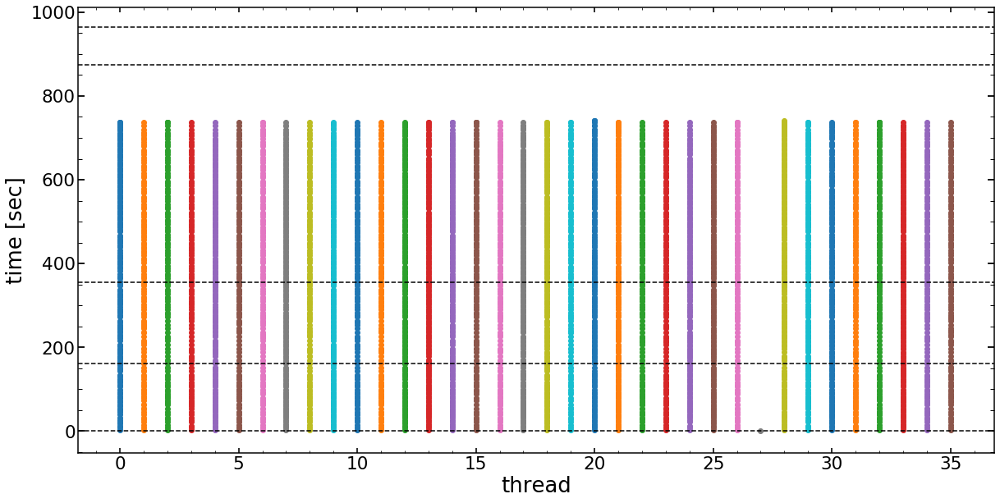

In [410]:
starting_threads=np.unique(array_of_starting[:,3])
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_head_node/chainJul0620_Single_P_21448617HgAr_list_of_times.npy')
min_time=np.min(array_of_starting[:,2].astype(float))

plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_starting_single_thread[:,2]))*i,array_of_starting_single_thread[:,2].astype(float)-min_time)
    
plt.axhline(0,color='black',ls='--')   
plt.axhline(list_of_times[0],color='black',ls='--')
plt.axhline(list_of_times[1],color='black',ls='--')
plt.axhline(list_of_times[2],color='black',ls='--')
plt.axhline(list_of_times[3],color='black',ls='--')

plt.xlabel('thread')
plt.ylabel('time [sec]')

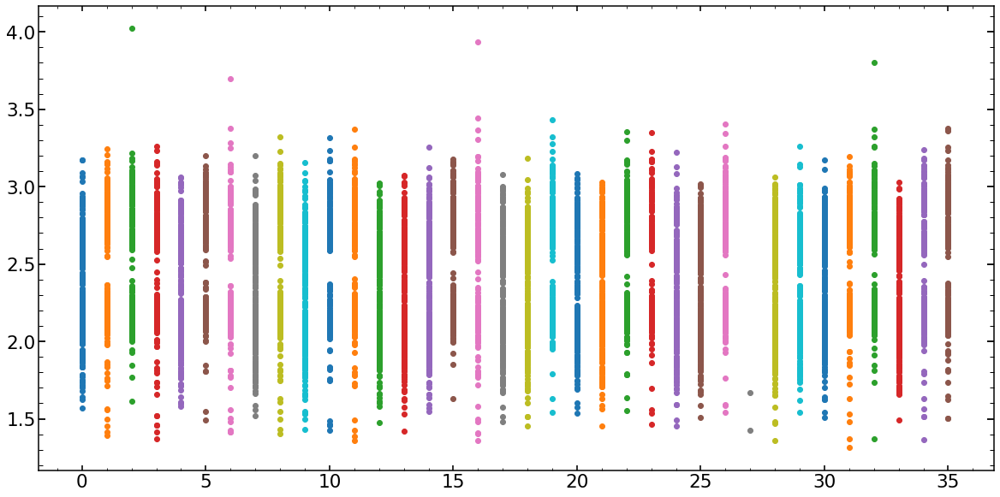

In [411]:
plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_lnlike_time_single_thread=array_of_lnlike_time[array_of_lnlike_time[:,1]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_lnlike_time_single_thread[:,1]))*i,array_of_lnlike_time_single_thread[:,2].astype(float))

In [412]:
np.mean(array_of_lnlike_time[:,2].astype(float))

2.380178863019956

In [413]:
np.mean(array_of_lnlike_time[0:2][:,2].astype(float))

1.5458108186721802

In [276]:
array_of_lnlike_time[array_of_lnlike_time[:,2].astype(float)<1.9]

array([['387', '47809532305024', '1.8347551822662354'],
       ['43566', '47979605724800', '1.8853819370269775'],
       ['280430', '46996539276928', '1.8682501316070557'],
       ['323992', '47933527551616', '1.8778705596923828'],
       ['324861', '47538992647808', '1.8888463973999023'],
       ['390242', '47809874255488', '1.8805909156799316'],
       ['474063', '47809874255488', '1.8849825859069824'],
       ['477744', '47830341709440', '1.896711826324463'],
       ['645796', '47088242085504', '1.884765386581421'],
       ['728553', '47993052282496', '1.8585939407348633'],
       ['767610', '47661932899968', '1.8852381706237793'],
       ['769797', '47175628492416', '1.8705298900604248'],
       ['807204', '47453948739200', '1.8466176986694336'],
       ['807856', '47661932899968', '1.8715338706970215'],
       ['847672', '47661932899968', '1.8187134265899658'],
       ['926028', '47323521920640', '1.869563341140747'],
       ['1085288', '47453948739200', '1.8432025909423828'],
   

In [278]:
array_of_lnlike_time[array_of_lnlike_time[:,2].astype(float)>4.0]

array([['31582', '47042293108352', '4.088223934173584'],
       ['31975', '47088242085504', '4.14270806312561'],
       ['430234', '47407953784448', '4.09890079498291'],
       ['504259', '47407953784448', '4.007283449172974'],
       ['555139', '47037413047936', '4.1618287563323975'],
       ['555747', '47323521920640', '4.072341680526733'],
       ['1333738', '47661932899968', '4.01326322555542'],
       ['1412657', '47323521920640', '4.193120718002319'],
       ['1412758', '47400762736256', '4.258347988128662'],
       ['1412896', '47037413047936', '4.247459888458252'],
       ['1413037', '47993052282496', '4.293853282928467'],
       ['1413178', '47088242085504', '4.395679950714111'],
       ['1413267', '47521584475776', '4.21774697303772'],
       ['1415534', '47661932899968', '4.35486912727356']], dtype='<U18')

In [ ]:
lines[]

### 1 node, 36 threads 

In [515]:
lines=[]
filepath = '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_1_node_36_threads/slurm-4982997.out'
with open(filepath) as fp:
   line = fp.readline()
   cnt = 0
   while line:
       lines.append("Line {}: {}".format(cnt, line.strip()))
       line = fp.readline()
       cnt += 1
        
        
list_of_threading=[]


list_of_lines_starting=[]
list_of_lines_ending=[]
list_of_lines_FFT=[]
list_of_lines_lnlike_time=[]
list_of_lines_apodize=[]
list_of_lines_get_Pupil=[]
list_of_lines_Psf_position=[]
list_of_lines_postprocessing_Pupil=[]
list_of_lines_allparameters=[]

list_of_lines_allparameters_lines_index=[]

for i in tqdm(range(len(lines))):
    try:
        index_threading=lines[i].index('threading')
        #print([i,lines[i][index_threading-10:]])
        list_of_threading.append([i,lines[i][index_threading-10:]])
    except:
        pass 
    
    try:    
        index_starting=lines[i].index('Starting LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_starting:]])
        lines_starting=lines[i]
        list_of_lines_starting.append(lines_starting)
        
        #list_of_starting.append([i,lines[i][index_starting+51:index_starting+71].replace(" ", "") ,lines[i][index_starting+74:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    try:            
        index_ending=lines[i].index('Ending LN_PFS_multi_same_spot for parameters-hash')
        print([i,lines[i][index_ending:]])
        list_of_lines_ending.append(lines[i])
        
        
        #list_of_ending.append([i,lines[i][index_starting+50:index_starting+70].replace(" ", "") ,lines[i][index_ending+72:].replace("t", "").replace(" ", "") ])
    except:
        pass 
    
    
    try:
        index_time_for_lnlike=lines[i].index('Time for lnlike_Neven')
        print([i,lines[i][index_time_for_lnlike+40:index_time_for_lnlike+55],lines[i][index_time_for_lnlike+60:index_time_for_lnlike+70]])
        list_of_lines_lnlike_time.append(lines[i])   
        

    except:
        pass
    

    try:
        index_time_for_get_Pupil=lines[i].index('Time for _get_Pupil function is')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_get_Pupil+31:index_time_for_get_Pupil+41]])
        list_of_lines_get_Pupil.append(lines[i][index_time_for_get_Pupil+31:index_time_for_get_Pupil+41])   
    except:
        pass

    try:
        index_time_for_postprocessing_Pupil=lines[i].index('Time for postprocessing pupil after _get_Pupil')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_postprocessing_Pupil+46:index_time_for_postprocessing_Pupil+53]])
        list_of_lines_postprocessing_Pupil.append(lines[i][index_time_for_postprocessing_Pupil+46:index_time_for_postprocessing_Pupil+53])   
    except:
        pass    

    
    
    try:
        index_time_for_apodize=lines[i].index('Time to apodize the pupil:')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_apodize+26:index_time_for_apodize+38]])
        list_of_lines_apodize.append(lines[i][index_time_for_apodize+26:index_time_for_apodize+38])   
    except:
        pass

    try:
        index_time_for_FFT=lines[i].index('Time for FFT is ')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_FFT+16:index_time_for_FFT+26]])
        list_of_lines_FFT.append(lines[i][index_time_for_FFT+16:index_time_for_FFT+26])   
    except:
        pass    
    
 
    
    try:
        index_time_for_Psf_position=lines[i].index('Time for single_Psf_position protocol is')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_Psf_position+40:index_time_for_Psf_position+48]])
        list_of_lines_Psf_position.append(lines[i][index_time_for_Psf_position+40:index_time_for_Psf_position+48])   
    except:
        pass    
    
    try:
        index_time_for_allparameters=lines[i].index('allparameters')
        index_double_dots=lines[i].index(': ')
        print([i,lines[i]])
        print([i,lines[i][index_time_for_allparameters+16:]])
        list_of_lines_allparameters_lines_index.append(lines[i])  
        
        list_of_lines_allparameters.append(lines[i][index_time_for_allparameters+16:])   
        list_of_lines_allparameters.append(lines[i+1][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+2][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+3][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+4][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+5][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+6][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+7][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+8][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+9][index_double_dots+1:])   
        list_of_lines_allparameters.append(lines[i+10][index_double_dots+1:index_double_dots+7])   
    except:
        pass

  0%|                                | 6124/1615317 [00:00<00:26, 61239.47it/s]

[82, 'Starting LN_PFS_multi_same_spot for parameters-hash -5050491048975583527 at 1594356927.1796288 in thread 47842359348864']
[105, 'Line 105: allparameters [   30.72443239    -0.30241877    -0.89022102     0.53940442']
[105, '  30.72443239    -0.30241877    -0.89022102     0.53940442']
[140, 'Line 140: Time for _get_Pupil function is 0.33884620666503906']
[140, ' 0.3388462']
[148, 'Line 148: Time to apodize the pupil: 0.06418204307556152']
[148, ' 0.064182043']
[150, 'Line 150: Time for postprocessing pupil after _get_Pupil 0.17787671089172363']
[150, ' 0.1778']
[161, 'Line 161: Time for FFT is 1.0308842658996582']
[161, '1.03088426']
[221, 'Line 221: Time for single_Psf_position protocol is 0.07473516464233398']
[221, ' 0.07473']
[231, ' 47842359348864', '2.34432005']
[255, 'Line 255: allparameters [  -30.47849255     0.18555534    -0.42243538     0.61646358']
[255, ' -30.47849255     0.18555534    -0.42243538     0.61646358']
[282, 'Line 282: Time for _get_Pupil function is 0.0022

  1%|▍                              | 21583/1615317 [00:00<00:23, 67296.32it/s]

[10013, '1.38887643']
[10144, 'Line 10144: Time for single_Psf_position protocol is 0.2522237300872803']
[10144, ' 0.25222']
[10154, ' 47378269904512', '3.25435495']
[10157, 'Ending LN_PFS_multi_same_spot for parameters-hash 7330834313899686859 at 1594356939.3272781 in thread 47378269904512']
[10187, 'Line 10187: Time for single_Psf_position protocol is 0.18273234367370605']
[10187, ' 0.18273']
[10197, ' 47847956057728', '4.31085968']
[10221, 'Line 10221: allparameters [  -34.06372241     0.4677511     -0.58507802     1.29871208']
[10221, ' -34.06372241     0.4677511     -0.58507802     1.29871208']
[10248, 'Line 10248: Time for _get_Pupil function is 0.003679037094116211']
[10248, ' 0.0036790']
[10256, 'Line 10256: Time to apodize the pupil: 0.1128840446472168']
[10256, ' 0.112884044']
[10258, 'Line 10258: Time for postprocessing pupil after _get_Pupil 0.43778014183044434']
[10258, ' 0.4377']
[10269, 'Line 10269: Time for FFT is 1.369950532913208']
[10269, '1.36995053']
[10347, 'Line 

  3%|▊                              | 43849/1615317 [00:00<00:22, 69341.71it/s]


[26607, 'Line 26607: Time for _get_Pupil function is 0.0034046173095703125']
[26607, ' 0.0034046']
[26615, 'Line 26615: Time to apodize the pupil: 0.08262252807617188']
[26615, ' 0.082622528']
[26644, 'Line 26644: Time for single_Psf_position protocol is 0.1365187168121338']
[26644, ' 0.13651']
[26654, ' 47422259576448', '2.77302742']
[26657, 'Ending LN_PFS_multi_same_spot for parameters-hash 2076889063976216699 at 1594356945.4820251 in thread 47422259576448']
[26675, 'Starting LN_PFS_multi_same_spot for parameters-hash 2076889063976216699 at 1594356945.489118 in thread 47422259576448']
[26698, 'Line 26698: allparameters [    45.37513416     -0.5019918      -1.3117478      -0.53406141']
[26698, '   45.37513416     -0.5019918      -1.3117478      -0.53406141']
[26733, 'Line 26733: Time for _get_Pupil function is 0.48722052574157715']
[26733, ' 0.4872205']
[26741, 'Line 26741: Time to apodize the pupil: 0.0981912612915039']
[26741, ' 0.098191261']
[26743, 'Line 26743: Time for postproce

  4%|█▏                             | 59754/1615317 [00:00<00:21, 73679.75it/s]


[44133, 'Line 44133: Time for FFT is 1.4789366722106934']
[44133, '1.47893667']
[44193, 'Line 44193: Time for single_Psf_position protocol is 0.12000918388366699']
[44193, ' 0.12000']
[44203, ' 47079073197696', '3.83015346']
[44227, 'Line 44227: allparameters [  -31.18931518    -0.00803412    -0.14282627     1.2014557']
[44227, ' -31.18931518    -0.00803412    -0.14282627     1.2014557']
[44256, 'Line 44256: allparameters [   32.41599779    -0.19335407    -1.0449604      0.1738797']
[44256, '  32.41599779    -0.19335407    -1.0449604      0.1738797']
[44291, 'Line 44291: Time for _get_Pupil function is 0.6284189224243164']
[44291, ' 0.6284189']
[44299, 'Line 44299: Time to apodize the pupil: 0.08751344680786133']
[44299, ' 0.087513446']
[44301, 'Line 44301: Time for postprocessing pupil after _get_Pupil 0.34700584411621094']
[44301, ' 0.3470']
[44312, 'Line 44312: Time for FFT is 1.5197370052337646']
[44312, '1.51973700']
[44372, 'Line 44372: Time for single_Psf_position protocol is 0

  5%|█▍                             | 74663/1615317 [00:01<00:20, 74182.32it/s]


[60153, 'Line 60153: Time to apodize the pupil: 0.09118962287902832']
[60153, ' 0.091189622']
[60155, 'Line 60155: Time for postprocessing pupil after _get_Pupil 0.3009033203125']
[60155, ' 0.3009']
[60166, 'Line 60166: Time for FFT is 1.0054919719696045']
[60166, '1.00549197']
[60198, 'Line 60198: Time to apodize the pupil: 0.09641814231872559']
[60198, ' 0.096418142']
[60200, 'Line 60200: Time for postprocessing pupil after _get_Pupil 0.28365468978881836']
[60200, ' 0.2836']
[60211, 'Line 60211: Time for FFT is 1.0899648666381836']
[60211, '1.08996486']
[60271, 'Line 60271: Time for single_Psf_position protocol is 0.0834503173828125']
[60271, ' 0.08345']
[60281, ' 47236627558016', '2.59292149']
[60284, 'Ending LN_PFS_multi_same_spot for parameters-hash 1329684910551478724 at 1594356969.3079805 in thread 47236627558016']
[60302, 'Starting LN_PFS_multi_same_spot for parameters-hash 220070346356439997 at 1594356969.3149607 in thread 47236627558016']
[60325, 'Line 60325: allparameters [

  6%|█▋                             | 91145/1615317 [00:01<00:19, 77850.95it/s]


[75550, ' 0.5806920']
[75558, 'Line 75558: Time to apodize the pupil: 0.11646580696105957']
[75558, ' 0.116465806']
[75560, 'Line 75560: Time for postprocessing pupil after _get_Pupil 0.3955729007720947']
[75560, ' 0.3955']
[75584, 'Line 75584: Time for single_Psf_position protocol is 0.1423938274383545']
[75584, ' 0.14239']
[75594, ' 47780031131264', '3.54194569']
[75618, 'Line 75618: allparameters [  -31.12217916    -0.01892462     0.33095184     1.15284702']
[75618, ' -31.12217916    -0.01892462     0.33095184     1.15284702']
[75645, 'Line 75645: Time for _get_Pupil function is 0.0035254955291748047']
[75645, ' 0.0035254']
[75653, 'Line 75653: Time to apodize the pupil: 0.09882116317749023']
[75653, ' 0.098821163']
[75655, 'Line 75655: Time for postprocessing pupil after _get_Pupil 0.32359933853149414']
[75655, ' 0.3235']
[75666, 'Line 75666: Time for FFT is 1.2320516109466553']
[75666, '1.23205161']
[75726, 'Line 75726: Time for single_Psf_position protocol is 0.09233450889587402

  7%|█▉                            | 106673/1615317 [00:01<00:19, 77671.46it/s]

[93680, 'Starting LN_PFS_multi_same_spot for parameters-hash -5092959149093515064 at 1594356989.016503 in thread 46971197234816']
[93712, 'Line 93712: Time for single_Psf_position protocol is 0.21553897857666016']
[93712, ' 0.21553']
[93722, ' 47422259576448', '4.35699820']
[93746, 'Line 93746: allparameters [  -27.29296044     0.28643289    -0.45018509     0.99664044']
[93746, ' -27.29296044     0.28643289    -0.45018509     0.99664044']
[93773, 'Line 93773: Time for _get_Pupil function is 0.003908634185791016']
[93773, ' 0.0039086']
[93781, 'Line 93781: Time to apodize the pupil: 0.11597824096679688']
[93781, ' 0.115978240']
[93783, 'Line 93783: Time for postprocessing pupil after _get_Pupil 0.3740546703338623']
[93783, ' 0.3740']
[93794, 'Line 93794: Time for FFT is 1.2083439826965332']
[93794, '1.20834398']
[93864, 'Line 93864: Time for single_Psf_position protocol is 0.2676737308502197']
[93864, ' 0.26767']
[93874, ' 47494817312384', '4.47044897']
[93898, 'Line 93898: allparameter

  8%|██▎                           | 122678/1615317 [00:01<00:18, 78896.78it/s]


[109978, 'Line 109978: allparameters [   30.56132574    -0.5325685     -1.33783142     0.5492488']
[109978, '  30.56132574    -0.5325685     -1.33783142     0.5492488']
[110013, 'Line 110013: Time for _get_Pupil function is 0.5463540554046631']
[110013, ' 0.5463540']
[110021, 'Line 110021: Time to apodize the pupil: 0.11919283866882324']
[110021, ' 0.119192838']
[110023, 'Line 110023: Time for postprocessing pupil after _get_Pupil 0.40645265579223633']
[110023, ' 0.4064']
[110034, 'Line 110034: Time for FFT is 1.0600364208221436']
[110034, '1.06003642']
[110106, 'Starting LN_PFS_multi_same_spot for parameters-hash -5737855142447496180 at 1594356994.7247705 in thread 47394659602048']
[110129, 'Line 110129: allparameters [   34.82890596    -0.58936988    -0.04649102     0.71722343']
[110129, '  34.82890596    -0.58936988    -0.04649102     0.71722343']
[110164, 'Line 110164: Time for _get_Pupil function is 0.5543591976165771']
[110164, ' 0.5543591']
[110172, 'Line 110172: Time to apodiz

  9%|██▌                           | 139654/1615317 [00:01<00:18, 78329.59it/s]


[128527, ' 0.113621950']
[128529, 'Line 128529: Time for postprocessing pupil after _get_Pupil 0.43238043785095215']
[128529, ' 0.4323']
[128540, 'Line 128540: Time for FFT is 1.3953778743743896']
[128540, '1.39537787']
[128600, 'Line 128600: allparameters [  -29.0258187     -0.67675832    -0.27050378     0.12178556']
[128600, ' -29.0258187     -0.67675832    -0.27050378     0.12178556']
[128627, 'Line 128627: Time for _get_Pupil function is 0.004016399383544922']
[128627, ' 0.0040163']
[128635, 'Line 128635: Time to apodize the pupil: 0.1227421760559082']
[128635, ' 0.122742176']
[128637, 'Line 128637: Time for postprocessing pupil after _get_Pupil 0.4585552215576172']
[128637, ' 0.4585']
[128648, 'Line 128648: Time for FFT is 1.3314130306243896']
[128648, '1.33141303']
[128733, 'Line 128733: Time for single_Psf_position protocol is 0.11447334289550781']
[128733, ' 0.11447']
[128743, ' 47202540170880', '3.26284718']
[128746, 'Ending LN_PFS_multi_same_spot for parameters-hash 46571451

 10%|██▉                           | 156052/1615317 [00:02<00:19, 76284.21it/s]


[145472, 'Line 145472: allparameters [  -25.00104286     0.07924721    -1.10287736     0.17401984']
[145472, ' -25.00104286     0.07924721    -1.10287736     0.17401984']
[145499, 'Line 145499: Time for _get_Pupil function is 0.0020453929901123047']
[145499, ' 0.0020453']
[145507, 'Line 145507: Time to apodize the pupil: 0.07762789726257324']
[145507, ' 0.077627897']
[145509, 'Line 145509: Time for postprocessing pupil after _get_Pupil 0.28979063034057617']
[145509, ' 0.2897']
[145520, 'Line 145520: Time for FFT is 1.0583717823028564']
[145520, '1.05837178']
[145626, 'Line 145626: Time for single_Psf_position protocol is 0.1588144302368164']
[145626, ' 0.15881']
[145636, ' 47079073197696', '3.80354881']
[145660, 'Line 145660: allparameters [  -27.07656599     0.2555784     -0.85107804    -0.05399032']
[145660, ' -27.07656599     0.2555784     -0.85107804    -0.05399032']
[145687, 'Line 145687: Time for _get_Pupil function is 0.0060710906982421875']
[145687, ' 0.0060710']
[145695, 'Lin

 11%|███▎                          | 179951/1615317 [00:02<00:18, 78320.93it/s]

[161497, 'Line 161497: allparameters [  -29.12553217    -0.328241      -0.31875559     0.61257486']
[161497, ' -29.12553217    -0.328241      -0.31875559     0.61257486']
[161524, 'Line 161524: Time for _get_Pupil function is 0.003030061721801758']
[161524, ' 0.0030300']
[161532, 'Line 161532: Time to apodize the pupil: 0.08621764183044434']
[161532, ' 0.086217641']
[161534, 'Line 161534: Time for postprocessing pupil after _get_Pupil 0.3143656253814697']
[161534, ' 0.3143']
[161545, 'Line 161545: Time for FFT is 2.0047731399536133']
[161545, '2.00477313']
[161592, 'Line 161592: Time for _get_Pupil function is 0.005378246307373047']
[161592, ' 0.0053782']
[161600, 'Line 161600: Time to apodize the pupil: 0.11826682090759277']
[161600, ' 0.118266820']
[161602, 'Line 161602: Time for postprocessing pupil after _get_Pupil 0.3875770568847656']
[161602, ' 0.3875']
[161613, 'Line 161613: Time for FFT is 1.0621068477630615']
[161613, '1.06210684']
[161731, 'Line 161731: allparameters [   35.5

 12%|███▍                          | 187819/1615317 [00:02<00:18, 76814.91it/s]


[180029, 'Line 180029: Time for _get_Pupil function is 0.5868501663208008']
[180029, ' 0.5868501']
[180037, 'Line 180037: Time to apodize the pupil: 0.11070084571838379']
[180037, ' 0.110700845']
[180039, 'Line 180039: Time for postprocessing pupil after _get_Pupil 0.4457230567932129']
[180039, ' 0.4457']
[180050, 'Line 180050: Time for FFT is 1.1761078834533691']
[180050, '1.17610788']
[180073, 'Ending LN_PFS_multi_same_spot for parameters-hash -5147061367773300611 at 1594357039.061299 in thread 47236627558016']
[180091, 'Starting LN_PFS_multi_same_spot for parameters-hash -5147061367773300611 at 1594357039.07001 in thread 47236627558016']
[180114, 'Line 180114: allparameters [   35.28832253    -0.99484298    -0.83674521     0.56261246']
[180114, '  35.28832253    -0.99484298    -0.83674521     0.56261246']
[180149, 'Line 180149: Time for _get_Pupil function is 0.5420947074890137']
[180149, ' 0.5420947']
[180157, 'Line 180157: Time to apodize the pupil: 0.1211090087890625']
[180157, 

 13%|███▊                          | 203862/1615317 [00:02<00:18, 77303.49it/s]


[194702, ' 0.4100644']
[194710, 'Line 194710: Time to apodize the pupil: 0.08240556716918945']
[194710, ' 0.082405567']
[194712, 'Line 194712: Time for postprocessing pupil after _get_Pupil 0.3133268356323242']
[194712, ' 0.3133']
[194723, 'Line 194723: Time for FFT is 1.0960707664489746']
[194723, '1.09607076']
[194797, 'Line 194797: Time for single_Psf_position protocol is 0.1306467056274414']
[194797, ' 0.13064']
[194807, ' 47847956057728', '3.12929987']
[194831, 'Line 194831: allparameters [  -30.32873773     0.02680852    -0.57643116     0.82326168']
[194831, ' -30.32873773     0.02680852    -0.57643116     0.82326168']
[194843, 'Starting LN_PFS_multi_same_spot for parameters-hash -2054741709315514402 at 1594357046.350517 in thread 47212441104000']
[194866, 'Line 194866: allparameters [   30.16246613    -0.169146      -1.01331111     0.57234003']
[194866, '  30.16246613    -0.169146      -1.01331111     0.57234003']
[194901, 'Line 194901: Time for _get_Pupil function is 0.4278135

 14%|████                          | 220017/1615317 [00:02<00:17, 78188.72it/s]

[212066, ' 0.3979']
[212077, 'Line 212077: Time for FFT is 1.3560903072357178']
[212077, '1.35609030']
[212117, 'Line 212117: allparameters [  -38.29942552     0.54828307     0.04674552     0.86398477']
[212117, ' -38.29942552     0.54828307     0.04674552     0.86398477']
[212144, 'Line 212144: Time for _get_Pupil function is 0.003260374069213867']
[212144, ' 0.0032603']
[212152, 'Line 212152: Time to apodize the pupil: 0.11498761177062988']
[212152, ' 0.114987611']
[212154, 'Line 212154: Time for postprocessing pupil after _get_Pupil 0.4287741184234619']
[212154, ' 0.4287']
[212165, 'Line 212165: Time for FFT is 1.3342821598052979']
[212165, '1.33428215']
[212239, 'Line 212239: Time for single_Psf_position protocol is 0.15029382705688477']
[212239, ' 0.15029']
[212268, 'Line 212268: Time for single_Psf_position protocol is 0.2873561382293701']
[212268, ' 0.28735']
[212278, ' 46998298164864', '4.56303906']
[212302, 'Line 212302: allparameters [  -29.35667181     0.14552298    -0.51305

 15%|████▍                         | 235643/1615317 [00:03<00:17, 76870.41it/s]


[227355, 'Line 227355: Time for _get_Pupil function is 0.49021387100219727']
[227355, ' 0.4902138']
[227363, 'Line 227363: Time to apodize the pupil: 0.12187051773071289']
[227363, ' 0.121870517']
[227365, 'Line 227365: Time for postprocessing pupil after _get_Pupil 0.42737364768981934']
[227365, ' 0.4273']
[227388, 'Starting LN_PFS_multi_same_spot for parameters-hash 8996212100659287892 at 1594357065.5371106 in thread 47457445158528']
[227411, 'Line 227411: allparameters [   31.64906705    -0.04198618    -0.89314644     0.10301692']
[227411, '  31.64906705    -0.04198618    -0.89314644     0.10301692']
[227446, 'Line 227446: Time for _get_Pupil function is 0.373629093170166']
[227446, ' 0.3736290']
[227454, 'Line 227454: Time to apodize the pupil: 0.08712649345397949']
[227454, ' 0.087126493']
[227456, 'Line 227456: Time for postprocessing pupil after _get_Pupil 0.3177914619445801']
[227456, ' 0.3177']
[227467, 'Line 227467: Time for FFT is 1.1018600463867188']
[227467, '1.10186004']

 16%|████▋                         | 251658/1615317 [00:03<00:17, 77133.01it/s]

[243047, ' 0.6536147']
[243100, 'Line 243100: Time for single_Psf_position protocol is 0.2489628791809082']
[243100, ' 0.24896']
[243110, ' 47671948000896', '2.97449970']
[243113, 'Ending LN_PFS_multi_same_spot for parameters-hash 6700836306157461060 at 1594357074.6867409 in thread 47671948000896']
[243131, 'Starting LN_PFS_multi_same_spot for parameters-hash -6329242870302839890 at 1594357077.6295898 in thread 47671948000896']
[243154, 'Line 243154: allparameters [   30.75046496    -0.33559217    -1.10849662    -1.91948294']
[243154, '  30.75046496    -0.33559217    -1.10849662    -1.91948294']
[243189, 'Line 243189: Time for _get_Pupil function is 0.747098445892334']
[243189, ' 0.7470984']
[243243, 'Line 243243: Time for single_Psf_position protocol is 0.12652802467346191']
[243243, ' 0.12652']
[243253, ' 47212441104000', '2.76878213']
[243256, 'Ending LN_PFS_multi_same_spot for parameters-hash -3435946875827406271 at 1594357074.539228 in thread 47212441104000']
[243274, 'Starting LN

 17%|████▉                         | 267105/1615317 [00:03<00:17, 76383.70it/s]


[258403, 'Line 258403: Time for _get_Pupil function is 0.6103568077087402']
[258403, ' 0.6103568']
[258411, 'Line 258411: Time to apodize the pupil: 0.13193202018737793']
[258411, ' 0.131932020']
[258413, 'Line 258413: Time for postprocessing pupil after _get_Pupil 0.46312546730041504']
[258413, ' 0.4631']
[258424, 'Line 258424: Time for FFT is 1.0567684173583984']
[258424, '1.05676841']
[258478, 'Line 258478: Time for _get_Pupil function is 0.6425504684448242']
[258478, ' 0.6425504']
[258486, 'Line 258486: Time to apodize the pupil: 0.14435267448425293']
[258486, ' 0.144352674']
[258488, 'Line 258488: Time for postprocessing pupil after _get_Pupil 0.472353458404541']
[258488, ' 0.4723']
[258499, 'Line 258499: Time for FFT is 1.0996980667114258']
[258499, '1.09969806']
[258559, 'Line 258559: Time for single_Psf_position protocol is 0.0800926685333252']
[258559, ' 0.08009']
[258569, ' 47671948000896', '3.60604166']
[258593, 'Line 258593: allparameters [  -28.98051653    -1.09787045    

 18%|█████▍                        | 290004/1615317 [00:03<00:17, 75577.08it/s]


[274480, ' 0.16062']
[274490, ' 47494817312384', '3.51274394']
[274514, 'Line 274514: allparameters [  -30.35082926    -0.06630636    -0.68183941     1.15905765']
[274514, ' -30.35082926    -0.06630636    -0.68183941     1.15905765']
[274541, 'Line 274541: Time for _get_Pupil function is 0.004382610321044922']
[274541, ' 0.0043826']
[274549, 'Line 274549: Time to apodize the pupil: 0.11434125900268555']
[274549, ' 0.114341259']
[274551, 'Line 274551: Time for postprocessing pupil after _get_Pupil 0.39934420585632324']
[274551, ' 0.3993']
[274586, 'Line 274586: Time for single_Psf_position protocol is 0.2503039836883545']
[274586, ' 0.25030']
[274596, ' 47939360464512', '3.24286460']
[274620, 'Line 274620: allparameters [  -30.36725862     1.44707787    -0.27166325     0.40765438']
[274620, ' -30.36725862     1.44707787    -0.27166325     0.40765438']
[274647, 'Line 274647: Time for _get_Pupil function is 0.0035469532012939453']
[274647, ' 0.0035469']
[274655, 'Line 274655: Time to apo

 18%|█████▌                        | 297567/1615317 [00:03<00:17, 73291.91it/s]

[290253, 'Line 290253: Time for postprocessing pupil after _get_Pupil 0.36577725410461426']
[290253, ' 0.3657']
[290264, 'Line 290264: Time for FFT is 1.7028605937957764']
[290264, '1.70286059']
[290324, 'Line 290324: Time for single_Psf_position protocol is 0.09142899513244629']
[290324, ' 0.09142']
[290334, ' 47671948000896', '4.24810409']
[290358, 'Line 290358: allparameters [  -32.78265416     0.40102056    -0.33127729     0.51855806']
[290358, ' -32.78265416     0.40102056    -0.33127729     0.51855806']
[290385, 'Line 290385: Time for _get_Pupil function is 0.007748842239379883']
[290385, ' 0.0077488']
[290393, 'Line 290393: Time to apodize the pupil: 0.10959124565124512']
[290393, ' 0.109591245']
[290395, 'Line 290395: Time for postprocessing pupil after _get_Pupil 0.3826770782470703']
[290395, ' 0.3826']
[290401, 'Line 290401: Time for FFT is 1.7315998077392578']
[290401, '1.73159980']
[290500, 'Line 290500: Time for single_Psf_position protocol is 0.29411983489990234']
[290500

 19%|█████▊                        | 312173/1615317 [00:04<00:18, 71518.50it/s]

[302600, 'Line 302600: Time for postprocessing pupil after _get_Pupil 0.4140002727508545']
[302600, ' 0.4140']
[302611, 'Line 302611: Time for FFT is 0.9817578792572021']
[302611, '0.98175787']
[302678, 'Line 302678: Time for single_Psf_position protocol is 0.21040129661560059']
[302678, ' 0.21040']
[302688, ' 46971197234816', '3.73680686']
[302712, 'Line 302712: allparameters [  -34.28263109     0.35563676    -0.9598292      0.642886']
[302712, ' -34.28263109     0.35563676    -0.9598292      0.642886']
[302739, 'Line 302739: Time for _get_Pupil function is 0.005177497863769531']
[302739, ' 0.0051774']
[302747, 'Line 302747: Time to apodize the pupil: 0.13245129585266113']
[302747, ' 0.132451295']
[302749, 'Line 302749: Time for postprocessing pupil after _get_Pupil 0.5070767402648926']
[302749, ' 0.5070']
[302757, 'Line 302757: Time to apodize the pupil: 0.07498478889465332']
[302757, ' 0.074984788']
[302759, 'Line 302759: Time for postprocessing pupil after _get_Pupil 0.258862257003

 21%|██████▏                       | 334949/1615317 [00:04<00:17, 74070.35it/s]


[318994, ' 0.093882083']
[318996, 'Line 318996: Time for postprocessing pupil after _get_Pupil 0.30046510696411133']
[318996, ' 0.3004']
[319007, 'Line 319007: Time for FFT is 1.0613250732421875']
[319007, '1.06132507']
[319071, 'Line 319071: Time for single_Psf_position protocol is 0.11205863952636719']
[319071, ' 0.11205']
[319081, 'Line 319081: allparameters [  -24.58588449    -0.48116618     0.14535123     0.02485589']
[319081, ' -24.58588449    -0.48116618     0.14535123     0.02485589']
[319108, 'Line 319108: Time for _get_Pupil function is 0.005120277404785156']
[319108, ' 0.0051202']
[319116, 'Line 319116: Time to apodize the pupil: 0.1304183006286621']
[319116, ' 0.130418300']
[319118, 'Line 319118: Time for postprocessing pupil after _get_Pupil 0.4814114570617676']
[319118, ' 0.4814']
[319129, 'Line 319129: Time for FFT is 0.9779434204101562']
[319129, '0.97794342']
[319214, 'Line 319214: Time for _get_Pupil function is 0.004935741424560547']
[319214, ' 0.0049357']
[319222, 

 22%|██████▌                       | 350835/1615317 [00:04<00:16, 76071.81it/s]

[335030, '1.42591762']
[335106, 'Line 335106: Time for _get_Pupil function is 0.0040814876556396484']
[335106, ' 0.0040814']
[335114, 'Line 335114: Time to apodize the pupil: 0.11436319351196289']
[335114, ' 0.114363193']
[335116, 'Line 335116: Time for postprocessing pupil after _get_Pupil 0.4485344886779785']
[335116, ' 0.4485']
[335127, 'Line 335127: Time for FFT is 1.4552738666534424']
[335127, '1.45527386']
[335259, 'Line 335259: Time for single_Psf_position protocol is 0.2420051097869873']
[335259, ' 0.24200']
[335269, ' 47350714822272', '3.05420851']
[335272, 'Ending LN_PFS_multi_same_spot for parameters-hash 2341103973675116637 at 1594357134.0005822 in thread 47350714822272']
[335273, 'Starting LN_PFS_multi_same_spot for parameters-hash 2341103973675116637 at 1594357134.0075798 in thread 47350714822272']
[335296, 'Line 335296: allparameters [   34.21462563    -0.20722313    -0.01051493     0.97109474']
[335296, '  34.21462563    -0.20722313    -0.01051493     0.97109474']
[3353

 23%|██████▊                       | 366336/1615317 [00:04<00:16, 74621.06it/s]


[351324, 'Line 351324: Time for single_Psf_position protocol is 0.15106606483459473']
[351324, ' 0.15106']
[351334, ' 47079073197696', '3.19316148']
[351337, 'Ending LN_PFS_multi_same_spot for parameters-hash 7932993274656579191 at 1594357147.044745 in thread 47079073197696']
[351338, 'Starting LN_PFS_multi_same_spot for parameters-hash 7932993274656579191 at 1594357147.0507963 in thread 47079073197696']
[351361, 'Line 351361: allparameters [    20.61098629      0.25438281     -2.23346154      0.16652065']
[351361, '   20.61098629      0.25438281     -2.23346154      0.16652065']
[351373, 'Starting LN_PFS_multi_same_spot for parameters-hash -4963518641846515529 at 1594357147.0605142 in thread 47079073197696']
[351396, 'Line 351396: allparameters [    27.07745889     -0.27867679     -0.73454264      0.9300338']
[351396, '   27.07745889     -0.27867679     -0.73454264      0.9300338']
[351431, 'Line 351431: Time for _get_Pupil function is 0.5300014019012451']
[351431, ' 0.5300014']
[351

 24%|███████                       | 381061/1615317 [00:05<00:17, 69287.01it/s]


[366778, 'Line 366778: Time for FFT is 1.293492078781128']
[366778, '1.29349207']
[366830, 'Line 366830: Time for single_Psf_position protocol is 0.09715676307678223']
[366830, ' 0.09715']
[366840, ' 47457445158528', '2.72322010']
[366843, 'Ending LN_PFS_multi_same_spot for parameters-hash -3394951640901412793 at 1594357159.587927 in thread 47457445158528']
[366844, 'Starting LN_PFS_multi_same_spot for parameters-hash -3394951640901412793 at 1594357159.594832 in thread 47457445158528']
[366867, 'Line 366867: allparameters [    22.99623194     -0.44919696     -2.69135935      1.8545802']
[366867, '   22.99623194     -0.44919696     -2.69135935      1.8545802']
[366879, 'Starting LN_PFS_multi_same_spot for parameters-hash -5542737757930707886 at 1594357159.5973878 in thread 47457445158528']
[366902, 'Line 366902: allparameters [    6.78327744     0.06158461    -0.08288882     0.56692379']
[366902, '   6.78327744     0.06158461    -0.08288882     0.56692379']
[366914, 'Starting LN_PFS_mu

 24%|███████▎                      | 395248/1615317 [00:05<00:17, 69820.41it/s]

[381859, 'Line 381859: Time for single_Psf_position protocol is 0.17197442054748535']
[381859, ' 0.17197']
[381869, ' 47336209645184', '3.94024205']
[381893, 'Line 381893: allparameters [  -35.44680252     0.18674752    -0.2516724      1.38686306']
[381893, ' -35.44680252     0.18674752    -0.2516724      1.38686306']
[381920, 'Line 381920: Time for _get_Pupil function is 0.0031468868255615234']
[381920, ' 0.0031468']
[381928, 'Line 381928: Time to apodize the pupil: 0.10691022872924805']
[381928, ' 0.106910228']
[381930, 'Line 381930: Time for postprocessing pupil after _get_Pupil 0.4404115676879883']
[381930, ' 0.4404']
[381941, 'Line 381941: Time for FFT is 1.3001911640167236']
[381941, '1.30019116']
[382017, 'Line 382017: allparameters [  -30.09741754    -0.02864713    -0.98183714     0.32976969']
[382017, ' -30.09741754    -0.02864713    -0.98183714     0.32976969']
[382044, 'Line 382044: Time for _get_Pupil function is 0.0035400390625']
[382044, ' 0.0035400']
[382052, 'Line 38205

 25%|███████▋                      | 411100/1615317 [00:05<00:16, 73868.28it/s]


[398109, 'Line 398109: Time for postprocessing pupil after _get_Pupil 0.35593223571777344']
[398109, ' 0.3559']
[398120, 'Line 398120: Time for FFT is 1.2028319835662842']
[398120, '1.20283198']
[398194, 'Line 398194: Time for single_Psf_position protocol is 0.1281416416168213']
[398194, ' 0.12814']
[398204, ' 47079073197696', '2.76163649']
[398207, 'Ending LN_PFS_multi_same_spot for parameters-hash -858422961024845303 at 1594357184.5549786 in thread 47079073197696']
[398208, 'Starting LN_PFS_multi_same_spot for parameters-hash -858422961024845303 at 1594357184.5626256 in thread 47079073197696']
[398241, 'Line 398241: Time for single_Psf_position protocol is 0.22181987762451172']
[398241, ' 0.22181']
[398251, ' 47394659602048', '3.89373230']
[398275, 'Line 398275: allparameters [  -33.01475729     0.51461522    -0.53311047     0.83895233']
[398275, ' -33.01475729     0.51461522    -0.53311047     0.83895233']
[398302, 'Line 398302: Time for _get_Pupil function is 0.003589630126953125'

 26%|███████▉                      | 426135/1615317 [00:05<00:17, 68791.01it/s]

[414599, '1.06787276']
[414670, 'Line 414670: Time for single_Psf_position protocol is 0.10016489028930664']
[414670, ' 0.10016']
[414680, ' 47500694032000', '2.67513465']
[414683, 'Ending LN_PFS_multi_same_spot for parameters-hash 1994561766434636709 at 1594357197.3676841 in thread 47500694032000']
[414684, 'Starting LN_PFS_multi_same_spot for parameters-hash 6224461833321474178 at 1594357197.3738842 in thread 47500694032000']
[414726, 'Line 414726: Time for single_Psf_position protocol is 0.1192169189453125']
[414726, ' 0.11921']
[414736, ' 47457445158528', '3.90599989']
[414760, 'Line 414760: allparameters [  -31.25877257    -0.17162087    -0.9455168      0.27125812']
[414760, ' -31.25877257    -0.17162087    -0.9455168      0.27125812']
[414787, 'Line 414787: Time for _get_Pupil function is 0.0034253597259521484']
[414787, ' 0.0034253']
[414795, 'Line 414795: Time to apodize the pupil: 0.1043555736541748']
[414795, ' 0.104355573']
[414797, 'Line 414797: Time for postprocessing pupi

 27%|████████▏                     | 440615/1615317 [00:05<00:17, 67744.24it/s]

[429262, ' 0.4109']
[429273, 'Line 429273: Time for FFT is 1.7919340133666992']
[429273, '1.79193401']
[429330, 'Line 429330: Time for single_Psf_position protocol is 0.09807372093200684']
[429330, ' 0.09807']
[429340, ' 47673033698944', '3.04207110']
[429343, 'Ending LN_PFS_multi_same_spot for parameters-hash 4162330834732014142 at 1594357198.6777833 in thread 47673033698944']
[429344, 'Starting LN_PFS_multi_same_spot for parameters-hash 9032571482922043476 at 1594357204.0753238 in thread 47673033698944']
[429367, 'Line 429367: allparameters [   26.55275951    -0.5021186     -0.34584634    -0.0087758']
[429367, '  26.55275951    -0.5021186     -0.34584634    -0.0087758']
[429402, 'Line 429402: Time for _get_Pupil function is 0.7753114700317383']
[429402, ' 0.7753114']
[429410, 'Line 429410: Time to apodize the pupil: 0.11049914360046387']
[429410, ' 0.110499143']
[429412, 'Line 429412: Time for postprocessing pupil after _get_Pupil 0.4115293025970459']
[429412, ' 0.4115']
[429423, 'Li

 29%|████████▌                     | 463422/1615317 [00:06<00:16, 70815.65it/s]

[447659, 'Line 447659: Time for _get_Pupil function is 0.7505130767822266']
[447659, ' 0.7505130']
[447667, 'Line 447667: Time to apodize the pupil: 0.10280370712280273']
[447667, ' 0.102803707']
[447669, 'Line 447669: Time for postprocessing pupil after _get_Pupil 0.3771798610687256']
[447669, ' 0.3771']
[447680, 'Line 447680: Time for FFT is 1.5597434043884277']
[447680, '1.55974340']
[447748, 'Line 447748: Time to apodize the pupil: 0.1009666919708252']
[447748, ' 0.100966691']
[447750, 'Line 447750: Time for postprocessing pupil after _get_Pupil 0.40184879302978516']
[447750, ' 0.4018']
[447761, 'Line 447761: Time for FFT is 1.66688871383667']
[447761, '1.66688871']
[447835, 'Line 447835: Time for single_Psf_position protocol is 0.17481303215026855']
[447835, ' 0.17481']
[447845, ' 47939360464512', '4.11586046']
[447869, 'Line 447869: allparameters [   -34.20557455      0.09084553     -0.80271606      0.73029637']
[447869, '  -34.20557455      0.09084553     -0.80271606      0.7302

 30%|████████▉                     | 478855/1615317 [00:06<00:15, 73895.86it/s]


[463464, 'Line 463464: allparameters [   32.71441672    -2.17460834    -3.35459912     0.14470523']
[463464, '  32.71441672    -2.17460834    -3.35459912     0.14470523']
[463499, 'Line 463499: Time for _get_Pupil function is 0.6243422031402588']
[463499, ' 0.6243422']
[463507, 'Line 463507: Time to apodize the pupil: 0.11603856086730957']
[463507, ' 0.116038560']
[463509, 'Line 463509: Time for postprocessing pupil after _get_Pupil 0.3520505428314209']
[463509, ' 0.3520']
[463520, 'Line 463520: Time for FFT is 1.541524887084961']
[463520, '1.54152488']
[463577, 'Line 463577: Time for single_Psf_position protocol is 0.14382338523864746']
[463577, ' 0.14382']
[463587, ' 47236627558016', '2.73074054']
[463590, 'Ending LN_PFS_multi_same_spot for parameters-hash -1352325724108020115 at 1594357229.9876113 in thread 47236627558016']
[463591, 'Starting LN_PFS_multi_same_spot for parameters-hash -1352325724108020115 at 1594357230.4817023 in thread 47236627558016']
[463614, 'Line 463614: allpa

 31%|█████████▏                    | 494307/1615317 [00:06<00:14, 75672.04it/s]


[479138, 'Line 479138: Time for FFT is 1.2368781566619873']
[479138, '1.23687815']
[479212, 'Line 479212: Time for single_Psf_position protocol is 0.14620566368103027']
[479212, ' 0.14620']
[479222, ' 47378269904512', '3.12454295']
[479225, 'Ending LN_PFS_multi_same_spot for parameters-hash -8144667499389573528 at 1594357237.9673374 in thread 47378269904512']
[479226, 'Starting LN_PFS_multi_same_spot for parameters-hash -8144667499389573528 at 1594357243.8317556 in thread 47378269904512']
[479249, 'Line 479249: allparameters [    25.67703247     -0.4642768      -1.14935781      1.07237721']
[479249, '   25.67703247     -0.4642768      -1.14935781      1.07237721']
[479261, 'Starting LN_PFS_multi_same_spot for parameters-hash 5818795621808358774 at 1594357243.8346002 in thread 47378269904512']
[479284, 'Line 479284: allparameters [    30.52209472     -0.58577412     -0.57468494      0.53127804']
[479284, '   30.52209472     -0.58577412     -0.57468494      0.53127804']
[479362, 'Line 4

 32%|█████████▍                    | 510078/1615317 [00:06<00:14, 76176.48it/s]


[494928, 'Line 494928: Time for postprocessing pupil after _get_Pupil 0.3640007972717285']
[494928, ' 0.3640']
[494939, 'Line 494939: Time for FFT is 1.0740878582000732']
[494939, '1.07408785']
[494989, 'Line 494989: allparameters [  -32.34528414    -0.65865402    -1.18416932     1.71717078']
[494989, ' -32.34528414    -0.65865402    -1.18416932     1.71717078']
[495016, 'Line 495016: Time for _get_Pupil function is 0.0033767223358154297']
[495016, ' 0.0033767']
[495024, 'Line 495024: Time to apodize the pupil: 0.10711526870727539']
[495024, ' 0.107115268']
[495026, 'Line 495026: Time for postprocessing pupil after _get_Pupil 0.35390472412109375']
[495026, ' 0.3539']
[495037, 'Line 495037: Time for FFT is 1.0647952556610107']
[495037, '1.06479525']
[495111, 'Line 495111: Time for single_Psf_position protocol is 0.10694766044616699']
[495111, ' 0.10694']
[495119, 'Line 495119: Time for single_Psf_position protocol is 0.0985562801361084']
[495119, ' 0.09855']
[495129, ' 47303838301824',

 33%|█████████▊                    | 526139/1615317 [00:07<00:14, 75723.08it/s]


[510455, 'Line 510455: Time for _get_Pupil function is 0.0018150806427001953']
[510455, ' 0.0018150']
[510471, 'Line 510471: Time for single_Psf_position protocol is 0.12380218505859375']
[510471, ' 0.12380']
[510481, ' 47566506155648', '2.82754302']
[510484, 'Ending LN_PFS_multi_same_spot for parameters-hash -3886769176616660498 at 1594357263.57834 in thread 47566506155648']
[510485, 'Starting LN_PFS_multi_same_spot for parameters-hash -3886769176616660498 at 1594357263.5851083 in thread 47566506155648']
[510508, 'Line 510508: allparameters [   32.5738968     -0.46762355    -0.69898417     0.53928735']
[510508, '  32.5738968     -0.46762355    -0.69898417     0.53928735']
[510543, 'Line 510543: Time for _get_Pupil function is 0.522385835647583']
[510543, ' 0.5223858']
[510551, 'Line 510551: Time to apodize the pupil: 0.13214826583862305']
[510551, ' 0.132148265']
[510553, 'Line 510553: Time for postprocessing pupil after _get_Pupil 0.456498384475708']
[510553, ' 0.4564']
[510564, 'Li

 34%|██████████                    | 541964/1615317 [00:07<00:14, 71649.46it/s]

[527883, ' 0.11271']
[527893, ' 47541733076608', '2.79639053']
[527896, 'Ending LN_PFS_multi_same_spot for parameters-hash 4068576651131893000 at 1594357276.656892 in thread 47541733076608']
[527897, 'Starting LN_PFS_multi_same_spot for parameters-hash 4068576651131893000 at 1594357276.6626794 in thread 47541733076608']
[527920, 'Line 527920: allparameters [   32.84290404    -0.02655488    -0.84040892     0.35434405']
[527920, '  32.84290404    -0.02655488    -0.84040892     0.35434405']
[527955, 'Line 527955: Time for _get_Pupil function is 0.4795799255371094']
[527955, ' 0.4795799']
[527963, 'Line 527963: Time to apodize the pupil: 0.13426685333251953']
[527963, ' 0.134266853']
[527965, 'Line 527965: Time for postprocessing pupil after _get_Pupil 0.46207451820373535']
[527965, ' 0.4620']
[527976, 'Line 527976: Time for FFT is 1.1314289569854736']
[527976, '1.13142895']
[528022, 'Line 528022: Time for single_Psf_position protocol is 0.17830300331115723']
[528022, ' 0.17830']
[528032, 

 34%|██████████▎                   | 556701/1615317 [00:07<00:15, 67997.24it/s]


[543364, ' 0.122879743']
[543366, 'Line 543366: Time for postprocessing pupil after _get_Pupil 0.4853332042694092']
[543366, ' 0.4853']
[543377, 'Line 543377: Time for FFT is 1.1201519966125488']
[543377, '1.12015199']
[543437, 'Line 543437: Time for single_Psf_position protocol is 0.12035679817199707']
[543437, ' 0.12035']
[543447, ' 47011643604608', '2.80117821']
[543455, 'Line 543455: Time for FFT is 1.1329569816589355']
[543455, '1.13295698']
[543540, 'Line 543540: Time for single_Psf_position protocol is 0.22051429748535156']
[543540, ' 0.22051']
[543550, ' 47939360464512', '2.88487195']
[543553, 'Ending LN_PFS_multi_same_spot for parameters-hash 1251223859243669589 at 1594357289.9721084 in thread 47939360464512']
[543554, 'Starting LN_PFS_multi_same_spot for parameters-hash 1251223859243669589 at 1594357289.9812589 in thread 47939360464512']
[543577, 'Line 543577: allparameters [   28.44808082    -0.22794721    -1.38670666     0.87296192']
[543577, '  28.44808082    -0.22794721 

 35%|██████████▌                   | 571038/1615317 [00:07<00:15, 67920.50it/s]


[559390, 'Line 559390: Time for single_Psf_position protocol is 0.14268279075622559']
[559390, ' 0.14268']
[559400, ' 46998298164864', '4.48785328']
[559408, ' 47006931664512', '3.34644675']
[559411, 'Ending LN_PFS_multi_same_spot for parameters-hash 2464496500350408633 at 1594357291.1397674 in thread 47006931664512']
[559412, 'Starting LN_PFS_multi_same_spot for parameters-hash 2464496500350408633 at 1594357296.2423747 in thread 47006931664512']
[559435, 'Line 559435: allparameters [   30.18607641    -0.05371203    -0.97176671     0.08289384']
[559435, '  30.18607641    -0.05371203    -0.97176671     0.08289384']
[559470, 'Line 559470: Time for _get_Pupil function is 0.7638075351715088']
[559470, ' 0.7638075']
[559478, 'Line 559478: Time to apodize the pupil: 0.11490893363952637']
[559478, ' 0.114908933']
[559480, 'Line 559480: Time for postprocessing pupil after _get_Pupil 0.46732234954833984']
[559480, ' 0.4673']
[559491, 'Line 559491: Time for FFT is 1.7971220016479492']
[559491, 

 36%|██████████▉                   | 587145/1615317 [00:07<00:13, 74073.86it/s]


[573927, ' 0.100425481']
[573929, 'Line 573929: Time for postprocessing pupil after _get_Pupil 0.3539419174194336']
[573929, ' 0.3539']
[573940, 'Line 573940: Time for FFT is 1.5914795398712158']
[573940, '1.59147953']
[573986, 'Line 573986: Time for single_Psf_position protocol is 0.13828301429748535']
[573986, ' 0.13828']
[573996, ' 47303838301824', '2.58226418']
[573999, 'Ending LN_PFS_multi_same_spot for parameters-hash -4282764818041578458 at 1594357309.4026544 in thread 47303838301824']
[574000, 'Starting LN_PFS_multi_same_spot for parameters-hash -4282764818041578458 at 1594357309.6874356 in thread 47303838301824']
[574023, 'Line 574023: allparameters [   33.72808653    -0.27961102    -0.33056781     1.21987672']
[574023, '  33.72808653    -0.27961102    -0.33056781     1.21987672']
[574058, 'Line 574058: Time for _get_Pupil function is 0.629345178604126']
[574058, ' 0.6293451']
[574066, 'Line 574066: Time to apodize the pupil: 0.109527587890625']
[574066, ' 0.109527587']
[5740

 37%|███████████▏                  | 603596/1615317 [00:08<00:12, 78261.61it/s]


[591302, ' 47817620188800', '3.29771041']
[591326, 'Line 591326: allparameters [  -30.27308889    -0.46767732    -0.26741752     1.77294069']
[591326, ' -30.27308889    -0.46767732    -0.26741752     1.77294069']
[591353, 'Line 591353: Time for _get_Pupil function is 0.0019888877868652344']
[591353, ' 0.0019888']
[591361, 'Line 591361: Time to apodize the pupil: 0.08478951454162598']
[591361, ' 0.084789514']
[591363, 'Line 591363: Time for postprocessing pupil after _get_Pupil 0.28931593894958496']
[591363, ' 0.2893']
[591374, 'Line 591374: Time for FFT is 1.051579236984253']
[591374, '1.05157923']
[591434, 'Line 591434: Time for single_Psf_position protocol is 0.08024430274963379']
[591434, ' 0.08024']
[591444, ' 47817620188800', '2.58096599']
[591447, 'Ending LN_PFS_multi_same_spot for parameters-hash 5809299714960820694 at 1594357322.4020214 in thread 47817620188800']
[591451, 'Line 591451: Time for _get_Pupil function is 0.0022330284118652344']
[591451, ' 0.0022330']
[591459, 'Lin

 39%|███████████▋                  | 628535/1615317 [00:08<00:12, 81470.99it/s]

[610585, ' 47500694032000', '2.89620351']
[610588, 'Ending LN_PFS_multi_same_spot for parameters-hash 3280427692109636851 at 1594357329.3100412 in thread 47500694032000']
[610606, 'Starting LN_PFS_multi_same_spot for parameters-hash 3280427692109636851 at 1594357329.3201287 in thread 47500694032000']
[610629, 'Line 610629: allparameters [    32.42853864     -0.43827528     -1.12413629      0.63616864']
[610629, '   32.42853864     -0.43827528     -1.12413629      0.63616864']
[610664, 'Line 610664: Time for _get_Pupil function is 0.5841445922851562']
[610664, ' 0.5841445']
[610672, 'Line 610672: Time to apodize the pupil: 0.11802148818969727']
[610672, ' 0.118021488']
[610674, 'Line 610674: Time for postprocessing pupil after _get_Pupil 0.4123544692993164']
[610674, ' 0.4123']
[610685, 'Line 610685: Time for FFT is 0.9159412384033203']
[610685, '0.91594123']
[610771, 'Line 610771: Time for single_Psf_position protocol is 0.12473845481872559']
[610771, ' 0.12473']
[610781, ' 47852177583

 39%|███████████▊                  | 636726/1615317 [00:08<00:12, 78212.29it/s]


[628650, 'Line 628650: Time for single_Psf_position protocol is 0.08156585693359375']
[628650, ' 0.08156']
[628660, ' 47303838301824', '3.23596882']
[628684, 'Line 628684: allparameters [  -28.4960082      0.20933413    -0.36079365     0.46873562']
[628684, ' -28.4960082      0.20933413    -0.36079365     0.46873562']
[628696, 'Line 628696: Time to apodize the pupil: 0.14420771598815918']
[628696, ' 0.144207715']
[628698, 'Line 628698: Time for postprocessing pupil after _get_Pupil 0.448413610458374']
[628698, ' 0.4484']
[628709, 'Line 628709: Time for FFT is 1.0618934631347656']
[628709, '1.06189346']
[628797, 'Line 628797: Time for single_Psf_position protocol is 0.14849352836608887']
[628797, ' 0.14849']
[628807, ' 47457445158528', '3.28280544']
[628831, 'Line 628831: Time for FFT is 1.1563472747802734']
[628831, '1.15634727']
[628930, 'Line 628930: Time for single_Psf_position protocol is 0.18947577476501465']
[628930, ' 0.18947']
[628940, ' 47350714822272', '3.36581635']
[628964,

 40%|███████████▉                  | 644606/1615317 [00:08<00:13, 71608.22it/s]


[642239, ' 0.38267']
[642249, ' 47494817312384', '3.25508570']
[642252, 'Ending LN_PFS_multi_same_spot for parameters-hash -7773950496194947095 at 1594357350.0293915 in thread 47494817312384']
[642270, 'Starting LN_PFS_multi_same_spot for parameters-hash -7773950496194947095 at 1594357350.038899 in thread 47494817312384']
[642293, 'Line 642293: allparameters [   31.5492957     -0.57971883    -0.62700486     0.86212301']
[642293, '  31.5492957     -0.57971883    -0.62700486     0.86212301']
[642328, 'Line 642328: Time for _get_Pupil function is 0.6714878082275391']
[642328, ' 0.6714878']
[642336, 'Line 642336: Time to apodize the pupil: 0.11950349807739258']
[642336, ' 0.119503498']
[642338, 'Line 642338: Time for postprocessing pupil after _get_Pupil 0.41451168060302734']
[642338, ' 0.4145']
[642372, 'Line 642372: Time for single_Psf_position protocol is 0.1432662010192871']
[642372, ' 0.14326']
[642382, ' 47490281152128', '2.84631466']
[642385, 'Ending LN_PFS_multi_same_spot for para

 41%|████████████▏                 | 657856/1615317 [00:09<00:19, 48089.08it/s]


[649234, ' 0.15040']
[649244, ' 47494817312384', '3.62381672']
[649268, 'Line 649268: allparameters [  -31.41697064     0.25609111    -0.70124038     0.28316279']
[649268, ' -31.41697064     0.25609111    -0.70124038     0.28316279']
[649295, 'Line 649295: Time for _get_Pupil function is 0.007827043533325195']
[649295, ' 0.0078270']
[649303, 'Line 649303: Time to apodize the pupil: 0.12837648391723633']
[649303, ' 0.128376483']
[649305, 'Line 649305: Time for postprocessing pupil after _get_Pupil 0.40316152572631836']
[649305, ' 0.4031']
[649316, 'Line 649316: Time for FFT is 1.0398623943328857']
[649316, '1.03986239']
[649323, ' 47950984822400', '3.64357662']
[649347, 'Line 649347: allparameters [  -30.13661293     0.12556983    -0.57523809     0.6610792']
[649347, ' -30.13661293     0.12556983    -0.57523809     0.6610792']
[649374, 'Line 649374: Time for _get_Pupil function is 0.004042148590087891']
[649374, ' 0.0040421']
[649382, 'Line 649382: Time to apodize the pupil: 0.09782552

 41%|████████████▍                 | 669910/1615317 [00:09<00:17, 53142.86it/s]

[658412, 'Starting LN_PFS_multi_same_spot for parameters-hash 8985126798913289125 at 1594357359.905956 in thread 47566506155648']
[658435, 'Line 658435: allparameters [   31.79190825    -0.21801757    -0.88808951     0.25787285']
[658435, '  31.79190825    -0.21801757    -0.88808951     0.25787285']
[658470, 'Line 658470: Time for _get_Pupil function is 0.662200927734375']
[658470, ' 0.6622009']
[658478, 'Line 658478: Time to apodize the pupil: 0.10232257843017578']
[658478, ' 0.102322578']
[658480, 'Line 658480: Time for postprocessing pupil after _get_Pupil 0.3524596691131592']
[658480, ' 0.3524']
[658491, 'Line 658491: Time for FFT is 1.4365653991699219']
[658491, '1.43656539']
[658551, 'Line 658551: Time for single_Psf_position protocol is 0.11023449897766113']
[658551, ' 0.11023']
[658562, 'Starting LN_PFS_multi_same_spot for parameters-hash -583075758212579920 at 1594357359.9073892 in thread 47817620188800']
[658585, 'Line 658585: allparameters [   30.39828082    -0.20367328    -

 42%|████████████▋                 | 683706/1615317 [00:09<00:15, 59543.91it/s]


[670778, 'Starting LN_PFS_multi_same_spot for parameters-hash 6586949010458385898 at 1594357366.7024353 in thread 47350714822272']
[670801, 'Line 670801: allparameters [   30.52450481    -0.30608244    -0.87995673     0.33276508']
[670801, '  30.52450481    -0.30608244    -0.87995673     0.33276508']
[670836, 'Line 670836: Time for _get_Pupil function is 0.5836148262023926']
[670836, ' 0.5836148']
[670844, 'Line 670844: Time to apodize the pupil: 0.11634325981140137']
[670844, ' 0.116343259']
[670846, 'Line 670846: Time for postprocessing pupil after _get_Pupil 0.4539985656738281']
[670846, ' 0.4539']
[670857, 'Line 670857: Time for FFT is 1.0661485195159912']
[670857, '1.06614851']
[670905, 'Line 670905: Time for single_Psf_position protocol is 0.2597184181213379']
[670905, ' 0.25971']
[670915, ' 47011643604608', '2.97946643']
[670918, 'Ending LN_PFS_multi_same_spot for parameters-hash -773161604081257848 at 1594357366.7586992 in thread 47011643604608']
[670936, 'Starting LN_PFS_mult

 43%|████████████▉                 | 696395/1615317 [00:09<00:17, 53870.22it/s]


[687058, ' 0.16933']
[687068, ' 46956228562560', '3.61720728']
[687092, 'Line 687092: allparameters [  -30.92938723     0.17365579    -0.26506734     0.66793645']
[687092, ' -30.92938723     0.17365579    -0.26506734     0.66793645']
[687129, 'Line 687129: allparameters [  -30.99072342     0.10806785    -0.27417091     0.60641186']
[687129, ' -30.99072342     0.10806785    -0.27417091     0.60641186']
[687156, 'Line 687156: Time for _get_Pupil function is 0.004228830337524414']
[687156, ' 0.0042288']
[687164, 'Line 687164: Time to apodize the pupil: 0.09784483909606934']
[687164, ' 0.097844839']
[687166, 'Line 687166: Time for postprocessing pupil after _get_Pupil 0.31900978088378906']
[687166, ' 0.3190']
[687177, 'Line 687177: Time for FFT is 1.033691167831421']
[687177, '1.03369116']
[687237, 'Line 687237: Time for single_Psf_position protocol is 0.08061957359313965']
[687237, ' 0.08061']
[687247, ' 47079073197696', '2.55737543']
[687250, 'Ending LN_PFS_multi_same_spot for parameter

 44%|█████████████▏                | 709388/1615317 [00:09<00:16, 54810.73it/s]


[700900, 'Line 700900: Time for FFT is 1.4635133743286133']
[700900, '1.46351337']
[701021, 'Line 701021: Time for single_Psf_position protocol is 0.07588601112365723']
[701021, ' 0.07588']
[701031, ' 46971197234816', '2.84259057']
[701034, 'Ending LN_PFS_multi_same_spot for parameters-hash 6800238286762649588 at 1594357381.6675353 in thread 46971197234816']
[701052, 'Starting LN_PFS_multi_same_spot for parameters-hash 6800238286762649588 at 1594357385.8016999 in thread 46971197234816']
[701075, 'Line 701075: allparameters [   30.46051892    -0.1023524     -0.73208224     0.94257678']
[701075, '  30.46051892    -0.1023524     -0.73208224     0.94257678']
[701110, 'Line 701110: Time for _get_Pupil function is 0.7595796585083008']
[701110, ' 0.7595796']
[701118, 'Line 701118: Time to apodize the pupil: 0.11451053619384766']
[701118, ' 0.114510536']
[701120, 'Line 701120: Time for postprocessing pupil after _get_Pupil 0.38548707962036133']
[701120, ' 0.3854']
[701131, 'Line 701131: Time 

 45%|█████████████▍                | 724747/1615317 [00:10<00:13, 64286.83it/s]

[711157, ' 0.14315']
[711167, ' 47011643604608', '2.83935403']
[711170, 'Ending LN_PFS_multi_same_spot for parameters-hash -8289143499743903457 at 1594357392.4754784 in thread 47011643604608']
[711188, 'Starting LN_PFS_multi_same_spot for parameters-hash -992549836555256824 at 1594357392.4837613 in thread 47011643604608']
[711211, 'Line 711211: allparameters [   26.50476055    -0.21685419    -0.89896889     0.41297708']
[711211, '  26.50476055    -0.21685419    -0.89896889     0.41297708']
[711246, 'Line 711246: Time for _get_Pupil function is 0.5184040069580078']
[711246, ' 0.5184040']
[711254, 'Line 711254: Time to apodize the pupil: 0.13022994995117188']
[711254, ' 0.130229949']
[711256, 'Line 711256: Time for postprocessing pupil after _get_Pupil 0.4498016834259033']
[711256, ' 0.4498']
[711267, 'Line 711267: Time for FFT is 1.0907132625579834']
[711267, '1.09071326']
[711303, 'Line 711303: Time for single_Psf_position protocol is 0.3467123508453369']
[711303, ' 0.34671']
[711313, 

 46%|█████████████▊                | 740941/1615317 [00:10<00:12, 72088.98it/s]

[730775, 'Line 730775: Time for _get_Pupil function is 0.005513906478881836']
[730775, ' 0.0055139']
[730783, 'Line 730783: Time to apodize the pupil: 0.13042283058166504']
[730783, ' 0.130422830']
[730785, 'Line 730785: Time for postprocessing pupil after _get_Pupil 0.46097326278686523']
[730785, ' 0.4609']
[730796, 'Line 730796: Time for FFT is 1.0074543952941895']
[730796, '1.00745439']
[730856, 'Line 730856: Time for single_Psf_position protocol is 0.09459757804870605']
[730856, ' 0.09459']
[730875, 'Line 730875: Time for FFT is 1.0783483982086182']
[730875, '1.07834839']
[730974, 'Line 730974: Time for single_Psf_position protocol is 0.21420764923095703']
[730974, ' 0.21420']
[730984, ' 47939360464512', '2.90600204']
[731003, 'Line 731003: Time for _get_Pupil function is 0.004070281982421875']
[731003, ' 0.0040702']
[731011, 'Line 731011: Time to apodize the pupil: 0.1379404067993164']
[731011, ' 0.137940406']
[731013, 'Line 731013: Time for postprocessing pupil after _get_Pupil 0

 47%|██████████████                | 755652/1615317 [00:10<00:12, 68553.77it/s]


[744597, ' 47079073197696', '3.80016493']
[744621, 'Line 744621: allparameters [  -30.22609459    -0.29905224    -0.54267034     0.91360269']
[744621, ' -30.22609459    -0.29905224    -0.54267034     0.91360269']
[744648, 'Line 744648: Time for _get_Pupil function is 0.0031974315643310547']
[744648, ' 0.0031974']
[744656, 'Line 744656: Time to apodize the pupil: 0.09933161735534668']
[744656, ' 0.099331617']
[744658, 'Line 744658: Time for postprocessing pupil after _get_Pupil 0.37677597999572754']
[744658, ' 0.3767']
[744669, 'Line 744669: Time for FFT is 1.1748895645141602']
[744669, '1.17488956']
[744764, 'Line 744764: Time for single_Psf_position protocol is 0.11832523345947266']
[744764, ' 0.11832']
[744774, ' 47801648475776', '3.84875917']
[744798, 'Line 744798: allparameters [  -37.19521336     0.23035052    -0.51249378     0.65314081']
[744798, ' -37.19521336     0.23035052    -0.51249378     0.65314081']
[744825, 'Line 744825: Time for _get_Pupil function is 0.003654956817626

 48%|██████████████▎               | 772876/1615317 [00:10<00:12, 67137.86it/s]

[760747, ' -29.53647196     0.22278023    -0.32241418     0.65144596']
[760774, 'Line 760774: Time for _get_Pupil function is 0.0049893856048583984']
[760774, ' 0.0049893']
[760782, 'Line 760782: Time to apodize the pupil: 0.13225984573364258']
[760782, ' 0.132259845']
[760784, 'Line 760784: Time for postprocessing pupil after _get_Pupil 0.4727206230163574']
[760784, ' 0.4727']
[760795, 'Line 760795: Time for FFT is 1.1407134532928467']
[760795, '1.14071345']
[760907, 'Line 760907: Time for single_Psf_position protocol is 0.2305765151977539']
[760907, ' 0.23057']
[760917, ' 47615588171392', '2.99349975']
[760920, 'Ending LN_PFS_multi_same_spot for parameters-hash -4392551887159878393 at 1594357423.251462 in thread 47615588171392']
[761000, 'Line 761000: Time for single_Psf_position protocol is 0.19272947311401367']
[761000, ' 0.19272']
[761010, ' 47202540170880', '2.85488033']
[761013, 'Ending LN_PFS_multi_same_spot for parameters-hash -47854442344793777 at 1594357423.2832658 in thread

 49%|██████████████▋               | 788490/1615317 [00:10<00:11, 72063.95it/s]

[774945, ' -30.47849255     0.18555534    -0.42243538     0.61646358']
[775022, 'Line 775022: Time for single_Psf_position protocol is 0.1447756290435791']
[775022, ' 0.14477']
[775032, ' 47852177583744', '2.74469232']
[775056, 'Line 775056: allparameters [  -29.56690514     0.30298322    -0.81591104     0.66431153']
[775056, ' -29.56690514     0.30298322    -0.81591104     0.66431153']
[775083, 'Line 775083: Time for _get_Pupil function is 0.0032312870025634766']
[775083, ' 0.0032312']
[775091, 'Line 775091: Time to apodize the pupil: 0.09484291076660156']
[775091, ' 0.094842910']
[775093, 'Line 775093: Time for postprocessing pupil after _get_Pupil 0.33844494819641113']
[775093, ' 0.3384']
[775116, 'Line 775116: Time for _get_Pupil function is 0.0032625198364257812']
[775116, ' 0.0032625']
[775124, 'Line 775124: Time to apodize the pupil: 0.0866694450378418']
[775124, ' 0.086669445']
[775126, 'Line 775126: Time for postprocessing pupil after _get_Pupil 0.27347493171691895']
[775126, 

 50%|██████████████▉               | 803467/1615317 [00:11<00:11, 72986.55it/s]


[795357, ' 0.47073']
[795367, ' 46943317520000', '3.56387782']
[795370, 'Ending LN_PFS_multi_same_spot for parameters-hash -2119211643539372567 at 1594357441.7277935 in thread 46943317520000']
[795388, 'Starting LN_PFS_multi_same_spot for parameters-hash -2119211643539372567 at 1594357441.736486 in thread 46943317520000']
[795411, 'Line 795411: allparameters [   29.89573787    -0.30351742    -0.87718155     0.34365069']
[795411, '  29.89573787    -0.30351742    -0.87718155     0.34365069']
[795446, 'Line 795446: Time for _get_Pupil function is 0.6447417736053467']
[795446, ' 0.6447417']
[795454, 'Line 795454: Time to apodize the pupil: 0.14649462699890137']
[795454, ' 0.146494626']
[795456, 'Line 795456: Time for postprocessing pupil after _get_Pupil 0.4541964530944824']
[795456, ' 0.4541']
[795467, 'Line 795467: Time for FFT is 1.1670327186584473']
[795467, '1.16703271']
[795495, 'Starting LN_PFS_multi_same_spot for parameters-hash -1820829455482179928 at 1594357441.6086438 in thread

 51%|███████████████▏              | 818130/1615317 [00:11<00:11, 71345.00it/s]


[809243, 'Line 809243: Time to apodize the pupil: 0.11823272705078125']
[809243, ' 0.118232727']
[809245, 'Line 809245: Time for postprocessing pupil after _get_Pupil 0.42560482025146484']
[809245, ' 0.4256']
[809256, 'Line 809256: Time for FFT is 1.047656774520874']
[809256, '1.04765677']
[809323, 'Line 809323: Time for _get_Pupil function is 0.6612758636474609']
[809323, ' 0.6612758']
[809331, 'Line 809331: Time to apodize the pupil: 0.10558938980102539']
[809331, ' 0.105589389']
[809333, 'Line 809333: Time for postprocessing pupil after _get_Pupil 0.3832666873931885']
[809333, ' 0.3832']
[809344, 'Line 809344: Time for FFT is 1.061577558517456']
[809344, '1.06157755']
[809430, 'Starting LN_PFS_multi_same_spot for parameters-hash -3526543329661803451 at 1594357448.766906 in thread 46971197234816']
[809453, 'Line 809453: allparameters [   26.609537      -0.48476025    -0.99326495     0.74973057']
[809453, '  26.609537      -0.48476025    -0.99326495     0.74973057']
[809488, 'Line 80

 52%|███████████████▍              | 832439/1615317 [00:11<00:11, 67026.40it/s]


[824360, '1.69489359']
[824428, 'Line 824428: allparameters [   30.63475291    -0.21273376    -0.72224925     1.21429184']
[824428, '  30.63475291    -0.21273376    -0.72224925     1.21429184']
[824463, 'Line 824463: Time for _get_Pupil function is 0.7586913108825684']
[824463, ' 0.7586913']
[824471, 'Line 824471: Time to apodize the pupil: 0.10450315475463867']
[824471, ' 0.104503154']
[824473, 'Line 824473: Time for postprocessing pupil after _get_Pupil 0.3627743721008301']
[824473, ' 0.3627']
[824484, 'Line 824484: Time for FFT is 1.7426025867462158']
[824484, '1.74260258']
[824544, 'Line 824544: Time for single_Psf_position protocol is 0.15695810317993164']
[824544, ' 0.15695']
[824554, ' 46943317520000', '4.44891524']
[824568, 'Line 824568: Time for FFT is 1.7189555168151855']
[824568, '1.71895551']
[824667, 'Line 824667: Time for single_Psf_position protocol is 0.287489652633667']
[824667, ' 0.28748']
[824677, ' 47494817312384', '4.45965600']
[824716, 'Line 824716: Time for _get

 52%|███████████████▋              | 845431/1615317 [00:11<00:13, 58777.41it/s]


[835042, ' -29.54371862     0.15629266    -0.23752864     0.49015685']
[835069, 'Line 835069: Time for _get_Pupil function is 0.0041658878326416016']
[835069, ' 0.0041658']
[835076, 'Ending LN_PFS_multi_same_spot for parameters-hash -8801134782640457760 at 1594357465.5508027 in thread 47852177583744']
[835094, 'Starting LN_PFS_multi_same_spot for parameters-hash 4918383599036253203 at 1594357465.560565 in thread 47852177583744']
[835117, 'Line 835117: allparameters [   30.31653954    -0.35554272    -1.02644688     0.50462383']
[835117, '  30.31653954    -0.35554272    -1.02644688     0.50462383']
[835152, 'Line 835152: Time for _get_Pupil function is 0.565075159072876']
[835152, ' 0.5650751']
[835160, 'Line 835160: Time to apodize the pupil: 0.11403918266296387']
[835160, ' 0.114039182']
[835162, 'Line 835162: Time for postprocessing pupil after _get_Pupil 0.4453010559082031']
[835162, ' 0.4453']
[835173, 'Line 835173: Time for FFT is 1.0694975852966309']
[835173, '1.06949758']
[83523

 53%|███████████████▉              | 860286/1615317 [00:12<00:12, 62020.36it/s]


[848311, ' 0.134014606']
[848313, 'Line 848313: Time for postprocessing pupil after _get_Pupil 0.5095820426940918']
[848313, ' 0.5095']
[848369, 'Line 848369: Time for single_Psf_position protocol is 0.2218017578125']
[848369, ' 0.22180']
[848379, ' 47939360464512', '3.41309261']
[848403, 'Line 848403: allparameters [  -31.0879447      0.39218685    -0.29634258     0.66599062']
[848403, ' -31.0879447      0.39218685    -0.29634258     0.66599062']
[848430, 'Line 848430: Time for _get_Pupil function is 0.004341840744018555']
[848430, ' 0.0043418']
[848438, 'Line 848438: Time to apodize the pupil: 0.13997316360473633']
[848438, ' 0.139973163']
[848440, 'Line 848440: Time for postprocessing pupil after _get_Pupil 0.41909098625183105']
[848440, ' 0.4190']
[848477, 'Line 848477: Time for single_Psf_position protocol is 0.2688431739807129']
[848477, ' 0.26884']
[848487, ' 47730251947648', '3.31679511']
[848490, 'Ending LN_PFS_multi_same_spot for parameters-hash 6202897860556989193 at 159435

 54%|████████████████▏             | 874144/1615317 [00:12<00:14, 52135.93it/s]


[864736, 'Line 864736: Time to apodize the pupil: 0.10433506965637207']
[864736, ' 0.104335069']
[864738, 'Line 864738: Time for postprocessing pupil after _get_Pupil 0.34598374366760254']
[864738, ' 0.3459']
[864749, 'Line 864749: Time for FFT is 1.6627931594848633']
[864749, '1.66279315']
[864820, 'Line 864820: Time for single_Psf_position protocol is 0.5324442386627197']
[864820, ' 0.53244']
[864830, ' 47336209645184', '3.05525183']
[864833, 'Ending LN_PFS_multi_same_spot for parameters-hash -6785101436199597858 at 1594357478.197552 in thread 47336209645184']
[864851, 'Starting LN_PFS_multi_same_spot for parameters-hash -1299641545242008714 at 1594357483.624372 in thread 47336209645184']
[864874, 'Line 864874: allparameters [   30.47163451     0.18632449    -0.93715258     0.56099077']
[864874, '  30.47163451     0.18632449    -0.93715258     0.56099077']
[864909, 'Line 864909: Time for _get_Pupil function is 0.6545650959014893']
[864909, ' 0.6545650']
[864917, 'Line 864917: Time t

 55%|████████████████▌             | 894404/1615317 [00:12<00:11, 61515.36it/s]

[876222, ' 0.23362']
[876232, ' 47541733076608', '2.81253576']
[876235, 'Ending LN_PFS_multi_same_spot for parameters-hash -8922970672600584098 at 1594357490.5805688 in thread 47541733076608']
[876253, 'Starting LN_PFS_multi_same_spot for parameters-hash -8922970672600584098 at 1594357490.5893025 in thread 47541733076608']
[876276, 'Line 876276: allparameters [   30.6719596     -0.29091359    -0.95041541     0.37407509']
[876276, '  30.6719596     -0.29091359    -0.95041541     0.37407509']
[876311, 'Line 876311: Time for _get_Pupil function is 0.5796854496002197']
[876311, ' 0.5796854']
[876319, 'Line 876319: Time to apodize the pupil: 0.1137692928314209']
[876319, ' 0.113769292']
[876321, 'Line 876321: Time for postprocessing pupil after _get_Pupil 0.3904542922973633']
[876321, ' 0.3904']
[876332, 'Line 876332: Time for FFT is 1.1559975147247314']
[876332, '1.15599751']
[876354, 'Line 876354: Time to apodize the pupil: 0.14150762557983398']
[876354, ' 0.141507625']
[876356, 'Line 876

 56%|████████████████▊             | 903507/1615317 [00:12<00:10, 68142.91it/s]


[894595, ' 47248763633280', '3.56851267']
[894605, ' 47541733076608', '3.24492883']
[894629, 'Line 894629: allparameters [  -34.13360073     0.3591907     -0.48129479     0.36903538']
[894629, ' -34.13360073     0.3591907     -0.48129479     0.36903538']
[894656, 'Line 894656: Time for _get_Pupil function is 0.003058195114135742']
[894656, ' 0.0030581']
[894664, 'Line 894664: Time to apodize the pupil: 0.10813522338867188']
[894664, ' 0.108135223']
[894666, 'Line 894666: Time for postprocessing pupil after _get_Pupil 0.37700986862182617']
[894666, ' 0.3770']
[894677, 'Line 894677: Time for FFT is 1.1191284656524658']
[894677, '1.11912846']
[894803, 'Line 894803: Time for single_Psf_position protocol is 0.24106931686401367']
[894803, ' 0.24106']
[894813, ' 47801648475776', '2.82369995']
[894816, 'Ending LN_PFS_multi_same_spot for parameters-hash 6280764341029189445 at 1594357502.7528377 in thread 47801648475776']
[894834, 'Starting LN_PFS_multi_same_spot for parameters-hash 62807643410

 57%|█████████████████             | 916978/1615317 [00:13<00:18, 37940.35it/s]


[906013, 'Line 906013: allparameters [   30.65276279    -0.4874547     -1.64581937     0.52229495']
[906013, '  30.65276279    -0.4874547     -1.64581937     0.52229495']
[906048, 'Line 906048: Time for _get_Pupil function is 0.619502067565918']
[906048, ' 0.6195020']
[906056, 'Line 906056: Time to apodize the pupil: 0.10398983955383301']
[906056, ' 0.103989839']
[906058, 'Line 906058: Time for postprocessing pupil after _get_Pupil 0.3806874752044678']
[906058, ' 0.3806']
[906069, 'Line 906069: Time for FFT is 1.4791038036346436']
[906069, '1.47910380']
[906105, 'Line 906105: Time for single_Psf_position protocol is 0.220015287399292']
[906105, ' 0.22001']
[906115, ' 47079073197696', '2.82558441']
[906118, 'Ending LN_PFS_multi_same_spot for parameters-hash 7313277465938857293 at 1594357503.1931179 in thread 47079073197696']
[906136, 'Starting LN_PFS_multi_same_spot for parameters-hash 2740545805245658162 at 1594357508.7174726 in thread 47079073197696']
[906159, 'Line 906159: allparame

 58%|█████████████████▎            | 932297/1615317 [00:13<00:13, 51013.52it/s]

[924137, 'Line 924137: Time to apodize the pupil: 0.10311222076416016']
[924137, ' 0.103112220']
[924139, 'Line 924139: Time for postprocessing pupil after _get_Pupil 0.3643925189971924']
[924139, ' 0.3643']
[924150, 'Line 924150: Time for FFT is 0.9781641960144043']
[924150, '0.97816419']
[924210, 'Line 924210: Time for single_Psf_position protocol is 0.07892990112304688']
[924210, ' 0.07892']
[924220, ' 47303838301824', '2.55648350']
[924223, 'Ending LN_PFS_multi_same_spot for parameters-hash 3202637793112503994 at 1594357521.1164575 in thread 47303838301824']
[924224, ' 47852177583744', '3.22542834']
[924248, 'Line 924248: allparameters [  -31.08421601     0.25803271    -0.35441457     0.33240965']
[924248, ' -31.08421601     0.25803271    -0.35441457     0.33240965']
[924275, 'Line 924275: Time for _get_Pupil function is 0.0027875900268554688']
[924275, ' 0.0027875']
[924283, 'Line 924283: Time to apodize the pupil: 0.10352253913879395']
[924283, ' 0.103522539']
[924285, 'Line 9242

 59%|█████████████████▋            | 954740/1615317 [00:13<00:10, 64332.40it/s]


[937703, ' -30.5408955      0.32238874    -0.39619478     0.89913334']
[937730, 'Line 937730: Time for _get_Pupil function is 0.010293960571289062']
[937730, ' 0.0102939']
[937738, 'Line 937738: Time to apodize the pupil: 0.12112975120544434']
[937738, ' 0.121129751']
[937740, 'Line 937740: Time for postprocessing pupil after _get_Pupil 0.45748257637023926']
[937740, ' 0.4574']
[937751, 'Line 937751: Time for FFT is 0.8955850601196289']
[937751, '0.89558506']
[937863, 'Line 937863: Time for single_Psf_position protocol is 0.22546982765197754']
[937863, ' 0.22546']
[937873, ' 47422259576448', '3.62325668']
[937897, 'Line 937897: allparameters [  -36.72583782    -0.04531353    -0.35255048     0.66179371']
[937897, ' -36.72583782    -0.04531353    -0.35255048     0.66179371']
[937924, 'Line 937924: Time for _get_Pupil function is 0.004945516586303711']
[937924, ' 0.0049455']
[937933, 'Line 937933: Time for FFT is 1.0554649829864502']
[937933, '1.05546498']
[938007, 'Line 938007: Time for

 60%|██████████████████            | 971746/1615317 [00:14<00:08, 73329.34it/s]


[955008, 'Line 955008: allparameters [  -30.50516254     0.30842208     0.00960102     0.63315194']
[955008, ' -30.50516254     0.30842208     0.00960102     0.63315194']
[955035, 'Line 955035: Time for _get_Pupil function is 0.003968954086303711']
[955035, ' 0.0039689']
[955043, 'Line 955043: Time to apodize the pupil: 0.12251830101013184']
[955043, ' 0.122518301']
[955045, 'Line 955045: Time for postprocessing pupil after _get_Pupil 0.493577241897583']
[955045, ' 0.4935']
[955056, 'Line 955056: Time for FFT is 1.2352025508880615']
[955056, '1.23520255']
[955116, 'Line 955116: Time for single_Psf_position protocol is 0.11598324775695801']
[955116, ' 0.11598']
[955125, 'Line 955125: Time for _get_Pupil function is 0.0038192272186279297']
[955125, ' 0.0038192']
[955133, 'Line 955133: Time to apodize the pupil: 0.1081705093383789']
[955133, ' 0.108170509']
[955135, 'Line 955135: Time for postprocessing pupil after _get_Pupil 0.40866541862487793']
[955135, ' 0.4086']
[955146, 'Line 95514

 61%|██████████████████▎           | 988608/1615317 [00:14<00:08, 77043.47it/s]


[972890, 'Line 972890: Time for postprocessing pupil after _get_Pupil 0.409252405166626']
[972890, ' 0.4092']
[972901, 'Line 972901: Time for FFT is 0.994067907333374']
[972901, '0.99406790']
[972950, 'Line 972950: Time for single_Psf_position protocol is 0.2118079662322998']
[972950, ' 0.21180']
[972960, ' 47817620188800', '2.82822227']
[972963, 'Ending LN_PFS_multi_same_spot for parameters-hash 7802394793544635787 at 1594357546.713221 in thread 47817620188800']
[972981, 'Starting LN_PFS_multi_same_spot for parameters-hash -1191354520718295986 at 1594357546.7215288 in thread 47817620188800']
[973004, 'Line 973004: allparameters [   32.2063877     -0.36018308    -0.83571753     0.57269233']
[973004, '  32.2063877     -0.36018308    -0.83571753     0.57269233']
[973039, 'Line 973039: Time for _get_Pupil function is 0.5589158535003662']
[973039, ' 0.5589158']
[973047, 'Line 973047: Time to apodize the pupil: 0.11840510368347168']
[973047, ' 0.118405103']
[973049, 'Line 973049: Time for 

 62%|██████████████████           | 1006180/1615317 [00:14<00:07, 81288.07it/s]


[989867, 'Line 989867: Time for _get_Pupil function is 0.601980447769165']
[989867, ' 0.6019804']
[989875, 'Line 989875: Time to apodize the pupil: 0.10293149948120117']
[989875, ' 0.102931499']
[989877, 'Line 989877: Time for postprocessing pupil after _get_Pupil 0.3985629081726074']
[989877, ' 0.3985']
[989888, 'Line 989888: Time for FFT is 1.4029796123504639']
[989888, '1.40297961']
[989948, 'Line 989948: Time for single_Psf_position protocol is 0.11918330192565918']
[989948, ' 0.11918']
[989958, ' 47852177583744', '3.75410795']
[989999, 'Line 989999: Time for _get_Pupil function is 0.646683931350708']
[989999, ' 0.6466839']
[990007, 'Line 990007: Time to apodize the pupil: 0.09788703918457031']
[990007, ' 0.097887039']
[990009, 'Line 990009: Time for postprocessing pupil after _get_Pupil 0.34697532653808594']
[990009, ' 0.3469']
[990020, 'Line 990020: Time for FFT is 1.3804662227630615']
[990020, '1.38046622']
[990094, 'Line 990094: Time for single_Psf_position protocol is 0.17326

 63%|██████████████████▎          | 1023109/1615317 [00:14<00:07, 83059.94it/s]

[1010750, 'Ending LN_PFS_multi_same_spot for parameters-hash -2097268271747438308 at 1594357571.4363835 in thread 47016988794496']
[1010768, 'Starting LN_PFS_multi_same_spot for parameters-hash -421505499678866884 at 1594357571.444344 in thread 47016988794496']
[1010791, 'Line 1010791: allparameters [   31.85320026    -0.32961012    -0.59980004     0.55105476']
[1010791, '  31.85320026    -0.32961012    -0.59980004     0.55105476']
[1010826, 'Line 1010826: Time for _get_Pupil function is 0.5603578090667725']
[1010826, ' 0.5603578']
[1010834, 'Line 1010834: Time to apodize the pupil: 0.12857699394226074']
[1010834, ' 0.128576993']
[1010836, 'Line 1010836: Time for postprocessing pupil after _get_Pupil 0.45850062370300293']
[1010836, ' 0.4585']
[1010870, 'Line 1010870: Time for single_Psf_position protocol is 0.07715320587158203']
[1010870, ' 0.07715']
[1010880, ' 47939360464512', '2.70164918']
[1010883, 'Ending LN_PFS_multi_same_spot for parameters-hash 3184272680016103157 at 1594357571

 64%|██████████████████▋          | 1040298/1615317 [00:14<00:06, 84629.01it/s]

[1030824, ' 0.3499']
[1030835, 'Line 1030835: Time for FFT is 1.564089059829712']
[1030835, '1.56408905']
[1030870, 'Line 1030870: Time for single_Psf_position protocol is 0.12665009498596191']
[1030870, ' 0.12665']
[1030880, ' 47566506155648', '2.47392892']
[1030883, 'Ending LN_PFS_multi_same_spot for parameters-hash 5703319881375513378 at 1594357581.815892 in thread 47566506155648']
[1030901, 'Starting LN_PFS_multi_same_spot for parameters-hash 5703319881375513378 at 1594357583.102828 in thread 47566506155648']
[1030924, 'Line 1030924: allparameters [   30.55314976    -0.33004969    -0.89319392     0.47134865']
[1030924, '  30.55314976    -0.33004969    -0.89319392     0.47134865']
[1030959, 'Line 1030959: Time for _get_Pupil function is 0.6596050262451172']
[1030959, ' 0.6596050']
[1030967, 'Line 1030967: Time to apodize the pupil: 0.10314822196960449']
[1030967, ' 0.103148221']
[1030969, 'Line 1030969: Time for postprocessing pupil after _get_Pupil 0.41959476470947266']
[1030969, '

 65%|██████████████████▉          | 1057257/1615317 [00:15<00:06, 82908.00it/s]

[1048324, 'Line 1048324: Time to apodize the pupil: 0.09086394309997559']
[1048324, ' 0.090863943']
[1048326, 'Line 1048326: Time for postprocessing pupil after _get_Pupil 0.31698036193847656']
[1048326, ' 0.3169']
[1048337, 'Line 1048337: Time for FFT is 1.0685303211212158']
[1048337, '1.06853032']
[1048429, 'Line 1048429: Time for single_Psf_position protocol is 0.38002586364746094']
[1048429, ' 0.38002']
[1048439, ' 47248763633280', '4.15064120']
[1048463, 'Line 1048463: allparameters [  -30.43428111     0.17270643    -0.52679781     0.55926957']
[1048463, ' -30.43428111     0.17270643    -0.52679781     0.55926957']
[1048490, 'Line 1048490: Time for _get_Pupil function is 0.0042247772216796875']
[1048490, ' 0.0042247']
[1048498, 'Line 1048498: Time to apodize the pupil: 0.12453722953796387']
[1048498, ' 0.124537229']
[1048500, 'Line 1048500: Time for postprocessing pupil after _get_Pupil 0.5065567493438721']
[1048500, ' 0.5065']
[1048516, 'Line 1048516: Time for single_Psf_position

 66%|███████████████████▎         | 1073666/1615317 [00:15<00:06, 77666.62it/s]


[1062048, ' 47852177583744', '2.89268445']
[1062051, 'Ending LN_PFS_multi_same_spot for parameters-hash 8783341129511696643 at 1594357602.710963 in thread 47852177583744']
[1062096, 'Line 1062096: Time for single_Psf_position protocol is 0.1559746265411377']
[1062096, ' 0.15597']
[1062106, ' 47541733076608', '3.48011255']
[1062130, 'Line 1062130: allparameters [  -26.50185477    -0.15453667    -0.39163178     0.60888559']
[1062130, ' -26.50185477    -0.15453667    -0.39163178     0.60888559']
[1062157, 'Line 1062157: Time for _get_Pupil function is 0.002554655075073242']
[1062157, ' 0.0025546']
[1062165, 'Line 1062165: Time to apodize the pupil: 0.1275177001953125']
[1062165, ' 0.127517700']
[1062167, 'Line 1062167: Time for postprocessing pupil after _get_Pupil 0.45182299613952637']
[1062167, ' 0.4518']
[1062178, 'Line 1062178: Time for FFT is 1.086798906326294']
[1062178, '1.08679890']
[1062220, 'Line 1062220: Time for FFT is 1.1337015628814697']
[1062220, '1.13370156']
[1062280, 'L

 68%|███████████████████▋         | 1097969/1615317 [00:15<00:06, 80001.09it/s]


[1080802, ' 0.17128']
[1080812, ' 47394659602048', '2.84485387']
[1080815, 'Ending LN_PFS_multi_same_spot for parameters-hash -3481828912431854922 at 1594357615.325809 in thread 47394659602048']
[1080833, 'Starting LN_PFS_multi_same_spot for parameters-hash -3481828912431854922 at 1594357615.3333464 in thread 47394659602048']
[1080856, 'Line 1080856: allparameters [   30.72531687    -0.28566817    -0.85411439     0.49405839']
[1080856, '  30.72531687    -0.28566817    -0.85411439     0.49405839']
[1080891, 'Line 1080891: Time for _get_Pupil function is 0.4027554988861084']
[1080891, ' 0.4027554']
[1080899, 'Line 1080899: Time to apodize the pupil: 0.12025165557861328']
[1080899, ' 0.120251655']
[1080901, 'Line 1080901: Time for postprocessing pupil after _get_Pupil 0.464038610458374']
[1080901, ' 0.4640']
[1080939, 'Line 1080939: Time for single_Psf_position protocol is 0.2739121913909912']
[1080939, ' 0.27391']
[1080949, ' 47212441104000', '4.43436169']
[1080973, 'Line 1080973: allpa

 69%|████████████████████         | 1115129/1615317 [00:15<00:06, 80645.56it/s]


[1098194, 'Line 1098194: Time for _get_Pupil function is 0.5982980728149414']
[1098194, ' 0.5982980']
[1098202, 'Line 1098202: Time to apodize the pupil: 0.1487562656402588']
[1098202, ' 0.148756265']
[1098204, 'Line 1098204: Time for postprocessing pupil after _get_Pupil 0.49101710319519043']
[1098204, ' 0.4910']
[1098239, 'Line 1098239: Time for single_Psf_position protocol is 0.14022302627563477']
[1098239, ' 0.14022']
[1098249, ' 47671948000896', '2.98897266']
[1098252, 'Ending LN_PFS_multi_same_spot for parameters-hash -6830395778802307128 at 1594357623.1894813 in thread 47671948000896']
[1098270, 'Starting LN_PFS_multi_same_spot for parameters-hash -8570347651270374084 at 1594357623.1971893 in thread 47671948000896']
[1098293, 'Line 1098293: allparameters [   36.05769361    -0.03399984    -0.87504927     0.59496039']
[1098293, '  36.05769361    -0.03399984    -0.87504927     0.59496039']
[1098328, 'Line 1098328: Time for _get_Pupil function is 0.5236585140228271']
[1098328, ' 0.

 70%|████████████████████▎        | 1132103/1615317 [00:16<00:05, 81453.34it/s]

[1115495, 'Line 1115495: allparameters [   30.64428514    -0.2637123     -0.59128524     0.54580612']
[1115495, '  30.64428514    -0.2637123     -0.59128524     0.54580612']
[1115530, 'Line 1115530: Time for _get_Pupil function is 0.6206679344177246']
[1115530, ' 0.6206679']
[1115538, 'Line 1115538: Time to apodize the pupil: 0.1005105972290039']
[1115538, ' 0.100510597']
[1115540, 'Line 1115540: Time for postprocessing pupil after _get_Pupil 0.4029388427734375']
[1115540, ' 0.4029']
[1115551, 'Line 1115551: Time for FFT is 1.4863412380218506']
[1115551, '1.48634123']
[1115619, 'Ending LN_PFS_multi_same_spot for parameters-hash -5582082809822834650 at 1594357633.8548462 in thread 47336209645184']
[1115637, 'Starting LN_PFS_multi_same_spot for parameters-hash -5582082809822834650 at 1594357633.8681335 in thread 47336209645184']
[1115660, 'Line 1115660: allparameters [   30.89342037    -0.38384005    -0.90759127     0.51015723']
[1115660, '  30.89342037    -0.38384005    -0.90759127     

 71%|████████████████████▋        | 1148923/1615317 [00:16<00:05, 82244.15it/s]

[1132794, 'Line 1132794: Time for _get_Pupil function is 0.0025510787963867188']
[1132794, ' 0.0025510']
[1132802, 'Line 1132802: Time to apodize the pupil: 0.10909008979797363']
[1132802, ' 0.109090089']
[1132804, 'Line 1132804: Time for postprocessing pupil after _get_Pupil 0.32233452796936035']
[1132804, ' 0.3223']
[1132815, 'Line 1132815: Time for FFT is 1.119434118270874']
[1132815, '1.11943411']
[1132900, 'Line 1132900: Time for single_Psf_position protocol is 0.15080952644348145']
[1132900, ' 0.15080']
[1132910, ' 47500694032000', '2.72982454']
[1132913, 'Ending LN_PFS_multi_same_spot for parameters-hash -6819024324041387982 at 1594357646.7607784 in thread 47500694032000']
[1133035, 'Line 1133035: Time for single_Psf_position protocol is 0.22802162170410156']
[1133035, ' 0.22802']
[1133045, ' 47236627558016', '2.77133917']
[1133048, 'Ending LN_PFS_multi_same_spot for parameters-hash -9030813314466758372 at 1594357646.8076353 in thread 47236627558016']
[1133051, 'Line 1133051: Ti

 72%|████████████████████▉        | 1165430/1615317 [00:16<00:05, 81798.07it/s]

[1149717, 'Line 1149717: Time for FFT is 1.1148784160614014']
[1149717, '1.11487841']
[1149772, 'Line 1149772: Time for single_Psf_position protocol is 0.18406057357788086']
[1149772, ' 0.18406']
[1149782, ' 46971197234816', '3.70552015']
[1149806, 'Line 1149806: allparameters [  -30.10598676     0.04590709    -0.48019292     0.54504554']
[1149806, ' -30.10598676     0.04590709    -0.48019292     0.54504554']
[1149833, 'Line 1149833: Time for _get_Pupil function is 0.004031658172607422']
[1149833, ' 0.0040316']
[1149841, 'Line 1149841: Time to apodize the pupil: 0.11905527114868164']
[1149841, ' 0.119055271']
[1149843, 'Line 1149843: Time for postprocessing pupil after _get_Pupil 0.4911007881164551']
[1149843, ' 0.4911']
[1149854, 'Line 1149854: Time for FFT is 1.1540496349334717']
[1149854, '1.15404963']
[1149928, 'Line 1149928: Time for _get_Pupil function is 0.0051996707916259766']
[1149928, ' 0.0051996']
[1149936, 'Line 1149936: Time to apodize the pupil: 0.13158655166625977']
[114

 73%|█████████████████████▏       | 1181806/1615317 [00:16<00:05, 81314.33it/s]


[1166215, 'Line 1166215: Time to apodize the pupil: 0.1232452392578125']
[1166215, ' 0.123245239']
[1166217, 'Line 1166217: Time for postprocessing pupil after _get_Pupil 0.49765491485595703']
[1166217, ' 0.4976']
[1166228, 'Line 1166228: Time for FFT is 1.3786859512329102']
[1166228, '1.37868595']
[1166303, 'Line 1166303: Time for _get_Pupil function is 0.00466465950012207']
[1166303, ' 0.0046646']
[1166311, 'Line 1166311: Time to apodize the pupil: 0.12128853797912598']
[1166311, ' 0.121288537']
[1166313, 'Line 1166313: Time for postprocessing pupil after _get_Pupil 0.49448513984680176']
[1166313, ' 0.4944']
[1166324, 'Line 1166324: Time for FFT is 1.3293867111206055']
[1166324, '1.32938671']
[1166384, 'Line 1166384: Time for single_Psf_position protocol is 0.15743374824523926']
[1166384, ' 0.15743']
[1166394, ' 47248763633280', '3.32252097']
[1166397, 'Ending LN_PFS_multi_same_spot for parameters-hash -2778673798301100012 at 1594357666.902146 in thread 47248763633280']
[1166415, 'S

 74%|█████████████████████▌       | 1198584/1615317 [00:16<00:05, 82033.03it/s]

[1185011, ' 0.4624']
[1185022, 'Line 1185022: Time for FFT is 1.2185966968536377']
[1185022, '1.21859669']
[1185096, 'Line 1185096: Time for single_Psf_position protocol is 0.21382498741149902']
[1185096, ' 0.21382']
[1185106, ' 47006931664512', '3.87019085']
[1185118, 'Line 1185118: Time for _get_Pupil function is 0.6626977920532227']
[1185118, ' 0.6626977']
[1185126, 'Line 1185126: Time to apodize the pupil: 0.12386178970336914']
[1185126, ' 0.123861789']
[1185128, 'Line 1185128: Time for postprocessing pupil after _get_Pupil 0.48042988777160645']
[1185128, ' 0.4804']
[1185139, 'Line 1185139: Time for FFT is 1.206364631652832']
[1185139, '1.20636463']
[1185213, 'Line 1185213: Time for single_Psf_position protocol is 0.21921277046203613']
[1185213, ' 0.21921']
[1185223, ' 47673033698944', '3.91236352']
[1185247, 'Line 1185247: allparameters [  -29.96561145     0.20167946    -0.48722508     0.59701334']
[1185247, ' -29.96561145     0.20167946    -0.48722508     0.59701334']
[1185267, '

 75%|█████████████████████▊       | 1216234/1615317 [00:17<00:04, 84457.90it/s]


[1203164, 'Starting LN_PFS_multi_same_spot for parameters-hash -6099102622798990029 at 1594357690.8666139 in thread 47500694032000']
[1203187, 'Line 1203187: allparameters [   30.65179655    -0.16444665    -0.86018385     0.55577322']
[1203187, '  30.65179655    -0.16444665    -0.86018385     0.55577322']
[1203225, 'Line 1203225: Time for single_Psf_position protocol is 0.17644238471984863']
[1203225, ' 0.17644']
[1203235, ' 47566506155648', '3.91235923']
[1203259, 'Line 1203259: allparameters [  -30.44493278     0.14997574    -0.42082154     0.58248979']
[1203259, ' -30.44493278     0.14997574    -0.42082154     0.58248979']
[1203286, 'Line 1203286: Time for _get_Pupil function is 0.0029425621032714844']
[1203286, ' 0.0029425']
[1203294, 'Line 1203294: Time to apodize the pupil: 0.10700368881225586']
[1203294, ' 0.107003688']
[1203296, 'Line 1203296: Time for postprocessing pupil after _get_Pupil 0.4112985134124756']
[1203296, ' 0.4112']
[1203307, 'Line 1203307: Time for FFT is 1.125

 76%|██████████████████████▏      | 1233379/1615317 [00:17<00:04, 83678.86it/s]

[1224431, ' 0.4495501']
[1224439, 'Line 1224439: Time to apodize the pupil: 0.09210348129272461']
[1224439, ' 0.092103481']
[1224441, 'Line 1224441: Time for postprocessing pupil after _get_Pupil 0.35419464111328125']
[1224441, ' 0.3541']
[1224452, 'Line 1224452: Time for FFT is 1.3062026500701904']
[1224452, '1.30620265']
[1224553, 'Line 1224553: Time for single_Psf_position protocol is 0.09160923957824707']
[1224553, ' 0.09160']
[1224563, ' 47780031131264', '2.96871185']
[1224566, 'Ending LN_PFS_multi_same_spot for parameters-hash -3605903602596189064 at 1594357698.6252482 in thread 47780031131264']
[1224584, 'Starting LN_PFS_multi_same_spot for parameters-hash -3475548752659461600 at 1594357698.6337855 in thread 47780031131264']
[1224607, 'Line 1224607: allparameters [   30.62999603    -0.3118893     -0.83141352     0.56797599']
[1224607, '  30.62999603    -0.3118893     -0.83141352     0.56797599']
[1224642, 'Line 1224642: Time for _get_Pupil function is 0.4969210624694824']
[12246

 77%|██████████████████████▍      | 1250147/1615317 [00:17<00:04, 82525.67it/s]


[1240888, 'Line 1240888: Time to apodize the pupil: 0.07912087440490723']
[1240888, ' 0.079120874']
[1240890, 'Line 1240890: Time for postprocessing pupil after _get_Pupil 0.27434301376342773']
[1240890, ' 0.2743']
[1240892, 'Line 1240892: Time for _get_Pupil function is 0.6473808288574219']
[1240892, ' 0.6473808']
[1240900, 'Line 1240900: Time to apodize the pupil: 0.09692025184631348']
[1240900, ' 0.096920251']
[1240902, 'Line 1240902: Time for postprocessing pupil after _get_Pupil 0.4013936519622803']
[1240902, ' 0.4013']
[1240913, 'Line 1240913: Time for FFT is 1.3197221755981445']
[1240913, '1.31972217']
[1240987, 'Line 1240987: Time for single_Psf_position protocol is 0.17085909843444824']
[1240987, ' 0.17085']
[1240997, ' 47011643604608', '3.70935821']
[1241021, 'Line 1241021: allparameters [  -30.19395909     0.17846348    -0.40840823     0.60210696']
[1241021, ' -30.19395909     0.17846348    -0.40840823     0.60210696']
[1241048, 'Line 1241048: Time for _get_Pupil function i

 79%|██████████████████████▊      | 1268245/1615317 [00:17<00:04, 81785.95it/s]

[1257751, 'Starting LN_PFS_multi_same_spot for parameters-hash 2891314851693196378 at 1594357721.9082327 in thread 47079073197696']
[1257774, 'Line 1257774: allparameters [   30.53232329    -0.24157849    -0.87865626     0.48664799']
[1257774, '  30.53232329    -0.24157849    -0.87865626     0.48664799']
[1257797, 'Line 1257797: Time for FFT is 1.1523828506469727']
[1257797, '1.15238285']
[1257857, 'Line 1257857: Time for single_Psf_position protocol is 0.07736349105834961']
[1257857, ' 0.07736']
[1257867, ' 47852177583744', '2.71162343']
[1257870, 'Ending LN_PFS_multi_same_spot for parameters-hash 3152335506124333766 at 1594357722.071081 in thread 47852177583744']
[1257888, 'Starting LN_PFS_multi_same_spot for parameters-hash 8671403436410058906 at 1594357722.0789392 in thread 47852177583744']
[1257911, 'Line 1257911: allparameters [   30.73573704    -0.30242386    -1.02493362     0.50633088']
[1257911, '  30.73573704    -0.30242386    -1.02493362     0.50633088']
[1257949, 'Line 1257

 80%|███████████████████████      | 1285044/1615317 [00:17<00:04, 79957.83it/s]


[1272986, ' 0.103933334']
[1272988, 'Line 1272988: Time for postprocessing pupil after _get_Pupil 0.3239762783050537']
[1272988, ' 0.3239']
[1272999, 'Line 1272999: Time for FFT is 1.1321592330932617']
[1272999, '1.13215923']
[1273080, 'Line 1273080: Time for single_Psf_position protocol is 0.1856546401977539']
[1273080, ' 0.18565']
[1273090, ' 47852177583744', '2.70928883']
[1273093, 'Ending LN_PFS_multi_same_spot for parameters-hash -8950780334124612965 at 1594357728.0614793 in thread 47852177583744']
[1273111, 'Starting LN_PFS_multi_same_spot for parameters-hash 3152335506124333766 at 1594357728.0692308 in thread 47852177583744']
[1273134, 'Line 1273134: allparameters [   30.74875932    -0.28475587    -0.76670682     0.69345723']
[1273134, '  30.74875932    -0.28475587    -0.76670682     0.69345723']
[1273169, 'Line 1273169: Time for _get_Pupil function is 0.46398043632507324']
[1273169, ' 0.4639804']
[1273177, 'Line 1273177: Time to apodize the pupil: 0.10672378540039062']
[127317

 81%|███████████████████████▎     | 1300983/1615317 [00:18<00:04, 77221.44it/s]

[1289997, ' 0.13853']
[1290007, ' 47422259576448', '4.50878572']
[1290031, 'Line 1290031: allparameters [  -30.60743484     0.18761652    -0.40715272     0.63409079']
[1290031, ' -30.60743484     0.18761652    -0.40715272     0.63409079']
[1290058, 'Line 1290058: Time for _get_Pupil function is 0.003648996353149414']
[1290058, ' 0.0036489']
[1290066, 'Line 1290066: Time to apodize the pupil: 0.1128091812133789']
[1290066, ' 0.112809181']
[1290068, 'Line 1290068: Time for postprocessing pupil after _get_Pupil 0.4412539005279541']
[1290068, ' 0.4412']
[1290079, 'Line 1290079: Time for FFT is 1.3272643089294434']
[1290079, '1.32726430']
[1290122, 'Line 1290122: Time to apodize the pupil: 0.09159970283508301']
[1290122, ' 0.091599702']
[1290124, 'Line 1290124: Time for postprocessing pupil after _get_Pupil 0.368452787399292']
[1290124, ' 0.3684']
[1290135, 'Line 1290135: Time for FFT is 1.3075428009033203']
[1290135, '1.30754280']
[1290195, 'Line 1290195: Time for single_Psf_position proto

 82%|███████████████████████▊     | 1325712/1615317 [00:18<00:03, 79948.31it/s]


[1309093, 'Line 1309093: allparameters [  -30.4675111      0.24737804    -0.12633854     0.61816898']
[1309093, ' -30.4675111      0.24737804    -0.12633854     0.61816898']
[1309120, 'Line 1309120: Time for _get_Pupil function is 0.0075740814208984375']
[1309120, ' 0.0075740']
[1309128, 'Line 1309128: Time to apodize the pupil: 0.09573626518249512']
[1309128, ' 0.095736265']
[1309130, 'Line 1309130: Time for postprocessing pupil after _get_Pupil 0.38300490379333496']
[1309130, ' 0.3830']
[1309141, 'Line 1309141: Time for FFT is 1.004298448562622']
[1309141, '1.00429844']
[1309187, 'Line 1309187: allparameters [   30.27991392    -0.29034907    -0.94992068     0.5240458']
[1309187, '  30.27991392    -0.29034907    -0.94992068     0.5240458']
[1309222, 'Line 1309222: Time for _get_Pupil function is 0.4758179187774658']
[1309222, ' 0.4758179']
[1309230, 'Line 1309230: Time to apodize the pupil: 0.1289966106414795']
[1309230, ' 0.128996610']
[1309232, 'Line 1309232: Time for postprocessin

 83%|████████████████████████     | 1342907/1615317 [00:18<00:03, 81404.77it/s]

[1325753, 'Line 1325753: Time for single_Psf_position protocol is 0.14312291145324707']
[1325753, ' 0.14312']
[1325763, ' 47671948000896', '4.18935704']
[1325787, 'Line 1325787: allparameters [  -30.41952144     0.21535808    -0.37617561     0.79813741']
[1325787, ' -30.41952144     0.21535808    -0.37617561     0.79813741']
[1325803, 'Line 1325803: Time for FFT is 1.5430030822753906']
[1325803, '1.54300308']
[1325863, 'Line 1325863: Time for single_Psf_position protocol is 0.08704972267150879']
[1325863, ' 0.08704']
[1325873, ' 47457445158528', '3.82133221']
[1325897, 'Line 1325897: allparameters [  -30.62909675     0.22061818    -0.42395782     0.5546923']
[1325897, ' -30.62909675     0.22061818    -0.42395782     0.5546923']
[1325924, 'Line 1325924: Time for _get_Pupil function is 0.003800630569458008']
[1325924, ' 0.0038006']
[1325932, 'Line 1325932: Time to apodize the pupil: 0.10020947456359863']
[1325932, ' 0.100209474']
[1325934, 'Line 1325934: Time for postprocessing pupil aft

 84%|████████████████████████▍    | 1359302/1615317 [00:18<00:03, 80456.26it/s]

[1342983, 'Line 1342983: Time for postprocessing pupil after _get_Pupil 0.4298977851867676']
[1342983, ' 0.4298']
[1342994, 'Line 1342994: Time for FFT is 1.1009604930877686']
[1342994, '1.10096049']
[1343068, 'Line 1343068: Time for single_Psf_position protocol is 0.1738119125366211']
[1343068, ' 0.17381']
[1343078, ' 47079073197696', '2.96375370']
[1343081, 'Ending LN_PFS_multi_same_spot for parameters-hash 2965046891017160105 at 1594357772.5864406 in thread 47079073197696']
[1343105, 'Line 1343105: Time for FFT is 1.0748703479766846']
[1343105, '1.07487034']
[1343179, 'Line 1343179: Time for single_Psf_position protocol is 0.17504239082336426']
[1343179, ' 0.17504']
[1343189, ' 47011643604608', '2.94612956']
[1343192, 'Ending LN_PFS_multi_same_spot for parameters-hash 3525087528329111900 at 1594357772.6108437 in thread 47011643604608']
[1343210, 'Starting LN_PFS_multi_same_spot for parameters-hash 3525087528329111900 at 1594357772.6188548 in thread 47011643604608']
[1343317, 'Line 1

 85%|████████████████████████▋    | 1375284/1615317 [00:19<00:03, 78861.72it/s]

[1359469, 'Starting LN_PFS_multi_same_spot for parameters-hash -4821548117982070026 at 1594357778.7907386 in thread 47801648475776']
[1359492, 'Line 1359492: allparameters [   29.97681226    -0.29820993    -0.79533696     0.53247172']
[1359492, '  29.97681226    -0.29820993    -0.79533696     0.53247172']
[1359527, 'Line 1359527: Time for _get_Pupil function is 0.550703763961792']
[1359527, ' 0.5507037']
[1359535, 'Line 1359535: Time to apodize the pupil: 0.11349081993103027']
[1359535, ' 0.113490819']
[1359537, 'Line 1359537: Time for postprocessing pupil after _get_Pupil 0.43990278244018555']
[1359537, ' 0.4399']
[1359548, 'Line 1359548: Time for FFT is 1.0244488716125488']
[1359548, '1.02444887']
[1359602, 'Line 1359602: Time for FFT is 1.003546953201294']
[1359602, '1.00354695']
[1359690, 'Line 1359690: Time for single_Psf_position protocol is 0.18324947357177734']
[1359690, ' 0.18324']
[1359700, ' 47079073197696', '3.19600534']
[1359724, 'Line 1359724: allparameters [  -30.6066829

 86%|████████████████████████▊    | 1383188/1615317 [00:19<00:02, 77708.05it/s]


[1375524, ' 0.4786734']
[1375531, 'Line 1375531: Time to apodize the pupil: 0.12859511375427246']
[1375531, ' 0.128595113']
[1375533, 'Line 1375533: Time for postprocessing pupil after _get_Pupil 0.4804344177246094']
[1375533, ' 0.4804']
[1375544, 'Line 1375544: Time for FFT is 1.4434959888458252']
[1375544, '1.44349598']
[1375618, 'Line 1375618: Time for single_Psf_position protocol is 0.23641324043273926']
[1375618, ' 0.23641']
[1375628, ' 46971197234816', '3.49603509']
[1375631, 'Ending LN_PFS_multi_same_spot for parameters-hash 6047788708476678668 at 1594357792.5751693 in thread 46971197234816']
[1375649, 'Starting LN_PFS_multi_same_spot for parameters-hash -1279314240779486821 at 1594357792.5833704 in thread 46971197234816']
[1375691, 'Line 1375691: Time for single_Psf_position protocol is 0.18030333518981934']
[1375691, ' 0.18030']
[1375701, ' 47011643604608', '2.93983507']
[1375704, 'Ending LN_PFS_multi_same_spot for parameters-hash 3970481138631139939 at 1594357791.5959759 in 

 87%|█████████████████████████    | 1398503/1615317 [00:19<00:03, 67835.52it/s]


[1389514, 'Ending LN_PFS_multi_same_spot for parameters-hash -1915647976805865130 at 1594357797.8214626 in thread 47394659602048']
[1389532, 'Starting LN_PFS_multi_same_spot for parameters-hash -1915647976805865130 at 1594357797.8307538 in thread 47394659602048']
[1389555, 'Line 1389555: allparameters [   30.71743481    -0.30959689    -1.00020316     0.65178848']
[1389555, '  30.71743481    -0.30959689    -1.00020316     0.65178848']
[1389590, 'Line 1389590: Time for _get_Pupil function is 0.5738379955291748']
[1389590, ' 0.5738379']
[1389598, 'Line 1389598: Time to apodize the pupil: 0.1107487678527832']
[1389598, ' 0.110748767']
[1389600, 'Line 1389600: Time for postprocessing pupil after _get_Pupil 0.4137442111968994']
[1389600, ' 0.4137']
[1389611, 'Line 1389611: Time for FFT is 1.0012643337249756']
[1389611, '1.00126433']
[1389640, 'Line 1389640: Time for FFT is 1.0606133937835693']
[1389640, '1.06061339']
[1389714, 'Line 1389714: Time for single_Psf_position protocol is 0.119433

 87%|█████████████████████████▎   | 1412862/1615317 [00:19<00:03, 67114.65it/s]

[1401359, 'Line 1401359: Time for FFT is 0.9272768497467041']
[1401359, '0.92727684']
[1401421, 'Line 1401421: allparameters [   30.72443239    -0.30241877    -0.89022102     0.53940442']
[1401421, '  30.72443239    -0.30241877    -0.89022102     0.53940442']
[1401456, 'Line 1401456: Time for _get_Pupil function is 0.5039026737213135']
[1401456, ' 0.5039026']
[1401464, 'Line 1401464: Time to apodize the pupil: 0.12445521354675293']
[1401464, ' 0.124455213']
[1401466, 'Line 1401466: Time for postprocessing pupil after _get_Pupil 0.43201208114624023']
[1401466, ' 0.4320']
[1401477, 'Line 1401477: Time for FFT is 0.90793776512146']
[1401477, '0.90793776']
[1401537, 'Line 1401537: Time for single_Psf_position protocol is 0.09203386306762695']
[1401537, ' 0.09203']
[1401547, ' 47817620188800', '3.02379393']
[1401566, 'Line 1401566: allparameters [   30.54344006    -0.29039598    -0.80714746     0.52771078']
[1401566, '  30.54344006    -0.29039598    -0.80714746     0.52771078']
[1401601, 'L

 88%|█████████████████████████▋   | 1428407/1615317 [00:19<00:02, 72159.15it/s]

[1418513, 'Line 1418513: Time for FFT is 1.1446161270141602']
[1418513, '1.14461612']
[1418612, 'Line 1418612: Time for single_Psf_position protocol is 0.17663216590881348']
[1418612, ' 0.17663']
[1418622, ' 47541733076608', '3.43882322']
[1418654, 'Line 1418654: Time for _get_Pupil function is 0.4972720146179199']
[1418654, ' 0.4972720']
[1418662, 'Line 1418662: Time to apodize the pupil: 0.1457219123840332']
[1418662, ' 0.145721912']
[1418664, 'Line 1418664: Time for postprocessing pupil after _get_Pupil 0.5016863346099854']
[1418664, ' 0.5016']
[1418675, 'Line 1418675: Time for FFT is 1.1498403549194336']
[1418675, '1.14984035']
[1418749, 'Line 1418749: Time for single_Psf_position protocol is 0.11342430114746094']
[1418749, ' 0.11342']
[1418759, ' 47852177583744', '3.35292577']
[1418783, 'Line 1418783: allparameters [  -25.18262513     0.18780717    -0.42590362     0.6781781']
[1418783, ' -25.18262513     0.18780717    -0.42590362     0.6781781']
[1418848, 'Line 1418848: Time for s

 90%|██████████████████████████   | 1453204/1615317 [00:20<00:02, 78636.14it/s]


[1436682, 'Line 1436682: allparameters [  -30.41817242     0.14935445    -0.39307403     0.60878699']
[1436682, ' -30.41817242     0.14935445    -0.39307403     0.60878699']
[1436709, 'Line 1436709: Time for _get_Pupil function is 0.0040667057037353516']
[1436709, ' 0.0040667']
[1436717, 'Line 1436717: Time to apodize the pupil: 0.11035871505737305']
[1436717, ' 0.110358715']
[1436719, 'Line 1436719: Time for postprocessing pupil after _get_Pupil 0.36013245582580566']
[1436719, ' 0.3601']
[1436730, 'Line 1436730: Time for FFT is 1.0217852592468262']
[1436730, '1.02178525']
[1436777, 'Line 1436777: Time for _get_Pupil function is 0.6408565044403076']
[1436777, ' 0.6408565']
[1436785, 'Line 1436785: Time to apodize the pupil: 0.12610435485839844']
[1436785, ' 0.126104354']
[1436787, 'Line 1436787: Time for postprocessing pupil after _get_Pupil 0.5034949779510498']
[1436787, ' 0.5034']
[1436798, 'Line 1436798: Time for FFT is 1.0840258598327637']
[1436798, '1.08402585']
[1436872, 'Line 1

 91%|██████████████████████████▍  | 1469386/1615317 [00:20<00:01, 77747.81it/s]


[1453395, ' 0.105224132']
[1453397, 'Line 1453397: Time for postprocessing pupil after _get_Pupil 0.3602259159088135']
[1453397, ' 0.3602']
[1453408, 'Line 1453408: Time for FFT is 1.2398133277893066']
[1453408, '1.23981332']
[1453467, 'Line 1453467: Time for single_Psf_position protocol is 0.2200312614440918']
[1453467, ' 0.22003']
[1453477, ' 47817620188800', '3.81933188']
[1453501, 'Line 1453501: allparameters [  -30.55980542     0.17754196    -0.42566362     0.60687679']
[1453501, ' -30.55980542     0.17754196    -0.42566362     0.60687679']
[1453528, 'Line 1453528: Time for _get_Pupil function is 0.0037474632263183594']
[1453528, ' 0.0037474']
[1453536, 'Line 1453536: Time to apodize the pupil: 0.08077836036682129']
[1453536, ' 0.080778360']
[1453538, 'Line 1453538: Time for postprocessing pupil after _get_Pupil 0.3275468349456787']
[1453538, ' 0.3275']
[1453549, 'Line 1453549: Time for FFT is 1.2496798038482666']
[1453549, '1.24967980']
[1453600, 'Line 1453600: Time for single_P

 92%|██████████████████████████▋  | 1485740/1615317 [00:20<00:01, 78800.00it/s]

[1469506, 'Line 1469506: Time for _get_Pupil function is 0.003156423568725586']
[1469506, ' 0.0031564']
[1469514, 'Line 1469514: Time to apodize the pupil: 0.10138297080993652']
[1469514, ' 0.101382970']
[1469516, 'Line 1469516: Time for postprocessing pupil after _get_Pupil 0.38738059997558594']
[1469516, ' 0.3873']
[1469527, 'Line 1469527: Time for FFT is 1.1271486282348633']
[1469527, '1.12714862']
[1469640, 'Line 1469640: Time for single_Psf_position protocol is 0.28452205657958984']
[1469640, ' 0.28452']
[1469650, ' 47950984822400', '3.04438996']
[1469653, 'Ending LN_PFS_multi_same_spot for parameters-hash 1286332803378927517 at 1594357848.875574 in thread 47950984822400']
[1469674, 'Line 1469674: Time for FFT is 1.1034064292907715']
[1469674, '1.10340642']
[1469734, 'Line 1469734: Time for single_Psf_position protocol is 0.0836789608001709']
[1469734, ' 0.08367']
[1469744, ' 47212441104000', '2.76112771']
[1469747, 'Ending LN_PFS_multi_same_spot for parameters-hash 13608370743295

 92%|██████████████████████████▊  | 1493770/1615317 [00:20<00:01, 79236.61it/s]


[1486168, ' 0.098995208']
[1486170, 'Line 1486170: Time for postprocessing pupil after _get_Pupil 0.3663313388824463']
[1486170, ' 0.3663']
[1486181, 'Line 1486181: Time for FFT is 0.9697115421295166']
[1486181, '0.96971154']
[1486185, 'Line 1486185: Time to apodize the pupil: 0.09527897834777832']
[1486185, ' 0.095278978']
[1486187, 'Line 1486187: Time for postprocessing pupil after _get_Pupil 0.3245658874511719']
[1486187, ' 0.3245']
[1486198, 'Line 1486198: Time for FFT is 0.9623663425445557']
[1486198, '0.96236634']
[1486286, 'Line 1486286: Time for single_Psf_position protocol is 0.16314291954040527']
[1486286, ' 0.16314']
[1486296, ' 47011643604608', '2.46435523']
[1486299, 'Ending LN_PFS_multi_same_spot for parameters-hash -5233457516745394456 at 1594357858.877312 in thread 47011643604608']
[1486367, 'Line 1486367: Time for single_Psf_position protocol is 0.08046913146972656']
[1486367, ' 0.08046']
[1486377, ' 47541733076608', '3.17368602']
[1486401, 'Line 1486401: allparameter

 93%|███████████████████████████  | 1508811/1615317 [00:20<00:01, 55823.71it/s]


[1496637, ' 0.134894847']
[1496639, 'Line 1496639: Time for postprocessing pupil after _get_Pupil 0.503218412399292']
[1496639, ' 0.5032']
[1496650, 'Line 1496650: Time for FFT is 1.1050779819488525']
[1496650, '1.10507798']
[1496682, 'Line 1496682: Time for FFT is 1.7321417331695557']
[1496682, '1.73214173']
[1496742, 'Line 1496742: Time for single_Psf_position protocol is 0.15638375282287598']
[1496742, ' 0.15638']
[1496752, ' 47615588171392', '4.46898007']
[1496776, 'Line 1496776: allparameters [   -57.8138478       0.27494581     -0.29898483      1.86550345']
[1496776, '  -57.8138478       0.27494581     -0.29898483      1.86550345']
[1496803, 'Line 1496803: Time for _get_Pupil function is 0.004457235336303711']
[1496803, ' 0.0044572']
[1496811, 'Line 1496811: Time to apodize the pupil: 0.12668371200561523']
[1496811, ' 0.126683712']
[1496813, 'Line 1496813: Time for postprocessing pupil after _get_Pupil 0.40621042251586914']
[1496813, ' 0.4062']
[1496824, 'Line 1496824: Time for 

 94%|███████████████████████████▎ | 1521414/1615317 [00:21<00:01, 57479.67it/s]


[1509295, 'Line 1509295: Time for postprocessing pupil after _get_Pupil 0.30476999282836914']
[1509295, ' 0.3047']
[1509306, 'Line 1509306: Time for FFT is 1.1559252738952637']
[1509306, '1.15592527']
[1509410, 'Line 1509410: Time for _get_Pupil function is 0.003122568130493164']
[1509410, ' 0.0031225']
[1509418, 'Line 1509418: Time to apodize the pupil: 0.10754108428955078']
[1509418, ' 0.107541084']
[1509420, 'Line 1509420: Time for postprocessing pupil after _get_Pupil 0.37252187728881836']
[1509420, ' 0.3725']
[1509431, 'Line 1509431: Time for FFT is 1.1943976879119873']
[1509431, '1.19439768']
[1509491, 'Line 1509491: Time for single_Psf_position protocol is 0.08749938011169434']
[1509491, ' 0.08749']
[1509501, ' 47006931664512', '2.84039545']
[1509504, 'Ending LN_PFS_multi_same_spot for parameters-hash -4228845212817624560 at 1594357873.47898 in thread 47006931664512']
[1509505, 'Starting LN_PFS_multi_same_spot for parameters-hash -4228845212817624560 at 1594357873.4866407 in th

 95%|███████████████████████████▌ | 1533233/1615317 [00:21<00:01, 55802.45it/s]


[1521822, 'Line 1521822: allparameters [   24.23421278    -0.51972788    -1.71651606    -1.35267151']
[1521822, '  24.23421278    -0.51972788    -1.71651606    -1.35267151']
[1521857, 'Line 1521857: Time for _get_Pupil function is 0.49431681632995605']
[1521857, ' 0.4943168']
[1521865, 'Line 1521865: Time to apodize the pupil: 0.11520719528198242']
[1521865, ' 0.115207195']
[1521867, 'Line 1521867: Time for postprocessing pupil after _get_Pupil 0.3603205680847168']
[1521867, ' 0.3603']
[1521878, 'Line 1521878: Time for FFT is 0.9976744651794434']
[1521878, '0.99767446']
[1521911, 'Line 1521911: allparameters [  -27.5937975      1.04402939     1.70163041     1.19919371']
[1521911, ' -27.5937975      1.04402939     1.70163041     1.19919371']
[1521938, 'Line 1521938: Time for _get_Pupil function is 0.004696846008300781']
[1521938, ' 0.0046968']
[1521946, 'Line 1521946: Time to apodize the pupil: 0.12359881401062012']
[1521946, ' 0.123598814']
[1521948, 'Line 1521948: Time for postproces

 95%|███████████████████████████▋ | 1538981/1615317 [00:21<00:01, 46012.72it/s]


[1533423, ' 47673033698944', '4.47755002']
[1533449, 'Line 1533449: Time for _get_Pupil function is 0.7508597373962402']
[1533449, ' 0.7508597']
[1533457, 'Line 1533457: Time to apodize the pupil: 0.1152944564819336']
[1533457, ' 0.115294456']
[1533459, 'Line 1533459: Time for postprocessing pupil after _get_Pupil 0.4114055633544922']
[1533459, ' 0.4114']
[1533470, 'Line 1533470: Time for FFT is 1.802647352218628']
[1533470, '1.80264735']
[1533530, 'Line 1533530: Time for single_Psf_position protocol is 0.1484062671661377']
[1533530, ' 0.14840']
[1533540, ' 46956228562560', '4.49264383']
[1533564, 'Line 1533564: allparameters [  -38.38237333     0.81832976    -0.76998017     0.50923709']
[1533564, ' -38.38237333     0.81832976    -0.76998017     0.50923709']
[1533592, 'Line 1533592: Time for _get_Pupil function is 0.7570710182189941']
[1533592, ' 0.7570710']
[1533600, 'Line 1533600: Time to apodize the pupil: 0.12059164047241211']
[1533600, ' 0.120591640']
[1533602, 'Line 1533602: Tim

 96%|███████████████████████████▊ | 1551510/1615317 [00:21<00:01, 53057.76it/s]

[1541489, 'Ending LN_PFS_multi_same_spot for parameters-hash 5125618400581879153 at 1594357891.1789463 in thread 47236627558016']
[1541490, 'Starting LN_PFS_multi_same_spot for parameters-hash -3436007593567018376 at 1594357895.6372242 in thread 47236627558016']
[1541513, 'Line 1541513: allparameters [    63.40666708     -0.16362817      0.87131784      2.32114919']
[1541513, '   63.40666708     -0.16362817      0.87131784      2.32114919']
[1541525, 'Starting LN_PFS_multi_same_spot for parameters-hash -3436007593567018376 at 1594357895.6397123 in thread 47236627558016']
[1541548, 'Line 1541548: allparameters [   29.51120168    -0.43442839     0.30578072     0.59694229']
[1541548, '  29.51120168    -0.43442839     0.30578072     0.59694229']
[1541583, 'Line 1541583: Time for _get_Pupil function is 0.6431949138641357']
[1541583, ' 0.6431949']
[1541591, 'Line 1541591: Time to apodize the pupil: 0.1023106575012207']
[1541591, ' 0.102310657']
[1541593, 'Line 1541593: Time for postprocessin

 98%|████████████████████████████▎| 1575675/1615317 [00:22<00:00, 67940.97it/s]


[1556648, 'Line 1556648: allparameters [   14.34175311    -0.85075071     0.63660291     1.02817331']
[1556648, '  14.34175311    -0.85075071     0.63660291     1.02817331']
[1556683, 'Line 1556683: Time for _get_Pupil function is 0.6445965766906738']
[1556683, ' 0.6445965']
[1556691, 'Line 1556691: Time to apodize the pupil: 0.09588050842285156']
[1556691, ' 0.095880508']
[1556693, 'Line 1556693: Time for postprocessing pupil after _get_Pupil 0.40276575088500977']
[1556693, ' 0.4027']
[1556704, 'Line 1556704: Time for FFT is 1.5078654289245605']
[1556704, '1.50786542']
[1556764, 'Line 1556764: allparameters [   20.11338563    -0.4533208      0.64578393    -1.46824104']
[1556764, '  20.11338563    -0.4533208      0.64578393    -1.46824104']
[1556799, 'Line 1556799: Time for _get_Pupil function is 0.6385786533355713']
[1556799, ' 0.6385786']
[1556807, 'Line 1556807: Time to apodize the pupil: 0.10170269012451172']
[1556807, ' 0.101702690']
[1556809, 'Line 1556809: Time for postprocessi

 99%|████████████████████████████▌| 1592250/1615317 [00:22<00:00, 74954.78it/s]


[1575880, 'Line 1575880: Time for single_Psf_position protocol is 0.20955133438110352']
[1575880, ' 0.20955']
[1575890, ' 47457445158528', '3.90052795']
[1575914, 'Line 1575914: allparameters [  -30.72568766    -0.60591505     0.7116708      2.08701974']
[1575914, ' -30.72568766    -0.60591505     0.7116708      2.08701974']
[1575941, 'Line 1575941: Time for _get_Pupil function is 0.003167390823364258']
[1575941, ' 0.0031673']
[1575949, 'Line 1575949: Time to apodize the pupil: 0.10448980331420898']
[1575949, ' 0.104489803']
[1575951, 'Line 1575951: Time for postprocessing pupil after _get_Pupil 0.44008874893188477']
[1575951, ' 0.4400']
[1575962, 'Line 1575962: Time for FFT is 1.1329739093780518']
[1575962, '1.13297390']
[1576008, 'Line 1576008: Time for single_Psf_position protocol is 0.07500672340393066']
[1576008, ' 0.07500']
[1576018, ' 47500694032000', '3.69878911']
[1576042, 'Line 1576042: allparameters [  -39.9904525      1.13893907    -0.98037921     1.5576781']
[1576042, ' -

100%|████████████████████████████▉| 1608634/1615317 [00:22<00:00, 78431.17it/s]

[1593152, ' 0.11331']
[1593162, ' 47801648475776', '2.84408473']
[1593165, 'Ending LN_PFS_multi_same_spot for parameters-hash 3872370595495489939 at 1594357937.2542884 in thread 47801648475776']
[1593166, 'Starting LN_PFS_multi_same_spot for parameters-hash 3872370595495489939 at 1594357937.2618268 in thread 47801648475776']
[1593189, 'Line 1593189: allparameters [   34.26245418     0.13627151    -0.71805454     1.21168087']
[1593189, '  34.26245418     0.13627151    -0.71805454     1.21168087']
[1593224, 'Line 1593224: Time for _get_Pupil function is 0.5356118679046631']
[1593224, ' 0.5356118']
[1593238, 'Line 1593238: Time for single_Psf_position protocol is 0.10491466522216797']
[1593238, ' 0.10491']
[1593248, ' 46943317520000', '4.24871945']
[1593272, 'Line 1593272: allparameters [  -23.41883976    -0.90520027    -1.02885472    -0.0542565']
[1593272, ' -23.41883976    -0.90520027    -1.02885472    -0.0542565']
[1593299, 'Line 1593299: Time for _get_Pupil function is 0.0020327568054

100%|█████████████████████████████| 1615317/1615317 [00:22<00:00, 71586.48it/s]

[1610021, ' -30.0055083     -1.00192114     1.14431832     0.68984216']
[1610048, 'Line 1610048: Time for _get_Pupil function is 0.003492116928100586']
[1610048, ' 0.0034921']
[1610056, 'Line 1610056: Time to apodize the pupil: 0.1264636516571045']
[1610056, ' 0.126463651']
[1610058, 'Line 1610058: Time for postprocessing pupil after _get_Pupil 0.43135952949523926']
[1610058, ' 0.4313']
[1610069, 'Line 1610069: Time for FFT is 1.322213888168335']
[1610069, '1.32221388']
[1610093, 'Line 1610093: Time for single_Psf_position protocol is 0.09776449203491211']
[1610093, ' 0.09776']
[1610103, ' 47006931664512', '4.37745499']
[1610127, 'Line 1610127: allparameters [   -16.71997881     -1.900864        0.55756282      2.40231855']
[1610127, '  -16.71997881     -1.900864        0.55756282      2.40231855']
[1610154, 'Line 1610154: Time for _get_Pupil function is 0.005079746246337891']
[1610154, ' 0.0050797']
[1610162, 'Line 1610162: Time to apodize the pupil: 0.11182594299316406']
[1610162, ' 

In [506]:
all_parameters_many=[]

for j in range(int(len(list_of_lines_allparameters)/11)):


    all_parameters_single=[]
    for i in range(11):
        list1=list_of_lines_allparameters[j*11+i].split(' ')
        list2 = [x for x in list1 if x]

        if i ==0:
            all_parameters_single=list2
        else:
            all_parameters_single=all_parameters_single+list2

    all_parameters_single=np.array(all_parameters_single).astype(np.float32)
    
    
    all_parameters_many.append(all_parameters_single)

In [423]:
list_of_starting=[]
list_of_ending=[]
list_of_lnlike_time=[]

for l in range(len(list_of_lines_starting)):
    list_of_starting.append([str(list_of_lines_starting[l][list_of_lines_starting[l].index('Line')+5:list_of_lines_starting[l].index(':')]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('hash')+5:list_of_lines_starting[l].index('at ')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('at ')+3:list_of_lines_starting[l].index('in thread')-1]),\
                            str(list_of_lines_starting[l][list_of_lines_starting[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])
    
for l in range(len(list_of_lines_ending)):
    list_of_ending.append([str(list_of_lines_ending[l][list_of_lines_ending[l].index('Line')+5:list_of_lines_ending[l].index(':')]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('hash')+5:list_of_lines_ending[l].index('at ')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('at ')+3:list_of_lines_ending[l].index('in thread')-1]),\
                            str(list_of_lines_ending[l][list_of_lines_ending[l].index('in thread')+10:list_of_lines_starting[l].index('in thread')+24])])

for l in range(len(list_of_lines_lnlike_time)):
    list_of_lnlike_time.append([str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('Line')+5:list_of_lines_lnlike_time[l].index(':')]),\
                               str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('thread')+7:list_of_lines_lnlike_time[l].index('is: ')-1]),
                                str(list_of_lines_lnlike_time[l][list_of_lines_lnlike_time[l].index('is: ')+4:list_of_lines_lnlike_time[l].index('seconds')-1])])
 


array_of_starting=np.array(list_of_starting)
array_of_ending=np.array(list_of_ending)
array_of_lnlike_time=np.array(list_of_lnlike_time)

array_of_lines_get_Pupil=np.array(list_of_lines_get_Pupil).astype(np.float32)
array_of_lines_postprocessing_Pupil=np.array(list_of_lines_postprocessing_Pupil).astype(np.float32)
array_of_lines_lines_apodize=np.array(list_of_lines_apodize).astype(np.float32)
array_of_lines_FFT=np.array(list_of_lines_FFT).astype(np.float32)
array_of_lines_Psf_position=np.array(list_of_lines_Psf_position).astype(np.float32)

In [514]:
list_of_lines_lnlike_time

['Line 231: Time for lnlike_Neven function in thread 47842359348864 is: 2.344320058822632 seconds',
 'Line 387: Time for lnlike_Neven function in thread 47842359348864 is: 2.2198474407196045 seconds',
 'Line 5960: Time for lnlike_Neven function in thread 46956228562560 is: 4.4500086307525635 seconds',
 'Line 6039: Time for lnlike_Neven function in thread 47852177583744 is: 3.554452657699585 seconds',
 'Line 6226: Time for lnlike_Neven function in thread 47011643604608 is: 3.9795398712158203 seconds',
 'Line 6365: Time for lnlike_Neven function in thread 47303838301824 is: 3.9815049171447754 seconds',
 'Line 6482: Time for lnlike_Neven function in thread 47566506155648 is: 3.750361204147339 seconds',
 'Line 6628: Time for lnlike_Neven function in thread 47079073197696 is: 3.763094663619995 seconds',
 'Line 6774: Time for lnlike_Neven function in thread 47541733076608 is: 3.7744271755218506 seconds',
 'Line 6919: Time for lnlike_Neven function in thread 47817620188800 is: 3.8675010204315

In [516]:
list_of_lines_allparameters_lines_index

['Line 105: allparameters [   30.72443239    -0.30241877    -0.89022102     0.53940442',
 'Line 255: allparameters [  -30.47849255     0.18555534    -0.42243538     0.61646358',
 'Line 437: allparameters [   16.79219583     0.19498674    -1.82940127     1.65028149',
 'Line 595: allparameters [   39.28199874    -1.50790677     0.56749149     0.9336152',
 'Line 752: allparameters [   33.89465532    -0.0147375     -1.17194016     0.20125183',
 'Line 909: allparameters [   39.97549923    -1.23449772    -0.87089499     0.64462935',
 'Line 1066: allparameters [   24.05834646     0.27656827    -2.91416255     0.20825196',
 'Line 1223: allparameters [   30.08675564     0.42214215     0.2702173      1.34776764',
 'Line 1380: allparameters [   35.61251976     0.13603342    -0.92677059    -1.29235313',
 'Line 1537: allparameters [    18.93783102     -0.9578731       0.25536719      0.70955466',
 'Line 1694: allparameters [   21.41706692    -0.76628824    -1.2383157      2.56083039',
 'Line 1852: 

In [424]:
print(np.mean(array_of_lines_get_Pupil))
print(np.mean(array_of_lines_postprocessing_Pupil))
print(np.mean(array_of_lines_lines_apodize))
print(np.mean(array_of_lines_FFT))
print(np.mean(array_of_lines_Psf_position))

0.3059345
0.40759268
0.11306156
1.2247679
0.16963664


In [425]:
print(np.mean(array_of_lines_get_Pupil))
print(np.mean(array_of_lines_postprocessing_Pupil))
print(np.mean(array_of_lines_lines_apodize))
print(np.mean(array_of_lines_FFT))
print(np.mean(array_of_lines_Psf_position))

0.3059345
0.40759268
0.11306156
1.2247679
0.16963664


In [426]:
print(np.mean(array_of_lines_get_Pupil)+np.mean(array_of_lines_postprocessing_Pupil)+np.mean(array_of_lines_lines_apodize)+np.mean(array_of_lines_FFT)+np.mean(array_of_lines_Psf_position))

2.2209935


In [507]:
len(all_parameters_many)

9678

In [508]:
len(list_of_lnlike_time)

9274

In [511]:
len(list_of_ending)*2

9274

In [513]:
len(array_of_starting)*2

10082

In [509]:
len(all_parameters_many)-len(list_of_lnlike_time)

404

Text(0, 0.5, 'time [sec]')

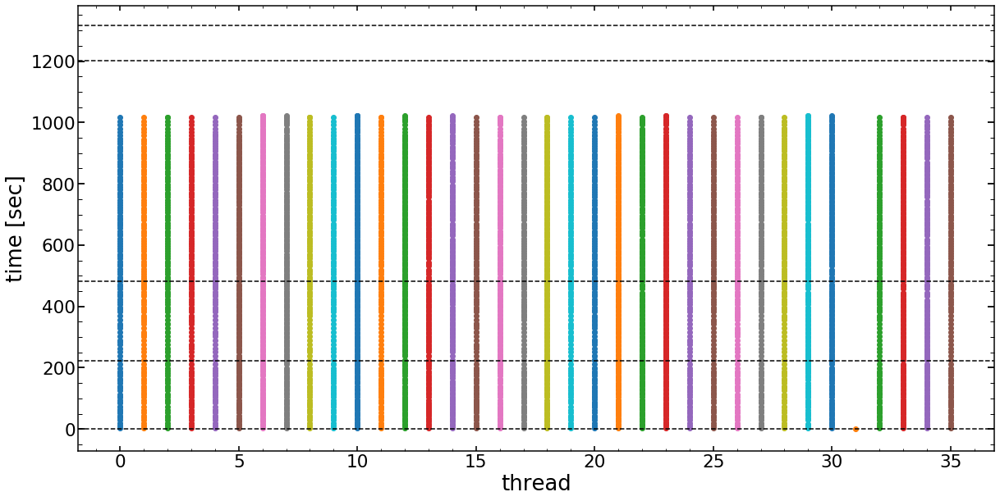

In [429]:
starting_threads=np.unique(array_of_starting[:,3])
list_of_times=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Jul0620_test_1_node_36_threads/chainJul0620_Single_P_21448617HgAr_list_of_times.npy')
min_time=np.min(array_of_starting[:,2].astype(float))

plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_starting_single_thread=array_of_starting[array_of_starting[:,3]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_starting_single_thread[:,2]))*i,array_of_starting_single_thread[:,2].astype(float)-min_time)
    
plt.axhline(0,color='black',ls='--')   
plt.axhline(list_of_times[0],color='black',ls='--')
plt.axhline(list_of_times[1],color='black',ls='--')
plt.axhline(list_of_times[2],color='black',ls='--')
plt.axhline(list_of_times[3],color='black',ls='--')

plt.xlabel('thread')
plt.ylabel('time [sec]')

In [435]:
np.mean(np.diff(array_of_starting_single_thread[:,2].astype(float)-min_time))

8.357904769172354

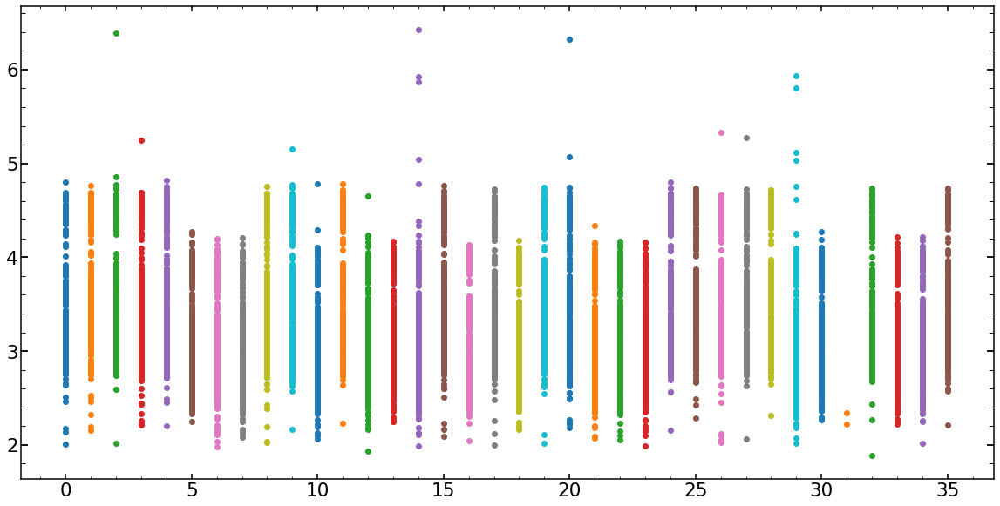

In [431]:
plt.figure(figsize=(20,10))
for i in range(0,len(starting_threads)):
    array_of_lnlike_time_single_thread=array_of_lnlike_time[array_of_lnlike_time[:,1]==starting_threads[i]]
    plt.scatter(np.ones(len(array_of_lnlike_time_single_thread[:,1]))*i,array_of_lnlike_time_single_thread[:,2].astype(float))

In [432]:
np.mean(array_of_lnlike_time[:,2].astype(float))

3.3125298953606492

In [433]:
np.mean(array_of_lnlike_time[0:2][:,2].astype(float))

2.282083749771118

In [120]:
import socket
print(socket.gethostname())

IapetusUSA


In [121]:
import platform

platform.uname()[1]

'IapetusUSA'

In [122]:
platform.uname()

uname_result(system='Darwin', node='IapetusUSA', release='18.7.0', version='Darwin Kernel Version 18.7.0: Tue Aug 20 16:57:14 PDT 2019; root:xnu-4903.271.2~2/RELEASE_X86_64', machine='x86_64', processor='i386')

In [123]:
4.45/3.027809618767254

1.469709314752682

## Testing times 

# Jul10

## scripts

In [7]:
# lets assume 8.5 seonds for a single run and 2 images

t=8.5 *3 

steps=40

walkers=240
emcee_walkers=480

nodes=6


total_swarm_time=np.ceil(walkers/(nodes*40))*(4*steps)*t
total_swarm_time

total_emcee_time=np.ceil((emcee_walkers/2)/(nodes*40))*2*(1.5*steps)*t

In [448]:
(total_swarm_time+total_emcee_time)/3600

1.9833333333333334

In [447]:
total_emcee_time

3060.0

In [415]:
finalHgAr_Feb2020_dataset=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_Feb2020",allow_pickle=True)
finalNe_Feb2020_dataset=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_Feb2020",allow_pickle=True)
finalKr_Feb2020_dataset=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_Feb2020",allow_pickle=True)

In [452]:
list_of_HgAr_to_analyze=finalHgAr_Feb2020_dataset[finalHgAr_Feb2020_dataset['close']=='1'].index
list_of_HgAr_to_analyze

Int64Index([  1,   3,   6,   9,  11,  13,  15,  18,  21,  23,  25,  27,  30,
             33,  35,  37,  39,  42,  45,  47,  49,  51,  54,  57,  59,  61,
             63,  66,  69,  71,  73,  75,  78,  81,  83,  85,  87,  90,  93,
             95,  97,  99, 102, 105, 107, 109, 111, 114, 117, 119],
           dtype='int64')

In [453]:
def remove(string): 
    return string.replace(" ", "")

In [461]:

for single_spot in list_of_HgAr_to_analyze:
    if str(finalHgAr_Feb2020_dataset.loc[single_spot]['close'])=='0' or str(finalHgAr_Feb2020_dataset.loc[single_spot]['close'])=='0.5':
        double_source=True
    else:
        double_source=False    
        
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/TtestS'+str(single_spot)+'Jul10.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=6 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 04:55:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, m35, m3, p3, p35, p4
    file.write("mpirun python /home/ncaplar/Code/Zernike_parameter_estimation.py -obs 21352 21358 21364 21436 21442 21448 -spot "+str(single_spot)+\
               " -nsteps 50 -eps 8 -dataset 4 -arc HgAr -double_sources "+str(double_source)+\
               " -double_sources_positions_ratios "+remove(str(list(finalHgAr_Feb2020_dataset.loc[single_spot][['second_offset','second_ratio']].values)))+\
               " -twentytwo_or_extra 22 -date_of_input Mar06 -direct_or_interpolation direct -date_of_output Jul10 -analysis_type defocus \n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/Jul10ScriptToSubmitScriptsTigertest'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/TtestS'+str(single_spot)+'Jul10.sh \n')

file.close()

In [ ]:
list2 = [x for x in list1 if x]